# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 433kB/s]
100% 255k/255k [00:00<00:00, 433kB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

100% 66.1k/66.1k [00:00<00:00, 335kB/s]
100% 66.1k/66.1k [00:00<00:00, 335kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:50<00:00, 24.7MB/s]
100% 1.09G/1.09G [00:50<00:00, 23.3MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 133.6 kB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 35.9 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
import torchvision.models as models

In [ ]:
from scipy.stats import spearmanr

# Preprocess & Split

In [ ]:
df_sports = pd.read_csv("/content/sports.csv")
df_sports["image_file"] =df_sports["image_file"].apply(lambda file: "/content/sports" +"/"+ file) # Create image path
df_sports["memorability_wo_fa_correction"] = df_sports["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_sports.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,6001,/content/sports/000000021983.jpg,sports,American football,427.0,640.0,coco,sports ball,1.0,76,16,93,0.817204,0.645161
1,6002,/content/sports/000000099336.jpg,sports,American football,425.0,640.0,coco,sports ball,1.0,82,3,99,0.828283,0.797980
2,6003,/content/sports/000000124841.jpg,sports,American football,456.0,640.0,coco,sports ball,1.0,63,1,91,0.692308,0.681319
3,6004,/content/sports/000000474255.jpg,sports,American football,480.0,640.0,coco,sports ball,1.0,86,0,106,0.811321,0.811321
4,6005,/content/sports/000000546020.jpg,sports,American football,417.0,640.0,coco,sports ball,1.0,64,0,97,0.659794,0.659794


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 118.64765429023171
Standard deviation of pixel values: 67.84658216273661


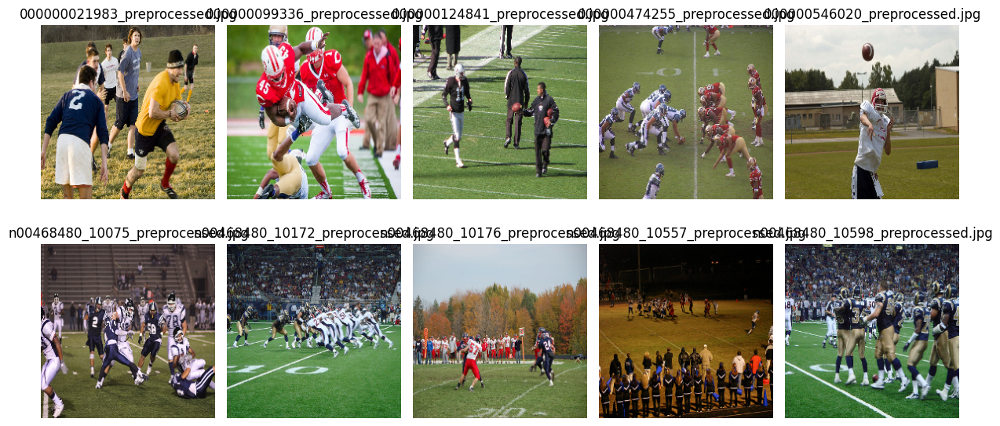

In [ ]:
# Sample data (replace this with your DataFrame)
df_sports= pd.DataFrame({
    'image_file': df_sports["image_file"],
    'memoscore': df_sports["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_sports['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_sports.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_sports.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_sports.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_sports.head()

,image_file,memoscore,preprocessed_image_path
0,/content/sports/000000021983.jpg,0.817204,/content/sports/000000021983_preprocessed.jpg
1,/content/sports/000000099336.jpg,0.828283,/content/sports/000000099336_preprocessed.jpg
2,/content/sports/000000124841.jpg,0.692308,/content/sports/000000124841_preprocessed.jpg
3,/content/sports/000000474255.jpg,0.811321,/content/sports/000000474255_preprocessed.jpg
4,/content/sports/000000546020.jpg,0.659794,/content/sports/000000546020_preprocessed.jpg


In [ ]:
del df_sports["image_file"]

In [ ]:
df_sports.head()

,memoscore,preprocessed_image_path
0,0.817204,/content/sports/000000021983_preprocessed.jpg
1,0.828283,/content/sports/000000099336_preprocessed.jpg
2,0.692308,/content/sports/000000124841_preprocessed.jpg
3,0.811321,/content/sports/000000474255_preprocessed.jpg
4,0.659794,/content/sports/000000546020_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_sports.drop('memoscore', axis=1)), pd.DataFrame(df_sports['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
1471,/content/sports/n00440941_10387_preprocessed.jpg
1136,/content/sports/ff7008672523e06a_preprocessed.jpg
1636,/content/sports/000000489799_preprocessed.jpg
1484,/content/sports/n00440941_6794_preprocessed.jpg
208,/content/sports/n00480993_21657_preprocessed.jpg


In [ ]:
merged_train_sports= pd.concat([X_train, y_train], axis=1)
merged_train_sports

,preprocessed_image_path,memoscore
1471,/content/sports/n00440941_10387_preprocessed.jpg,0.750000
1136,/content/sports/ff7008672523e06a_preprocessed.jpg,0.739130
1636,/content/sports/000000489799_preprocessed.jpg,0.816092
1484,/content/sports/n00440941_6794_preprocessed.jpg,0.716981
208,/content/sports/n00480993_21657_preprocessed.jpg,0.803922
...,...,...
1320,/content/sports/000000149726_preprocessed.jpg,0.852273
701,/content/sports/n00464894_13058_preprocessed.jpg,0.857143
1138,/content/sports/078b53d8a454894d_preprocessed.jpg,0.576471
1266,/content/sports/76d71199ef93778b_preprocessed.jpg,0.848485


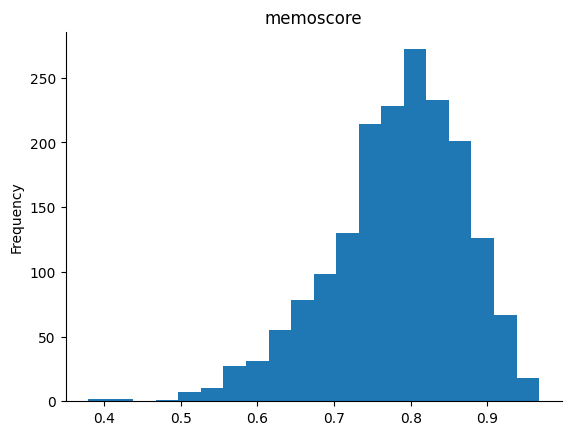

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_train_sports['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_val_sports = pd.concat([X_val, y_val], axis=1)
merged_val_sports

,preprocessed_image_path,memoscore
367,/content/sports/59e2b03991f6a4ea_preprocessed.jpg,0.775000
1353,/content/sports/000000581667_preprocessed.jpg,0.765432
325,/content/sports/d0c20a0fd5c2a38b_preprocessed.jpg,0.692308
1105,/content/sports/95e59623c871c809_preprocessed.jpg,0.772152
1950,/content/sports/n00439826_8642_preprocessed.jpg,0.819048
...,...,...
1774,/content/sports/528f777d7d6da589_preprocessed.jpg,0.836735
197,/content/sports/n00480993_16163_preprocessed.jpg,0.722222
1845,/content/sports/000000446850_preprocessed.jpg,0.683544
601,/content/sports/000000210816_preprocessed.jpg,0.886364


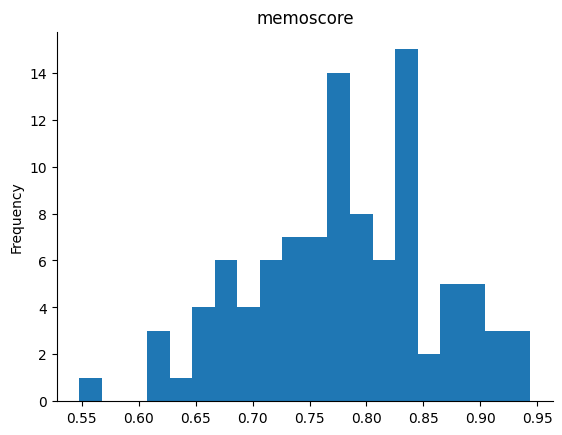

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_val_sports['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_test_sports = pd.concat([X_test, y_test], axis=1)
merged_test_sports

,preprocessed_image_path,memoscore
1789,/content/sports/8304f94f52e87b32_preprocessed.jpg,0.792079
372,/content/sports/69cdb1ea7269fecb_preprocessed.jpg,0.843137
1237,/content/sports/000000057185_preprocessed.jpg,0.781513
1416,/content/sports/000000261256_preprocessed.jpg,0.651786
1256,/content/sports/517e9176710959b7_preprocessed.jpg,0.801980
...,...,...
1214,/content/sports/n00445351_4948_preprocessed.jpg,0.716981
441,/content/sports/4cf200c4526f44ff_preprocessed.jpg,0.543210
120,/content/sports/000000479172_preprocessed.jpg,0.858491
1206,/content/sports/n00445351_13510_preprocessed.jpg,0.901099


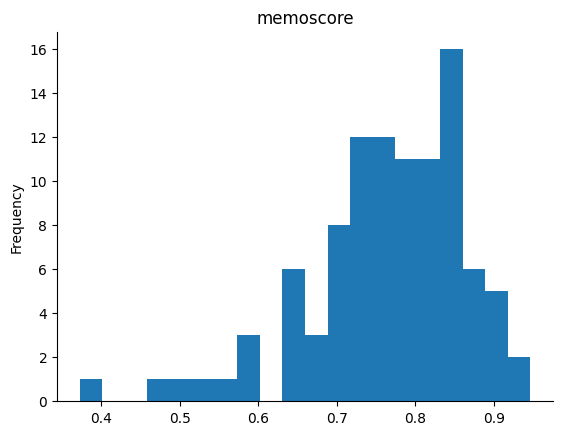

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_sports['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_sports = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/sports_Vit+Res.csv'
merged_train_sports.to_csv(csv_train_sports, index=False)

In [ ]:
csv_val_sports = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/sports_Vit+Res.csv'
merged_val_sports.to_csv(csv_val_sports, index=False)

In [ ]:
csv_test_sports = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/sports_Vit+Res.csv'
merged_test_sports.to_csv(csv_test_sports, index=False)

#Load Dataset

In [ ]:
df_train_sports = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/sports_Vit+Res.csv")
df_val_sports= pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/sports_Vit+Res.csv')
df_test_sports = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/sports_Vit+Res.csv')

In [ ]:
df_train_sports.head()

,preprocessed_image_path,memoscore
0,/content/sports/000000105200_preprocessed.jpg,0.680851
1,/content/sports/63386e0be460ef2d_preprocessed.jpg,0.761468
2,/content/sports/000000292009_preprocessed.jpg,0.625000
3,/content/sports/000000510771_preprocessed.jpg,0.788462
4,/content/sports/106416971fe2f7ee_preprocessed.jpg,0.695652


In [ ]:
df_train_sports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_sports(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_sports(df_train_sports, trans_transform=trans_transform, res_transform=res_transform)
train_dl = DataLoader(train_ds, batch_size=16, shuffle= False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 71.4MB/s]

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

In [ ]:
print(trans_layer_norm )

LayerNorm((768,), eps=1e-12, elementwise_affine=True)


In [ ]:
print(layers_trans)

[ViTEmbeddings(
  (patch_embeddings): ViTPatchEmbeddings(
    (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  )
  (dropout): Dropout(p=0.0, inplace=False)
), ViTEncoder(
  (layer): ModuleList(
    (0-11): 12 x ViTLayer(
      (attention): ViTAttention(
        (attention): ViTSelfAttention(
          (query): Linear(in_features=768, out_features=768, bias=True)
          (key): Linear(in_features=768, out_features=768, bias=True)
          (value): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (output): ViTSelfOutput(
          (dense): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
      (intermediate): ViTIntermediate(
        (dense): Linear(in_features=768, out_features=3072, bias=True)
        (intermediate_act_fn): GELUActivation()
      )
      (output): ViTOutput(
        (dense): Linear(in_features=3072, ou

In [ ]:
# Merge the two models
class model_merge_sports(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_sports(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



 Epoch: (1/50) Loss = 0.027835886925458908

 Epoch: (1/50) Loss_rmse = 0.16684089601039886

 Epoch: (1/50) R^2 = -2.750983476638794

 Epoch: (1/50) MAE = 0.1351921260356903

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

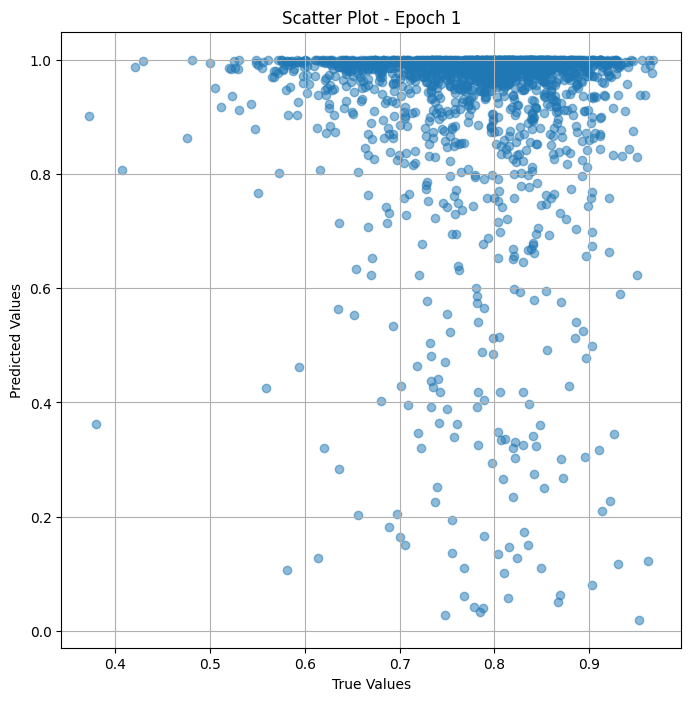


 Epoch: (2/50) Loss = 0.03075588122010231

 Epoch: (2/50) Loss_rmse = 0.17537355422973633

 Epoch: (2/50) R^2 = -3.144463062286377

 Epoch: (2/50) MAE = 0.15424297749996185

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

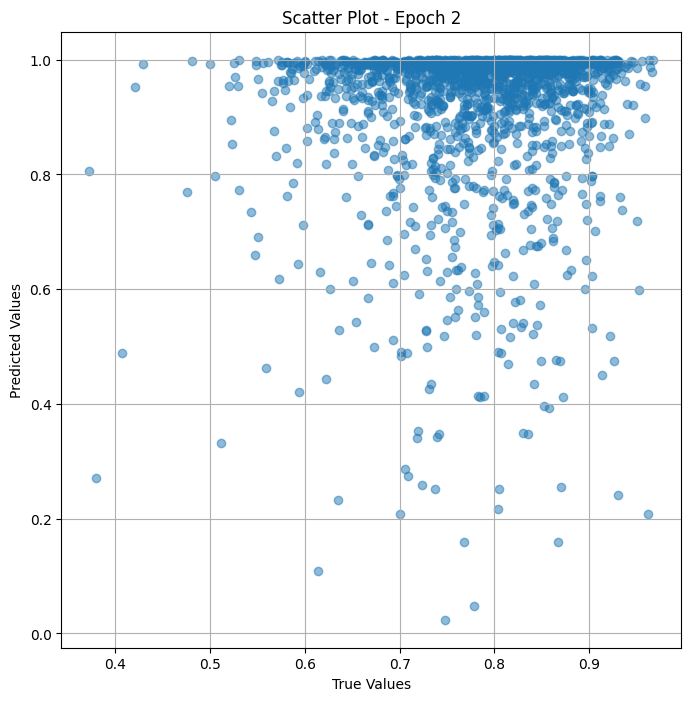


 Epoch: (3/50) Loss = 0.023058101534843445

 Epoch: (3/50) Loss_rmse = 0.1518489420413971

 Epoch: (3/50) R^2 = -2.1071600914001465

 Epoch: (3/50) MAE = 0.12437395751476288

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.

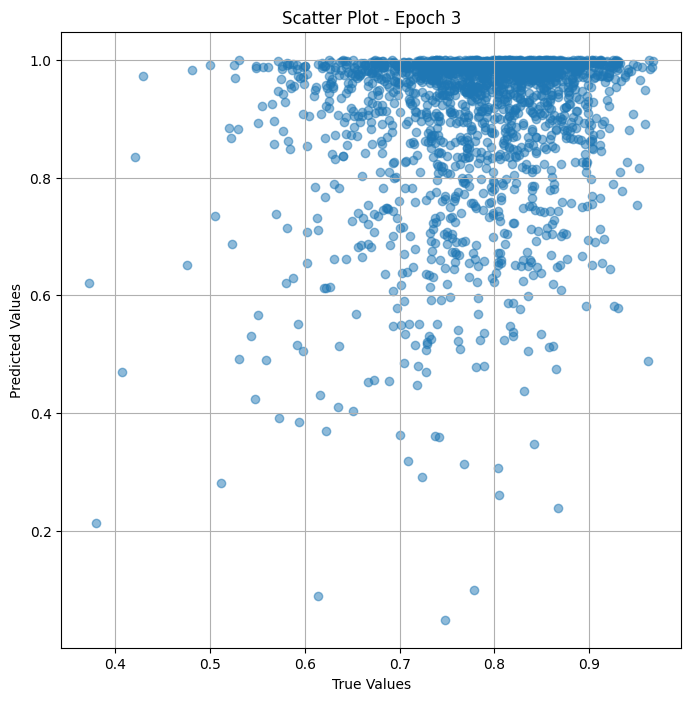


 Epoch: (4/50) Loss = 0.016956789419054985

 Epoch: (4/50) Loss_rmse = 0.1302182376384735

 Epoch: (4/50) R^2 = -1.284986972808838

 Epoch: (4/50) MAE = 0.08975917100906372

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

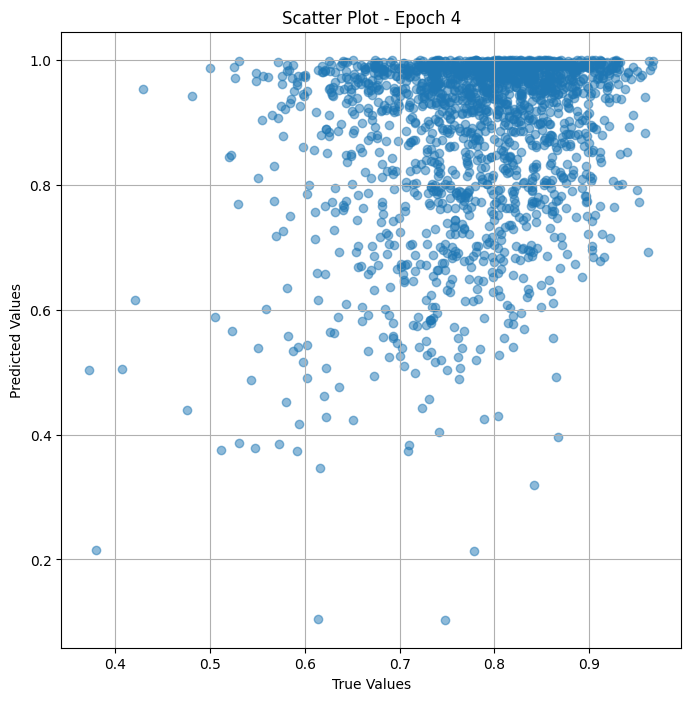


 Epoch: (5/50) Loss = 0.015498287044465542

 Epoch: (5/50) Loss_rmse = 0.1244921162724495

 Epoch: (5/50) R^2 = -1.0884485244750977

 Epoch: (5/50) MAE = 0.085548035800457

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.60

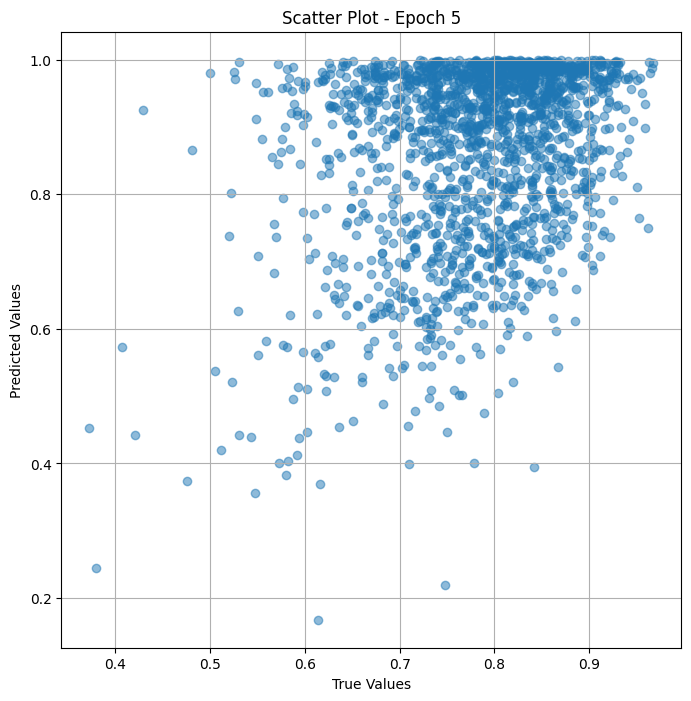


 Epoch: (6/50) Loss = 0.013390989974141121

 Epoch: (6/50) Loss_rmse = 0.11571944504976273

 Epoch: (6/50) R^2 = -0.8044828176498413

 Epoch: (6/50) MAE = 0.0875062346458435

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.

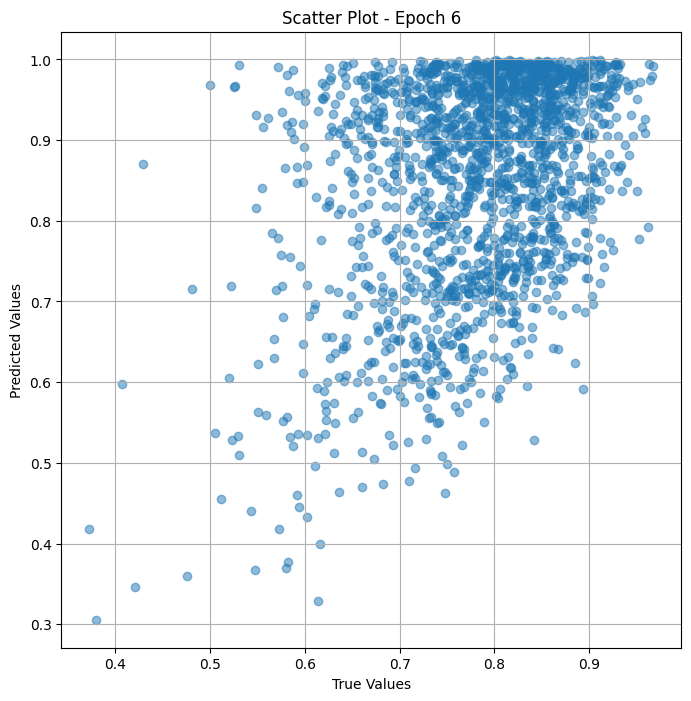


 Epoch: (7/50) Loss = 0.009596560150384903

 Epoch: (7/50) Loss_rmse = 0.09796203672885895

 Epoch: (7/50) R^2 = -0.29317009449005127

 Epoch: (7/50) MAE = 0.08282016962766647

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 

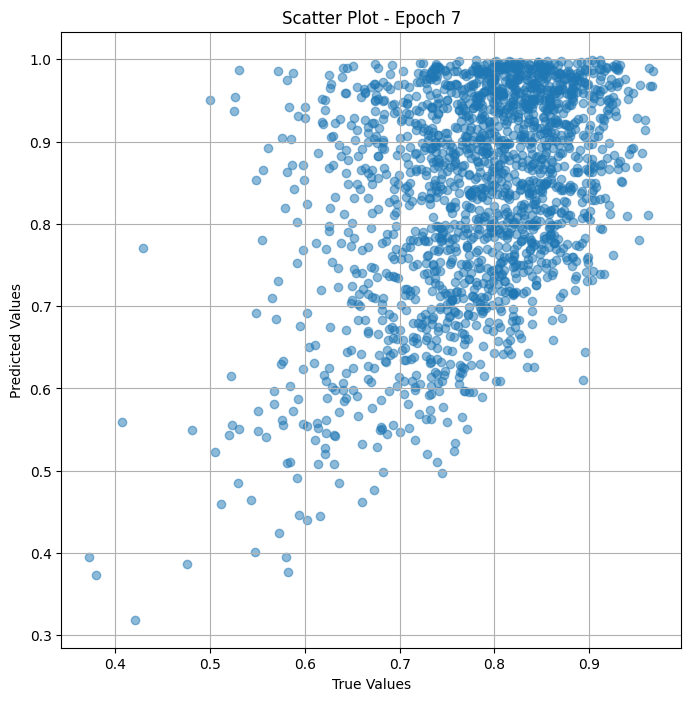


 Epoch: (8/50) Loss = 0.004573450889438391

 Epoch: (8/50) Loss_rmse = 0.06762729585170746

 Epoch: (8/50) R^2 = 0.38371145725250244

 Epoch: (8/50) MAE = 0.05566691607236862

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0

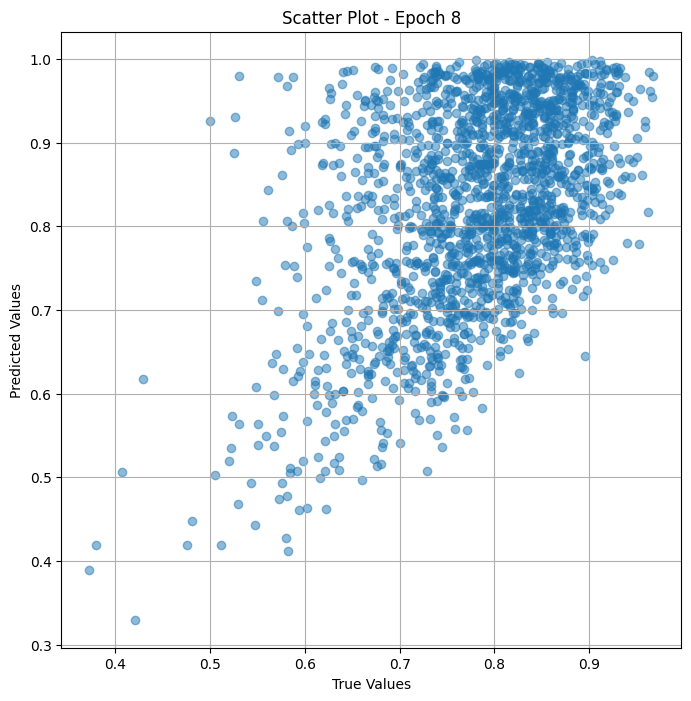


 Epoch: (9/50) Loss = 0.002269405173137784

 Epoch: (9/50) Loss_rmse = 0.04763827472925186

 Epoch: (9/50) R^2 = 0.6941896677017212

 Epoch: (9/50) MAE = 0.037227243185043335

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0

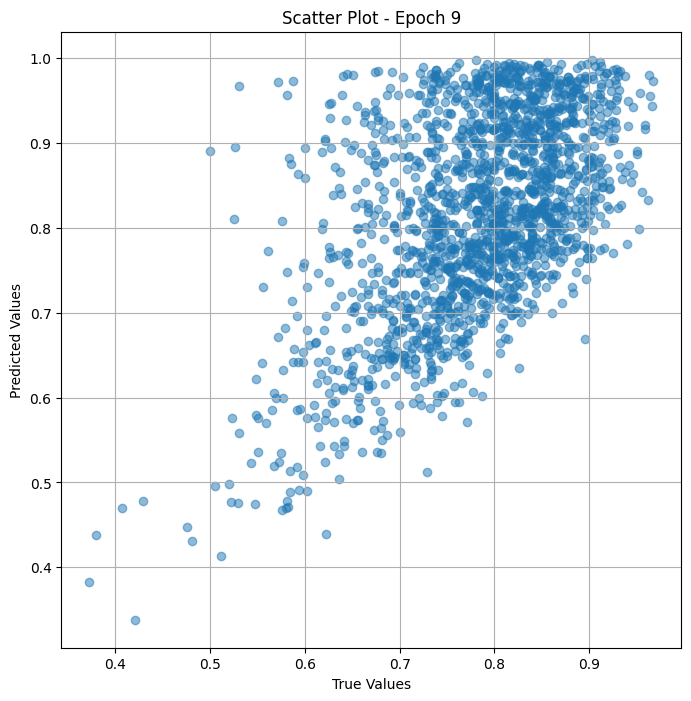


 Epoch: (10/50) Loss = 0.0015144560020416975

 Epoch: (10/50) Loss_rmse = 0.03891601040959358

 Epoch: (10/50) R^2 = 0.7959217429161072

 Epoch: (10/50) MAE = 0.02743876725435257

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

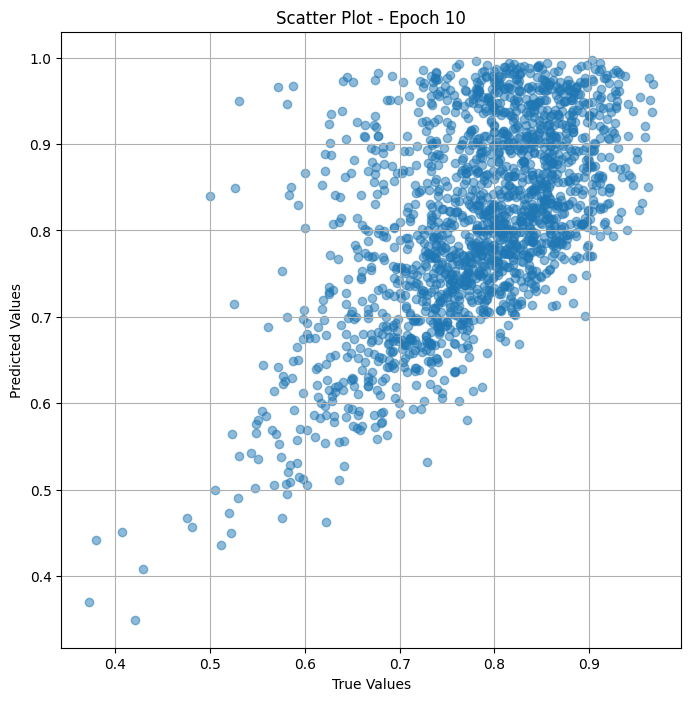


 Epoch: (11/50) Loss = 0.001141735352575779

 Epoch: (11/50) Loss_rmse = 0.03378957509994507

 Epoch: (11/50) R^2 = 0.8461471796035767

 Epoch: (11/50) MAE = 0.02555175870656967

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

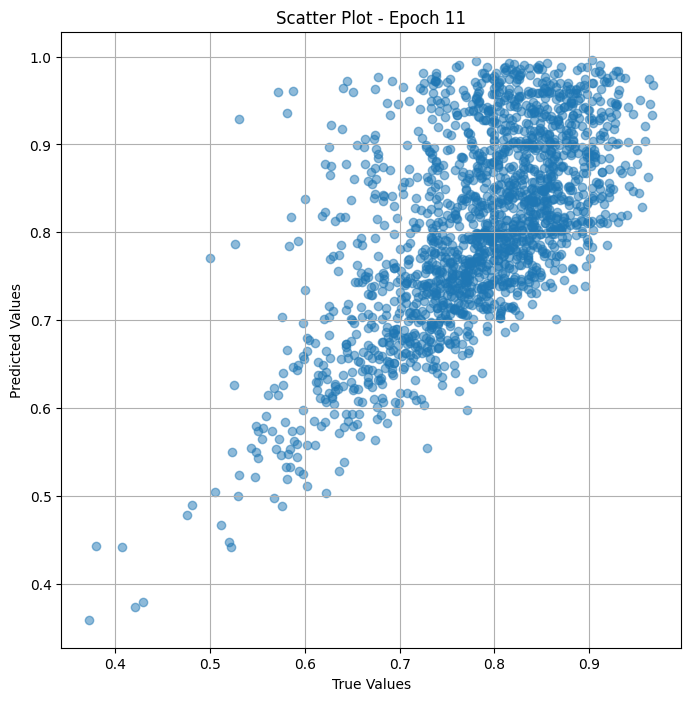


 Epoch: (12/50) Loss = 0.0008403169340454042

 Epoch: (12/50) Loss_rmse = 0.028988219797611237

 Epoch: (12/50) R^2 = 0.8867643475532532

 Epoch: (12/50) MAE = 0.023204736411571503

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255

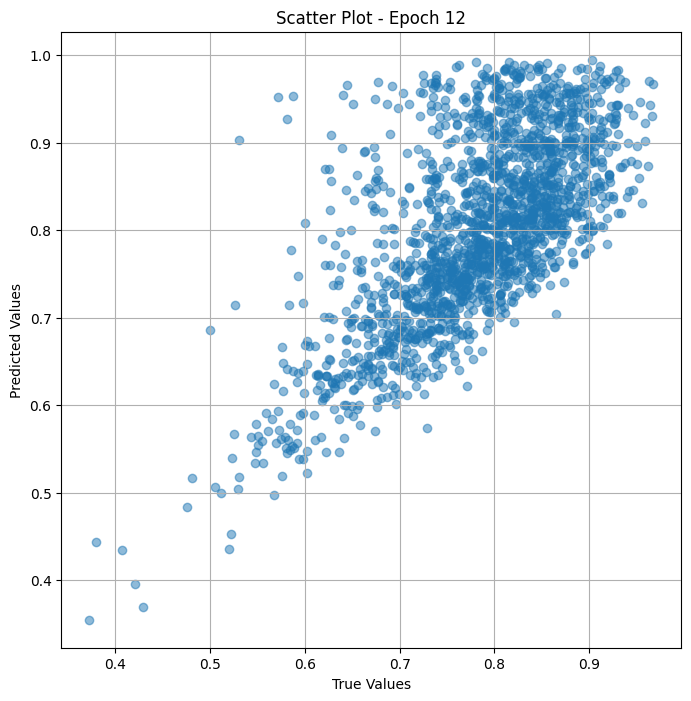


 Epoch: (13/50) Loss = 0.0005563035374507308

 Epoch: (13/50) Loss_rmse = 0.023586086928844452

 Epoch: (13/50) R^2 = 0.9250361323356628

 Epoch: (13/50) MAE = 0.018724508583545685

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255

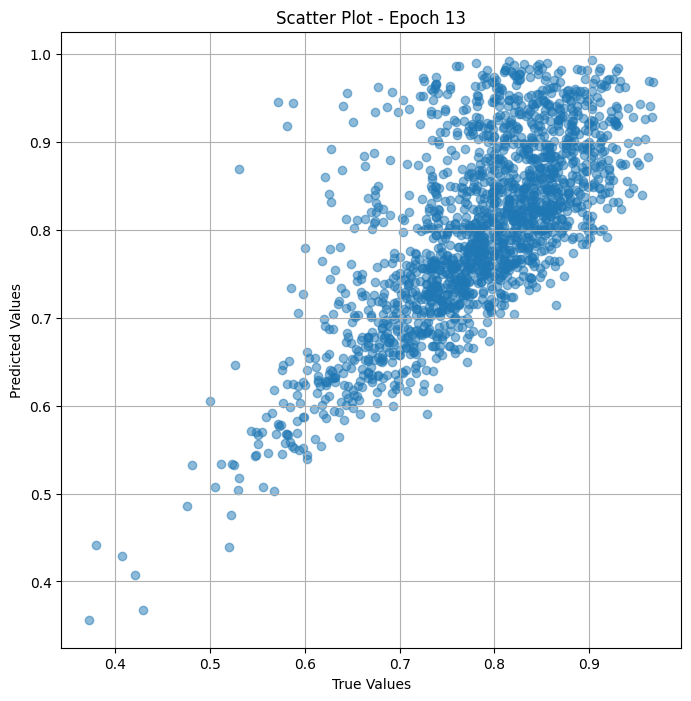


 Epoch: (14/50) Loss = 0.000337642733938992

 Epoch: (14/50) Loss_rmse = 0.018375057727098465

 Epoch: (14/50) R^2 = 0.9545014500617981

 Epoch: (14/50) MAE = 0.012948587536811829

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

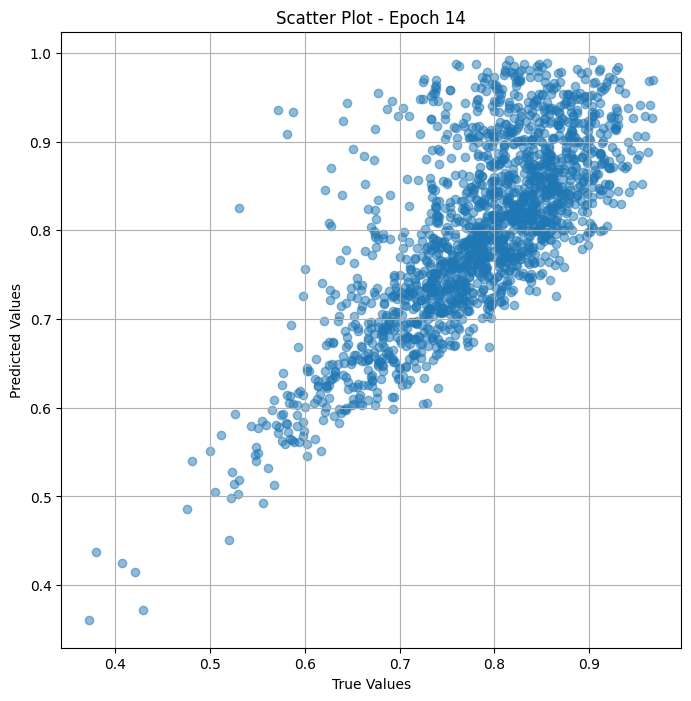


 Epoch: (15/50) Loss = 0.00024300441145896912

 Epoch: (15/50) Loss_rmse = 0.01558859832584858

 Epoch: (15/50) R^2 = 0.9672542810440063

 Epoch: (15/50) MAE = 0.014694616198539734

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255

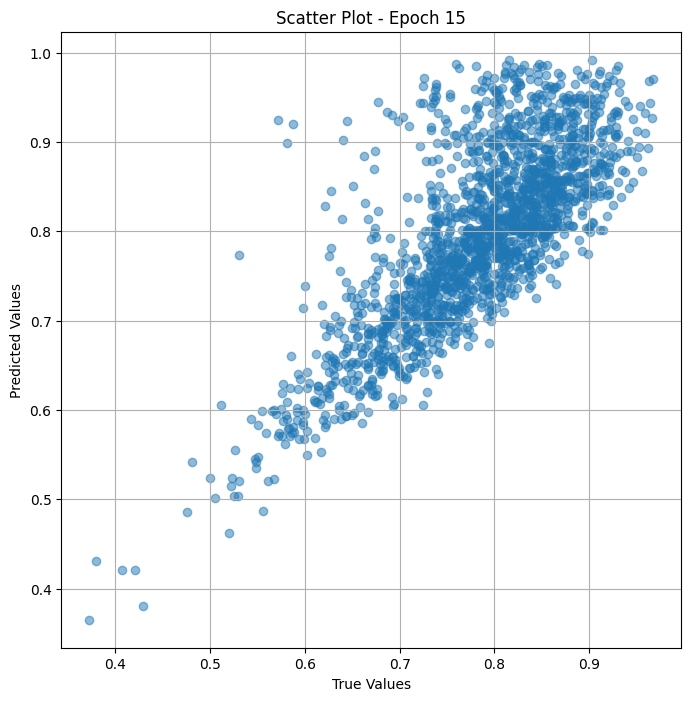


 Epoch: (16/50) Loss = 0.0003389444318599999

 Epoch: (16/50) Loss_rmse = 0.018410444259643555

 Epoch: (16/50) R^2 = 0.9543260335922241

 Epoch: (16/50) MAE = 0.016954660415649414

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255

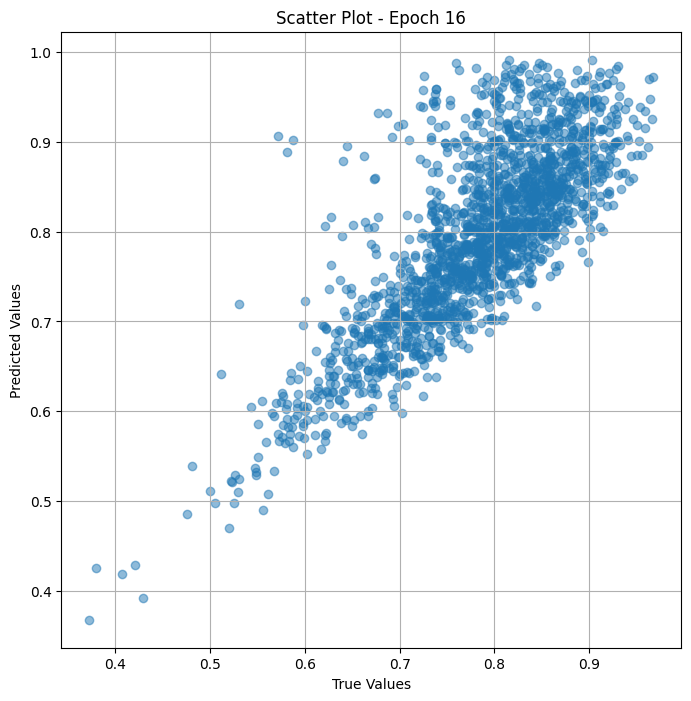


 Epoch: (17/50) Loss = 0.0006471080705523491

 Epoch: (17/50) Loss_rmse = 0.02543831802904606

 Epoch: (17/50) R^2 = 0.9127998948097229

 Epoch: (17/50) MAE = 0.02264513075351715

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

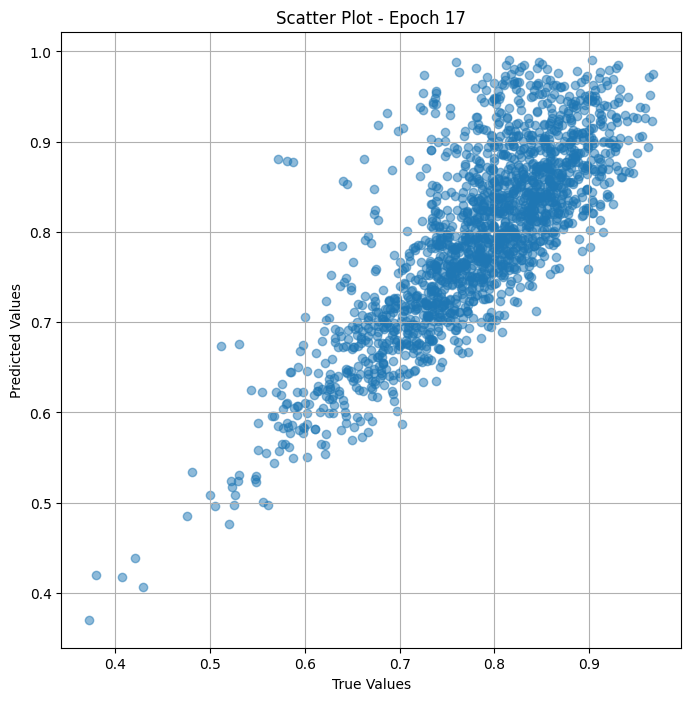


 Epoch: (18/50) Loss = 0.0010310661746188998

 Epoch: (18/50) Loss_rmse = 0.032110217958688736

 Epoch: (18/50) R^2 = 0.8610602021217346

 Epoch: (18/50) MAE = 0.02979092299938202

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

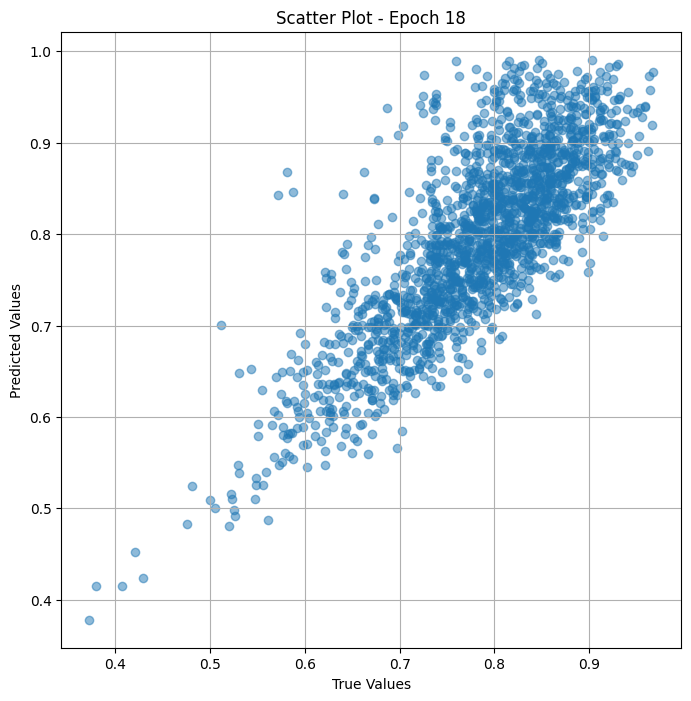


 Epoch: (19/50) Loss = 0.0006240626680664718

 Epoch: (19/50) Loss_rmse = 0.024981245398521423

 Epoch: (19/50) R^2 = 0.9159053564071655

 Epoch: (19/50) MAE = 0.023478999733924866

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255

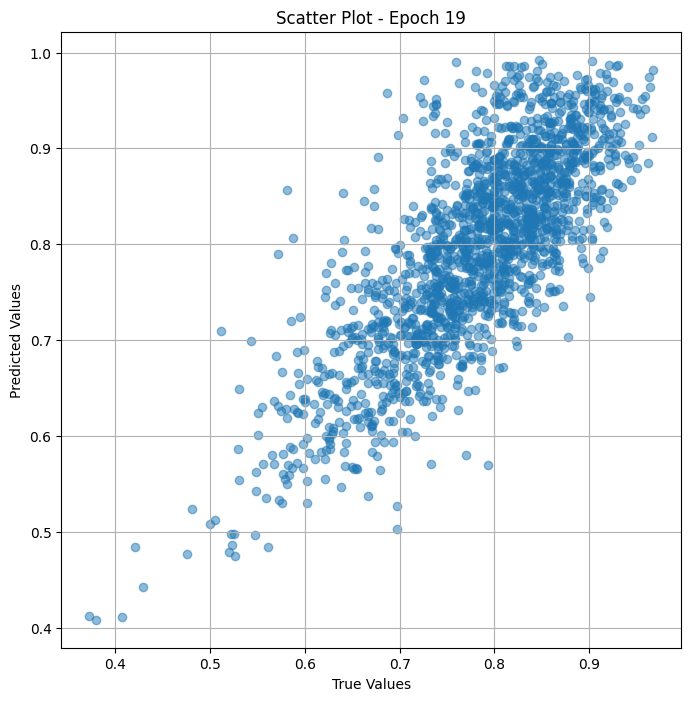


 Epoch: (20/50) Loss = 0.011204619891941547

 Epoch: (20/50) Loss_rmse = 0.10585187375545502

 Epoch: (20/50) R^2 = -0.5098618268966675

 Epoch: (20/50) MAE = 0.1023254320025444

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

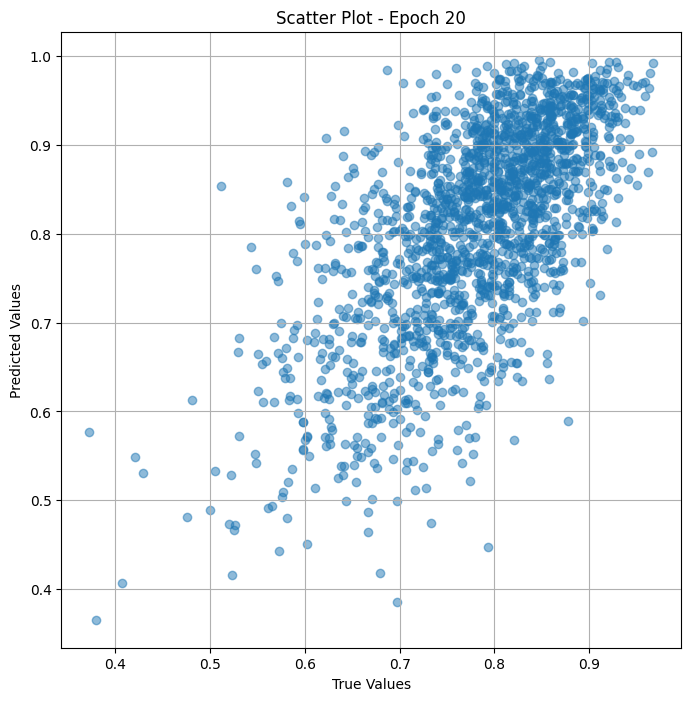


 Epoch: (21/50) Loss = 0.03523199260234833

 Epoch: (21/50) Loss_rmse = 0.18770186603069305

 Epoch: (21/50) R^2 = -3.7476344108581543

 Epoch: (21/50) MAE = 0.1854322999715805

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319,

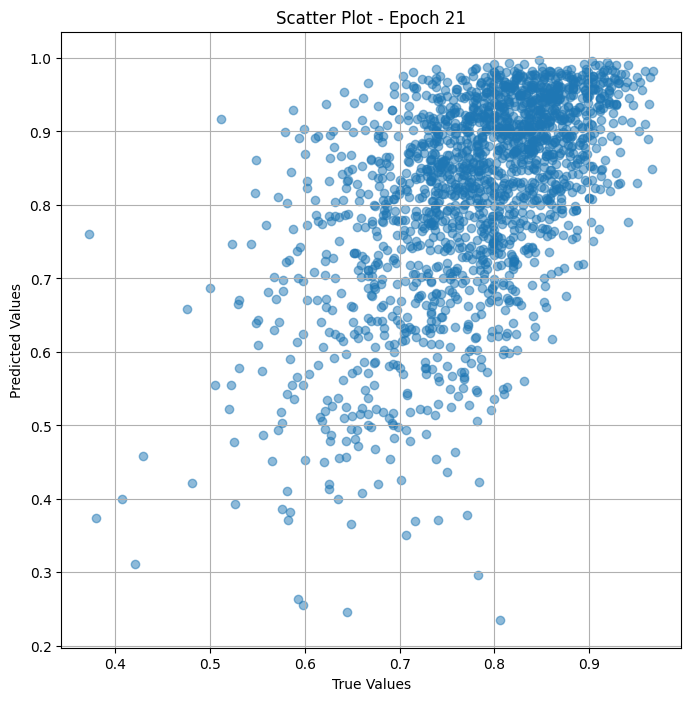


 Epoch: (22/50) Loss = 0.040926553308963776

 Epoch: (22/50) Loss_rmse = 0.20230312645435333

 Epoch: (22/50) R^2 = -4.514996528625488

 Epoch: (22/50) MAE = 0.19630067050457

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0

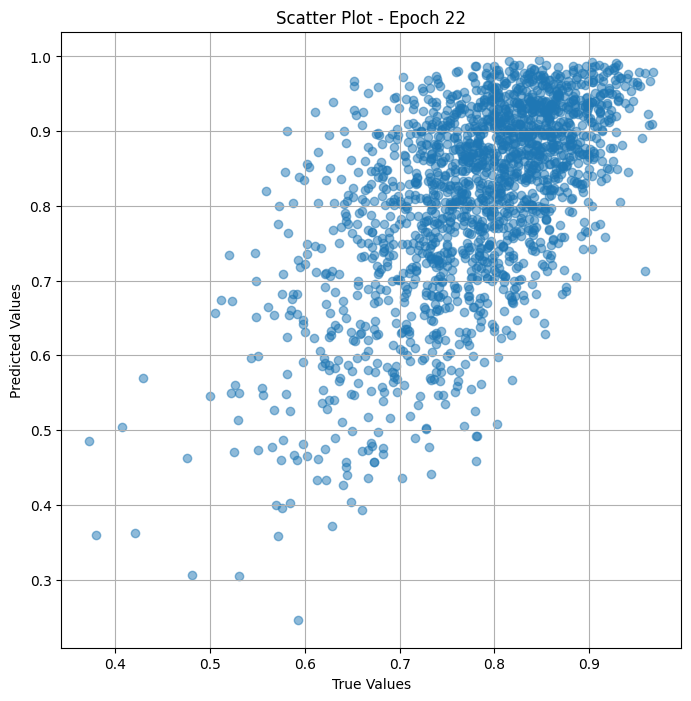


 Epoch: (23/50) Loss = 0.0338018536567688

 Epoch: (23/50) Loss_rmse = 0.18385280668735504

 Epoch: (23/50) R^2 = -3.5549182891845703

 Epoch: (23/50) MAE = 0.17876583337783813

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319,

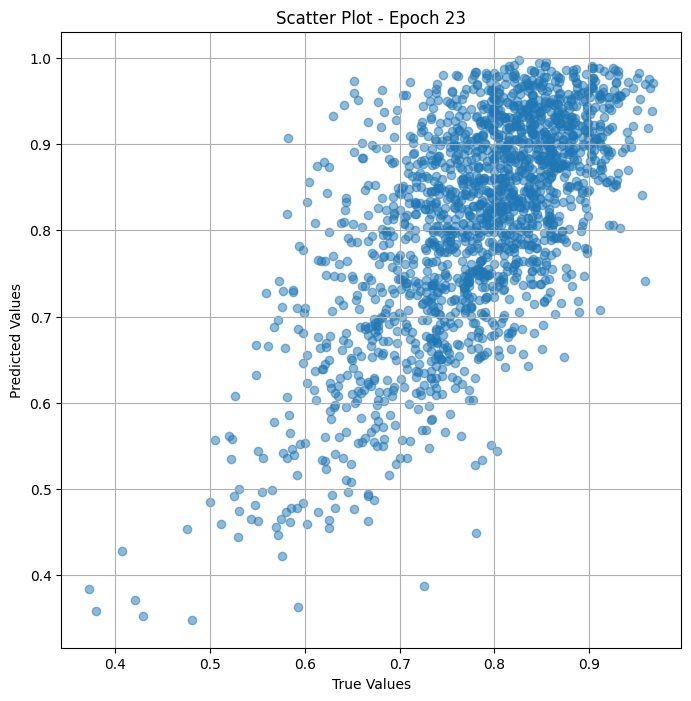


 Epoch: (24/50) Loss = 0.022240087389945984

 Epoch: (24/50) Loss_rmse = 0.14913110435009003

 Epoch: (24/50) R^2 = -1.9969298839569092

 Epoch: (24/50) MAE = 0.13751566410064697

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

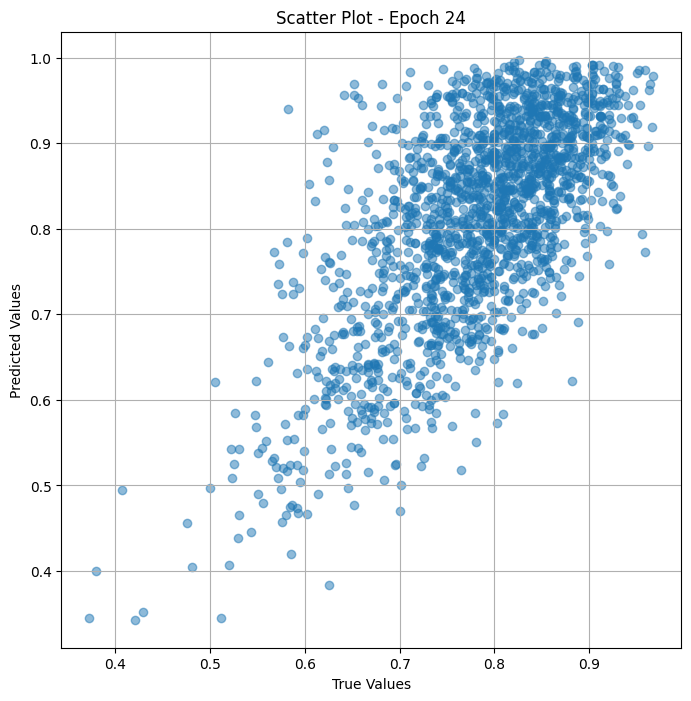


 Epoch: (25/50) Loss = 0.01386815682053566

 Epoch: (25/50) Loss_rmse = 0.11776313930749893

 Epoch: (25/50) R^2 = -0.8687827587127686

 Epoch: (25/50) MAE = 0.10945264250040054

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

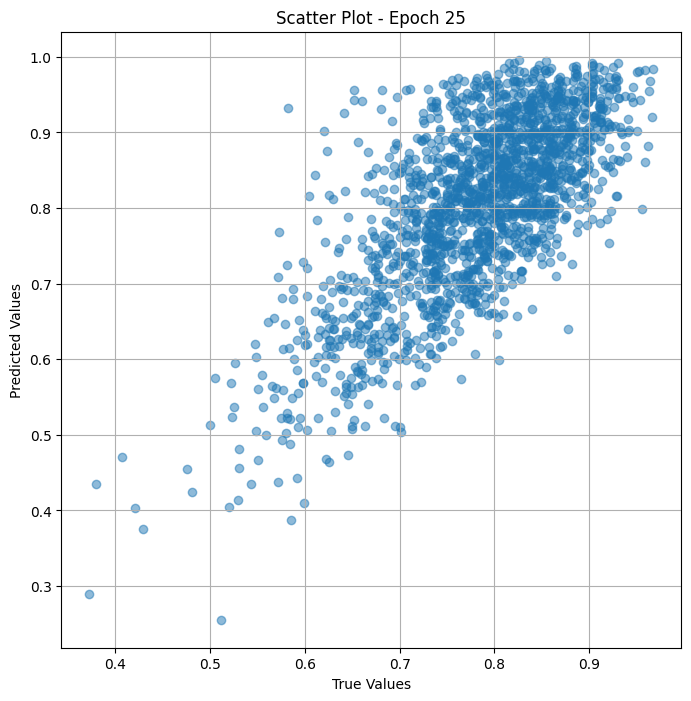


 Epoch: (26/50) Loss = 0.010205084457993507

 Epoch: (26/50) Loss_rmse = 0.1010202169418335

 Epoch: (26/50) R^2 = -0.3751709461212158

 Epoch: (26/50) MAE = 0.09308746457099915

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

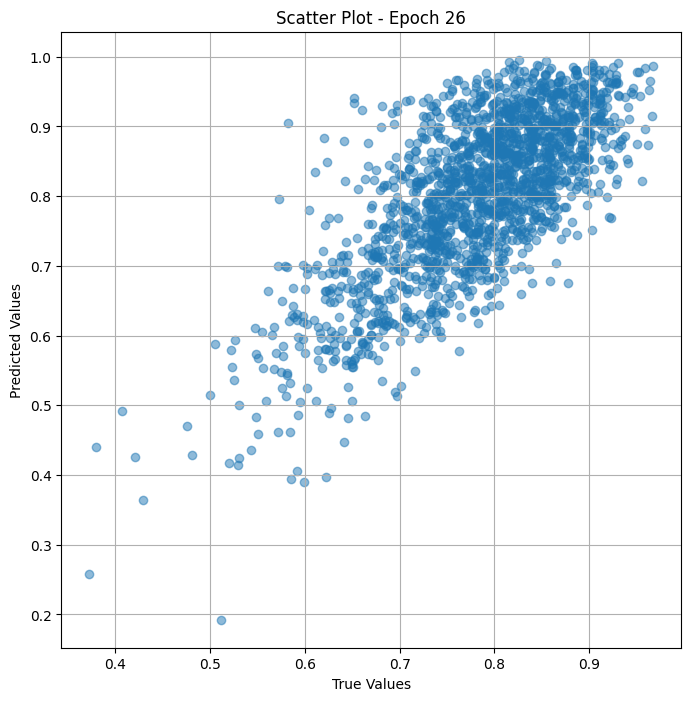


 Epoch: (27/50) Loss = 0.0063785770907998085

 Epoch: (27/50) Loss_rmse = 0.07986599206924438

 Epoch: (27/50) R^2 = 0.14046436548233032

 Epoch: (27/50) MAE = 0.0706985741853714

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

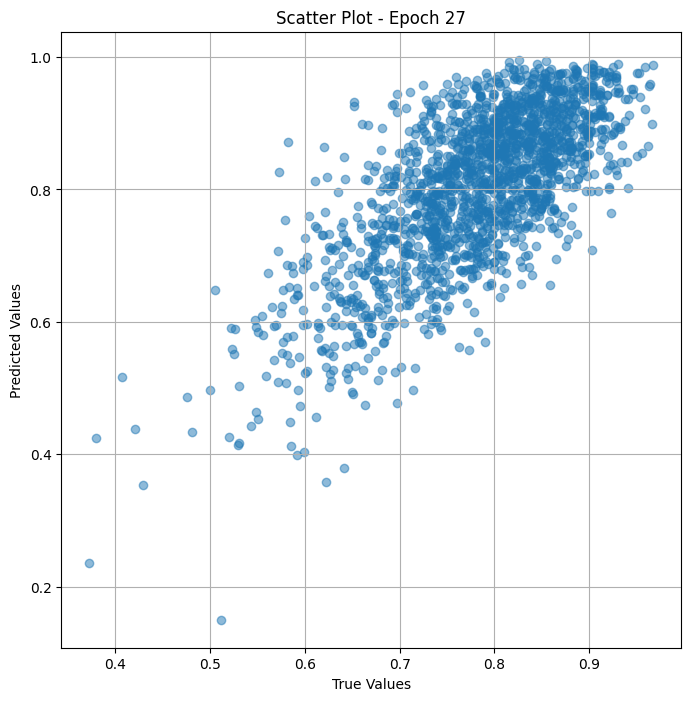


 Epoch: (28/50) Loss = 0.004505633842200041

 Epoch: (28/50) Loss_rmse = 0.06712401658296585

 Epoch: (28/50) R^2 = 0.39285004138946533

 Epoch: (28/50) MAE = 0.05481186509132385

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

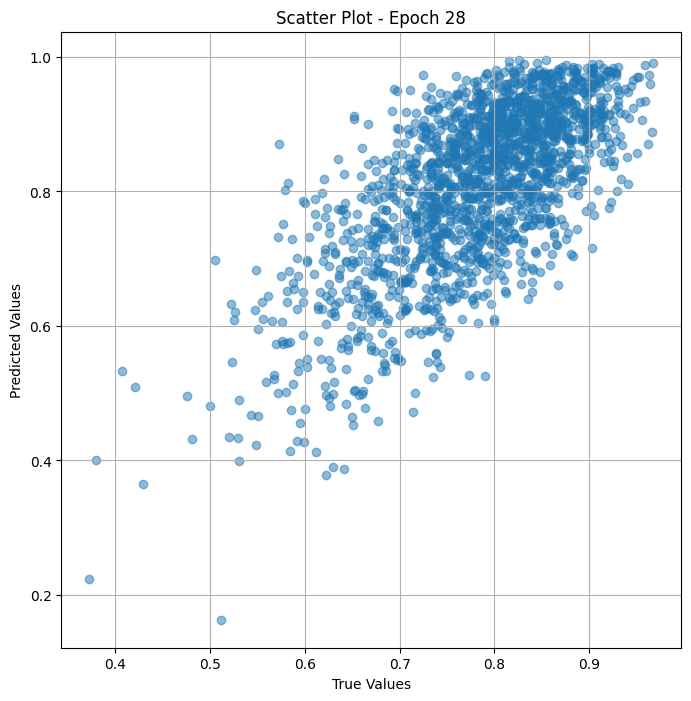


 Epoch: (29/50) Loss = 0.008048302493989468

 Epoch: (29/50) Loss_rmse = 0.08971232920885086

 Epoch: (29/50) R^2 = -0.08453702926635742

 Epoch: (29/50) MAE = 0.0645398199558258

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

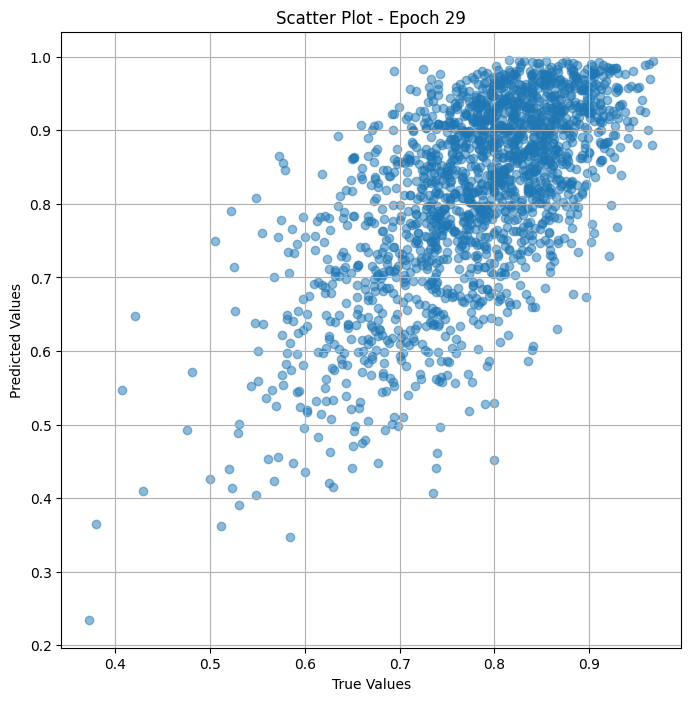


 Epoch: (30/50) Loss = 0.005397668108344078

 Epoch: (30/50) Loss_rmse = 0.07346882671117783

 Epoch: (30/50) R^2 = 0.2726452946662903

 Epoch: (30/50) MAE = 0.05833203345537186

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

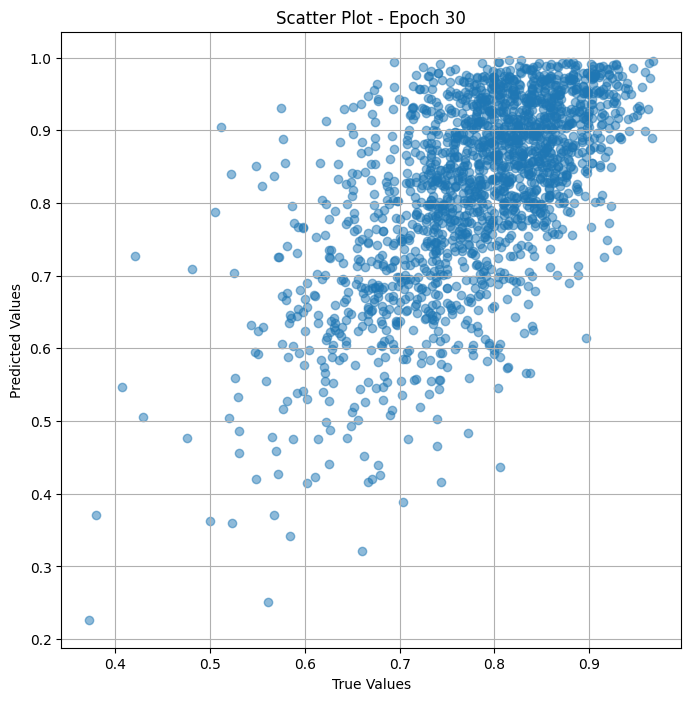


 Epoch: (31/50) Loss = 0.0036831111647188663

 Epoch: (31/50) Loss_rmse = 0.06068864092230797

 Epoch: (31/50) R^2 = 0.503687858581543

 Epoch: (31/50) MAE = 0.05362959951162338

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

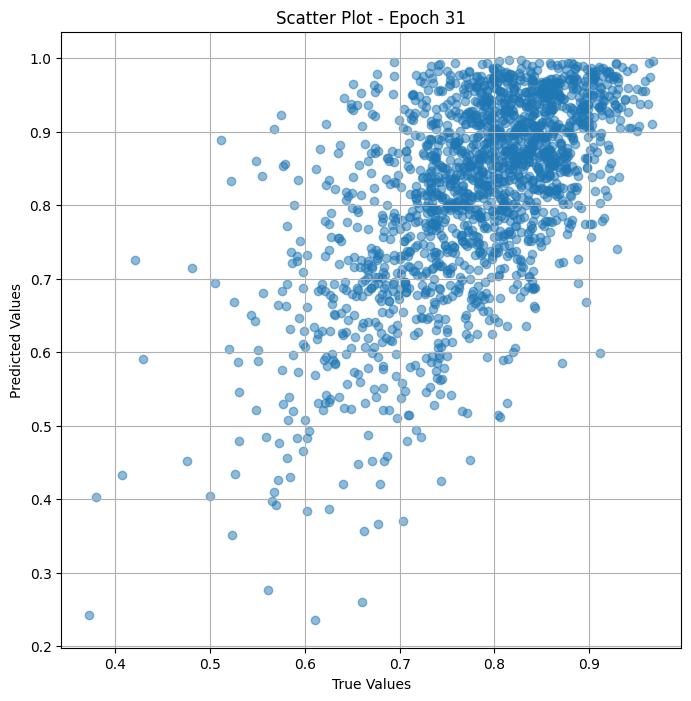


 Epoch: (32/50) Loss = 0.0033033075742423534

 Epoch: (32/50) Loss_rmse = 0.05747440829873085

 Epoch: (32/50) R^2 = 0.5548677444458008

 Epoch: (32/50) MAE = 0.05168778449296951

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

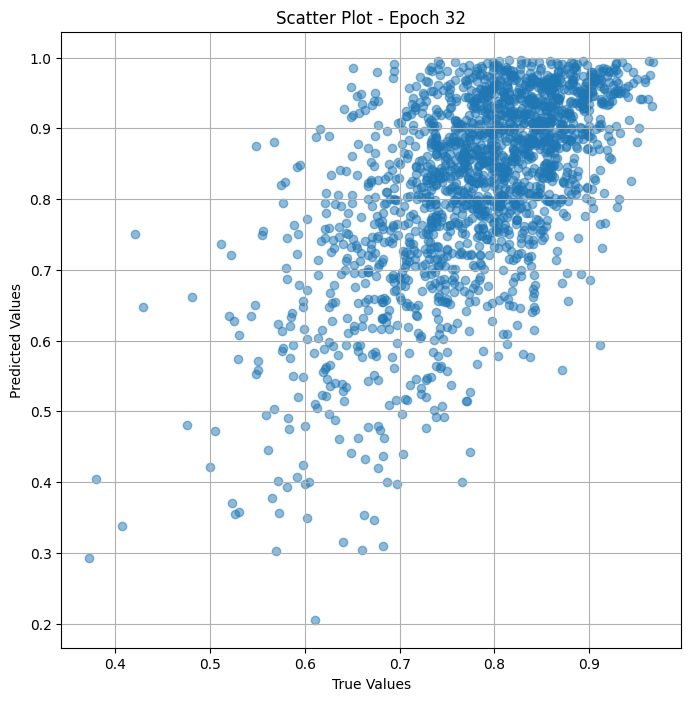


 Epoch: (33/50) Loss = 0.004268741235136986

 Epoch: (33/50) Loss_rmse = 0.06533560156822205

 Epoch: (33/50) R^2 = 0.42477214336395264

 Epoch: (33/50) MAE = 0.05986296385526657

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

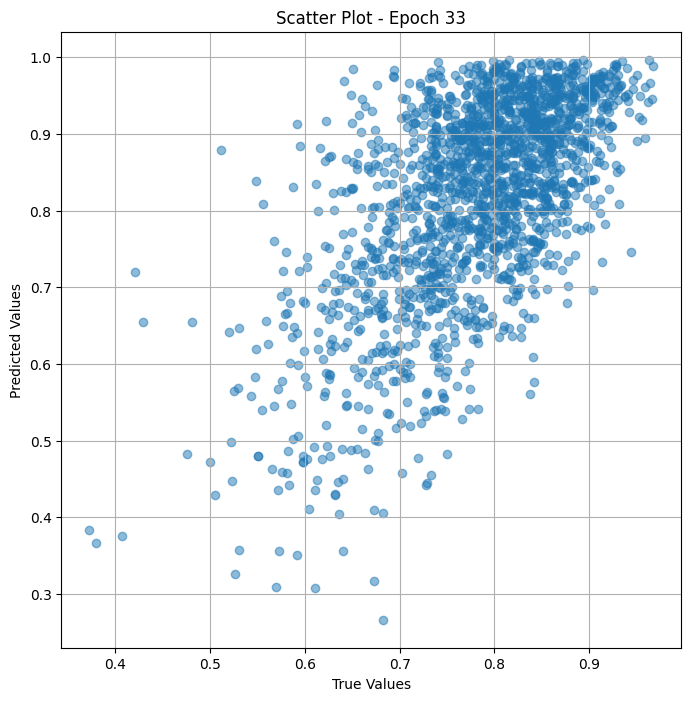


 Epoch: (34/50) Loss = 0.003418288193643093

 Epoch: (34/50) Loss_rmse = 0.05846612900495529

 Epoch: (34/50) R^2 = 0.5393736362457275

 Epoch: (34/50) MAE = 0.051499612629413605

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

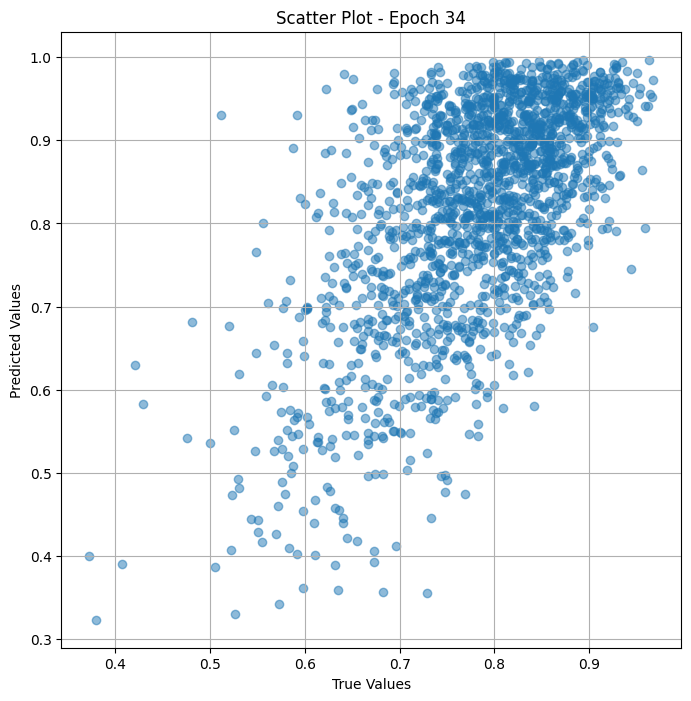


 Epoch: (35/50) Loss = 0.0034930792171508074

 Epoch: (35/50) Loss_rmse = 0.05910227820277214

 Epoch: (35/50) R^2 = 0.5292953252792358

 Epoch: (35/50) MAE = 0.04817776009440422

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

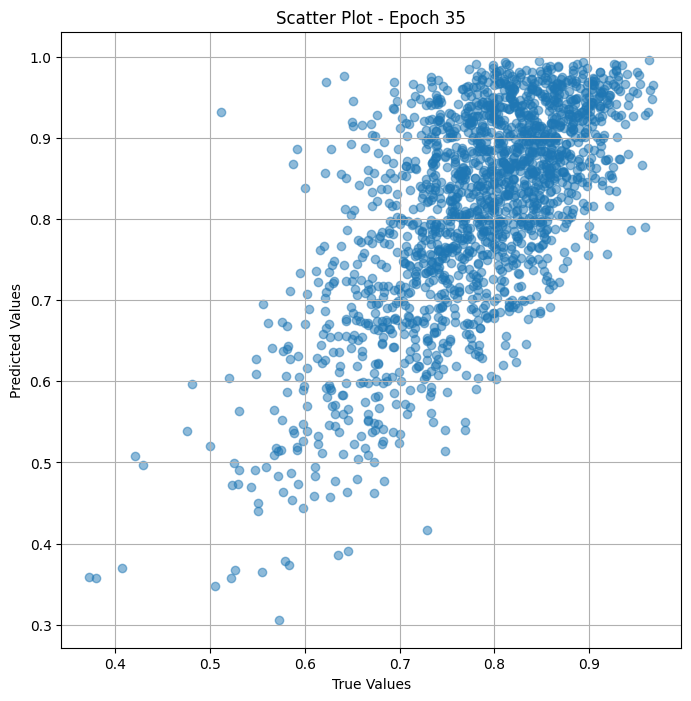


 Epoch: (36/50) Loss = 0.0017994798254221678

 Epoch: (36/50) Loss_rmse = 0.04242027550935745

 Epoch: (36/50) R^2 = 0.7575137615203857

 Epoch: (36/50) MAE = 0.037539832293987274

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

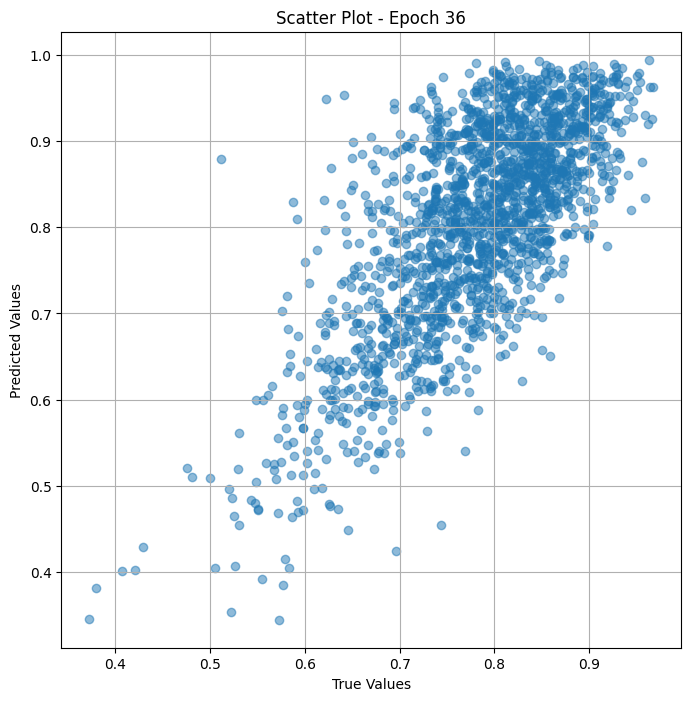


 Epoch: (37/50) Loss = 0.002643921412527561

 Epoch: (37/50) Loss_rmse = 0.05141907557845116

 Epoch: (37/50) R^2 = 0.6437222957611084

 Epoch: (37/50) MAE = 0.04463449493050575

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

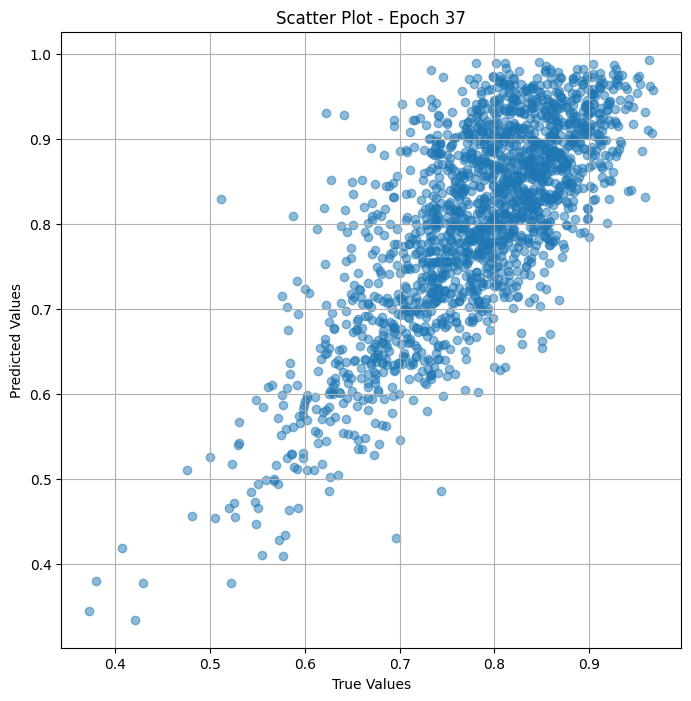


 Epoch: (38/50) Loss = 0.0031610685400664806

 Epoch: (38/50) Loss_rmse = 0.05622338131070137

 Epoch: (38/50) R^2 = 0.5740349292755127

 Epoch: (38/50) MAE = 0.04918297752737999

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

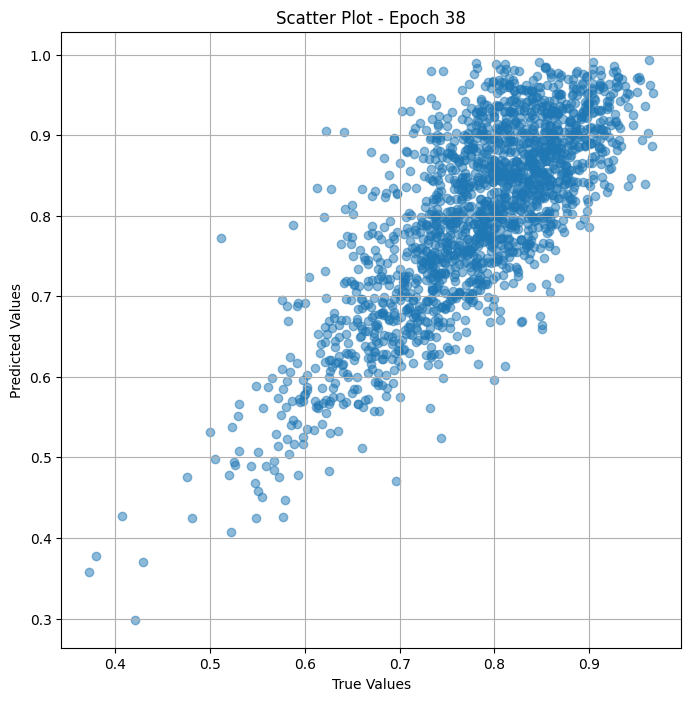


 Epoch: (39/50) Loss = 0.0033125332556664944

 Epoch: (39/50) Loss_rmse = 0.05755461007356644

 Epoch: (39/50) R^2 = 0.5536245107650757

 Epoch: (39/50) MAE = 0.05324501544237137

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

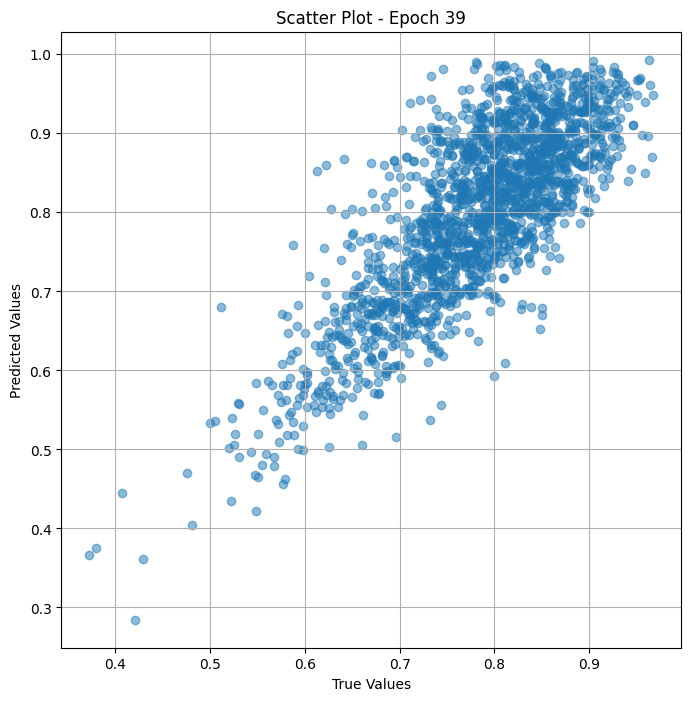


 Epoch: (40/50) Loss = 0.003219171892851591

 Epoch: (40/50) Loss_rmse = 0.0567377470433712

 Epoch: (40/50) R^2 = 0.5662052631378174

 Epoch: (40/50) MAE = 0.05261574685573578

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319,

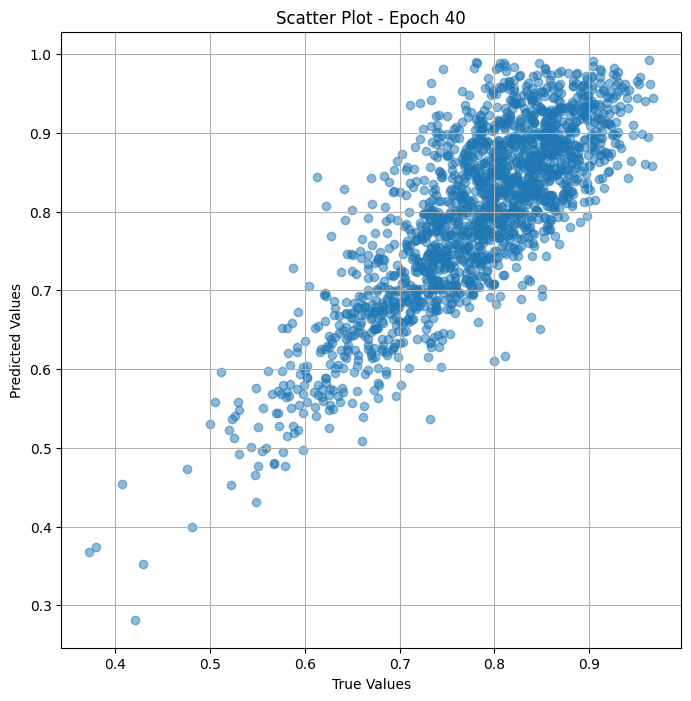


 Epoch: (41/50) Loss = 0.0030647236853837967

 Epoch: (41/50) Loss_rmse = 0.05535994842648506

 Epoch: (41/50) R^2 = 0.5870177745819092

 Epoch: (41/50) MAE = 0.04971219599246979

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

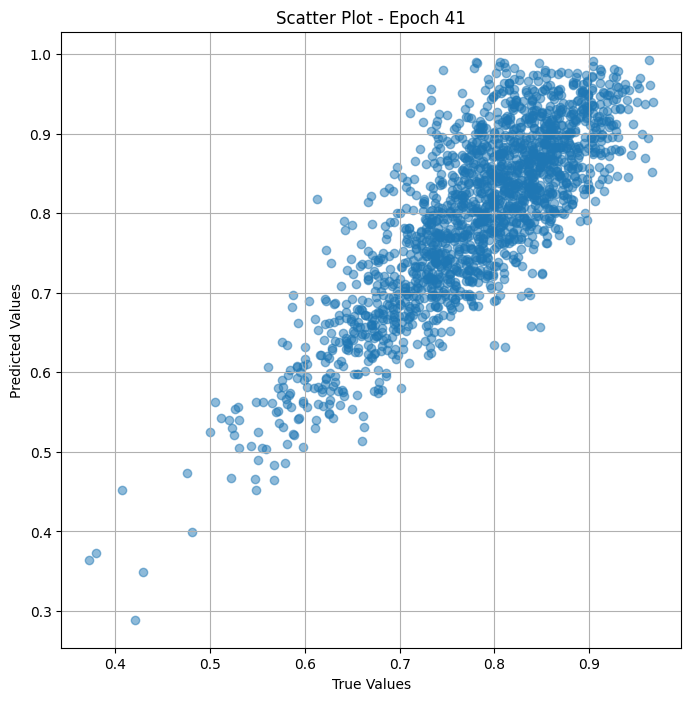


 Epoch: (42/50) Loss = 0.0028564331587404013

 Epoch: (42/50) Loss_rmse = 0.05344561114907265

 Epoch: (42/50) R^2 = 0.6150856018066406

 Epoch: (42/50) MAE = 0.04785127192735672

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

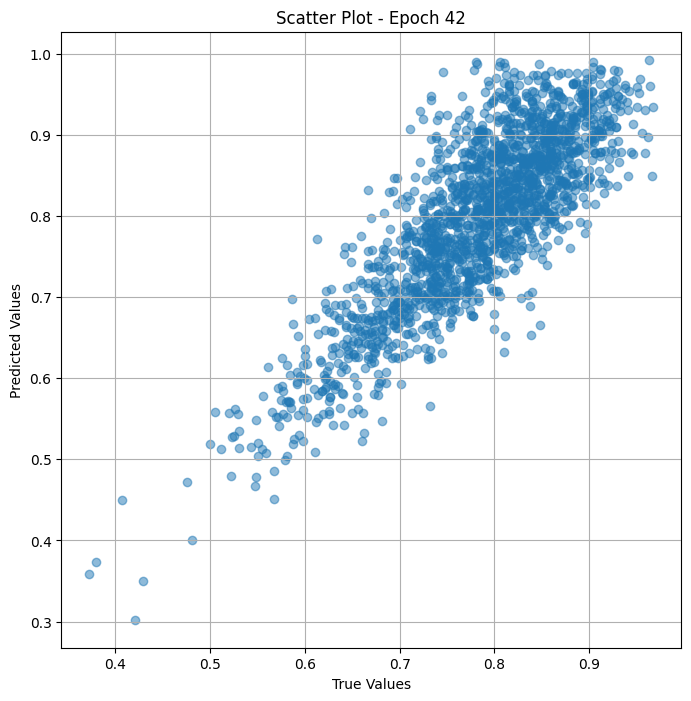


 Epoch: (43/50) Loss = 0.002648124936968088

 Epoch: (43/50) Loss_rmse = 0.05145993456244469

 Epoch: (43/50) R^2 = 0.6431558728218079

 Epoch: (43/50) MAE = 0.0467371791601181

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319,

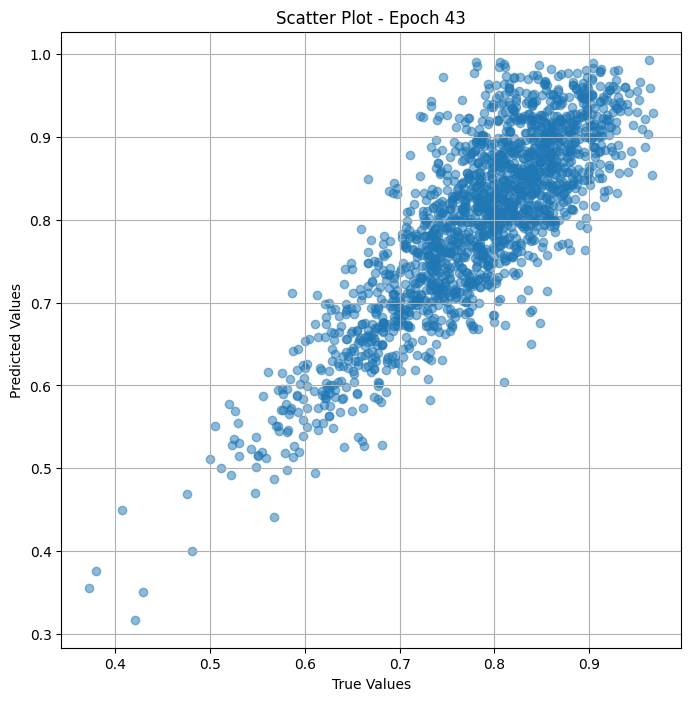


 Epoch: (44/50) Loss = 0.00254524452611804

 Epoch: (44/50) Loss_rmse = 0.05045041814446449

 Epoch: (44/50) R^2 = 0.6570193767547607

 Epoch: (44/50) MAE = 0.0458059087395668

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 

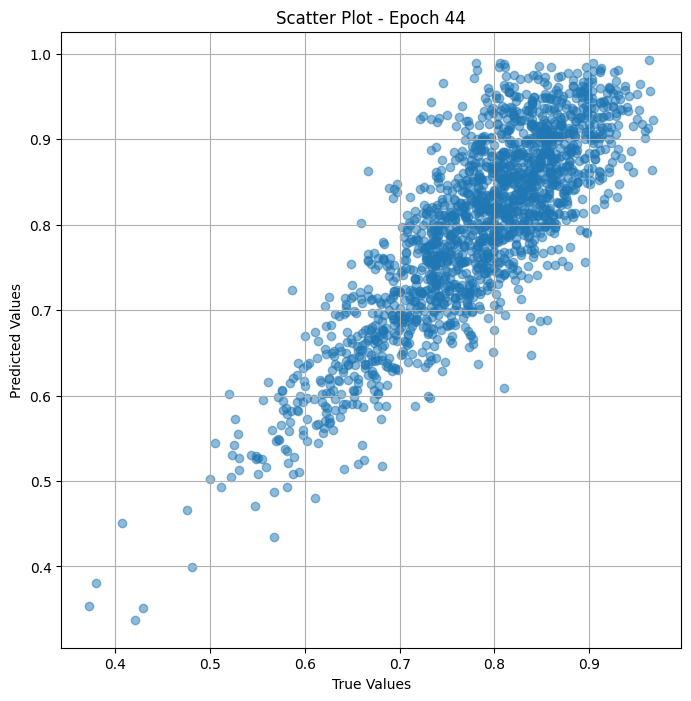


 Epoch: (45/50) Loss = 0.0025322886649519205

 Epoch: (45/50) Loss_rmse = 0.050321850925683975

 Epoch: (45/50) R^2 = 0.6587651968002319

 Epoch: (45/50) MAE = 0.04523333162069321

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

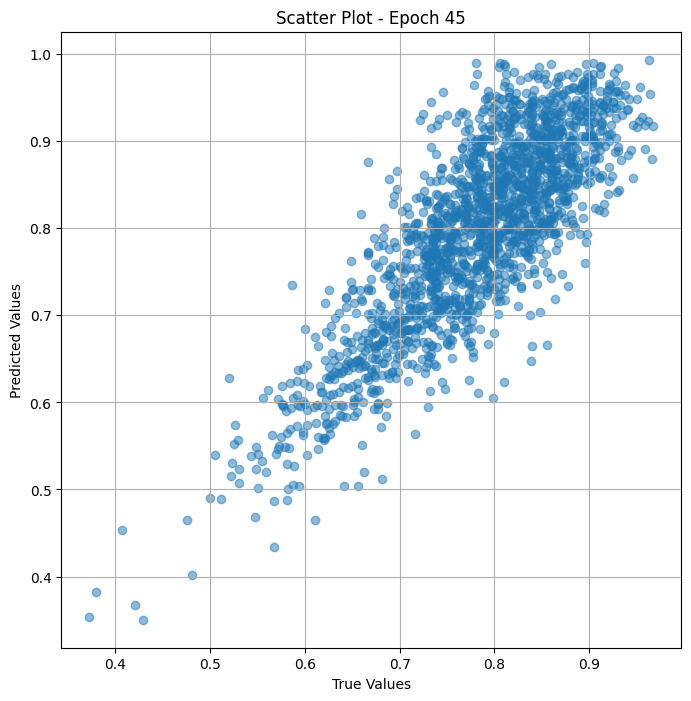


 Epoch: (46/50) Loss = 0.002579824533313513

 Epoch: (46/50) Loss_rmse = 0.05079197138547897

 Epoch: (46/50) R^2 = 0.6523596048355103

 Epoch: (46/50) MAE = 0.04477196931838989

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

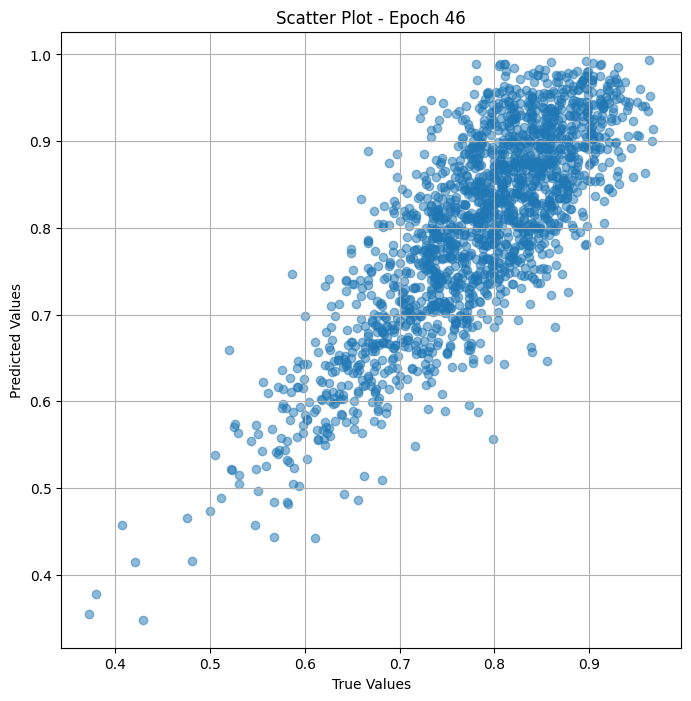


 Epoch: (47/50) Loss = 0.002719010692089796

 Epoch: (47/50) Loss_rmse = 0.0521441325545311

 Epoch: (47/50) R^2 = 0.6336038112640381

 Epoch: (47/50) MAE = 0.043895356357097626

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

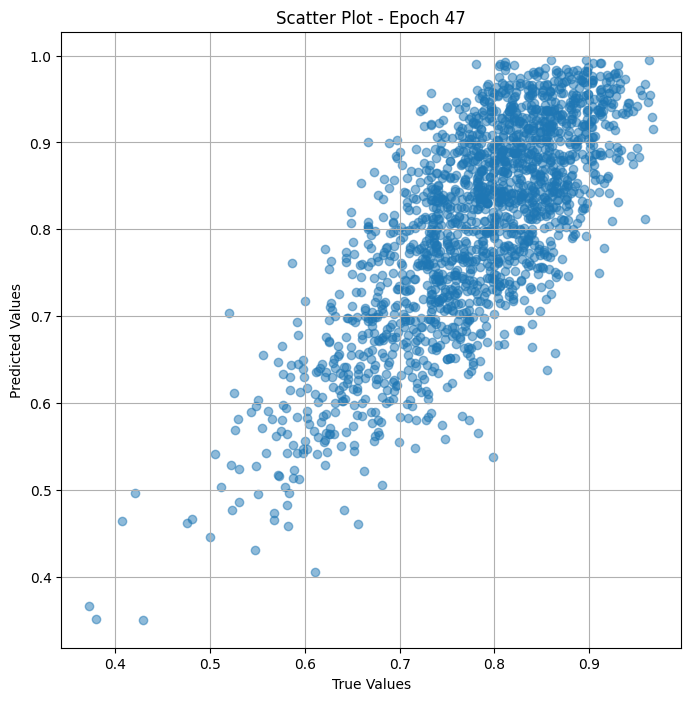


 Epoch: (48/50) Loss = 0.0034571336582303047

 Epoch: (48/50) Loss_rmse = 0.05879739671945572

 Epoch: (48/50) R^2 = 0.5341391563415527

 Epoch: (48/50) MAE = 0.049579598009586334

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

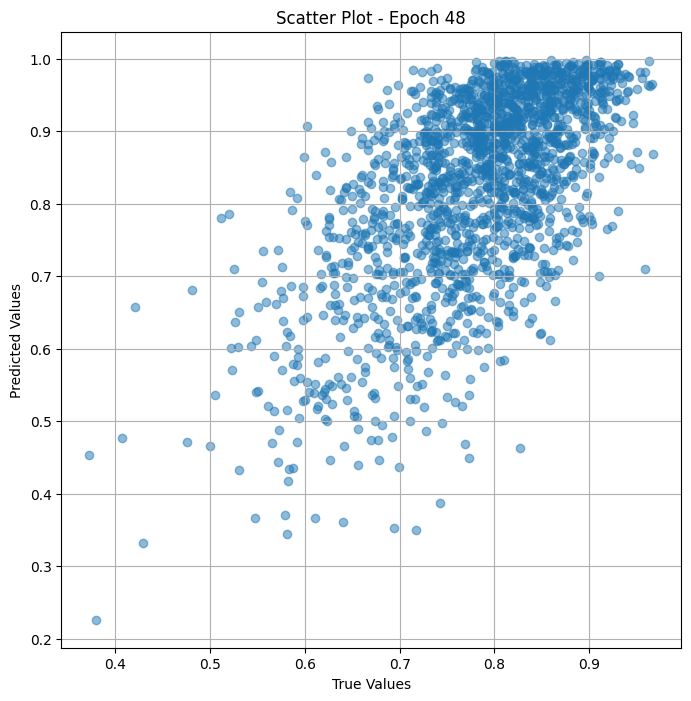


 Epoch: (49/50) Loss = 0.020627930760383606

 Epoch: (49/50) Loss_rmse = 0.14362427592277527

 Epoch: (49/50) R^2 = -1.7796859741210938

 Epoch: (49/50) MAE = 0.1296692043542862

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

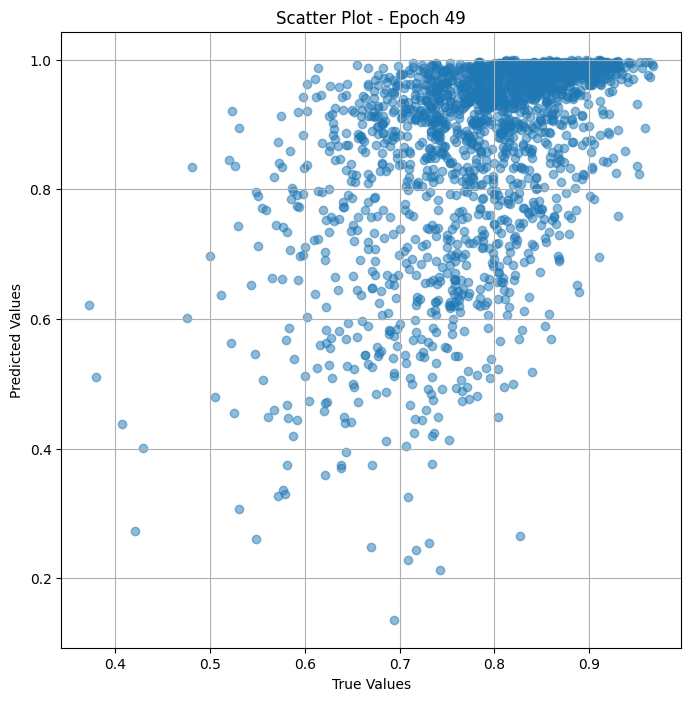


 Epoch: (50/50) Loss = 0.012101528234779835

 Epoch: (50/50) Loss_rmse = 0.11000694334506989

 Epoch: (50/50) R^2 = -0.6307233572006226

 Epoch: (50/50) MAE = 0.1041155532002449

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

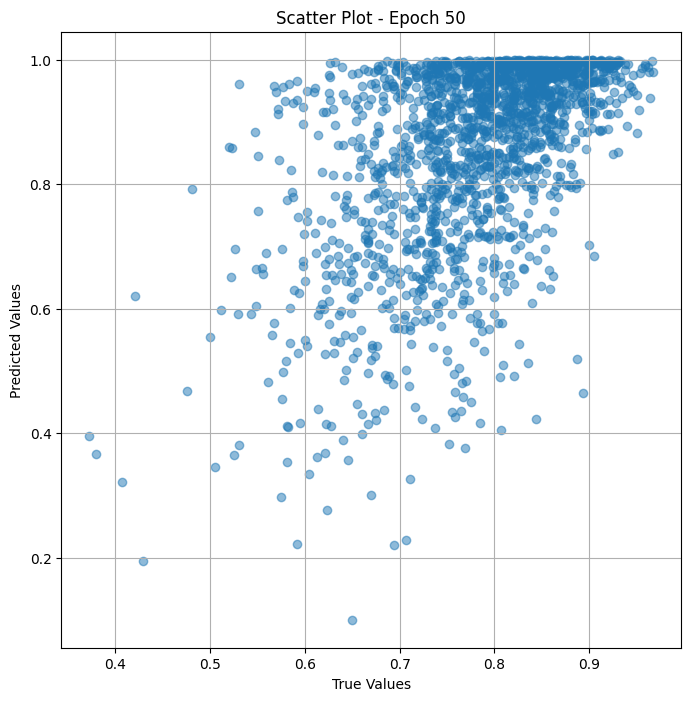

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S")

## Valid

In [ ]:
class Dataset_val(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_val(df_val_sports, trans_transform=trans_transform, res_transform=res_transform)
train_dl_val = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_val = model_merge_val(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
model_val = to_device(model_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/100) Loss = 0.03152976557612419

 Epoch: (1/100) Loss_rmse = 0.17756623029708862

 Epoch: (1/100) R^2 = -9.680195808410645

 Epoch: (1/100) MAE = 0.16347819566726685

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

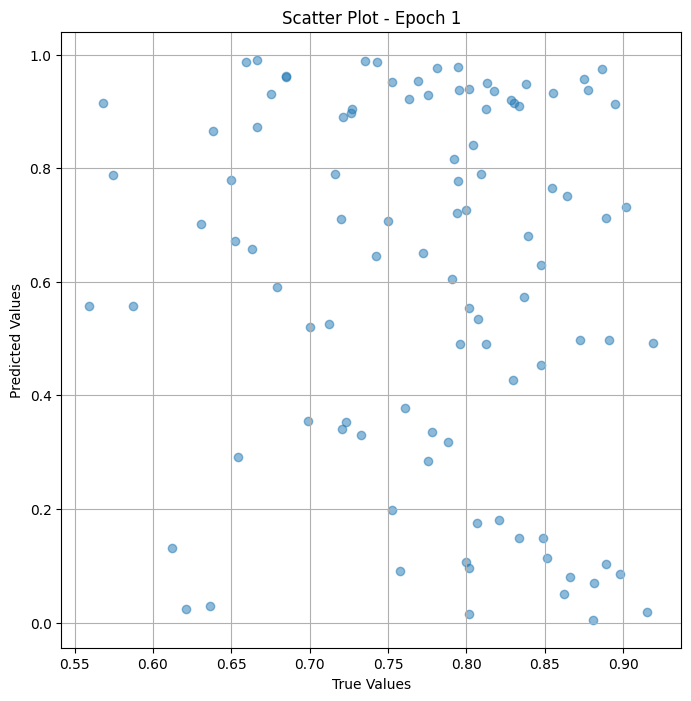


 Epoch: (2/100) Loss = 0.04988815635442734

 Epoch: (2/100) Loss_rmse = 0.22335657477378845

 Epoch: (2/100) R^2 = -15.8988037109375

 Epoch: (2/100) MAE = 0.2172175794839859

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0

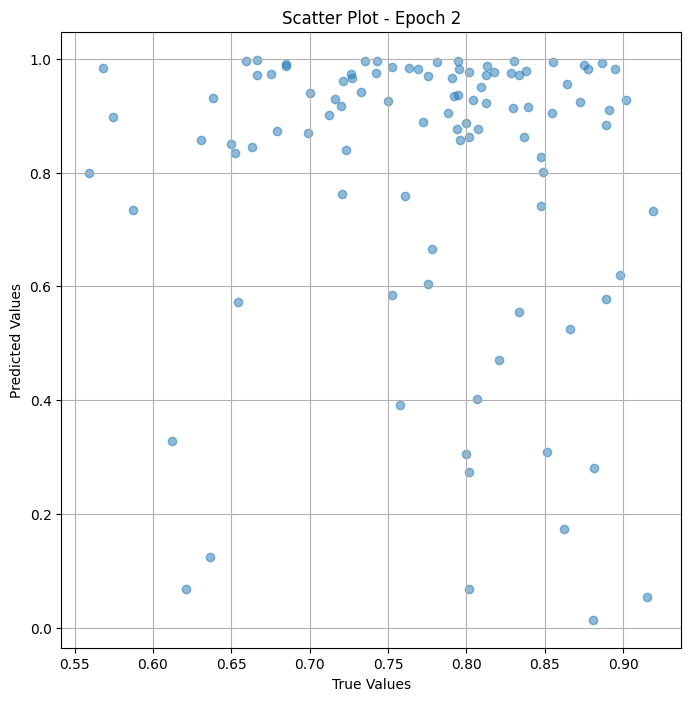


 Epoch: (3/100) Loss = 0.058436065912246704

 Epoch: (3/100) Loss_rmse = 0.2417355328798294

 Epoch: (3/100) R^2 = -18.794267654418945

 Epoch: (3/100) MAE = 0.23679547011852264

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

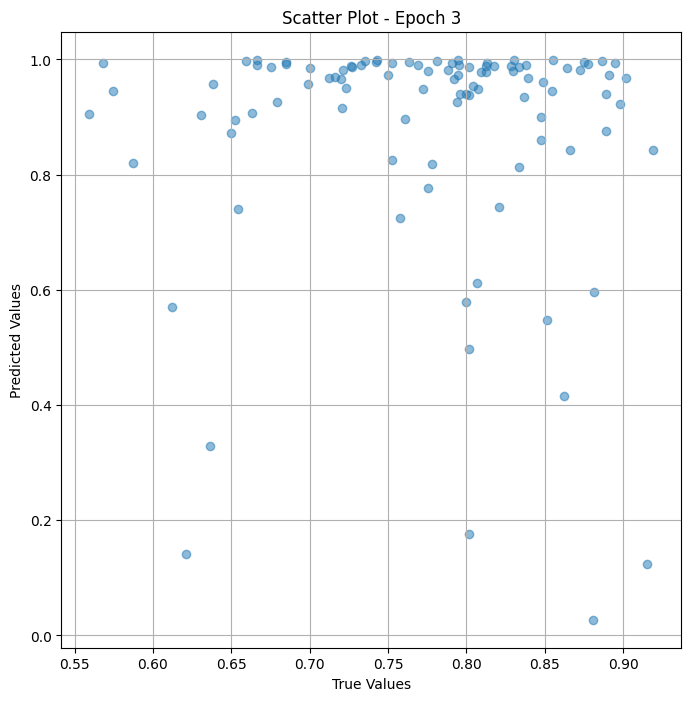


 Epoch: (4/100) Loss = 0.05985957384109497

 Epoch: (4/100) Loss_rmse = 0.24466216564178467

 Epoch: (4/100) R^2 = -19.276458740234375

 Epoch: (4/100) MAE = 0.23989467322826385

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

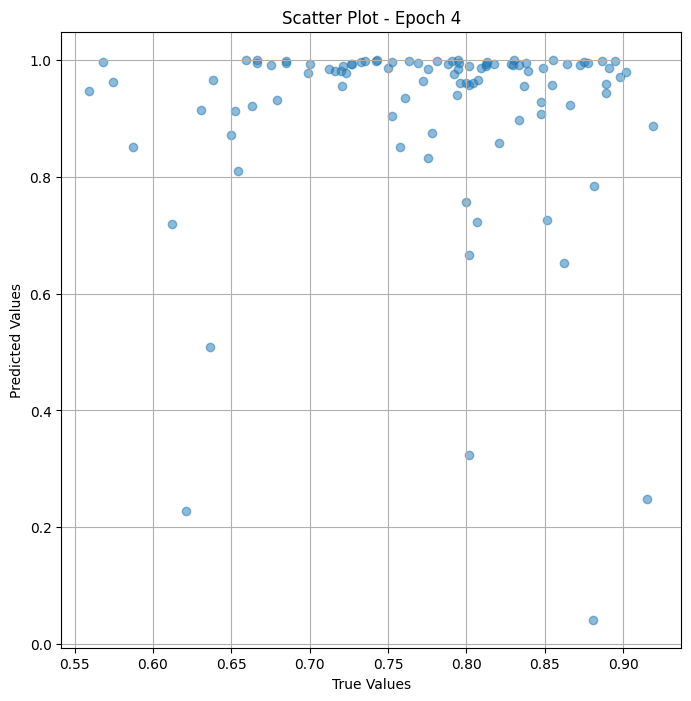


 Epoch: (5/100) Loss = 0.05744641274213791

 Epoch: (5/100) Loss_rmse = 0.23967981338500977

 Epoch: (5/100) R^2 = -18.45903968811035

 Epoch: (5/100) MAE = 0.23487523198127747

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

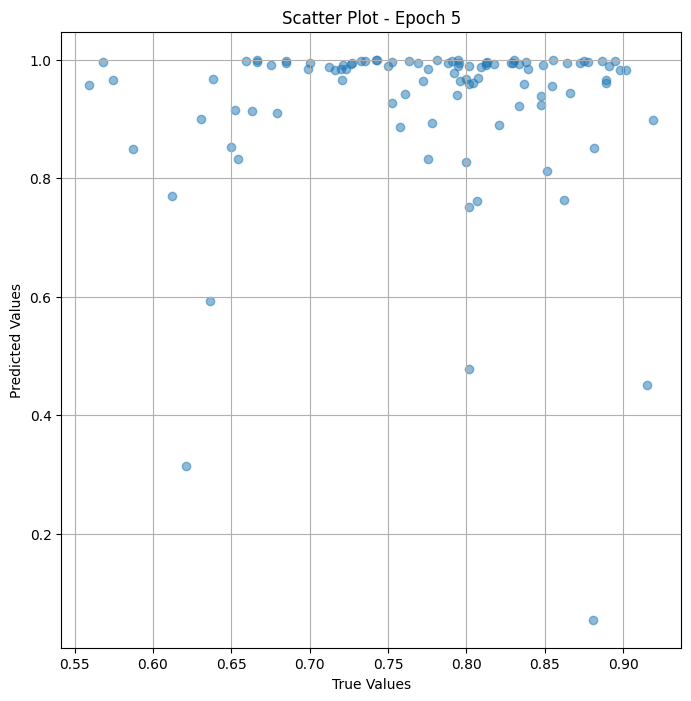


 Epoch: (6/100) Loss = 0.05100119486451149

 Epoch: (6/100) Loss_rmse = 0.2258344441652298

 Epoch: (6/100) R^2 = -16.275827407836914

 Epoch: (6/100) MAE = 0.2188607156276703

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 

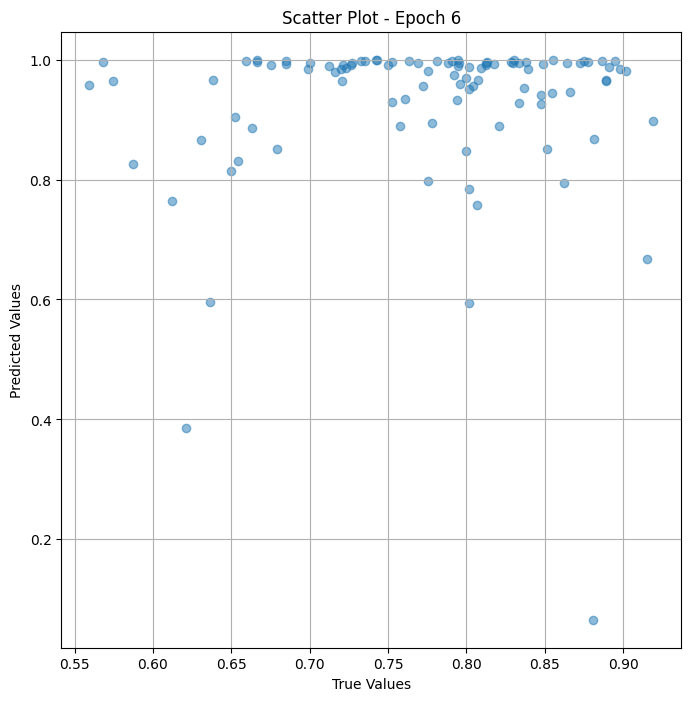


 Epoch: (7/100) Loss = 0.04290430247783661

 Epoch: (7/100) Loss_rmse = 0.20713353157043457

 Epoch: (7/100) R^2 = -13.533135414123535

 Epoch: (7/100) MAE = 0.1827591359615326

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

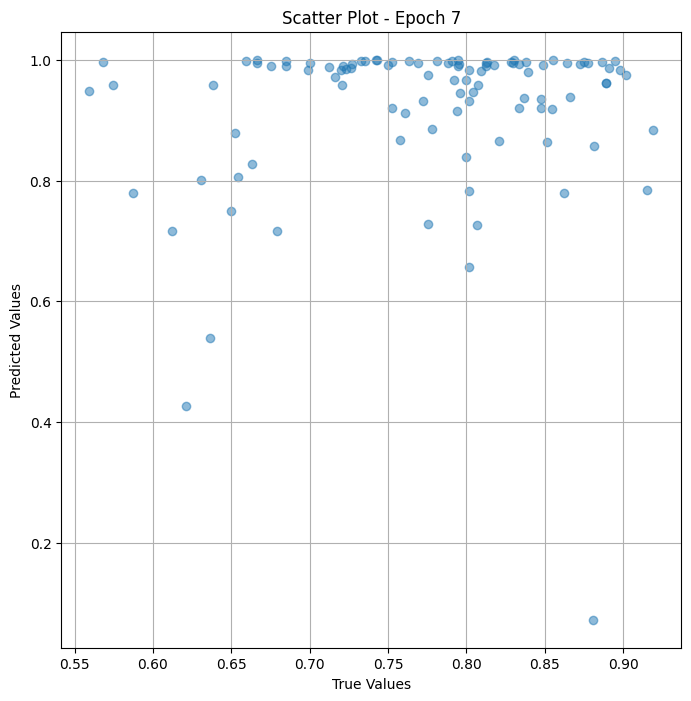


 Epoch: (8/100) Loss = 0.04351060464978218

 Epoch: (8/100) Loss_rmse = 0.20859195291996002

 Epoch: (8/100) R^2 = -13.738511085510254

 Epoch: (8/100) MAE = 0.19517020881175995

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

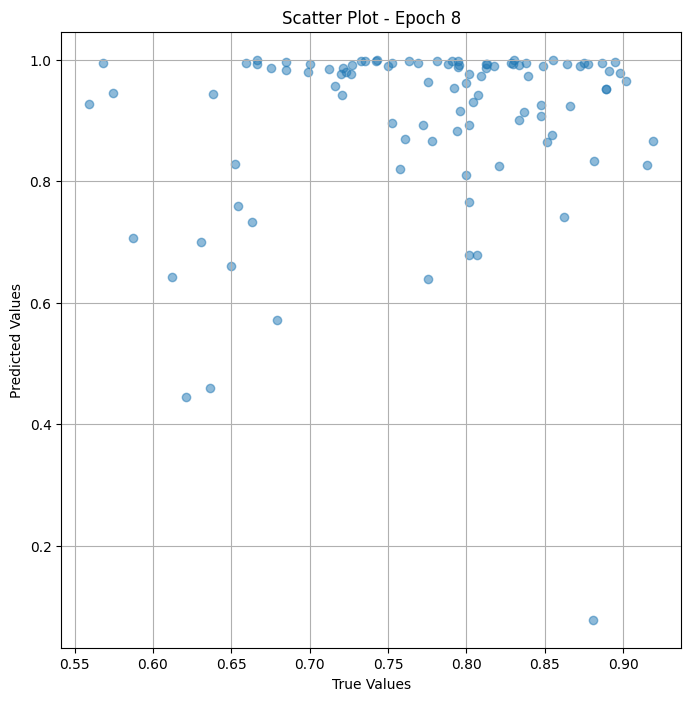


 Epoch: (9/100) Loss = 0.03910034894943237

 Epoch: (9/100) Loss_rmse = 0.19773808121681213

 Epoch: (9/100) R^2 = -12.244607925415039

 Epoch: (9/100) MAE = 0.17649248242378235

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

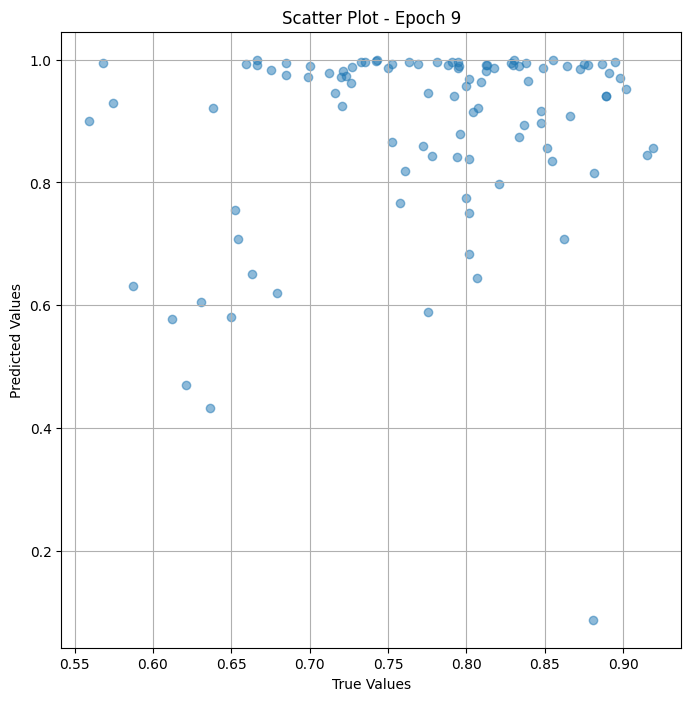


 Epoch: (10/100) Loss = 0.035157617181539536

 Epoch: (10/100) Loss_rmse = 0.1875036507844925

 Epoch: (10/100) R^2 = -10.909071922302246

 Epoch: (10/100) MAE = 0.1578150987625122

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

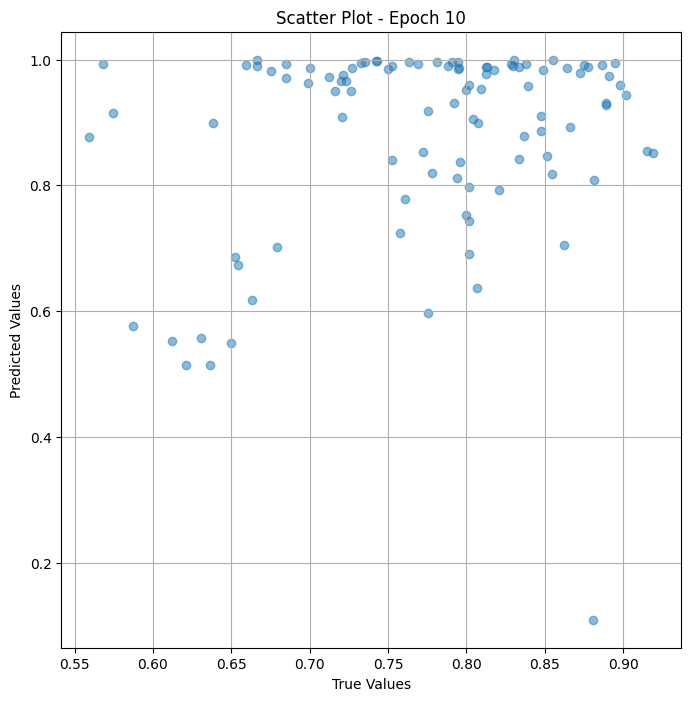


 Epoch: (11/100) Loss = 0.03062768653035164

 Epoch: (11/100) Loss_rmse = 0.1750076711177826

 Epoch: (11/100) R^2 = -9.374631881713867

 Epoch: (11/100) MAE = 0.14073097705841064

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65934

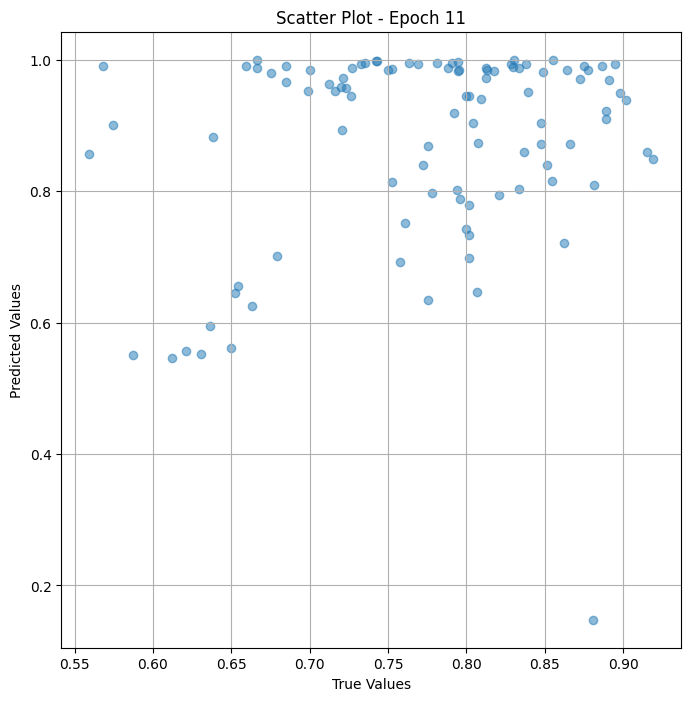


 Epoch: (12/100) Loss = 0.026343416422605515

 Epoch: (12/100) Loss_rmse = 0.162306547164917

 Epoch: (12/100) R^2 = -7.923404693603516

 Epoch: (12/100) MAE = 0.11282996833324432

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65934

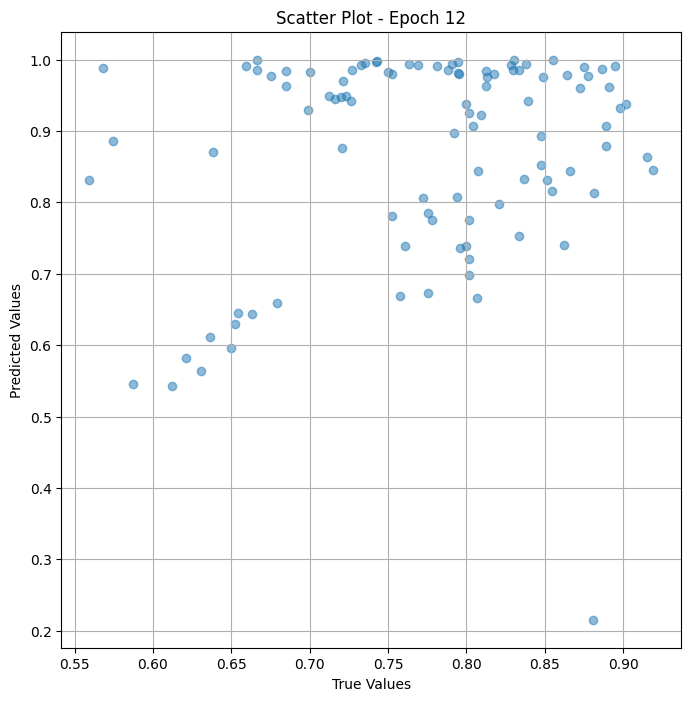


 Epoch: (13/100) Loss = 0.024642525240778923

 Epoch: (13/100) Loss_rmse = 0.15697938203811646

 Epoch: (13/100) R^2 = -7.347255706787109

 Epoch: (13/100) MAE = 0.11919820308685303

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

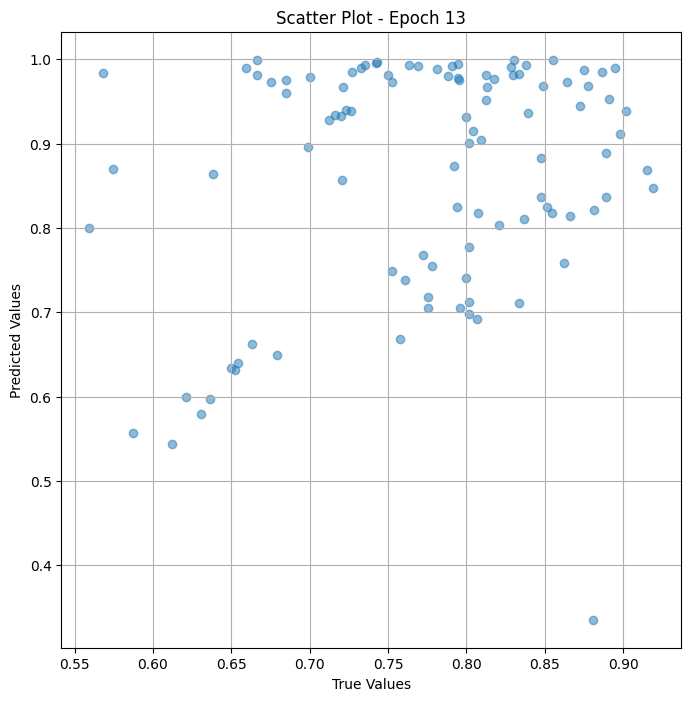


 Epoch: (14/100) Loss = 0.02063101902604103

 Epoch: (14/100) Loss_rmse = 0.14363501965999603

 Epoch: (14/100) R^2 = -5.988422870635986

 Epoch: (14/100) MAE = 0.09944254159927368

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

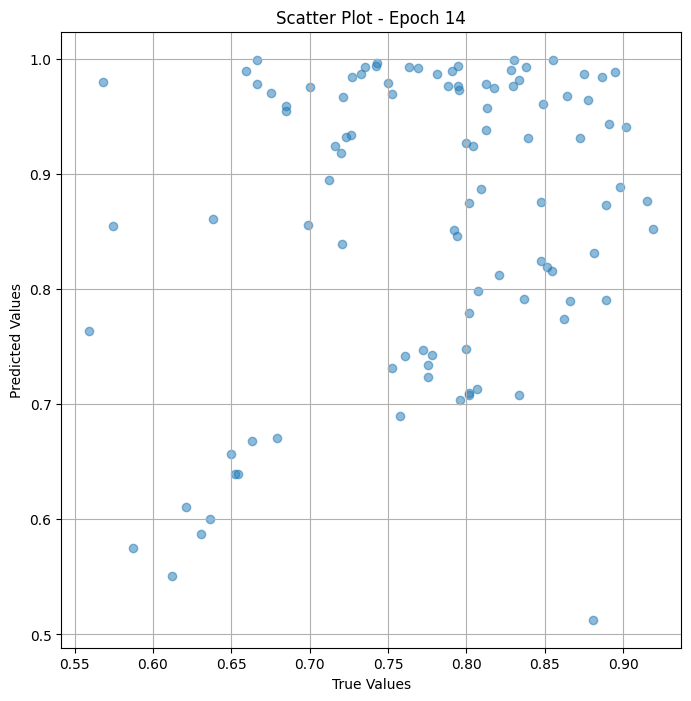


 Epoch: (15/100) Loss = 0.014396673068404198

 Epoch: (15/100) Loss_rmse = 0.1199861392378807

 Epoch: (15/100) R^2 = -3.8766393661499023

 Epoch: (15/100) MAE = 0.0734894871711731

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

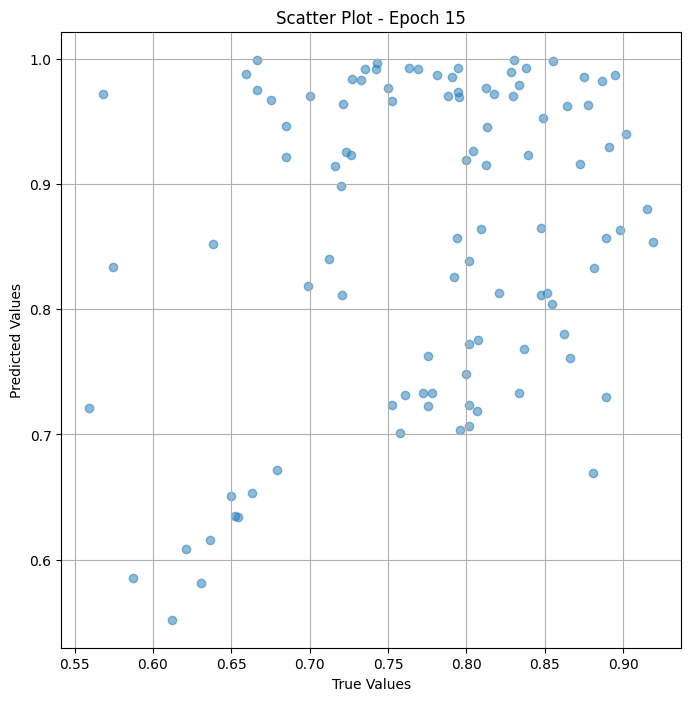


 Epoch: (16/100) Loss = 0.005493279546499252

 Epoch: (16/100) Loss_rmse = 0.07411666214466095

 Epoch: (16/100) R^2 = -0.8607592582702637

 Epoch: (16/100) MAE = 0.04181608557701111

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

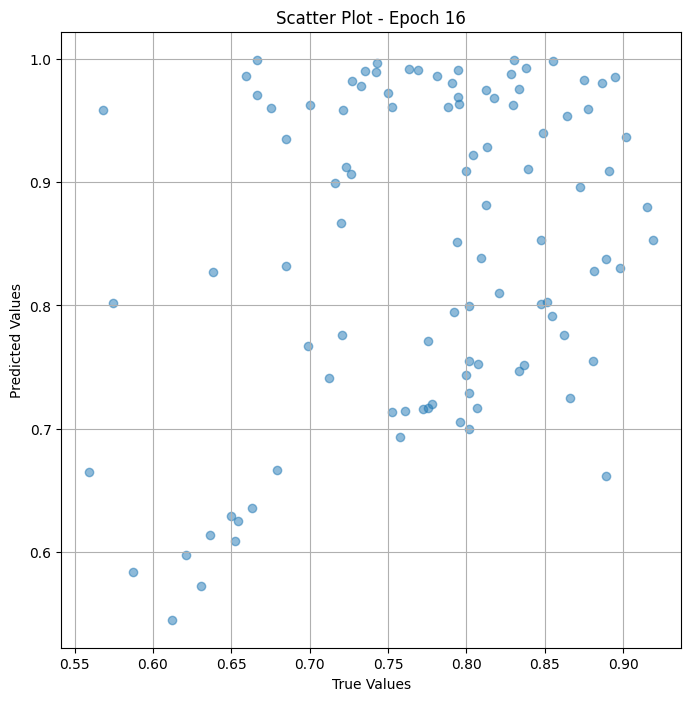


 Epoch: (17/100) Loss = 5.24888928339351e-05

 Epoch: (17/100) Loss_rmse = 0.007244921755045652

 Epoch: (17/100) R^2 = 0.9822202324867249

 Epoch: (17/100) MAE = 0.004473254084587097

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

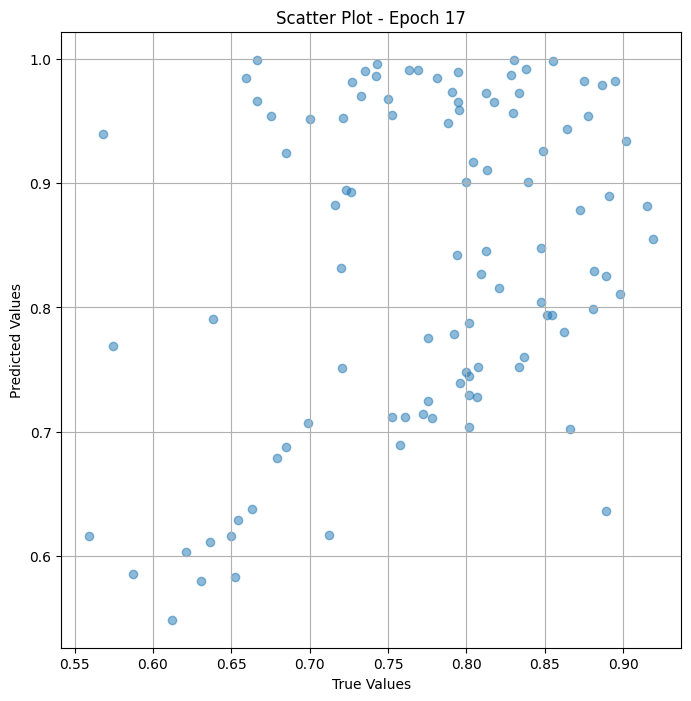


 Epoch: (18/100) Loss = 0.00010315983672626317

 Epoch: (18/100) Loss_rmse = 0.010156762786209583

 Epoch: (18/100) R^2 = 0.965056300163269

 Epoch: (18/100) MAE = 0.008820608258247375

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

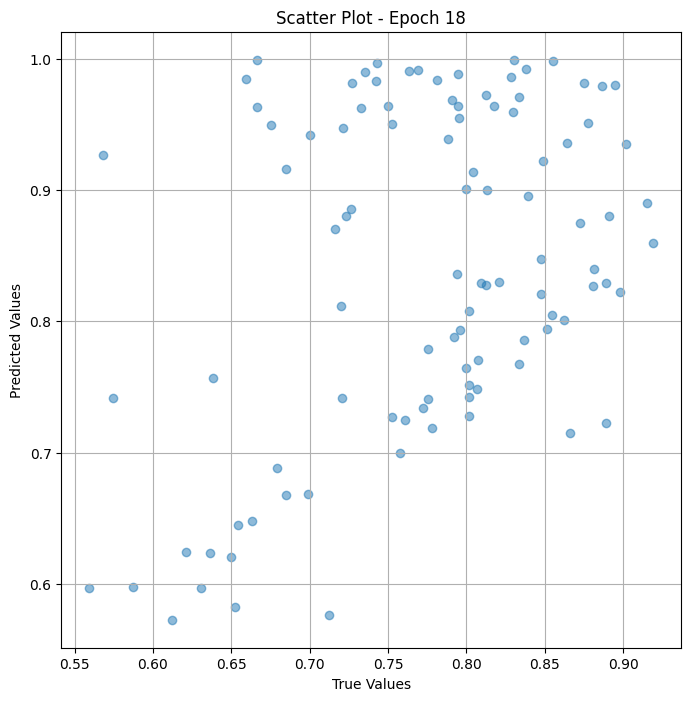


 Epoch: (19/100) Loss = 0.0001801737817004323

 Epoch: (19/100) Loss_rmse = 0.013422883115708828

 Epoch: (19/100) R^2 = 0.938969075679779

 Epoch: (19/100) MAE = 0.013090014457702637

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

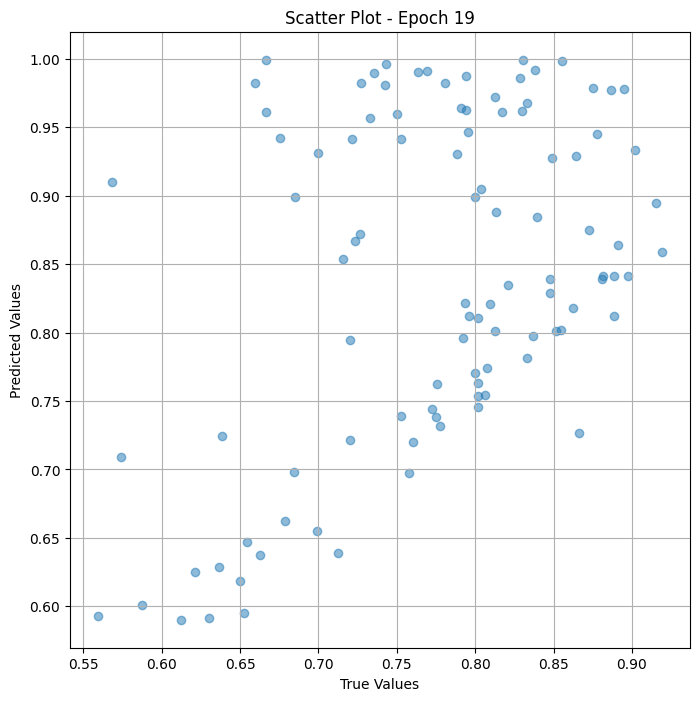


 Epoch: (20/100) Loss = 0.00035520317032933235

 Epoch: (20/100) Loss_rmse = 0.01884683407843113

 Epoch: (20/100) R^2 = 0.8796806931495667

 Epoch: (20/100) MAE = 0.01610991358757019

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

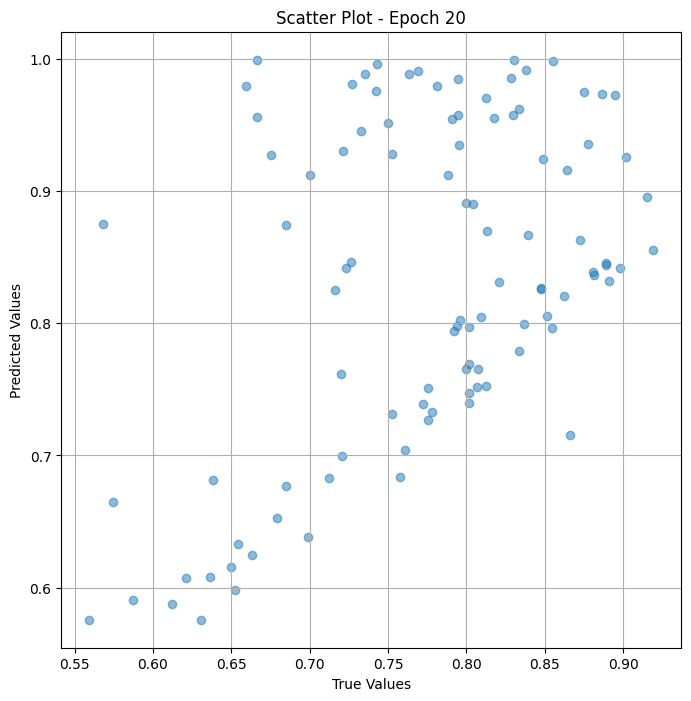


 Epoch: (21/100) Loss = 5.2703435358125716e-05

 Epoch: (21/100) Loss_rmse = 0.007259713020175695

 Epoch: (21/100) R^2 = 0.9821475744247437

 Epoch: (21/100) MAE = 0.006574317812919617

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

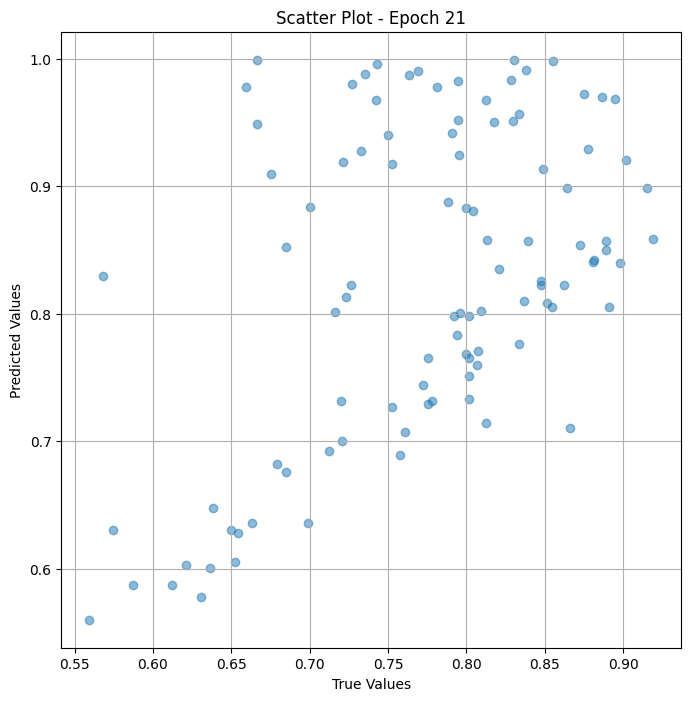


 Epoch: (22/100) Loss = 4.1159360989695415e-05

 Epoch: (22/100) Loss_rmse = 0.006415556184947491

 Epoch: (22/100) R^2 = 0.9860579371452332

 Epoch: (22/100) MAE = 0.005499407649040222

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

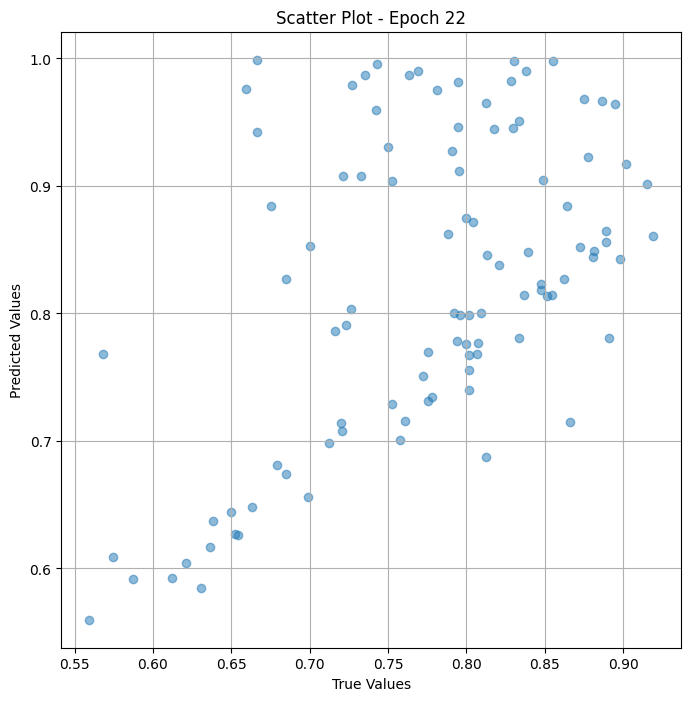


 Epoch: (23/100) Loss = 5.836546188220382e-05

 Epoch: (23/100) Loss_rmse = 0.007639728952199221

 Epoch: (23/100) R^2 = 0.9802296757698059

 Epoch: (23/100) MAE = 0.006875753402709961

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

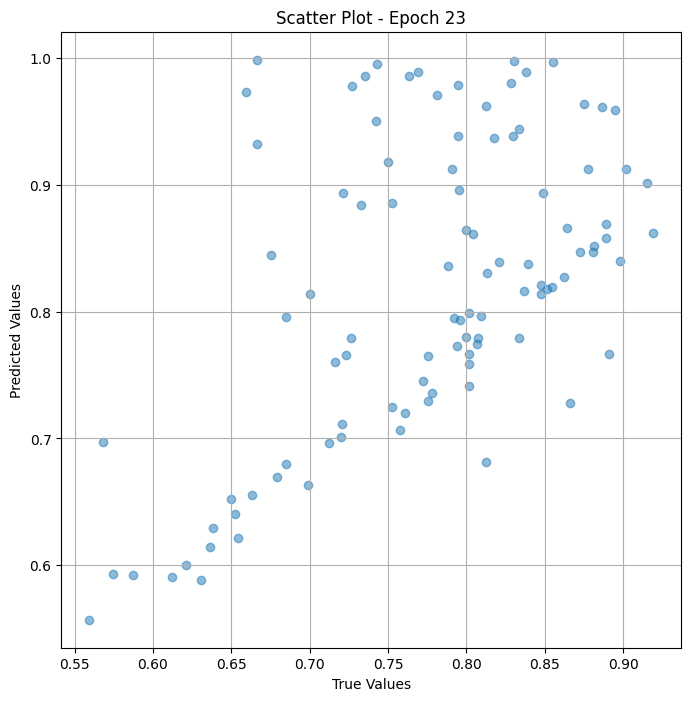


 Epoch: (24/100) Loss = 3.5407330869929865e-05

 Epoch: (24/100) Loss_rmse = 0.005950405728071928

 Epoch: (24/100) R^2 = 0.9880063533782959

 Epoch: (24/100) MAE = 0.0043862611055374146

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

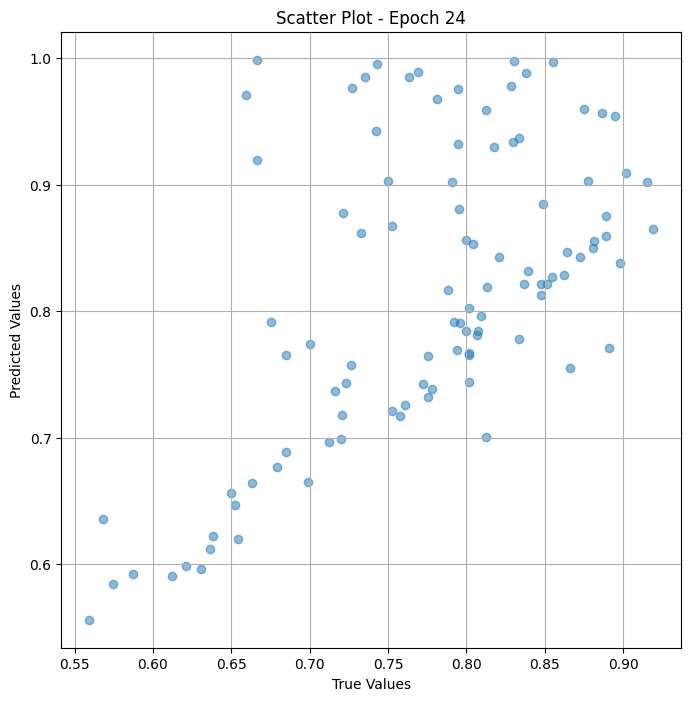


 Epoch: (25/100) Loss = 3.017691597051453e-05

 Epoch: (25/100) Loss_rmse = 0.005493352189660072

 Epoch: (25/100) R^2 = 0.9897780418395996

 Epoch: (25/100) MAE = 0.003882482647895813

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

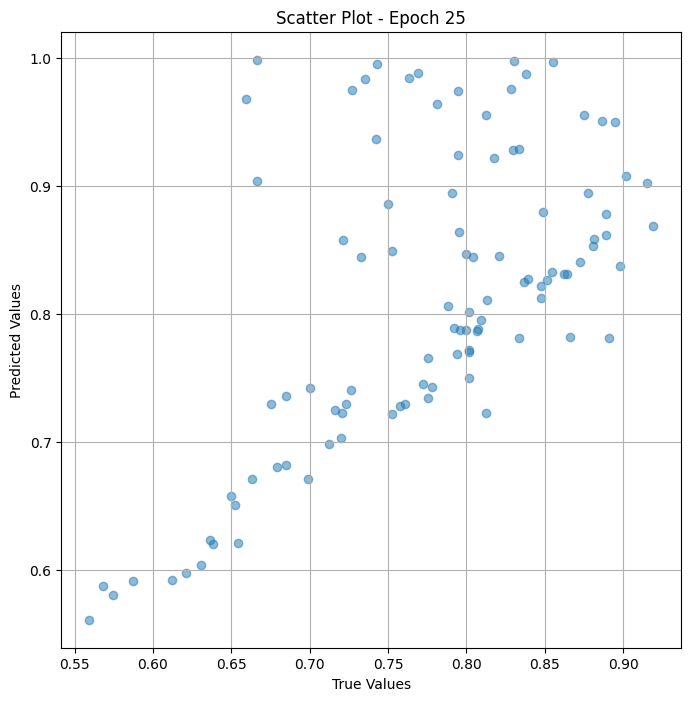


 Epoch: (26/100) Loss = 1.6855750800459646e-05

 Epoch: (26/100) Loss_rmse = 0.004105575382709503

 Epoch: (26/100) R^2 = 0.9942904114723206

 Epoch: (26/100) MAE = 0.0025739967823028564

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

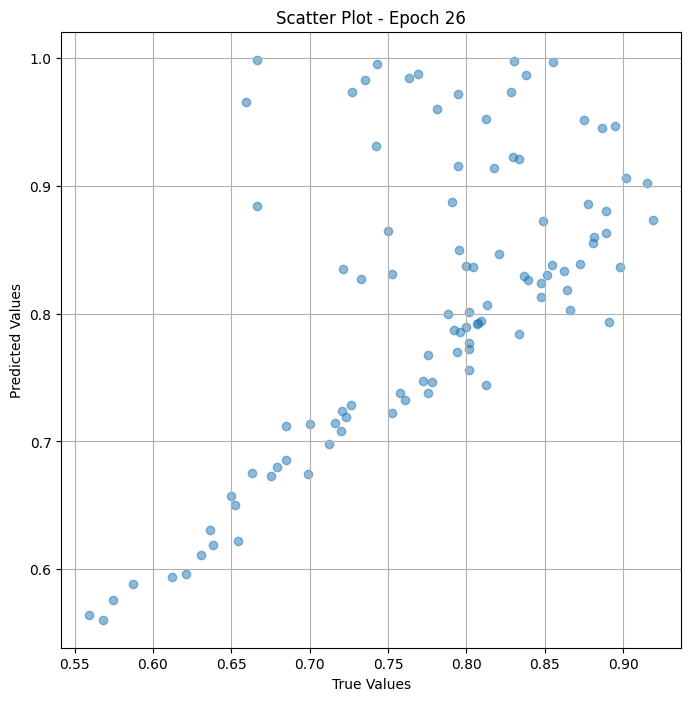


 Epoch: (27/100) Loss = 1.526278538221959e-05

 Epoch: (27/100) Loss_rmse = 0.003906761296093464

 Epoch: (27/100) R^2 = 0.9948299527168274

 Epoch: (27/100) MAE = 0.0028737783432006836

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

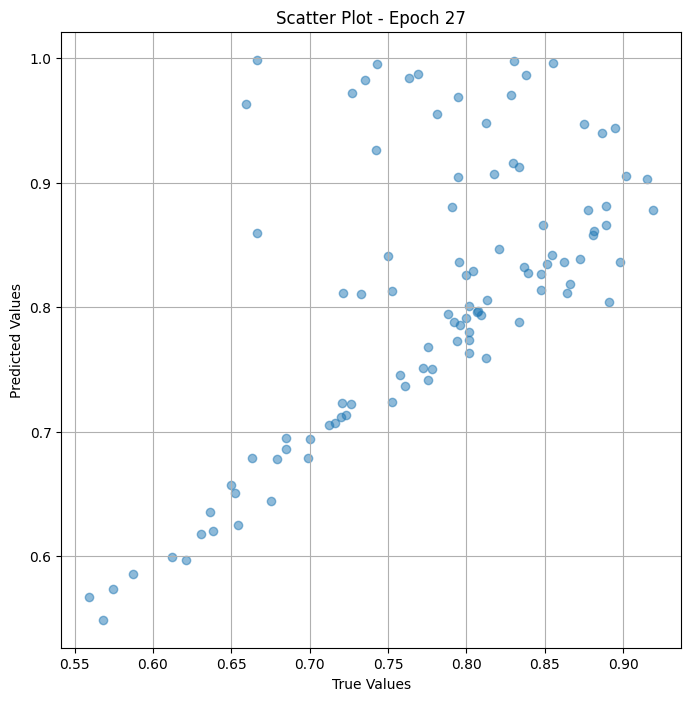


 Epoch: (28/100) Loss = 1.4783489859837573e-05

 Epoch: (28/100) Loss_rmse = 0.003844930324703455

 Epoch: (28/100) R^2 = 0.9949923157691956

 Epoch: (28/100) MAE = 0.0029876679182052612

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

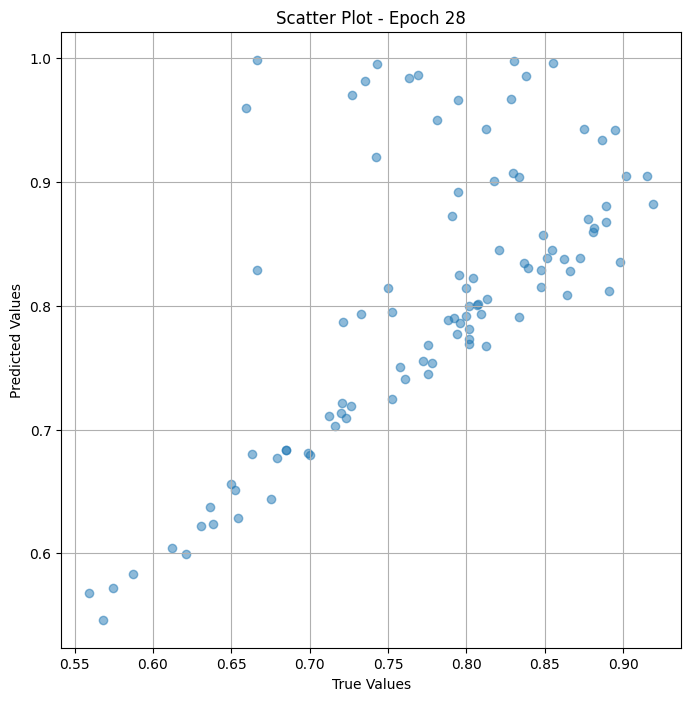


 Epoch: (29/100) Loss = 9.024283826875035e-06

 Epoch: (29/100) Loss_rmse = 0.0030040445271879435

 Epoch: (29/100) R^2 = 0.9969431757926941

 Epoch: (29/100) MAE = 0.002357587218284607

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

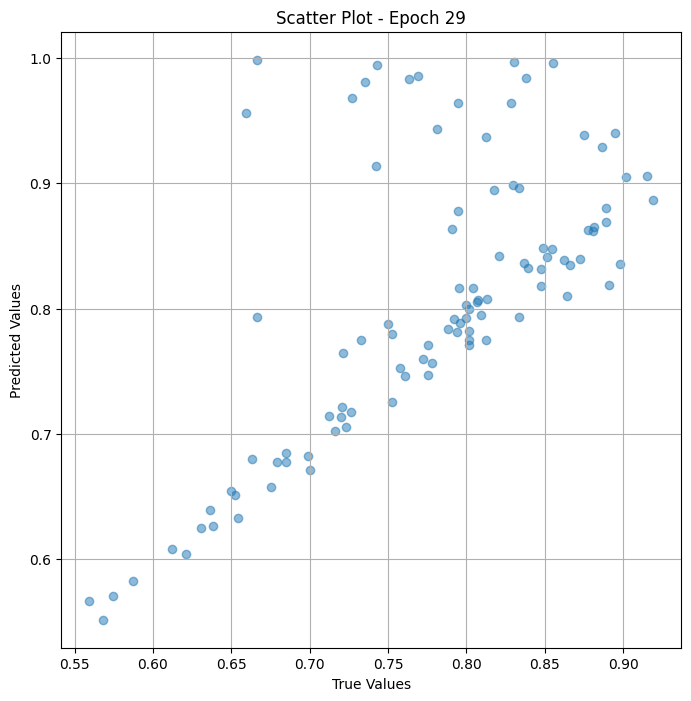


 Epoch: (30/100) Loss = 8.627897841506638e-06

 Epoch: (30/100) Loss_rmse = 0.002937328303232789

 Epoch: (30/100) R^2 = 0.997077465057373

 Epoch: (30/100) MAE = 0.0026875585317611694

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

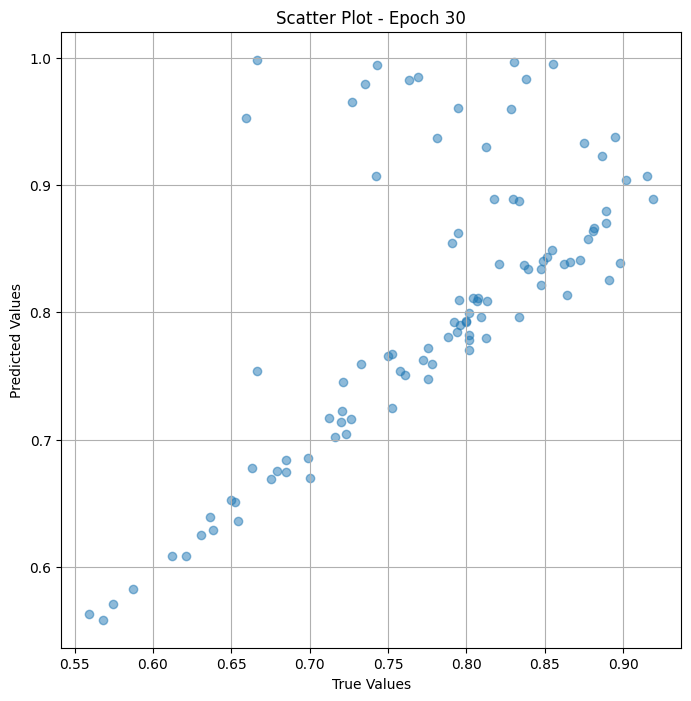


 Epoch: (31/100) Loss = 6.1736918723909184e-06

 Epoch: (31/100) Loss_rmse = 0.0024846915621310472

 Epoch: (31/100) R^2 = 0.9979087710380554

 Epoch: (31/100) MAE = 0.0021468698978424072

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216,

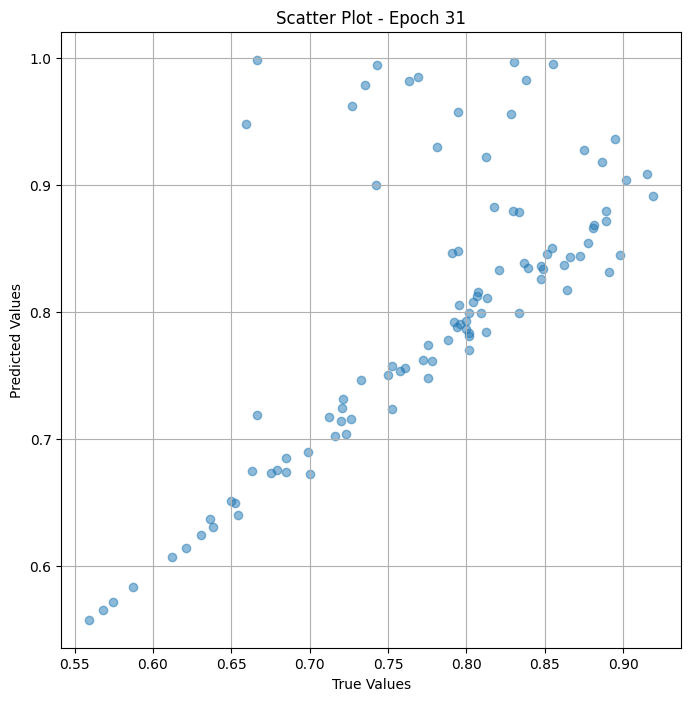


 Epoch: (32/100) Loss = 6.857612788735423e-06

 Epoch: (32/100) Loss_rmse = 0.002618704456835985

 Epoch: (32/100) R^2 = 0.9976770877838135

 Epoch: (32/100) MAE = 0.0024082958698272705

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

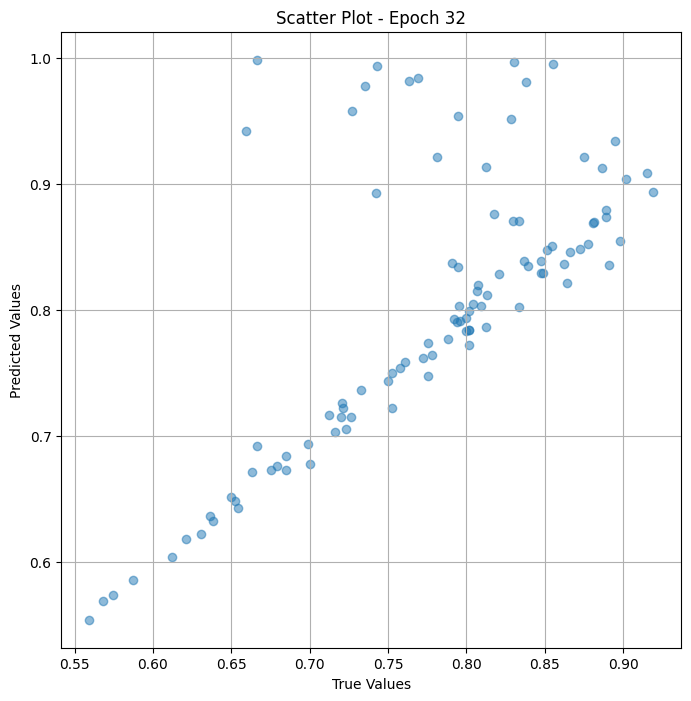


 Epoch: (33/100) Loss = 6.16307397649507e-06

 Epoch: (33/100) Loss_rmse = 0.002482553943991661

 Epoch: (33/100) R^2 = 0.9979123473167419

 Epoch: (33/100) MAE = 0.002151593565940857

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

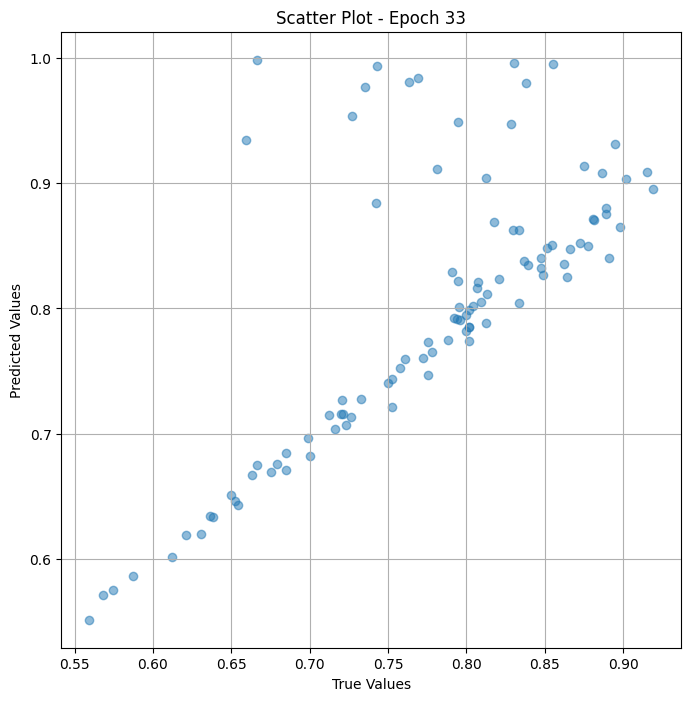


 Epoch: (34/100) Loss = 6.117290467955172e-06

 Epoch: (34/100) Loss_rmse = 0.002473315689712763

 Epoch: (34/100) R^2 = 0.9979278445243835

 Epoch: (34/100) MAE = 0.0021767467260360718

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

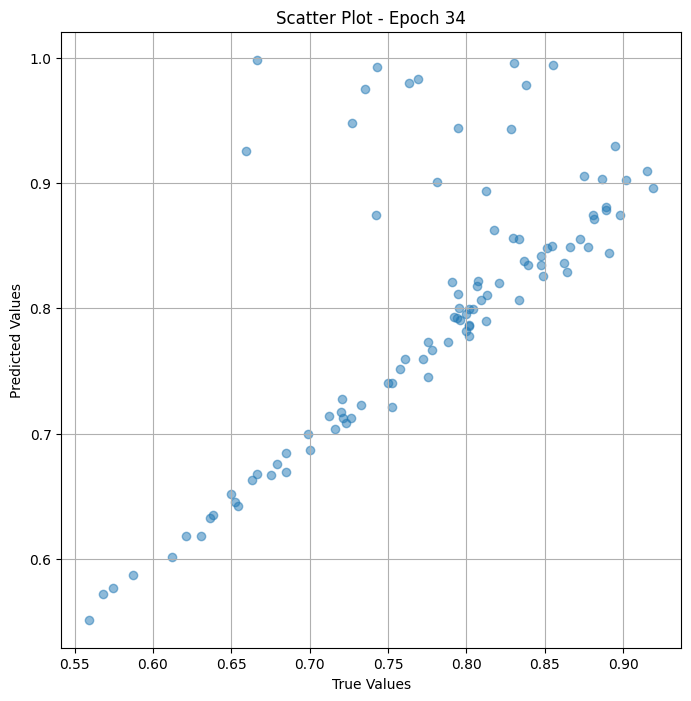


 Epoch: (35/100) Loss = 4.876647835772019e-06

 Epoch: (35/100) Loss_rmse = 0.002208313439041376

 Epoch: (35/100) R^2 = 0.9983481168746948

 Epoch: (35/100) MAE = 0.0019094794988632202

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

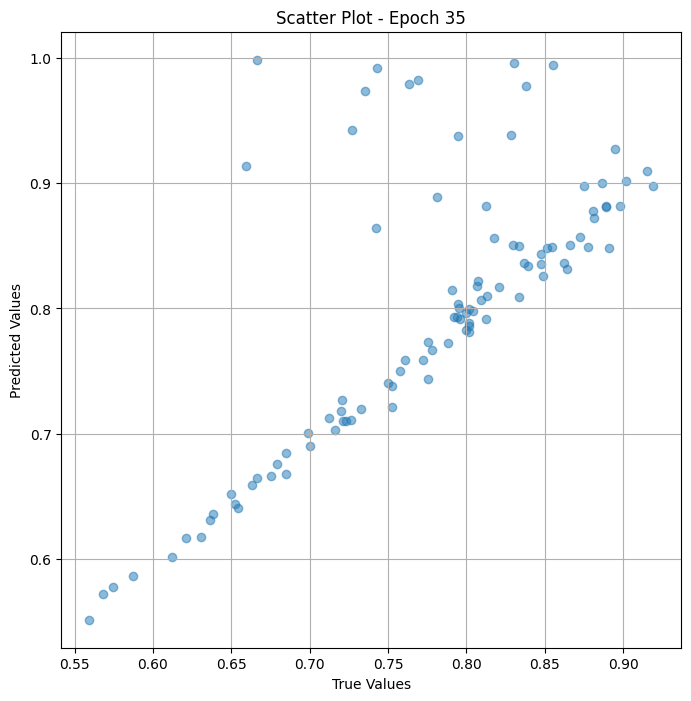


 Epoch: (36/100) Loss = 4.872184035775717e-06

 Epoch: (36/100) Loss_rmse = 0.002207302488386631

 Epoch: (36/100) R^2 = 0.9983496069908142

 Epoch: (36/100) MAE = 0.001929953694343567

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

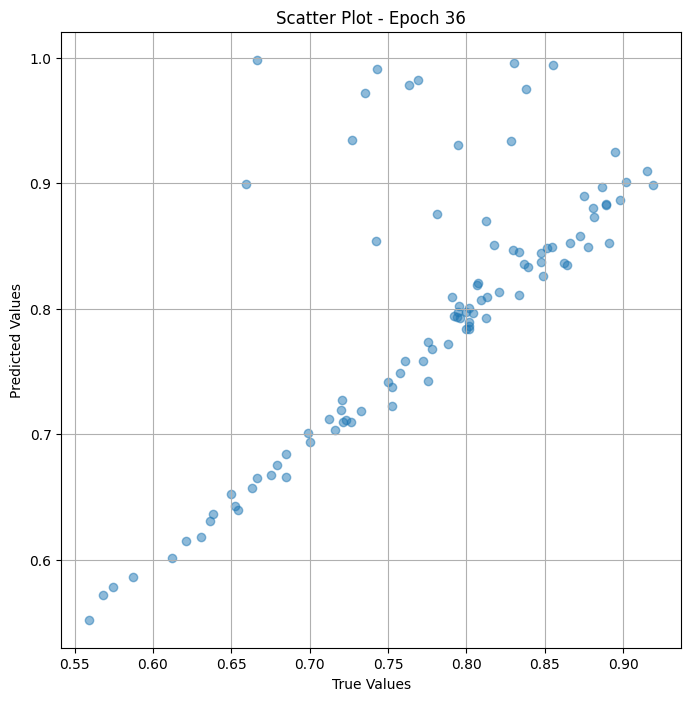


 Epoch: (37/100) Loss = 4.2370438677608036e-06

 Epoch: (37/100) Loss_rmse = 0.0020584079902619123

 Epoch: (37/100) R^2 = 0.9985647797584534

 Epoch: (37/100) MAE = 0.0017234086990356445

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216,

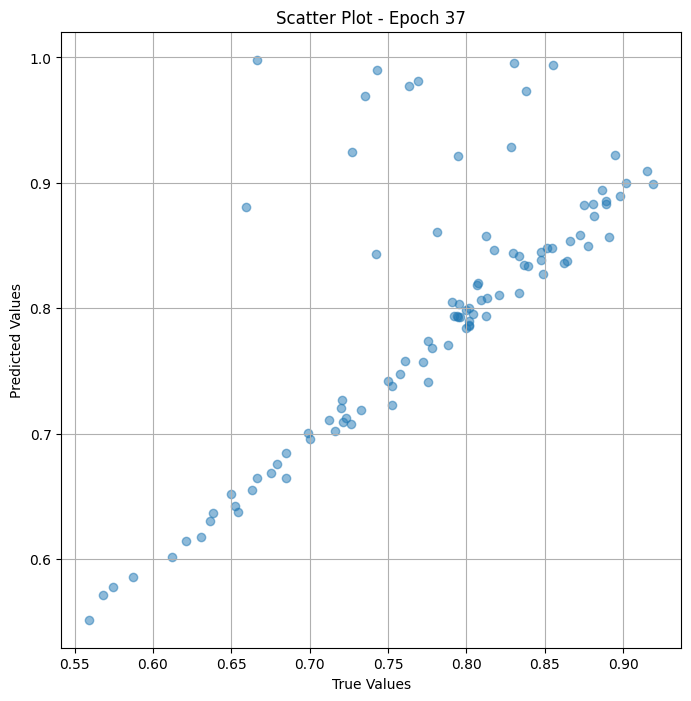


 Epoch: (38/100) Loss = 4.103260380361462e-06

 Epoch: (38/100) Loss_rmse = 0.002025650581344962

 Epoch: (38/100) R^2 = 0.9986100792884827

 Epoch: (38/100) MAE = 0.001743912696838379

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

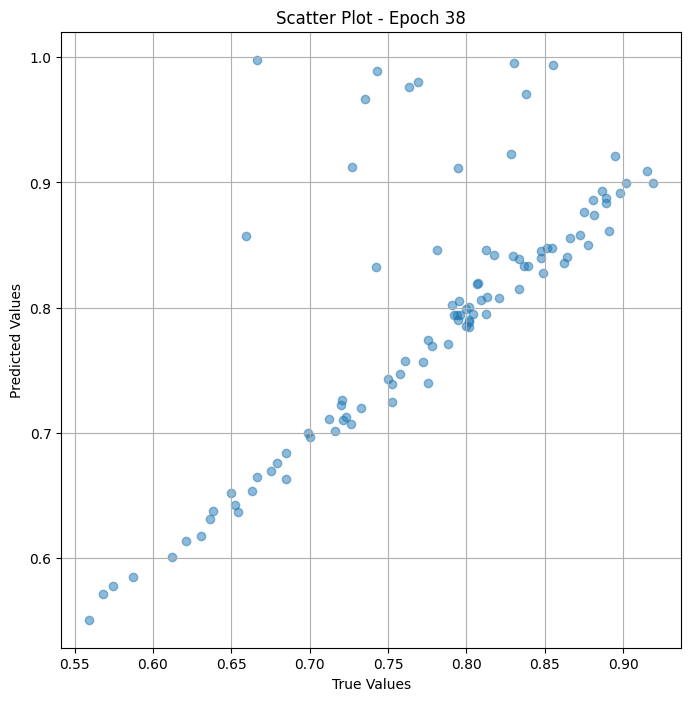


 Epoch: (39/100) Loss = 3.2958685096673435e-06

 Epoch: (39/100) Loss_rmse = 0.0018154527060687542

 Epoch: (39/100) R^2 = 0.9988836050033569

 Epoch: (39/100) MAE = 0.0015104413032531738

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216,

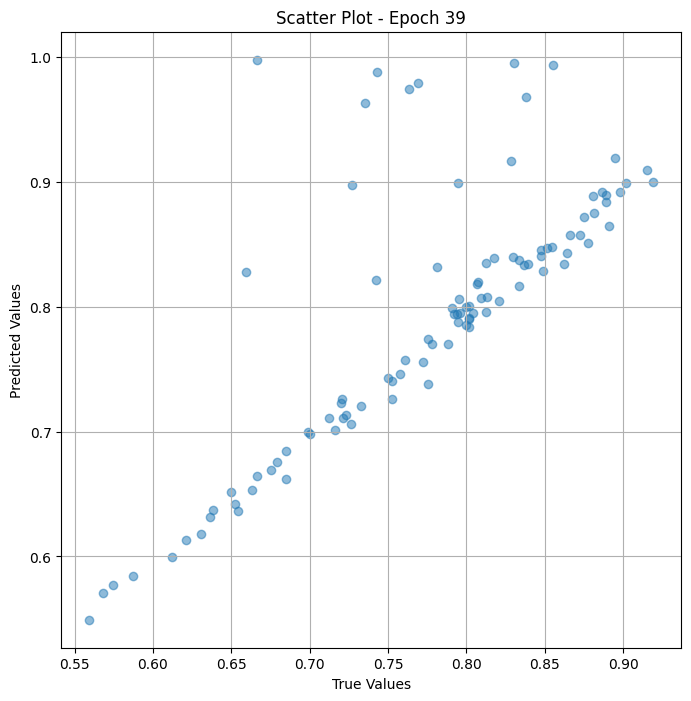


 Epoch: (40/100) Loss = 2.9486161565728253e-06

 Epoch: (40/100) Loss_rmse = 0.0017171534709632397

 Epoch: (40/100) R^2 = 0.9990012049674988

 Epoch: (40/100) MAE = 0.0014846771955490112

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216,

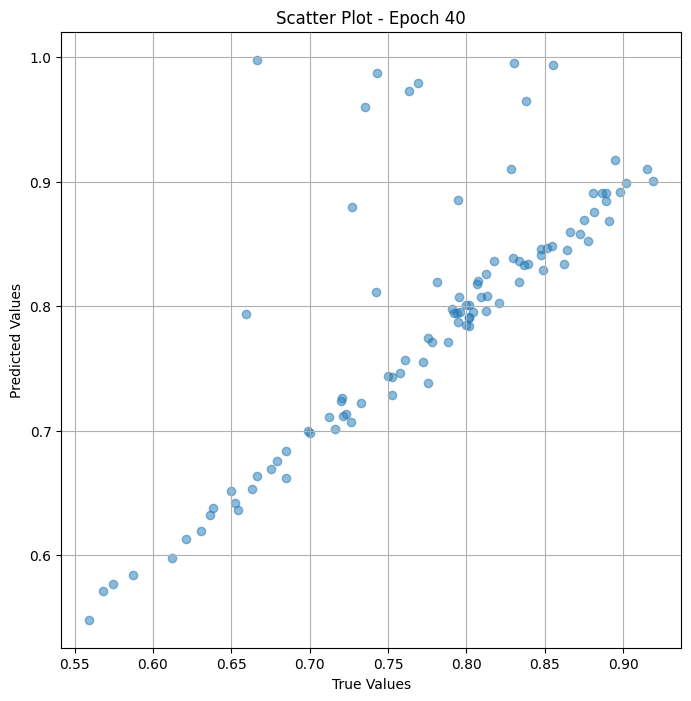


 Epoch: (41/100) Loss = 1.8532523426983971e-06

 Epoch: (41/100) Loss_rmse = 0.0013613421469926834

 Epoch: (41/100) R^2 = 0.9993722438812256

 Epoch: (41/100) MAE = 0.0011378973722457886

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216,

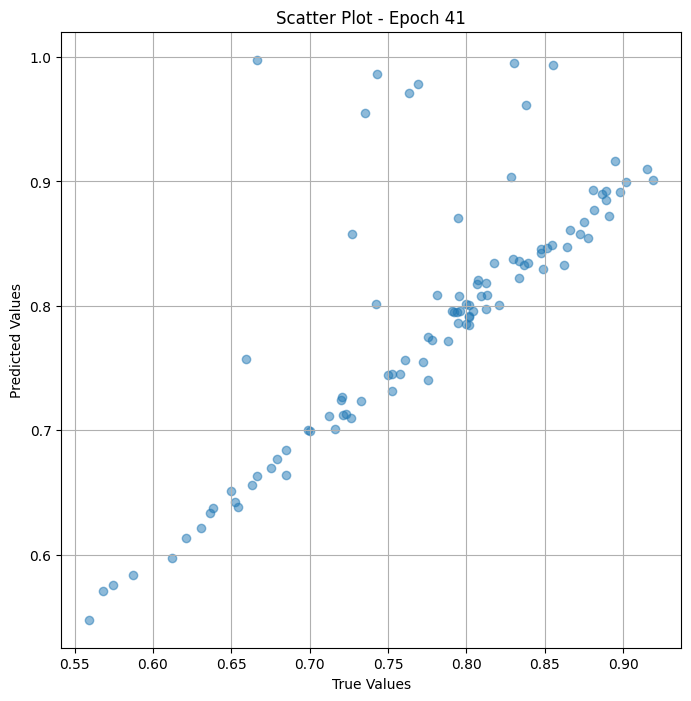


 Epoch: (42/100) Loss = 1.487637064201408e-06

 Epoch: (42/100) Loss_rmse = 0.0012196872849017382

 Epoch: (42/100) R^2 = 0.9994961023330688

 Epoch: (42/100) MAE = 0.0010893940925598145

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

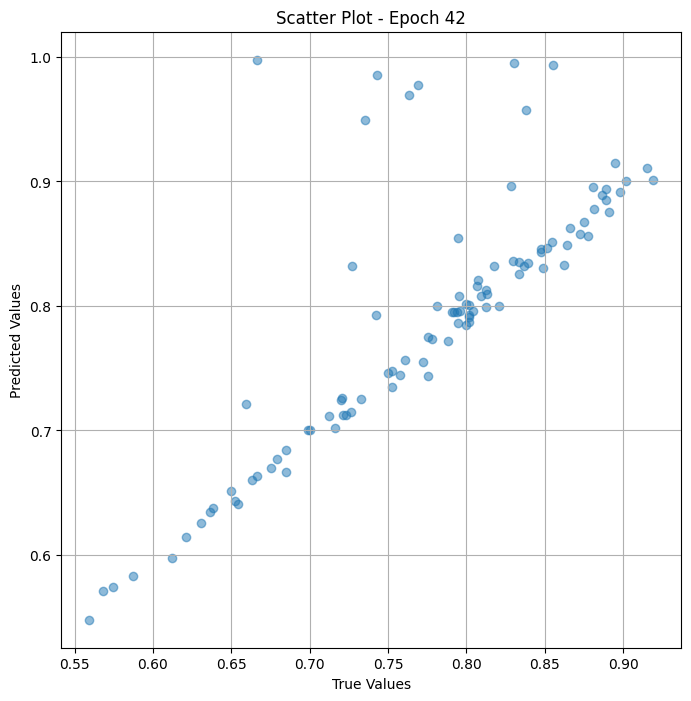


 Epoch: (43/100) Loss = 7.670364539080765e-07

 Epoch: (43/100) Loss_rmse = 0.0008758061449043453

 Epoch: (43/100) R^2 = 0.9997401833534241

 Epoch: (43/100) MAE = 0.0007989108562469482

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

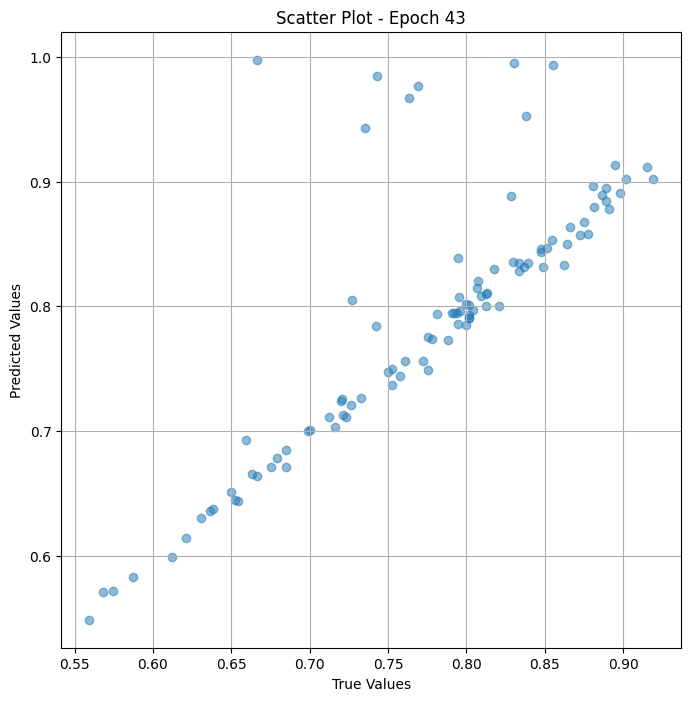


 Epoch: (44/100) Loss = 7.309567990887444e-07

 Epoch: (44/100) Loss_rmse = 0.0008549601188860834

 Epoch: (44/100) R^2 = 0.999752402305603

 Epoch: (44/100) MAE = 0.0006845742464065552

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

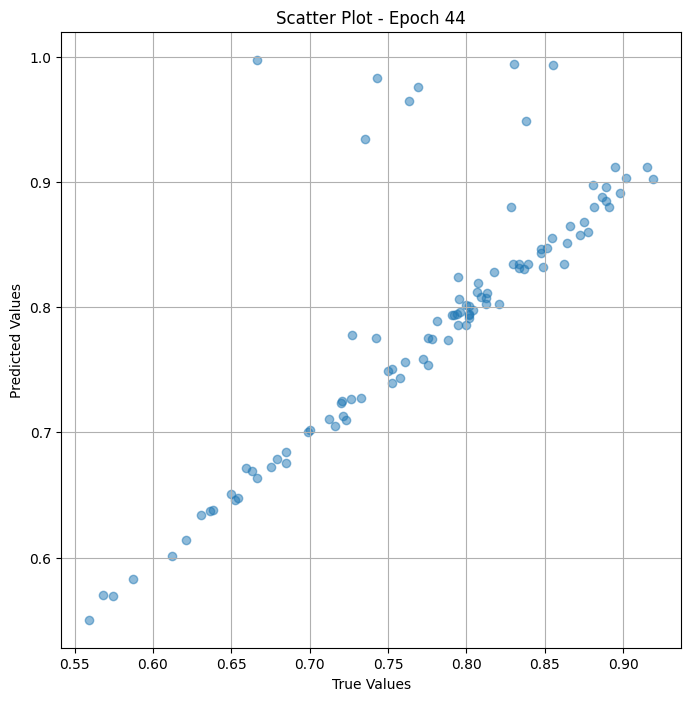


 Epoch: (45/100) Loss = 6.677132660115603e-07

 Epoch: (45/100) Loss_rmse = 0.0008171372464857996

 Epoch: (45/100) R^2 = 0.9997738003730774

 Epoch: (45/100) MAE = 0.0006809383630752563

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

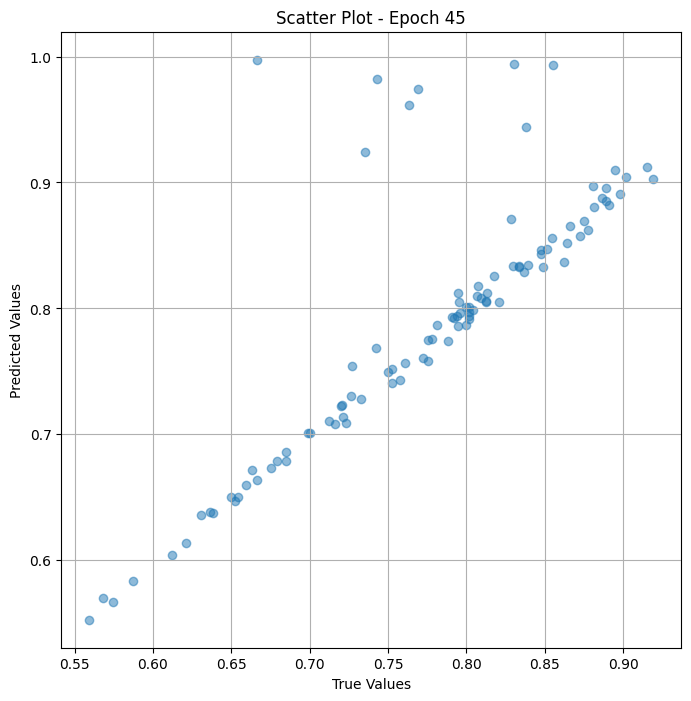


 Epoch: (46/100) Loss = 6.905987675054348e-07

 Epoch: (46/100) Loss_rmse = 0.0008310227422043681

 Epoch: (46/100) R^2 = 0.9997660517692566

 Epoch: (46/100) MAE = 0.0006166845560073853

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

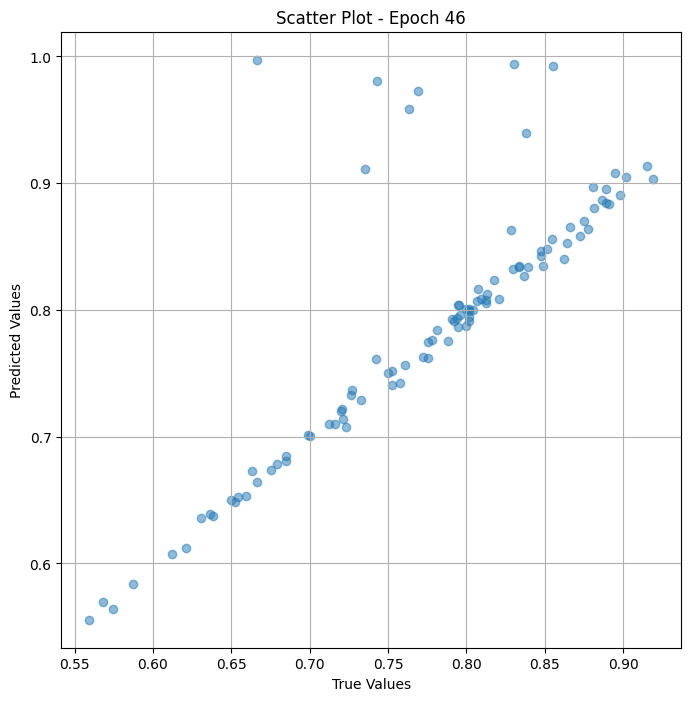


 Epoch: (47/100) Loss = 8.10074766377511e-07

 Epoch: (47/100) Loss_rmse = 0.0009000415448099375

 Epoch: (47/100) R^2 = 0.9997255802154541

 Epoch: (47/100) MAE = 0.0008101612329483032

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

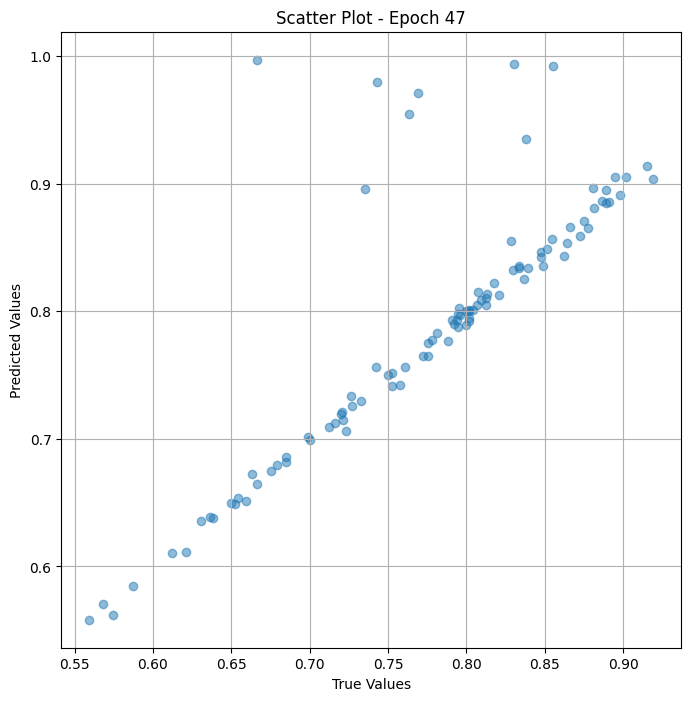


 Epoch: (48/100) Loss = 9.084478733711876e-07

 Epoch: (48/100) Loss_rmse = 0.0009531253017485142

 Epoch: (48/100) R^2 = 0.9996922612190247

 Epoch: (48/100) MAE = 0.0008389502763748169

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

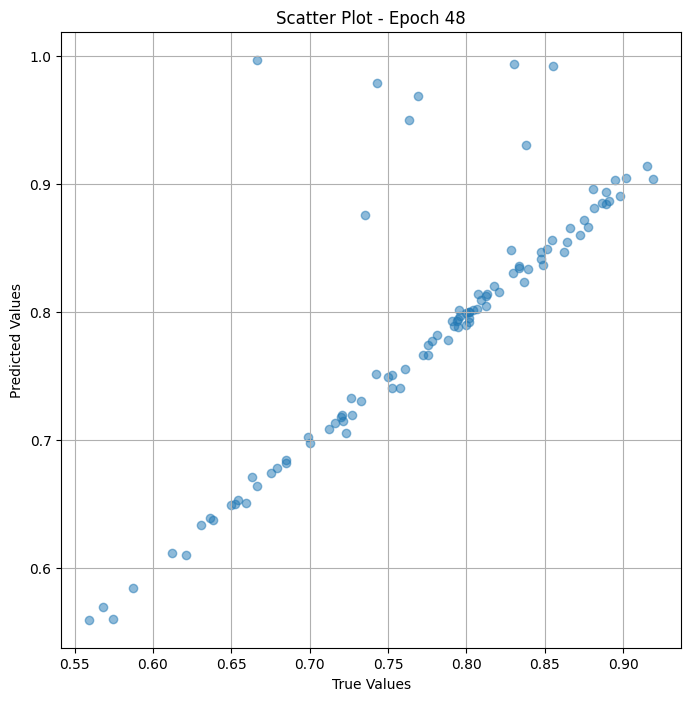


 Epoch: (49/100) Loss = 1.4349977845995454e-06

 Epoch: (49/100) Loss_rmse = 0.001197913894429803

 Epoch: (49/100) R^2 = 0.9995139241218567

 Epoch: (49/100) MAE = 0.001004830002784729

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

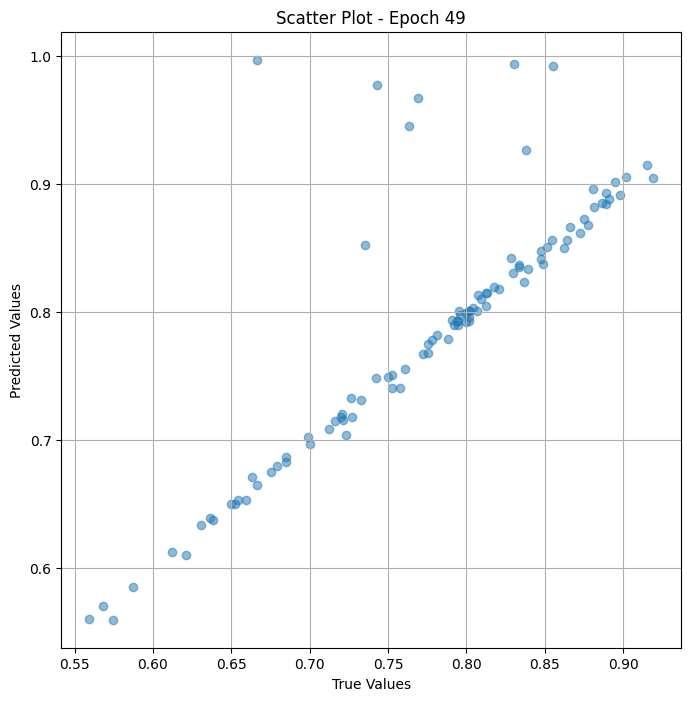


 Epoch: (50/100) Loss = 1.6573421817156486e-06

 Epoch: (50/100) Loss_rmse = 0.0012873780215159059

 Epoch: (50/100) R^2 = 0.9994385838508606

 Epoch: (50/100) MAE = 0.0012341886758804321

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216,

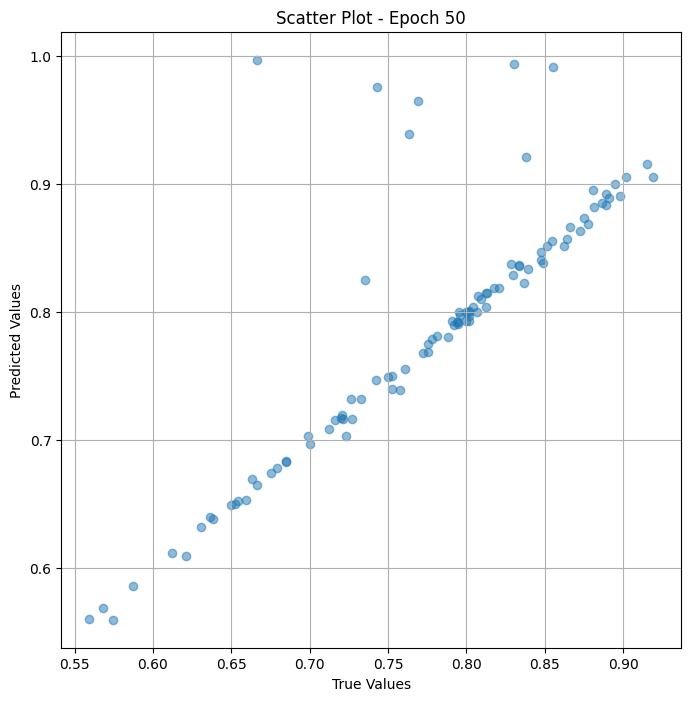


 Epoch: (51/100) Loss = 3.906925030605635e-06

 Epoch: (51/100) Loss_rmse = 0.00197659432888031

 Epoch: (51/100) R^2 = 0.998676598072052

 Epoch: (51/100) MAE = 0.0014192909002304077

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

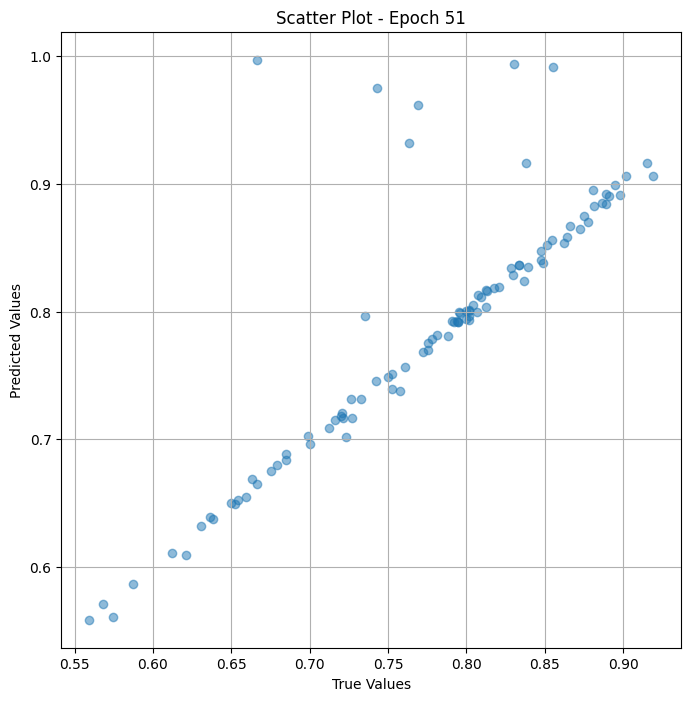


 Epoch: (52/100) Loss = 5.155485268915072e-06

 Epoch: (52/100) Loss_rmse = 0.0022705693263560534

 Epoch: (52/100) R^2 = 0.9982536435127258

 Epoch: (52/100) MAE = 0.0021735578775405884

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

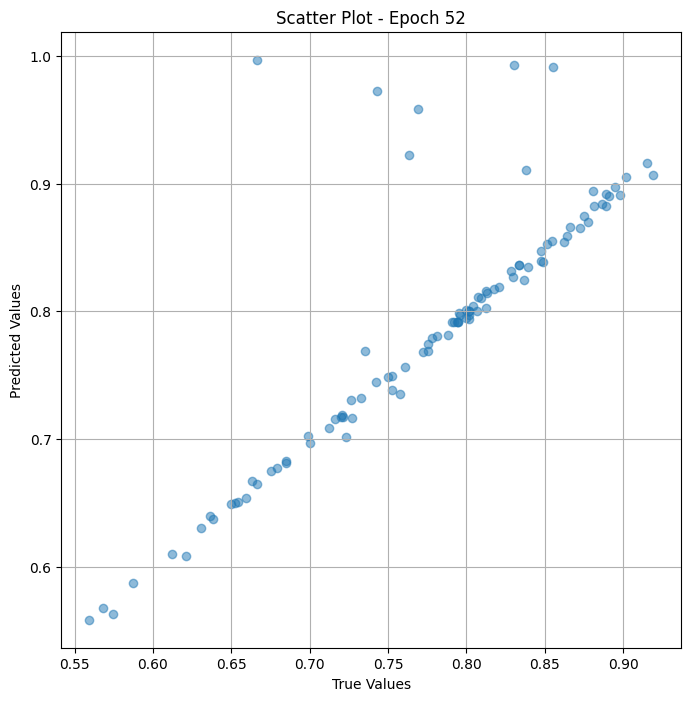


 Epoch: (53/100) Loss = 1.3572902389569208e-05

 Epoch: (53/100) Loss_rmse = 0.003684141905978322

 Epoch: (53/100) R^2 = 0.9954023957252502

 Epoch: (53/100) MAE = 0.0023842304944992065

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

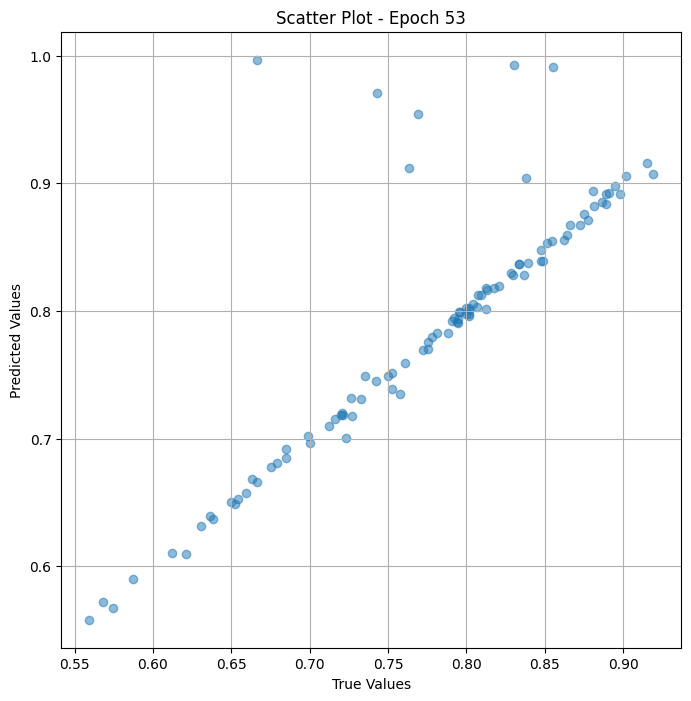


 Epoch: (54/100) Loss = 2.349070564378053e-05

 Epoch: (54/100) Loss_rmse = 0.004846720956265926

 Epoch: (54/100) R^2 = 0.9920428991317749

 Epoch: (54/100) MAE = 0.004266858100891113

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

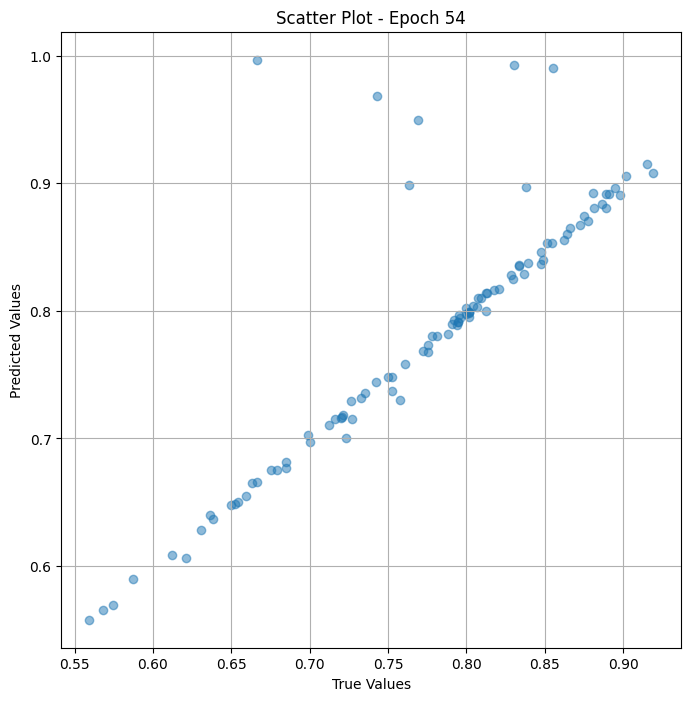


 Epoch: (55/100) Loss = 6.0682683397317305e-05

 Epoch: (55/100) Loss_rmse = 0.007789908908307552

 Epoch: (55/100) R^2 = 0.9794447422027588

 Epoch: (55/100) MAE = 0.0057024359703063965

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 

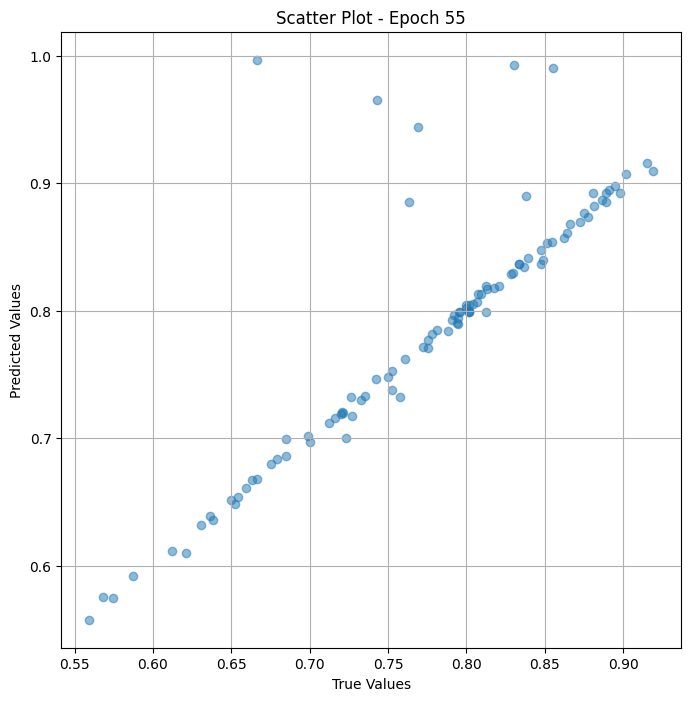


 Epoch: (56/100) Loss = 0.00011860133236041293

 Epoch: (56/100) Loss_rmse = 0.010890424251556396

 Epoch: (56/100) R^2 = 0.9598257541656494

 Epoch: (56/100) MAE = 0.008933112025260925

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

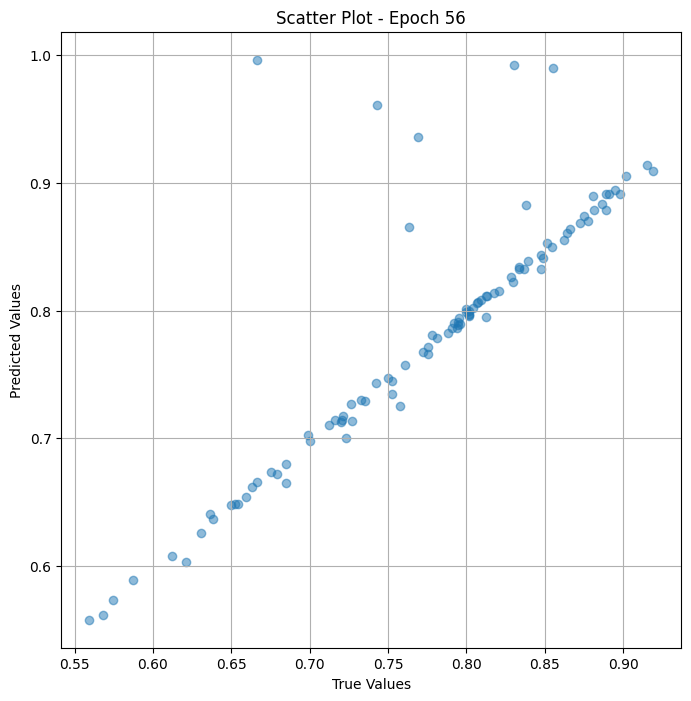


 Epoch: (57/100) Loss = 0.0003144945076201111

 Epoch: (57/100) Loss_rmse = 0.017733993008732796

 Epoch: (57/100) R^2 = 0.8934701085090637

 Epoch: (57/100) MAE = 0.013488724827766418

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

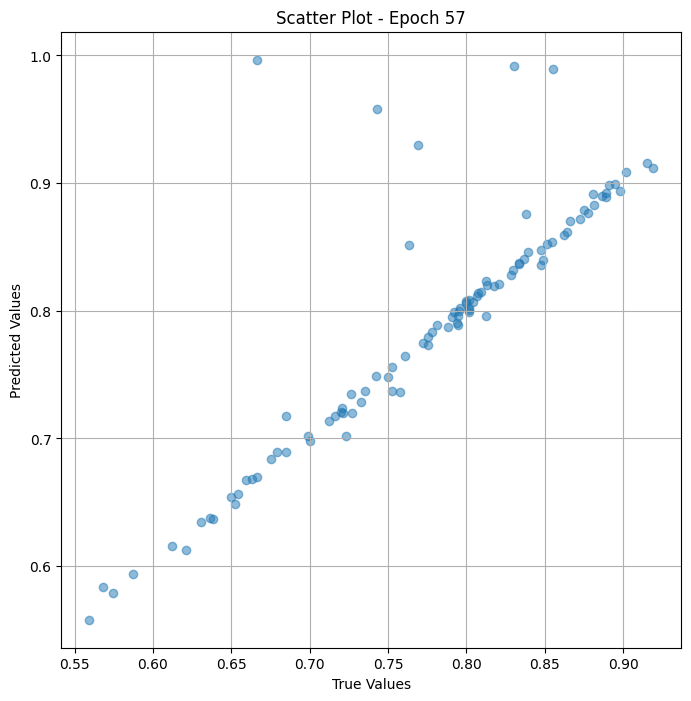


 Epoch: (58/100) Loss = 0.0005843829130753875

 Epoch: (58/100) Loss_rmse = 0.02417401410639286

 Epoch: (58/100) R^2 = 0.8020497560501099

 Epoch: (58/100) MAE = 0.019291028380393982

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

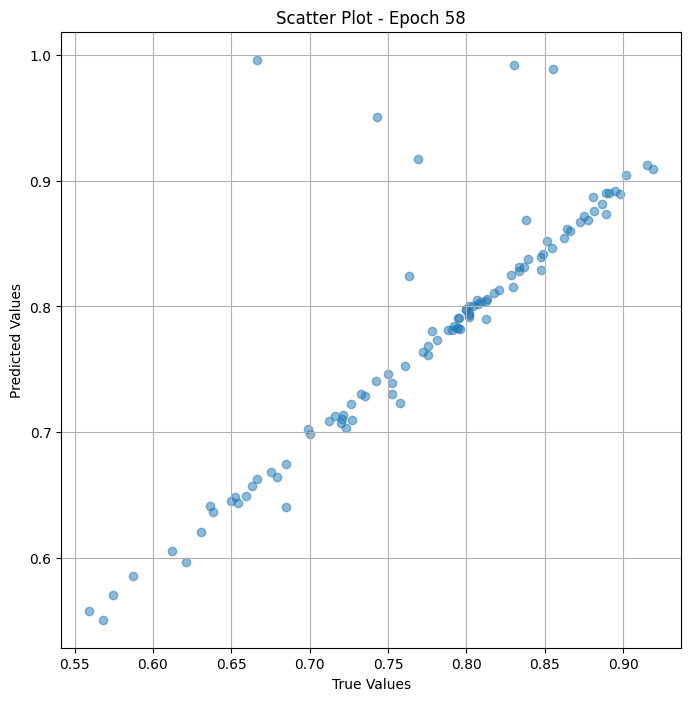


 Epoch: (59/100) Loss = 0.0016073299339041114

 Epoch: (59/100) Loss_rmse = 0.04009151831269264

 Epoch: (59/100) R^2 = 0.4555431008338928

 Epoch: (59/100) MAE = 0.03087545931339264

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

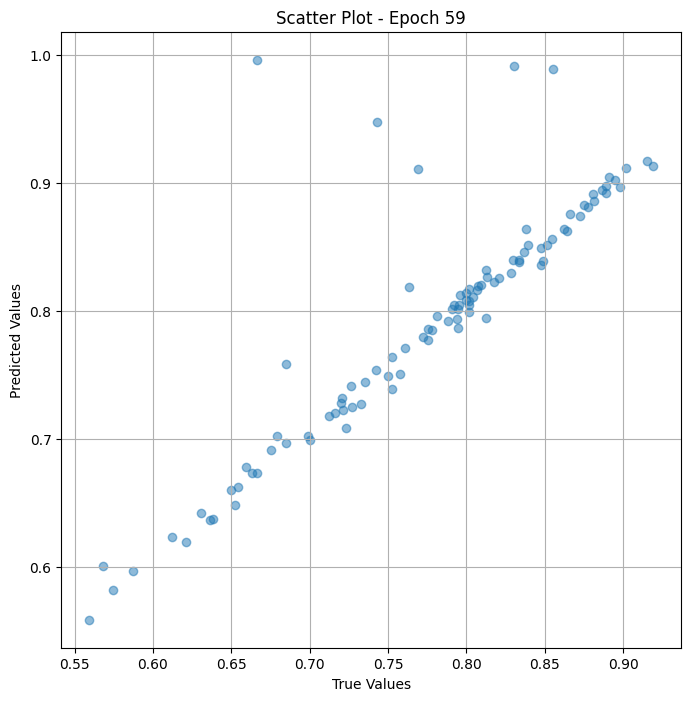


 Epoch: (60/100) Loss = 0.0020351121202111244

 Epoch: (60/100) Loss_rmse = 0.04511221870779991

 Epoch: (60/100) R^2 = 0.31063878536224365

 Epoch: (60/100) MAE = 0.03711536526679993

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

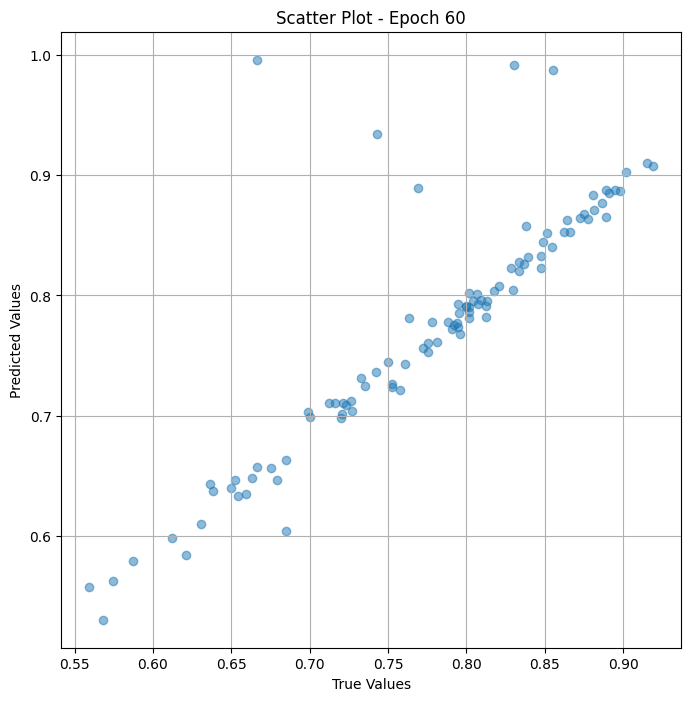


 Epoch: (61/100) Loss = 0.0053458623588085175

 Epoch: (61/100) Loss_rmse = 0.07311540096998215

 Epoch: (61/100) R^2 = -0.8108240365982056

 Epoch: (61/100) MAE = 0.05926576256752014

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

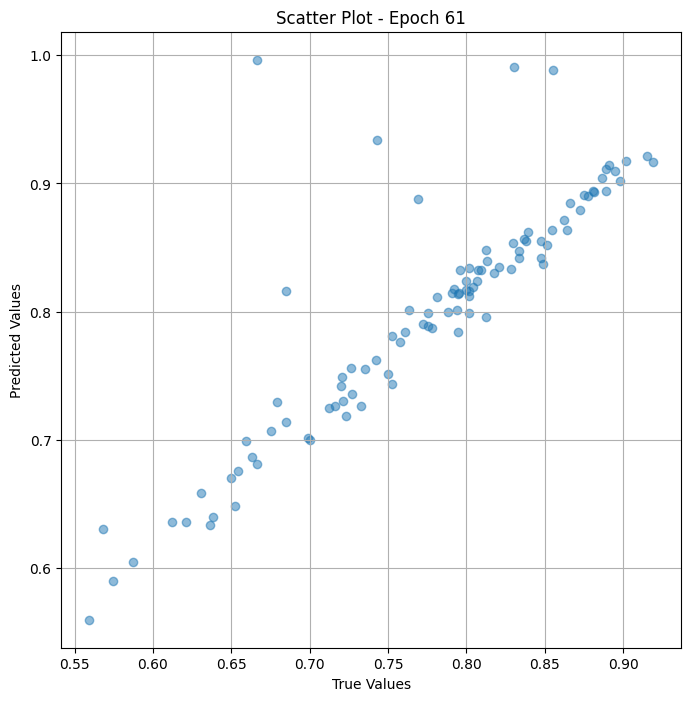


 Epoch: (62/100) Loss = 0.0027410639449954033

 Epoch: (62/100) Loss_rmse = 0.052355170249938965

 Epoch: (62/100) R^2 = 0.07150912284851074

 Epoch: (62/100) MAE = 0.04874648153781891

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

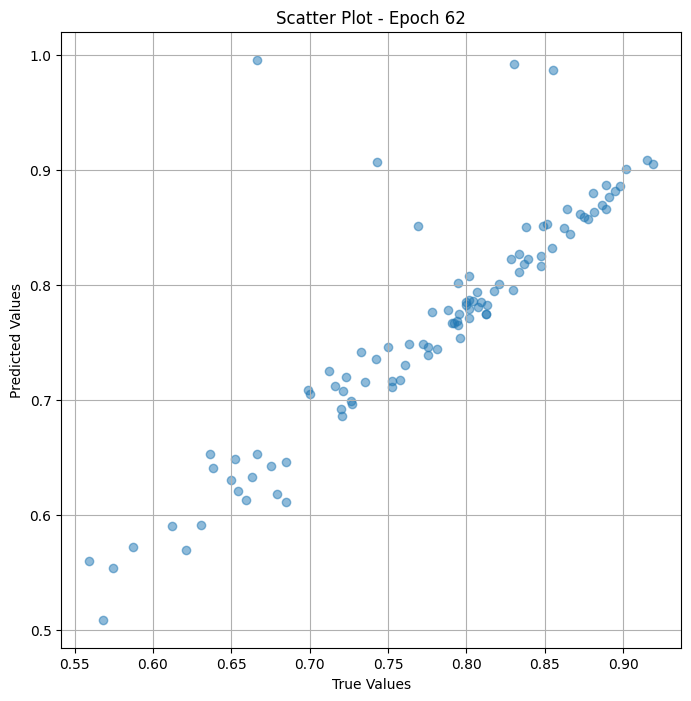


 Epoch: (63/100) Loss = 0.00676033366471529

 Epoch: (63/100) Loss_rmse = 0.08222124725580215

 Epoch: (63/100) R^2 = -1.2899532318115234

 Epoch: (63/100) MAE = 0.0748148262500763

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

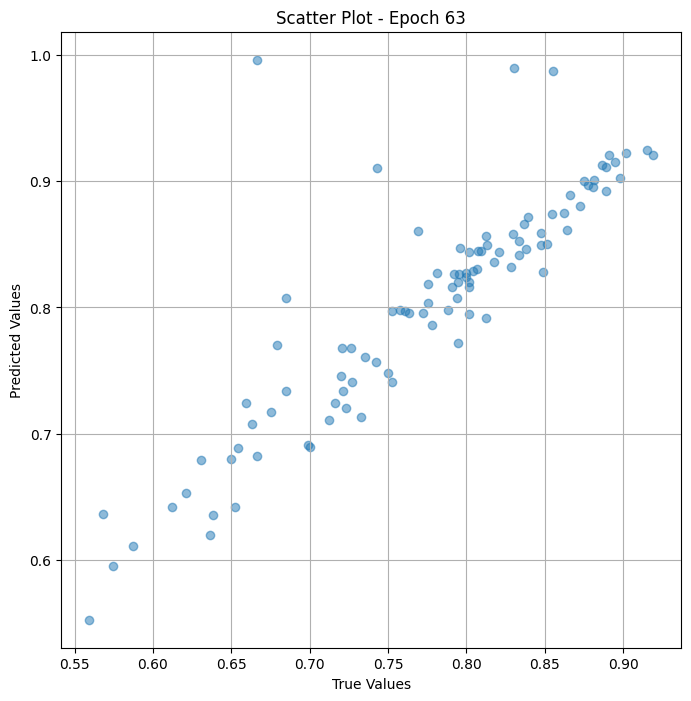


 Epoch: (64/100) Loss = 0.00496192742139101

 Epoch: (64/100) Loss_rmse = 0.07044094800949097

 Epoch: (64/100) R^2 = -0.6807723045349121

 Epoch: (64/100) MAE = 0.06393079459667206

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

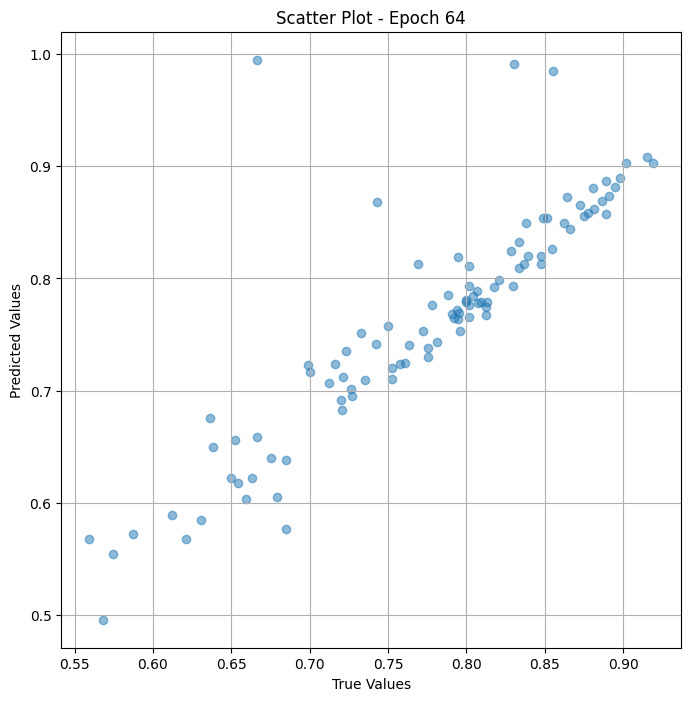


 Epoch: (65/100) Loss = 0.0123865632340312

 Epoch: (65/100) Loss_rmse = 0.1112949401140213

 Epoch: (65/100) R^2 = -3.1957473754882812

 Epoch: (65/100) MAE = 0.0985197126865387

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659340

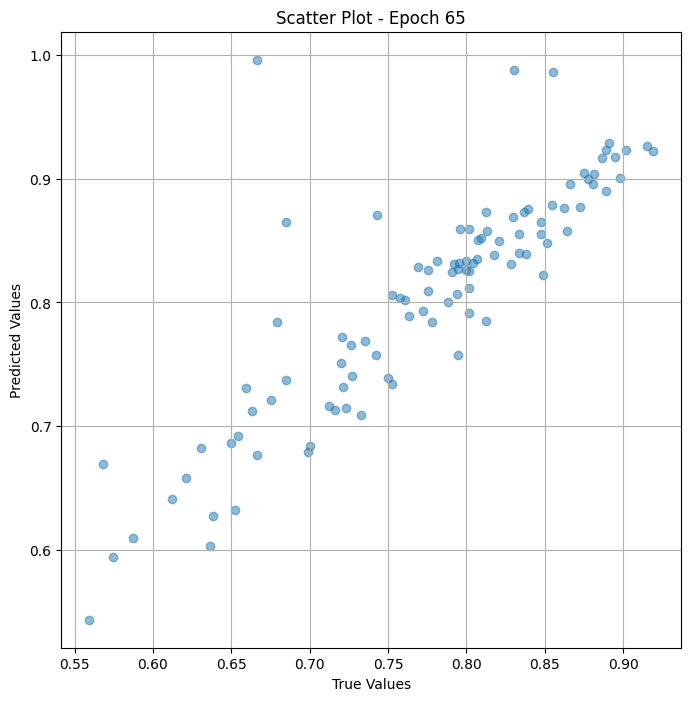


 Epoch: (66/100) Loss = 0.0022643133997917175

 Epoch: (66/100) Loss_rmse = 0.04758480191230774

 Epoch: (66/100) R^2 = 0.23300057649612427

 Epoch: (66/100) MAE = 0.04215437173843384

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

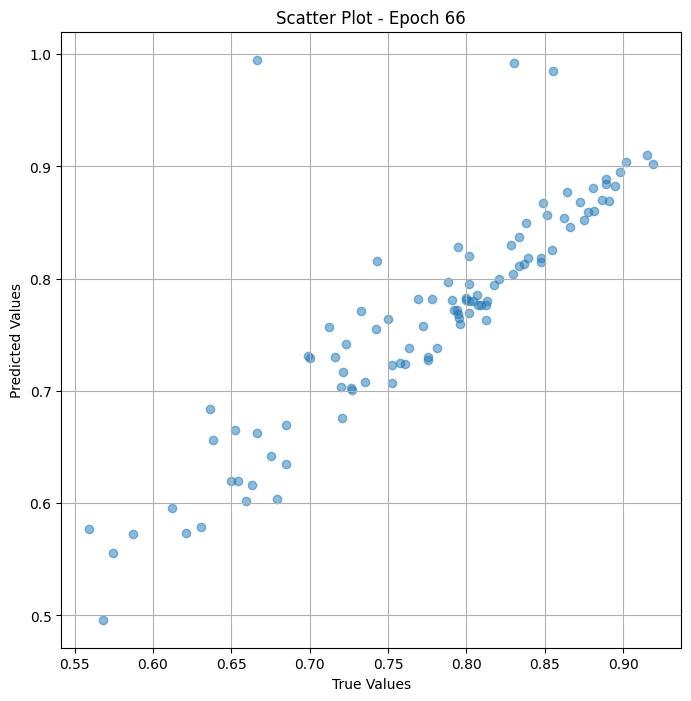


 Epoch: (67/100) Loss = 0.004939360078424215

 Epoch: (67/100) Loss_rmse = 0.07028058171272278

 Epoch: (67/100) R^2 = -0.6731280088424683

 Epoch: (67/100) MAE = 0.06361342966556549

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

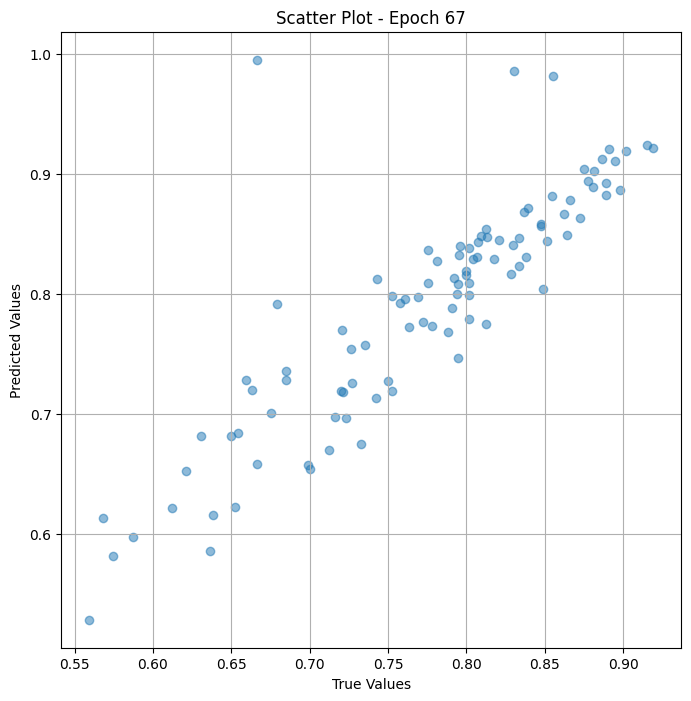


 Epoch: (68/100) Loss = 0.005508699454367161

 Epoch: (68/100) Loss_rmse = 0.07422061264514923

 Epoch: (68/100) R^2 = -0.8659825325012207

 Epoch: (68/100) MAE = 0.06162084639072418

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

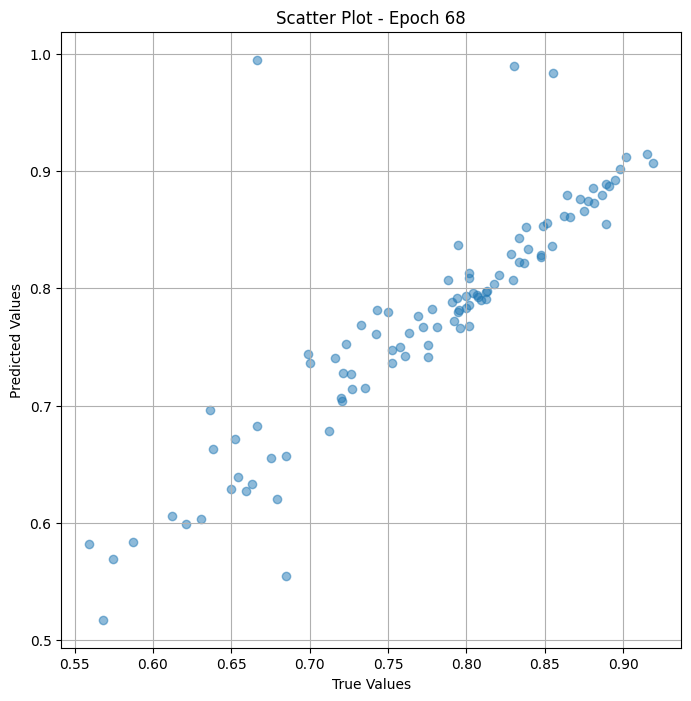


 Epoch: (69/100) Loss = 0.012705715373158455

 Epoch: (69/100) Loss_rmse = 0.11271963268518448

 Epoch: (69/100) R^2 = -3.3038549423217773

 Epoch: (69/100) MAE = 0.08827443420886993

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

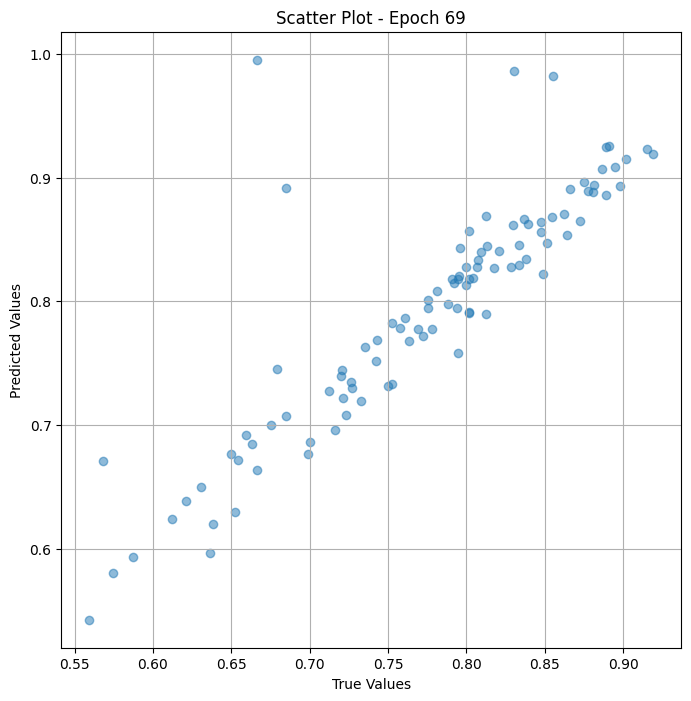


 Epoch: (70/100) Loss = 0.003719887463375926

 Epoch: (70/100) Loss_rmse = 0.06099088117480278

 Epoch: (70/100) R^2 = -0.2600514888763428

 Epoch: (70/100) MAE = 0.05337017774581909

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

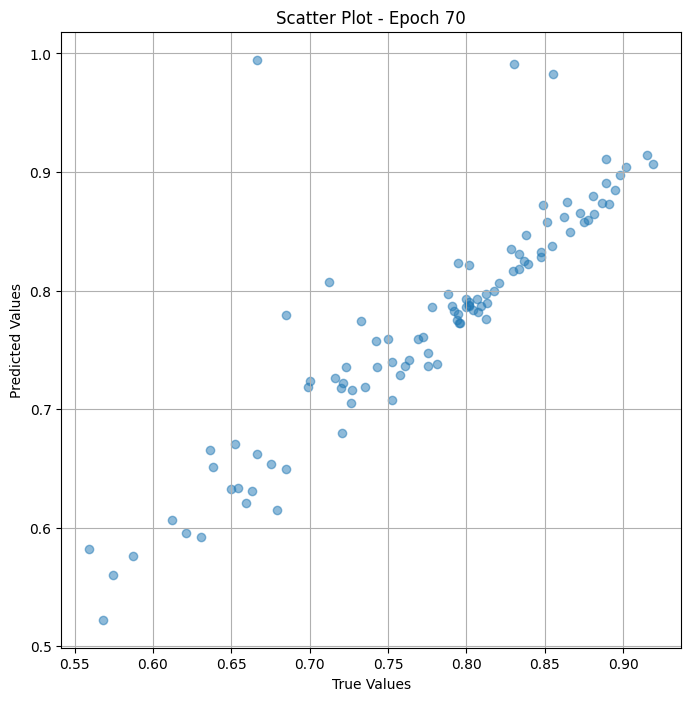


 Epoch: (71/100) Loss = 0.0048862965777516365

 Epoch: (71/100) Loss_rmse = 0.06990204751491547

 Epoch: (71/100) R^2 = -0.6551536321640015

 Epoch: (71/100) MAE = 0.05919508635997772

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

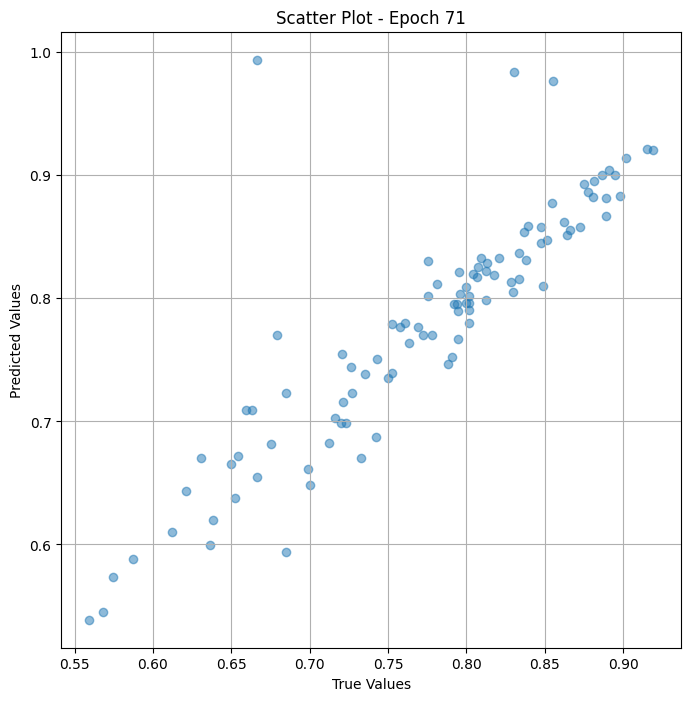


 Epoch: (72/100) Loss = 0.001495948527008295

 Epoch: (72/100) Loss_rmse = 0.03867749497294426

 Epoch: (72/100) R^2 = 0.49327170848846436

 Epoch: (72/100) MAE = 0.029020920395851135

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

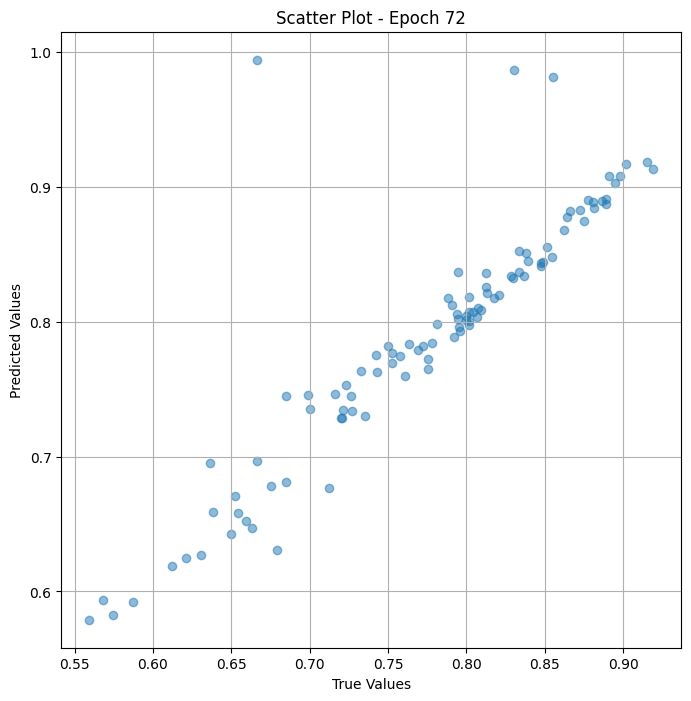


 Epoch: (73/100) Loss = 0.0003910631639882922

 Epoch: (73/100) Loss_rmse = 0.01977531611919403

 Epoch: (73/100) R^2 = 0.8675336837768555

 Epoch: (73/100) MAE = 0.01651182770729065

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

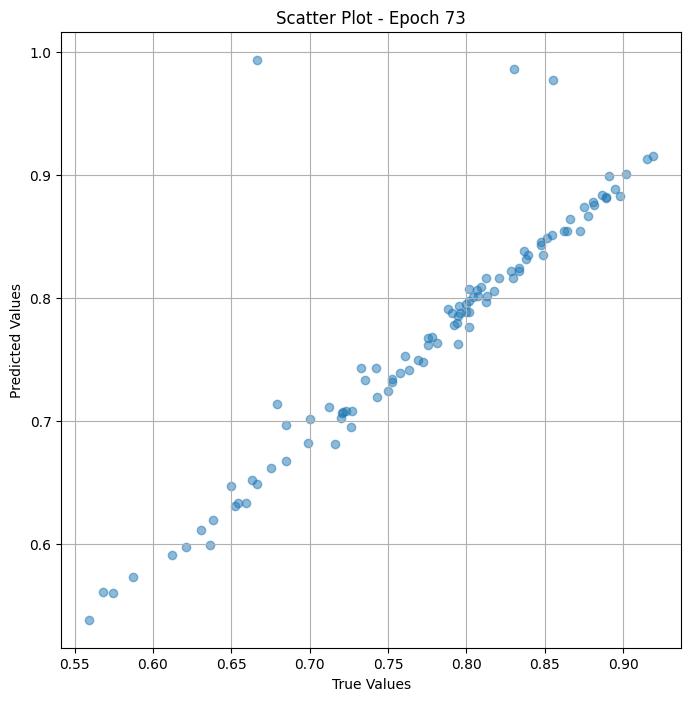


 Epoch: (74/100) Loss = 0.000600729719735682

 Epoch: (74/100) Loss_rmse = 0.024509787559509277

 Epoch: (74/100) R^2 = 0.7965125441551208

 Epoch: (74/100) MAE = 0.015687033534049988

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

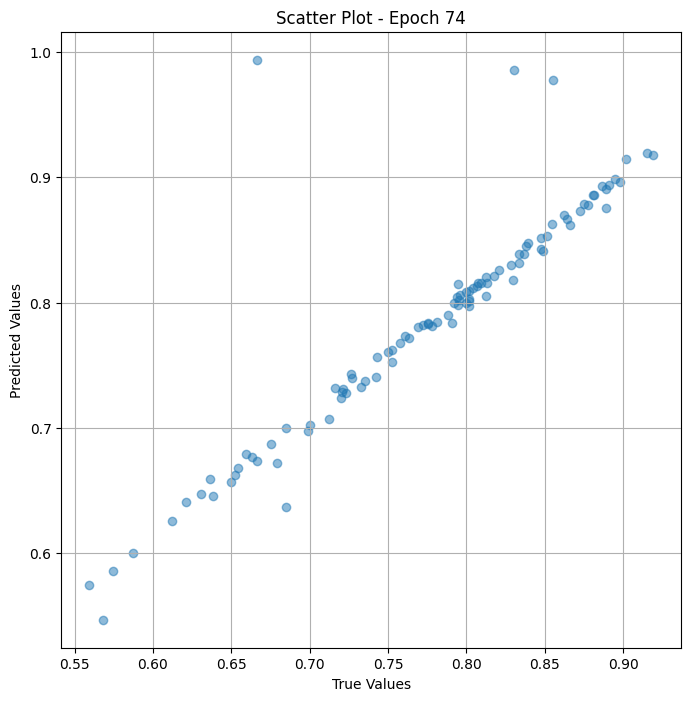


 Epoch: (75/100) Loss = 0.0011086564045399427

 Epoch: (75/100) Loss_rmse = 0.03329649195075035

 Epoch: (75/100) R^2 = 0.6244606375694275

 Epoch: (75/100) MAE = 0.022287294268608093

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

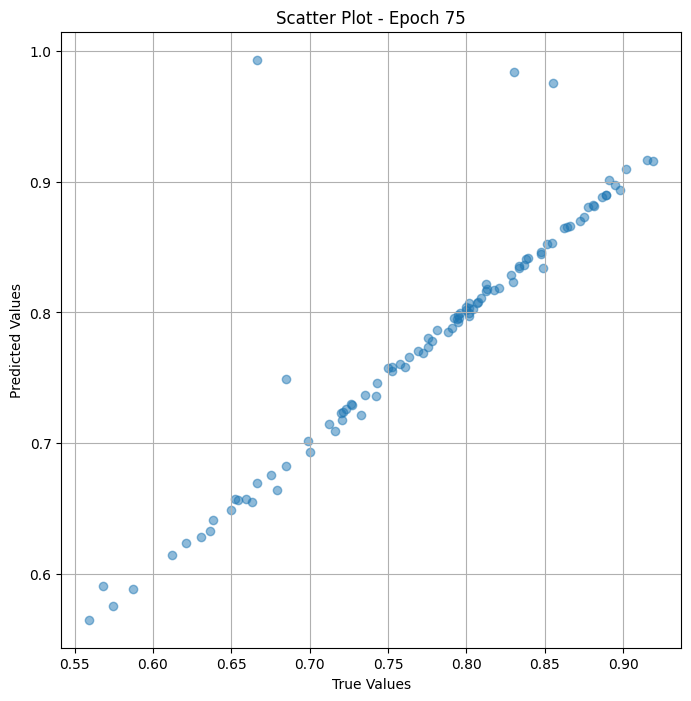


 Epoch: (76/100) Loss = 0.0005161898443475366

 Epoch: (76/100) Loss_rmse = 0.022719811648130417

 Epoch: (76/100) R^2 = 0.8251490592956543

 Epoch: (76/100) MAE = 0.01875174045562744

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

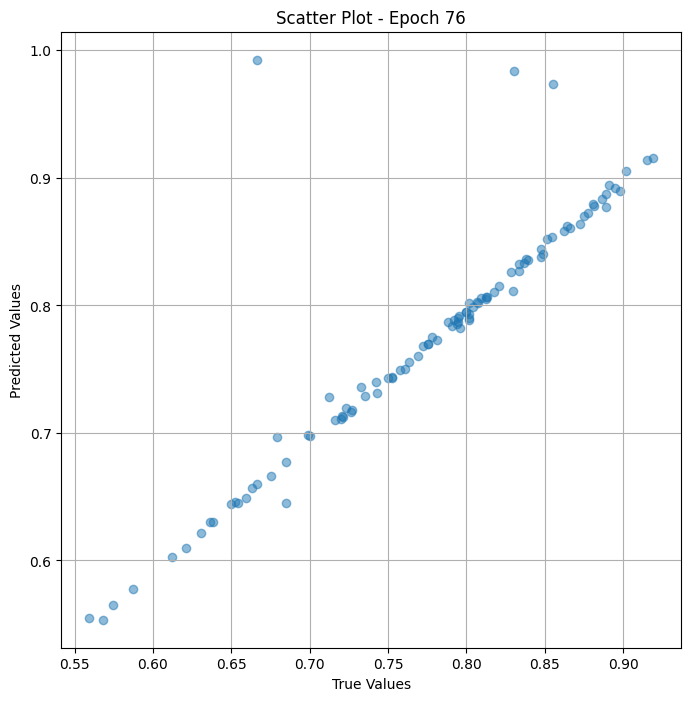


 Epoch: (77/100) Loss = 0.00035085310810245574

 Epoch: (77/100) Loss_rmse = 0.018731072545051575

 Epoch: (77/100) R^2 = 0.8811541795730591

 Epoch: (77/100) MAE = 0.014576941728591919

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

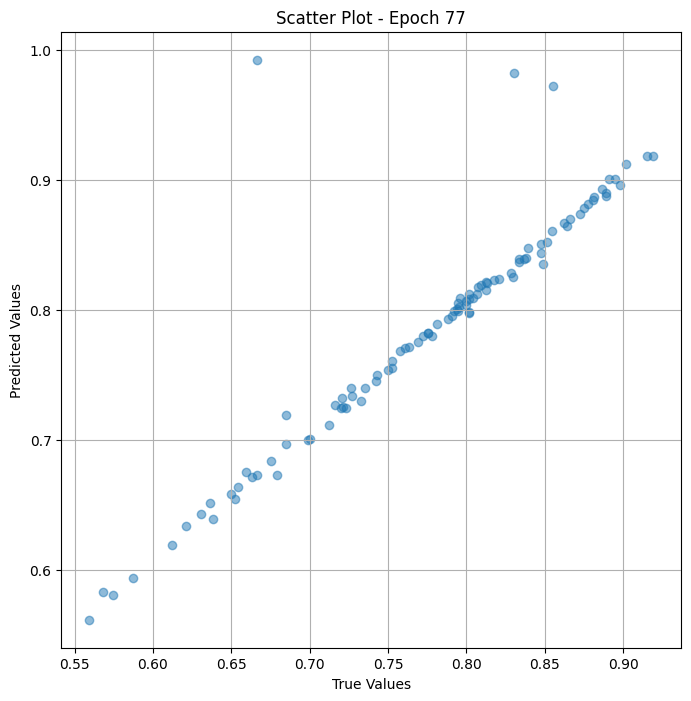


 Epoch: (78/100) Loss = 0.0002921092673204839

 Epoch: (78/100) Loss_rmse = 0.01709120348095894

 Epoch: (78/100) R^2 = 0.901052713394165

 Epoch: (78/100) MAE = 0.01356661319732666

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

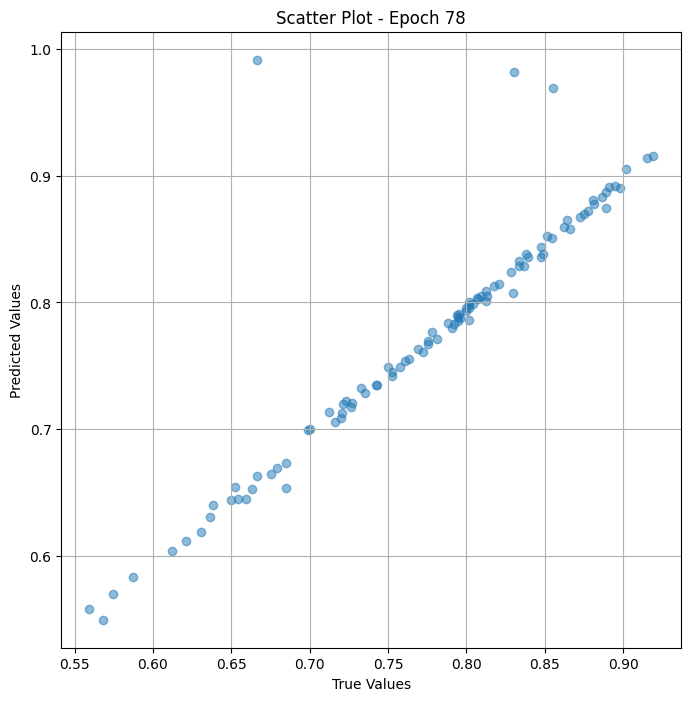


 Epoch: (79/100) Loss = 0.000637272372841835

 Epoch: (79/100) Loss_rmse = 0.025244254618883133

 Epoch: (79/100) R^2 = 0.7841343283653259

 Epoch: (79/100) MAE = 0.021010681986808777

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

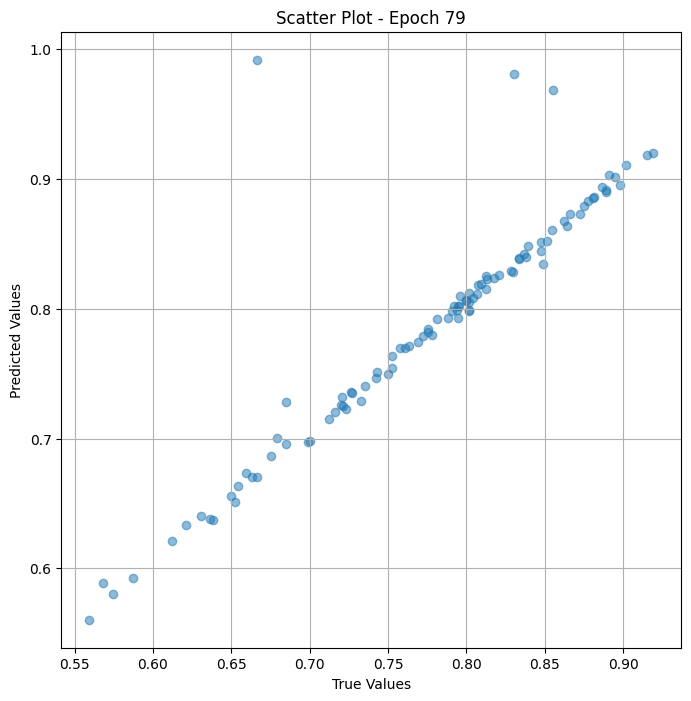


 Epoch: (80/100) Loss = 0.0008665320347063243

 Epoch: (80/100) Loss_rmse = 0.02943691611289978

 Epoch: (80/100) R^2 = 0.7064763307571411

 Epoch: (80/100) MAE = 0.02461567521095276

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

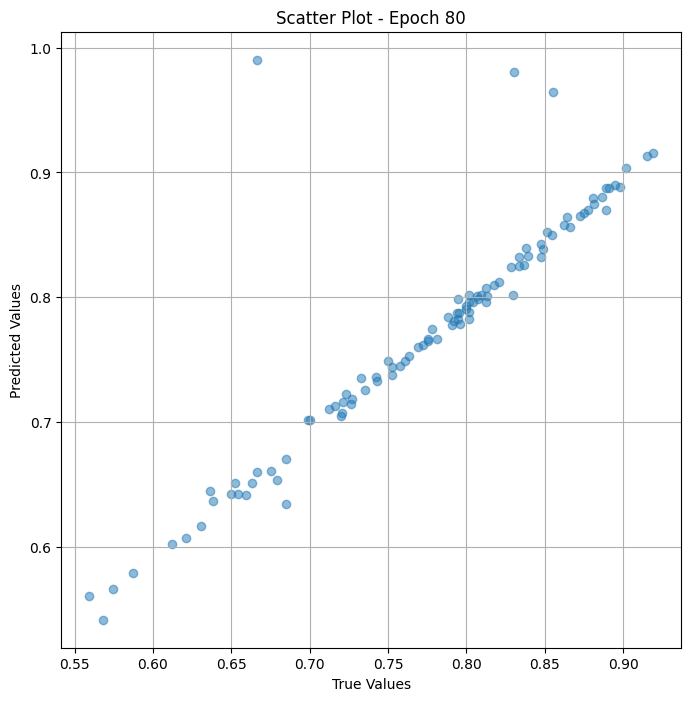


 Epoch: (81/100) Loss = 0.0018131625838577747

 Epoch: (81/100) Loss_rmse = 0.04258124530315399

 Epoch: (81/100) R^2 = 0.3858206272125244

 Epoch: (81/100) MAE = 0.03462390601634979

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

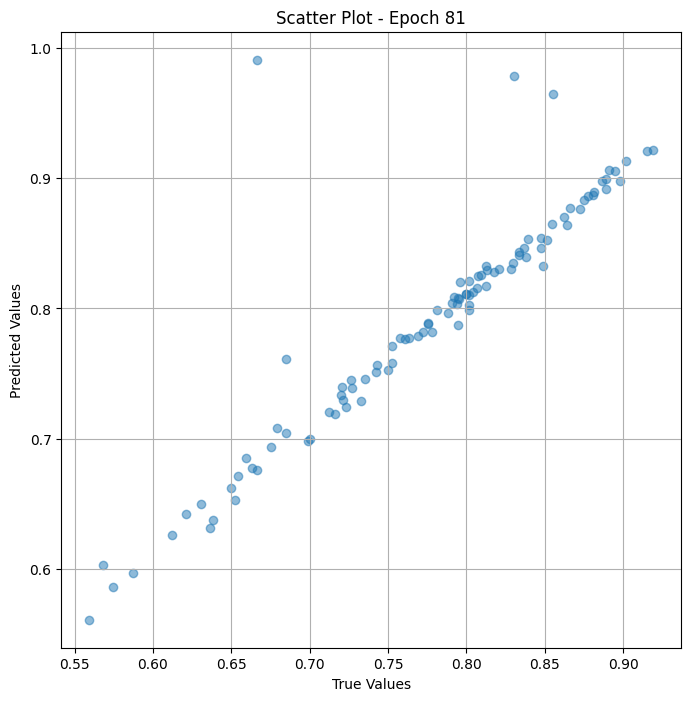


 Epoch: (82/100) Loss = 0.0016108760610222816

 Epoch: (82/100) Loss_rmse = 0.04013571888208389

 Epoch: (82/100) R^2 = 0.4543418884277344

 Epoch: (82/100) MAE = 0.033472657203674316

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

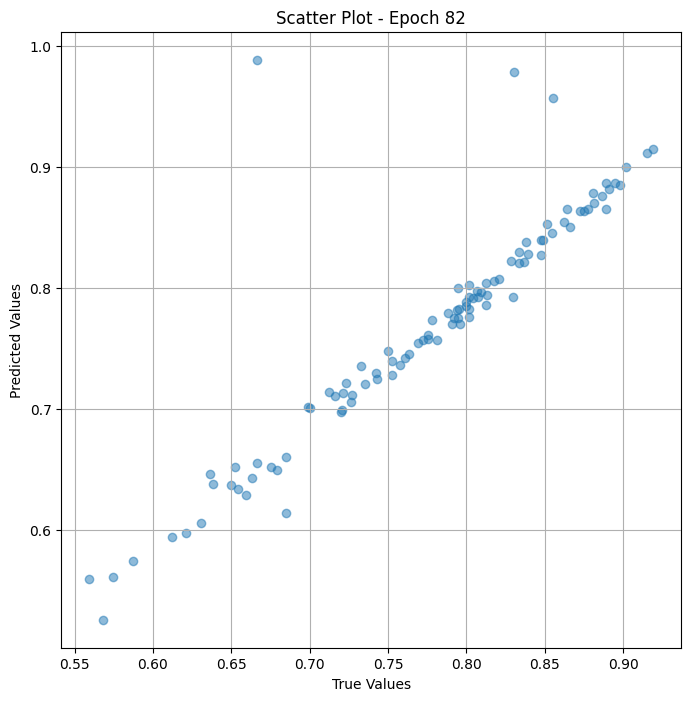


 Epoch: (83/100) Loss = 0.0034184460528194904

 Epoch: (83/100) Loss_rmse = 0.058467477560043335

 Epoch: (83/100) R^2 = -0.15794312953948975

 Epoch: (83/100) MAE = 0.04827757179737091

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

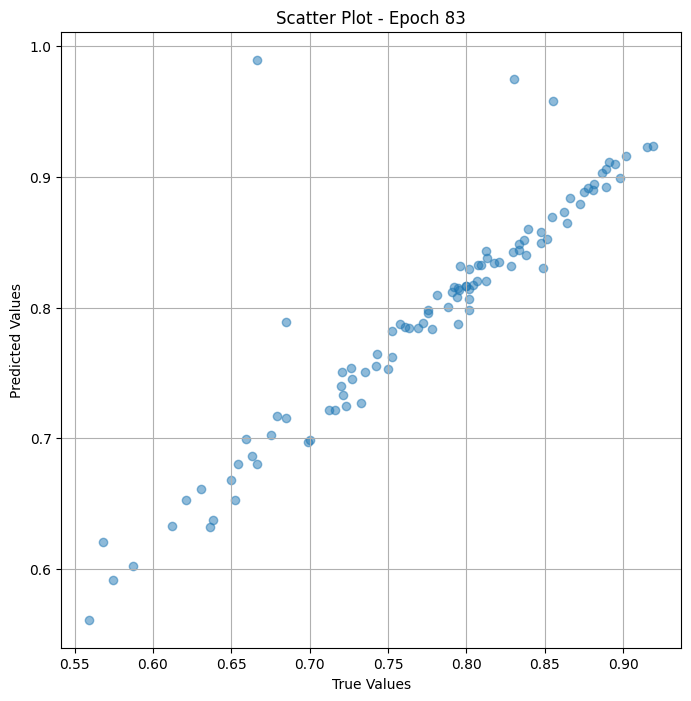


 Epoch: (84/100) Loss = 0.0021760680247098207

 Epoch: (84/100) Loss_rmse = 0.04664834588766098

 Epoch: (84/100) R^2 = 0.26289230585098267

 Epoch: (84/100) MAE = 0.041690319776535034

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

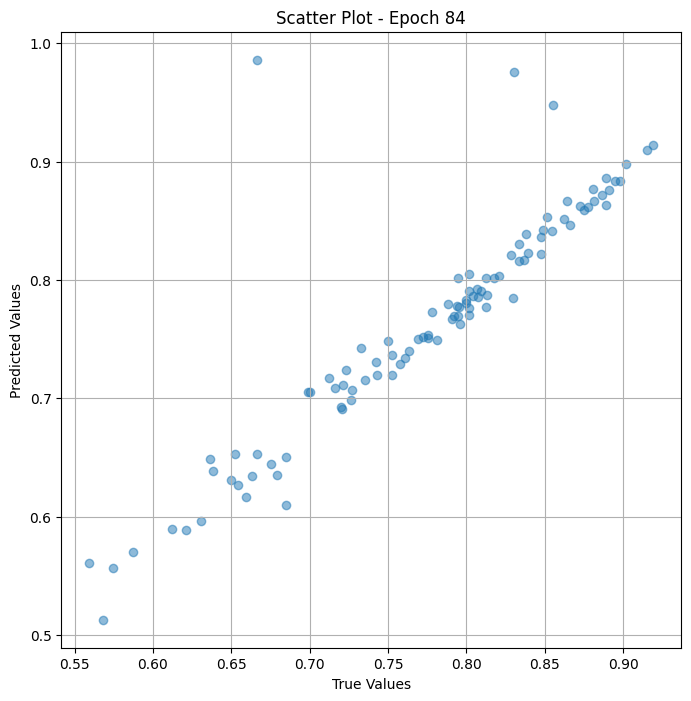


 Epoch: (85/100) Loss = 0.004667048342525959

 Epoch: (85/100) Loss_rmse = 0.06831579655408859

 Epoch: (85/100) R^2 = -0.5808868408203125

 Epoch: (85/100) MAE = 0.06020820140838623

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

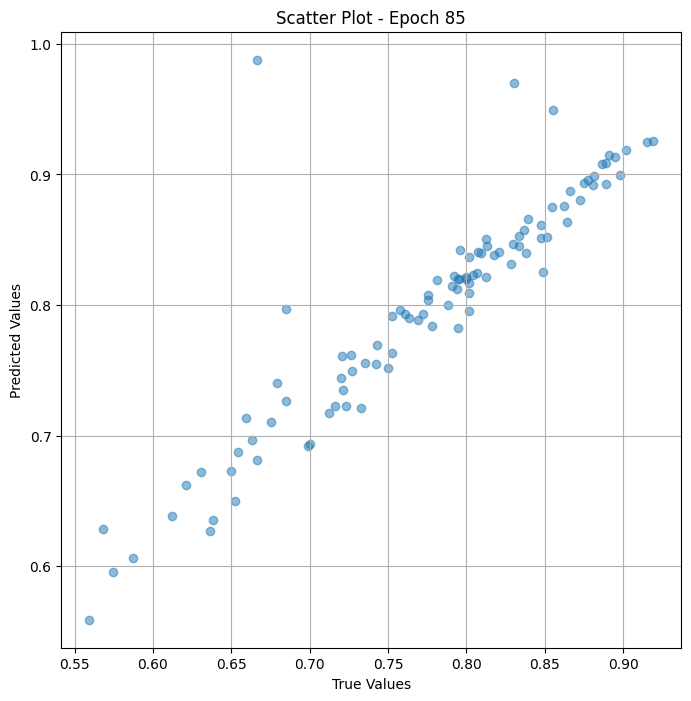


 Epoch: (86/100) Loss = 0.0030043714214116335

 Epoch: (86/100) Loss_rmse = 0.054812148213386536

 Epoch: (86/100) R^2 = -0.01768207550048828

 Epoch: (86/100) MAE = 0.04989749193191528

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0

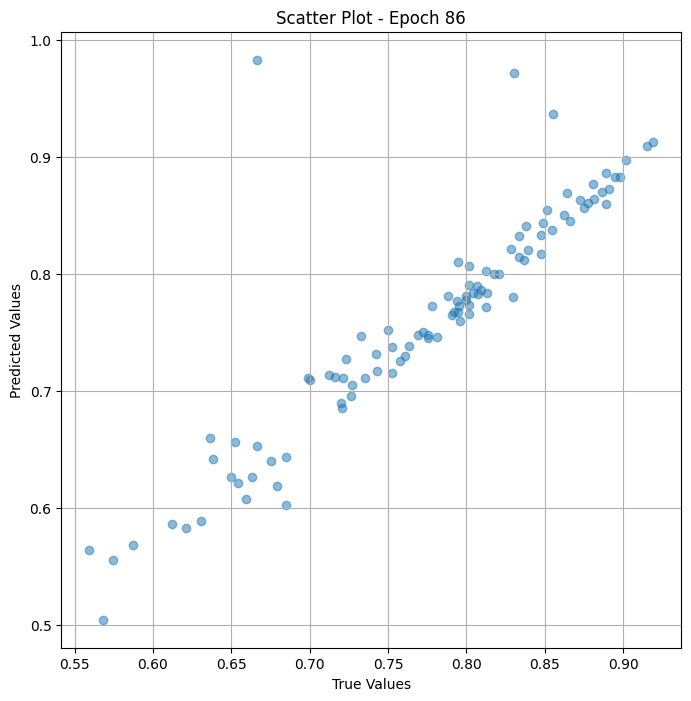


 Epoch: (87/100) Loss = 0.006626910530030727

 Epoch: (87/100) Loss_rmse = 0.08140584081411362

 Epoch: (87/100) R^2 = -1.2447583675384521

 Epoch: (87/100) MAE = 0.07278585433959961

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

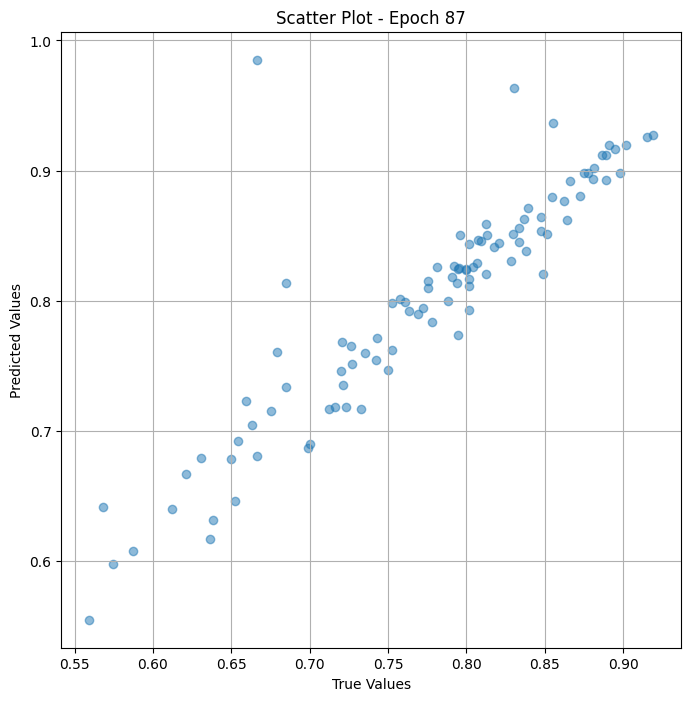


 Epoch: (88/100) Loss = 0.003183335531502962

 Epoch: (88/100) Loss_rmse = 0.056421056389808655

 Epoch: (88/100) R^2 = -0.07830321788787842

 Epoch: (88/100) MAE = 0.05263158679008484

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

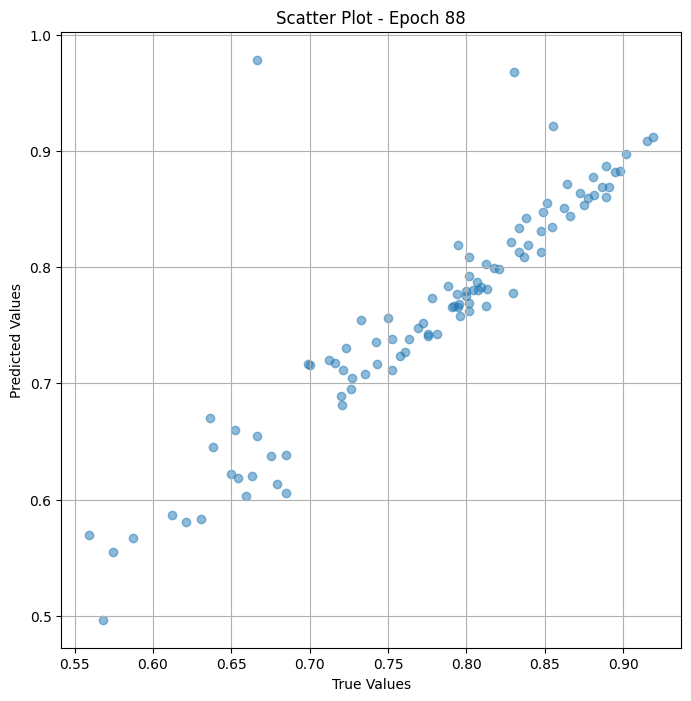


 Epoch: (89/100) Loss = 0.007053192239254713

 Epoch: (89/100) Loss_rmse = 0.08398328721523285

 Epoch: (89/100) R^2 = -1.3891544342041016

 Epoch: (89/100) MAE = 0.07691444456577301

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

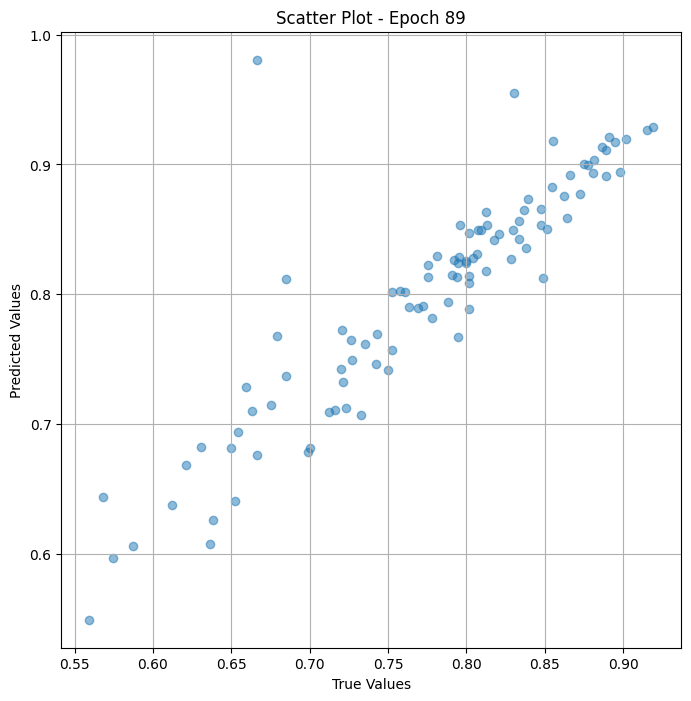


 Epoch: (90/100) Loss = 0.00371974753215909

 Epoch: (90/100) Loss_rmse = 0.060989733785390854

 Epoch: (90/100) R^2 = -0.26000404357910156

 Epoch: (90/100) MAE = 0.05626414716243744

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

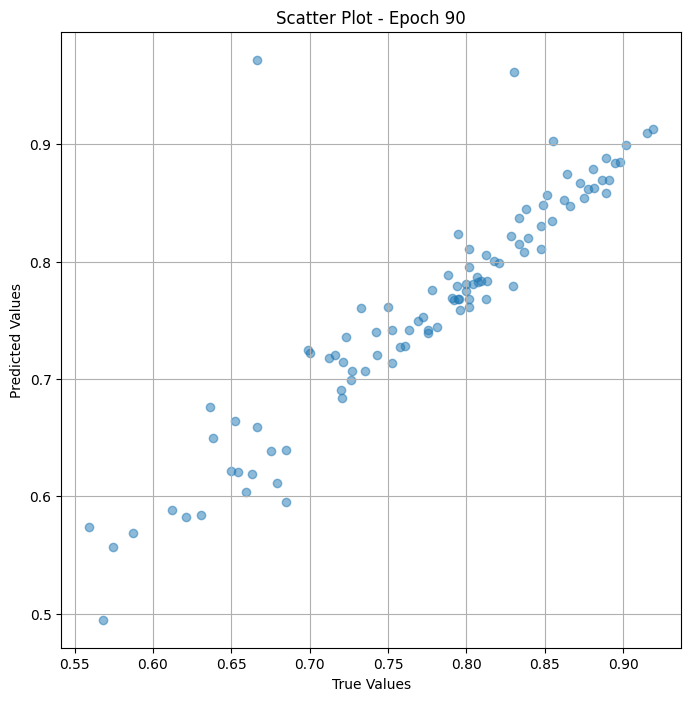


 Epoch: (91/100) Loss = 0.00826207734644413

 Epoch: (91/100) Loss_rmse = 0.09089597314596176

 Epoch: (91/100) R^2 = -1.7986445426940918

 Epoch: (91/100) MAE = 0.08200360834598541

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

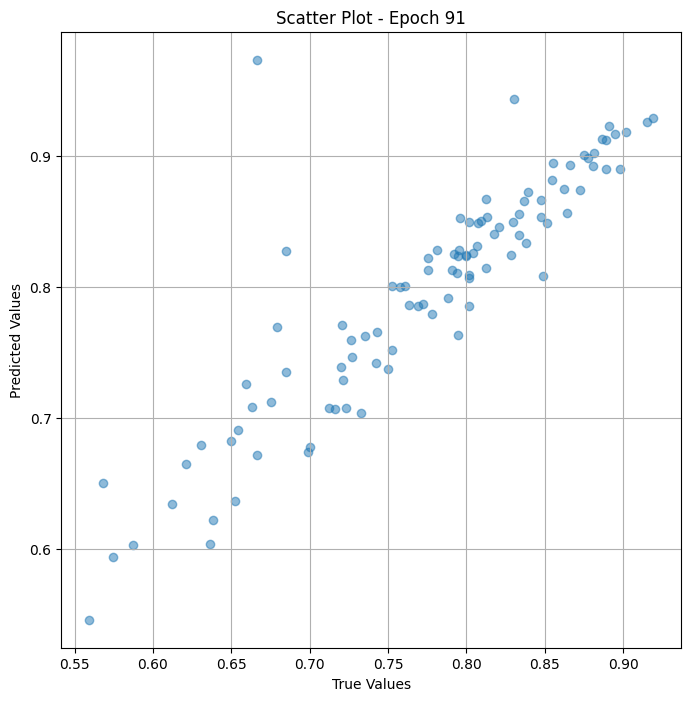


 Epoch: (92/100) Loss = 0.0028753241058439016

 Epoch: (92/100) Loss_rmse = 0.0536220483481884

 Epoch: (92/100) R^2 = 0.026030659675598145

 Epoch: (92/100) MAE = 0.050890445709228516

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

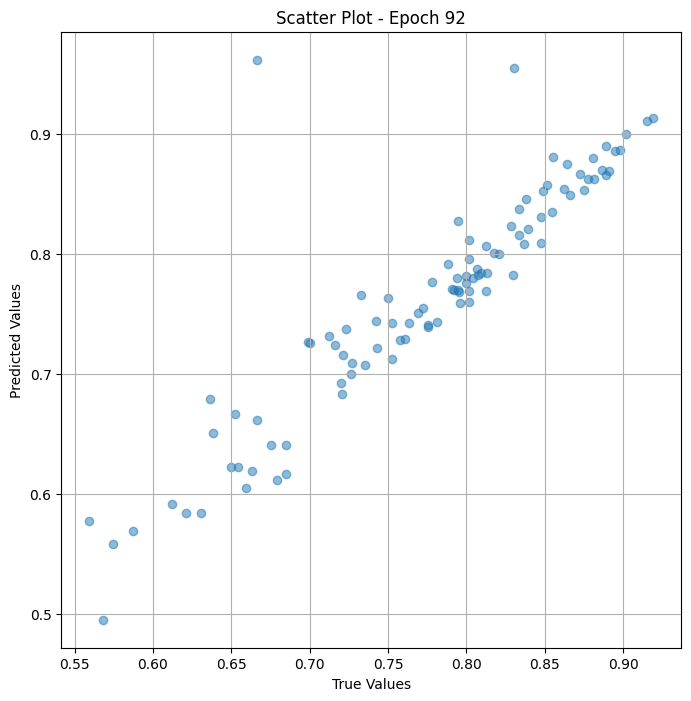


 Epoch: (93/100) Loss = 0.006044874899089336

 Epoch: (93/100) Loss_rmse = 0.07774879038333893

 Epoch: (93/100) R^2 = -1.0476031303405762

 Epoch: (93/100) MAE = 0.07268817722797394

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

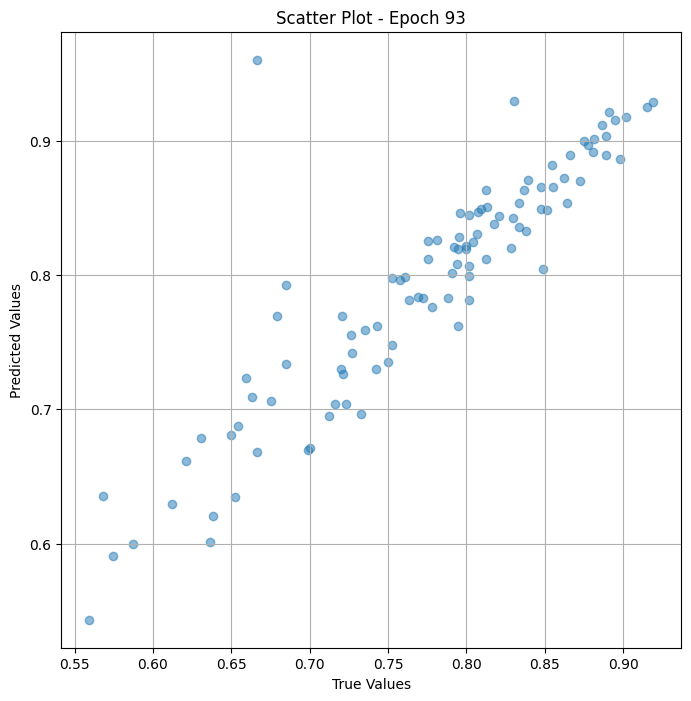


 Epoch: (94/100) Loss = 0.004214191809296608

 Epoch: (94/100) Loss_rmse = 0.06491680443286896

 Epoch: (94/100) R^2 = -0.4274890422821045

 Epoch: (94/100) MAE = 0.05780781805515289

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

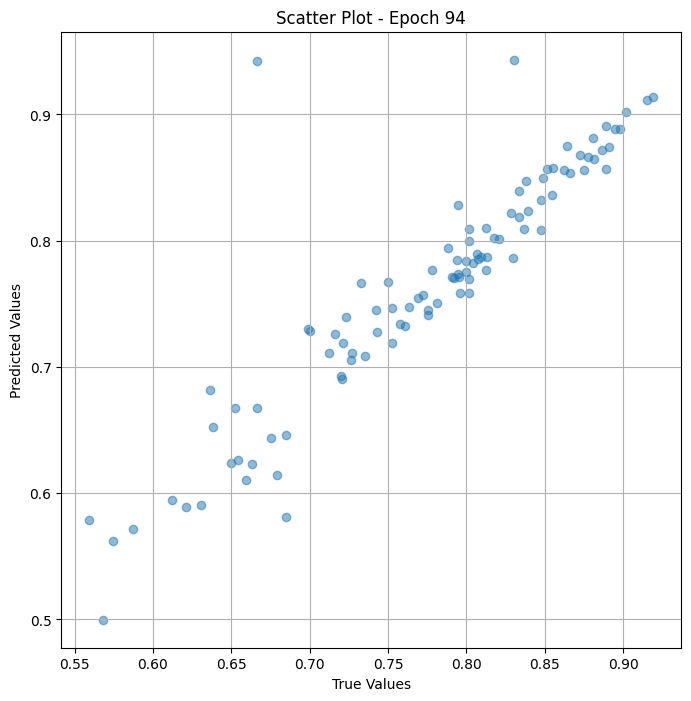


 Epoch: (95/100) Loss = 0.00874353852123022

 Epoch: (95/100) Loss_rmse = 0.09350688755512238

 Epoch: (95/100) R^2 = -1.9617316722869873

 Epoch: (95/100) MAE = 0.08103792369365692

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

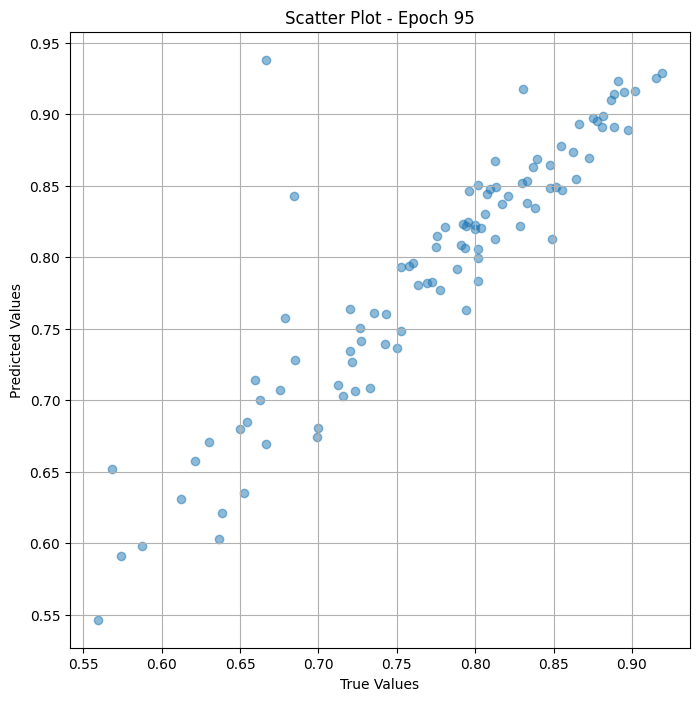


 Epoch: (96/100) Loss = 0.0016787939239293337

 Epoch: (96/100) Loss_rmse = 0.04097308963537216

 Epoch: (96/100) R^2 = 0.43133580684661865

 Epoch: (96/100) MAE = 0.03847934305667877

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

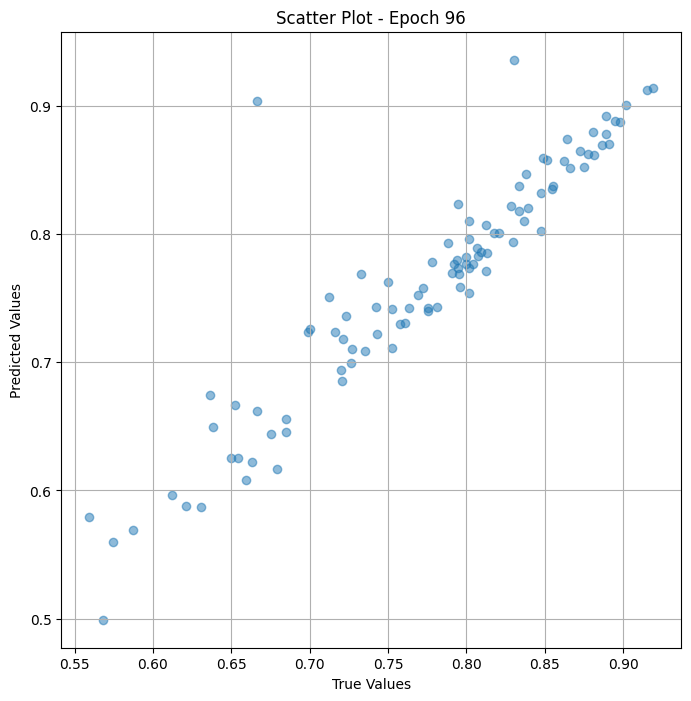


 Epoch: (97/100) Loss = 0.003120185574516654

 Epoch: (97/100) Loss_rmse = 0.05585861951112747

 Epoch: (97/100) R^2 = -0.05691218376159668

 Epoch: (97/100) MAE = 0.05151146650314331

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

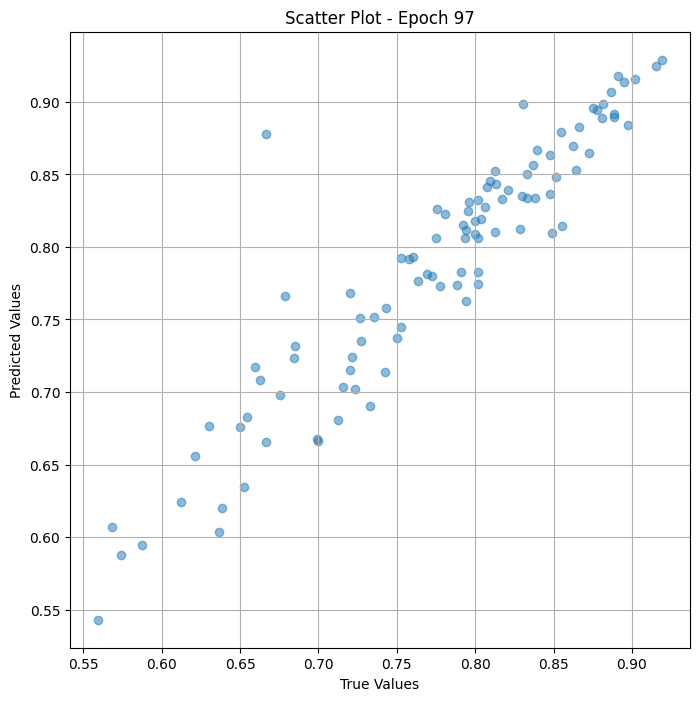


 Epoch: (98/100) Loss = 0.003434806363657117

 Epoch: (98/100) Loss_rmse = 0.05860722064971924

 Epoch: (98/100) R^2 = -0.16348493099212646

 Epoch: (98/100) MAE = 0.051465168595314026

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.

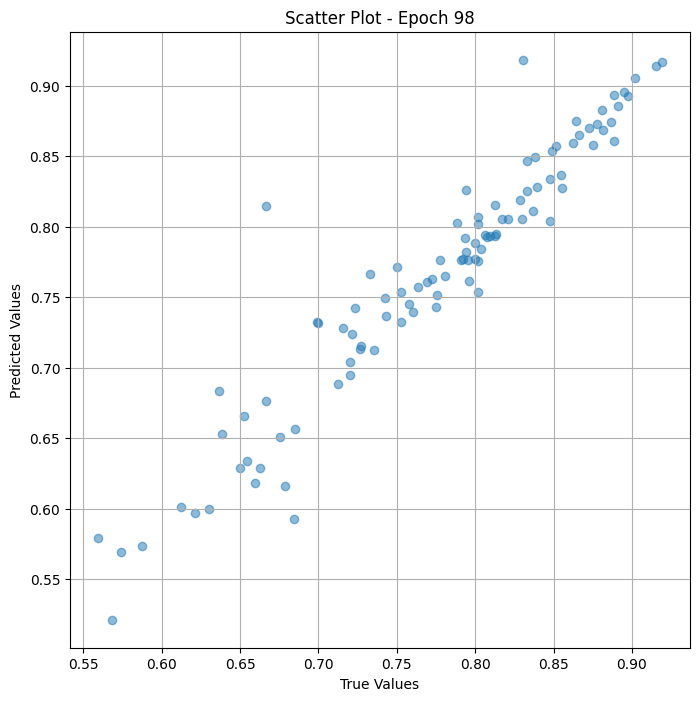


 Epoch: (99/100) Loss = 0.007586866617202759

 Epoch: (99/100) Loss_rmse = 0.08710262179374695

 Epoch: (99/100) R^2 = -1.5699279308319092

 Epoch: (99/100) MAE = 0.07191397249698639

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

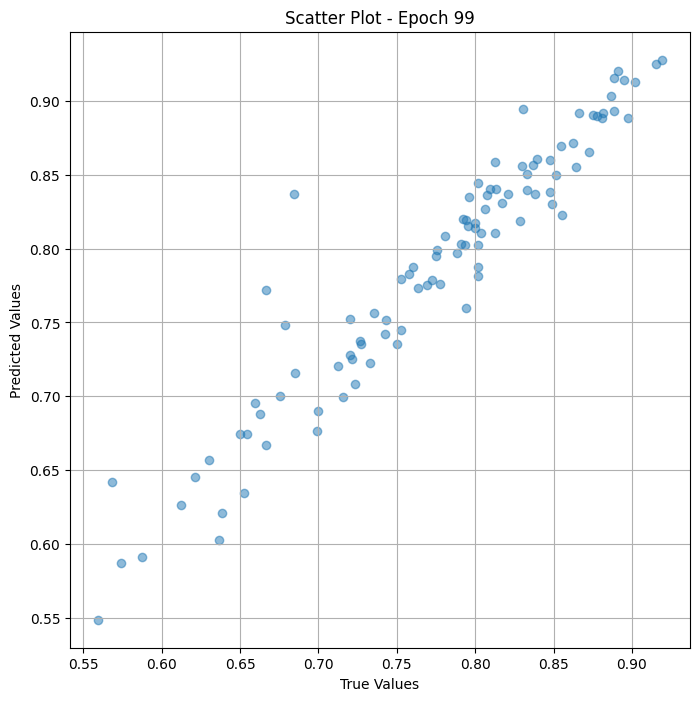


 Epoch: (100/100) Loss = 0.0008872199105098844

 Epoch: (100/100) Loss_rmse = 0.029786236584186554

 Epoch: (100/100) R^2 = 0.6994686722755432

 Epoch: (100/100) MAE = 0.028308779001235962

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216

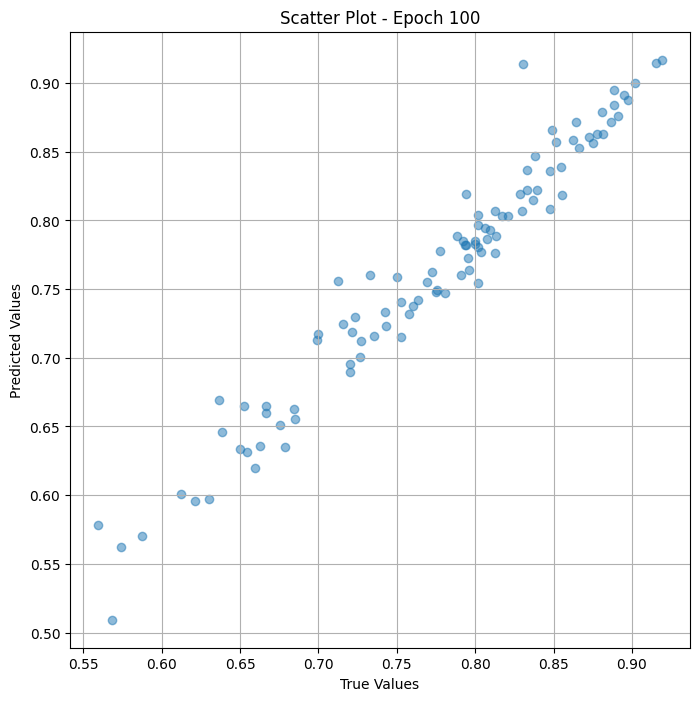

In [ ]:
# Training the model and save weights
fit(100, model_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_vr_val")

## Test

In [ ]:
class Dataset_test_sports(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_test_sports(df_test_sports, trans_transform=trans_transform, res_transform=res_transform)
train_dl_test = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_test = model_merge_test(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_test = to_device(model_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_test.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_test, train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_test(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

           # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.015594846569001675

 Epoch: (1/50) Loss_rmse = 0.12487933039665222

 Epoch: (1/50) R^2 = -6.89060640335083

 Epoch: (1/50) MAE = 0.12217815220355988

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333

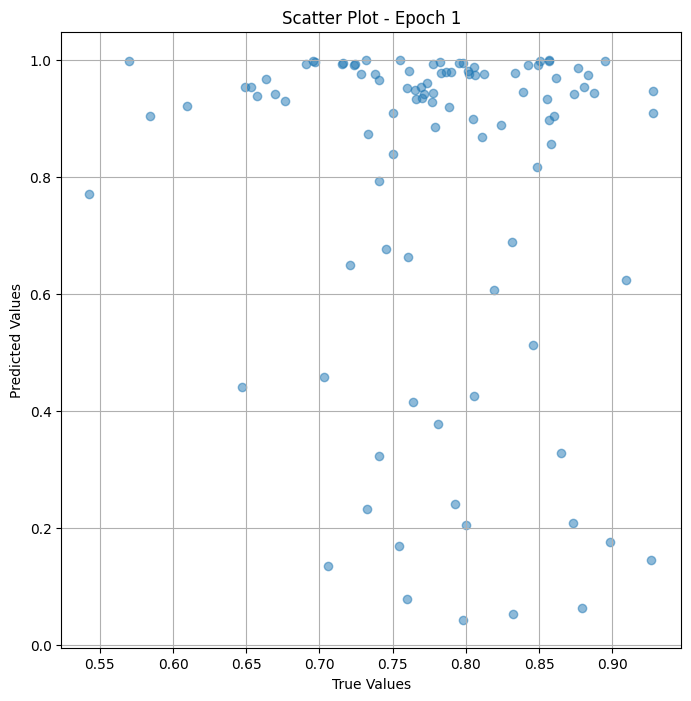


 Epoch: (2/50) Loss = 0.021368347108364105

 Epoch: (2/50) Loss_rmse = 0.14617915451526642

 Epoch: (2/50) R^2 = -9.811854362487793

 Epoch: (2/50) MAE = 0.14555078744888306

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.733

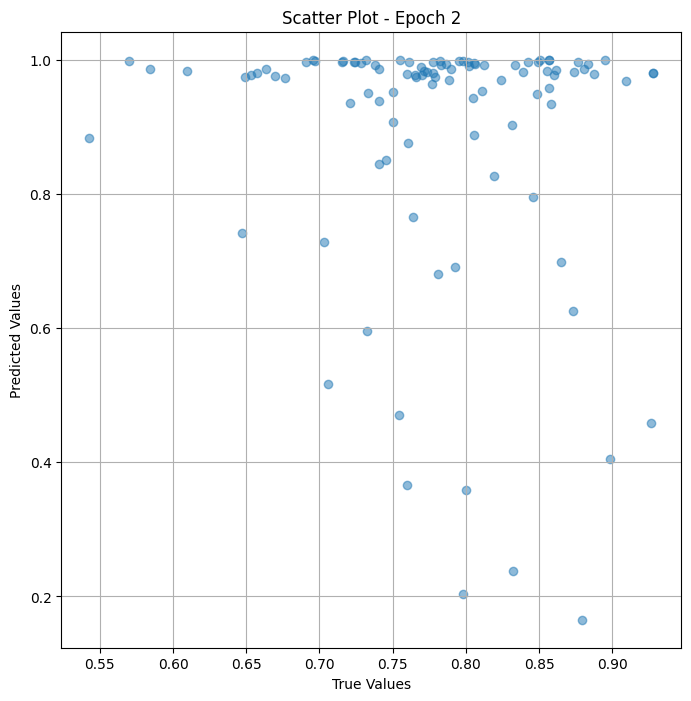


 Epoch: (3/50) Loss = 0.02257264032959938

 Epoch: (3/50) Loss_rmse = 0.1502419412136078

 Epoch: (3/50) R^2 = -10.421196937561035

 Epoch: (3/50) MAE = 0.1495525985956192

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.73333

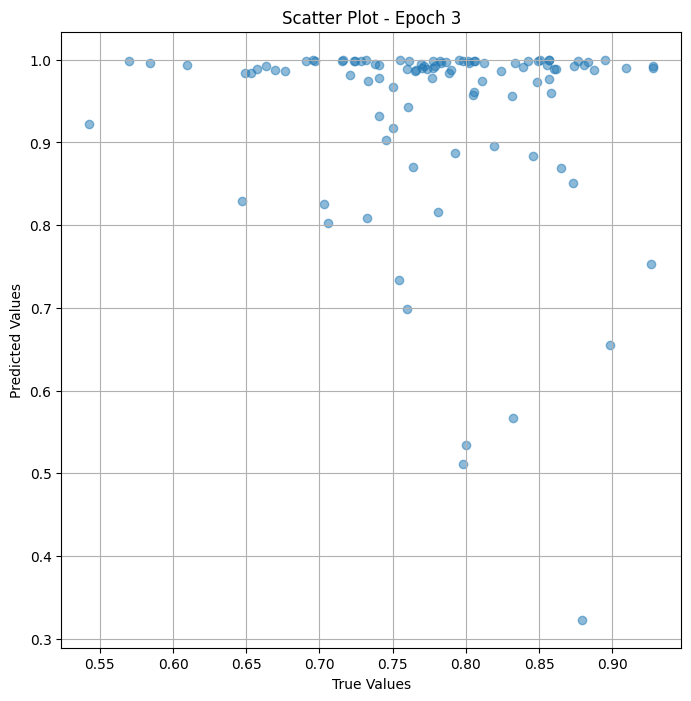


 Epoch: (4/50) Loss = 0.020214911550283432

 Epoch: (4/50) Loss_rmse = 0.14217914640903473

 Epoch: (4/50) R^2 = -9.22824478149414

 Epoch: (4/50) MAE = 0.1417558640241623

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.73333

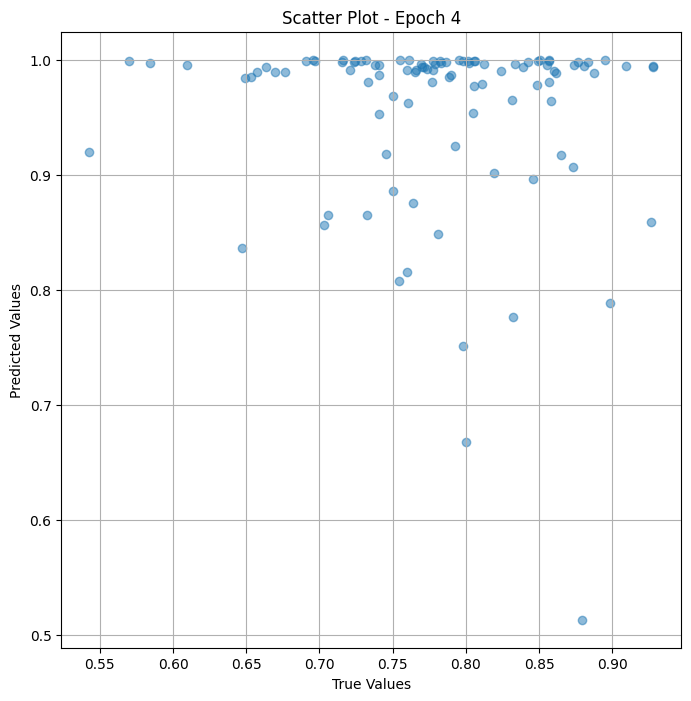


 Epoch: (5/50) Loss = 0.01578357443213463

 Epoch: (5/50) Loss_rmse = 0.12563270330429077

 Epoch: (5/50) R^2 = -6.986097812652588

 Epoch: (5/50) MAE = 0.11714787781238556

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333

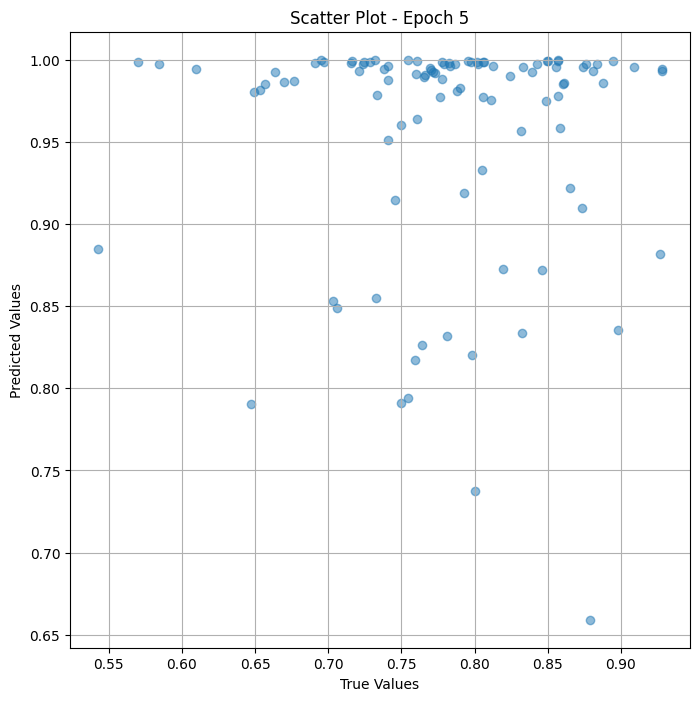


 Epoch: (6/50) Loss = 0.01800422929227352

 Epoch: (6/50) Loss_rmse = 0.13417984545230865

 Epoch: (6/50) R^2 = -8.109694480895996

 Epoch: (6/50) MAE = 0.13301719725131989

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333

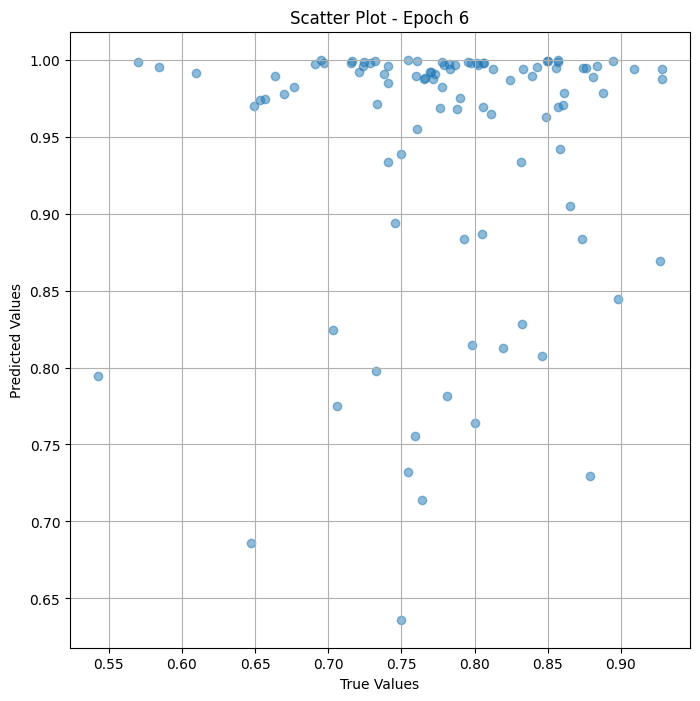


 Epoch: (7/50) Loss = 0.015613993629813194

 Epoch: (7/50) Loss_rmse = 0.12495596706867218

 Epoch: (7/50) R^2 = -6.900294303894043

 Epoch: (7/50) MAE = 0.1215238869190216

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333

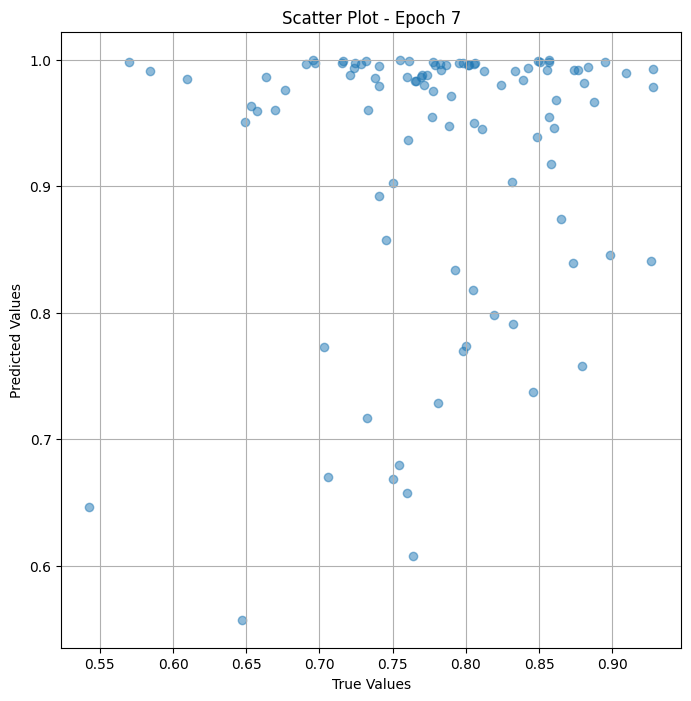


 Epoch: (8/50) Loss = 0.013212533667683601

 Epoch: (8/50) Loss_rmse = 0.11494578421115875

 Epoch: (8/50) R^2 = -5.685214996337891

 Epoch: (8/50) MAE = 0.10180246829986572

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.733

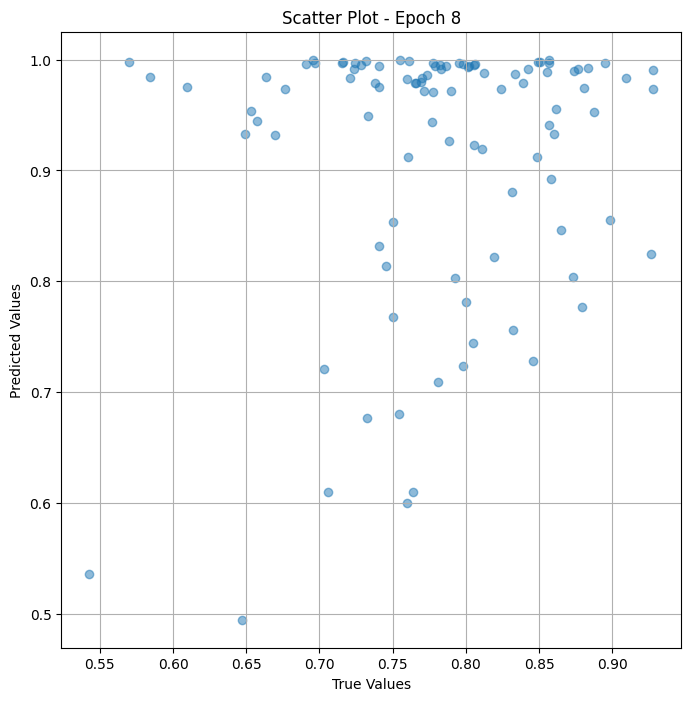


 Epoch: (9/50) Loss = 0.012521404772996902

 Epoch: (9/50) Loss_rmse = 0.11189908534288406

 Epoch: (9/50) R^2 = -5.3355207443237305

 Epoch: (9/50) MAE = 0.10193948447704315

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.73

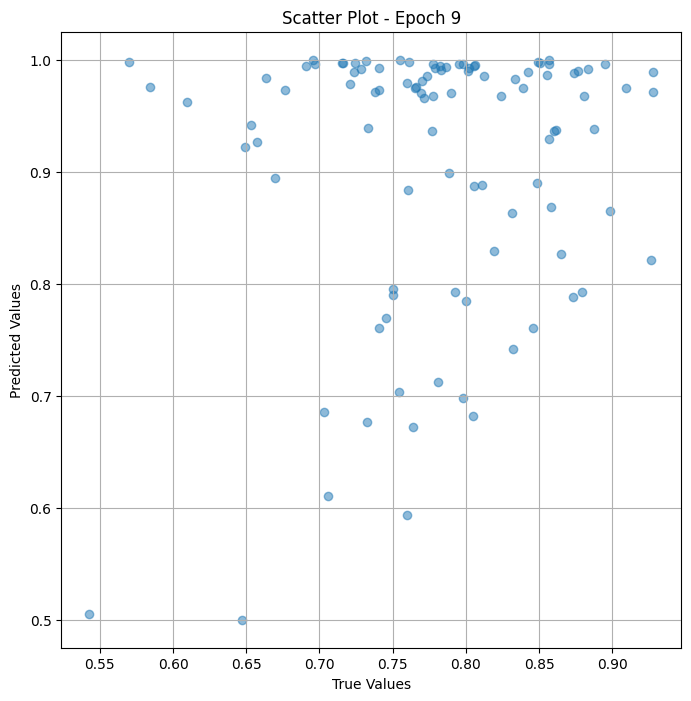


 Epoch: (10/50) Loss = 0.010899846442043781

 Epoch: (10/50) Loss_rmse = 0.1044023260474205

 Epoch: (10/50) R^2 = -4.515052318572998

 Epoch: (10/50) MAE = 0.08551546931266785

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.

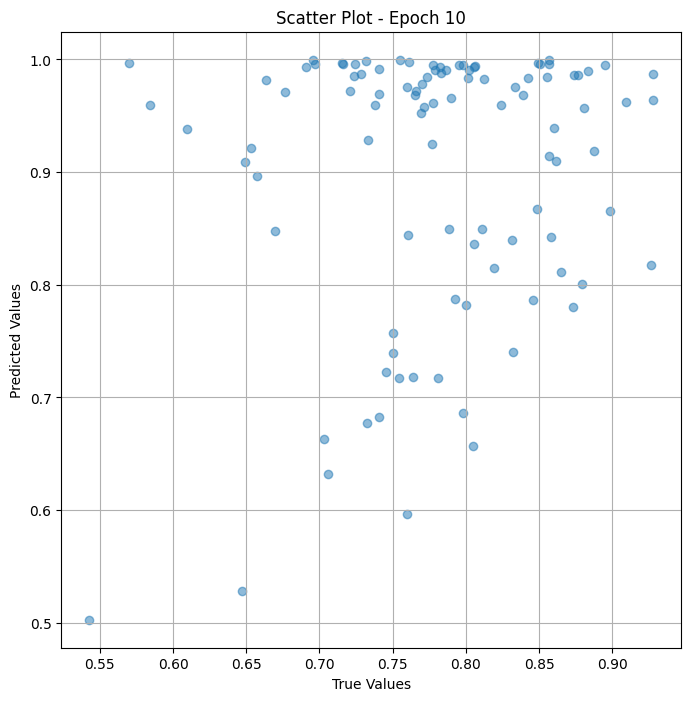


 Epoch: (11/50) Loss = 0.010045831091701984

 Epoch: (11/50) Loss_rmse = 0.10022889077663422

 Epoch: (11/50) R^2 = -4.082942008972168

 Epoch: (11/50) MAE = 0.0808325856924057

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.

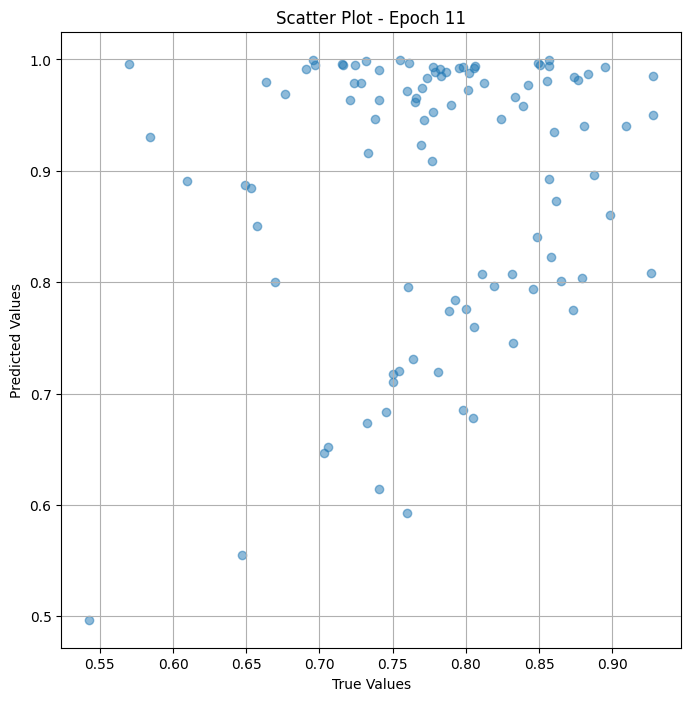


 Epoch: (12/50) Loss = 0.009362705051898956

 Epoch: (12/50) Loss_rmse = 0.0967610701918602

 Epoch: (12/50) R^2 = -3.7372970581054688

 Epoch: (12/50) MAE = 0.078778475522995

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7

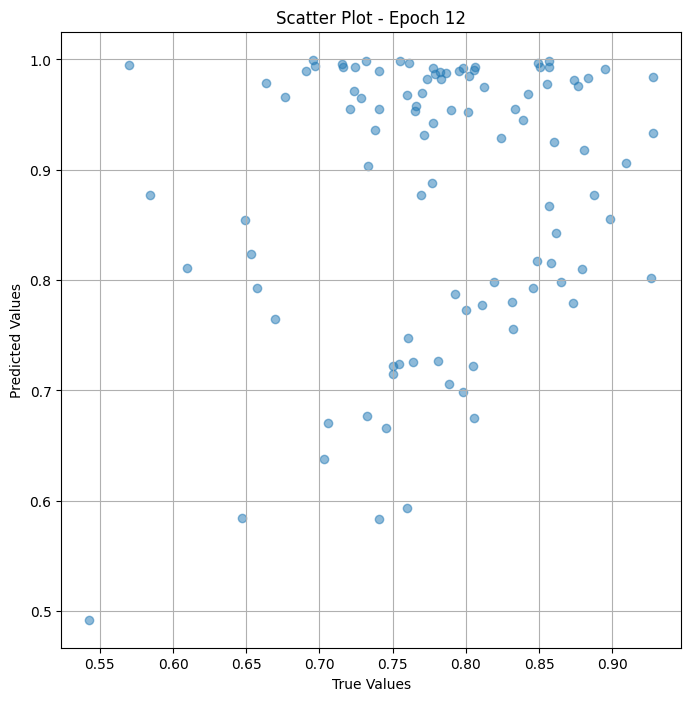


 Epoch: (13/50) Loss = 0.008483230136334896

 Epoch: (13/50) Loss_rmse = 0.09210444986820221

 Epoch: (13/50) R^2 = -3.292304515838623

 Epoch: (13/50) MAE = 0.07213380932807922

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0

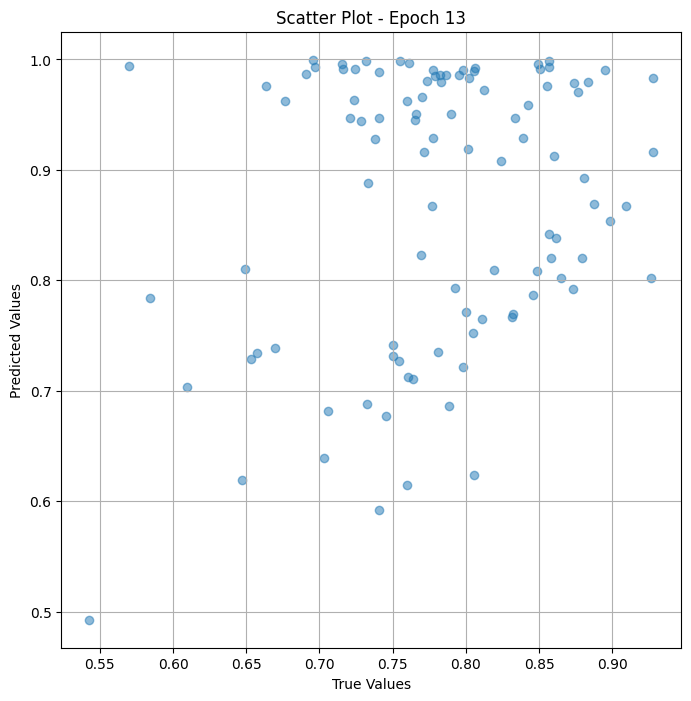


 Epoch: (14/50) Loss = 0.007397271227091551

 Epoch: (14/50) Loss_rmse = 0.08600739389657974

 Epoch: (14/50) R^2 = -2.7428359985351562

 Epoch: (14/50) MAE = 0.06359982490539551

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 

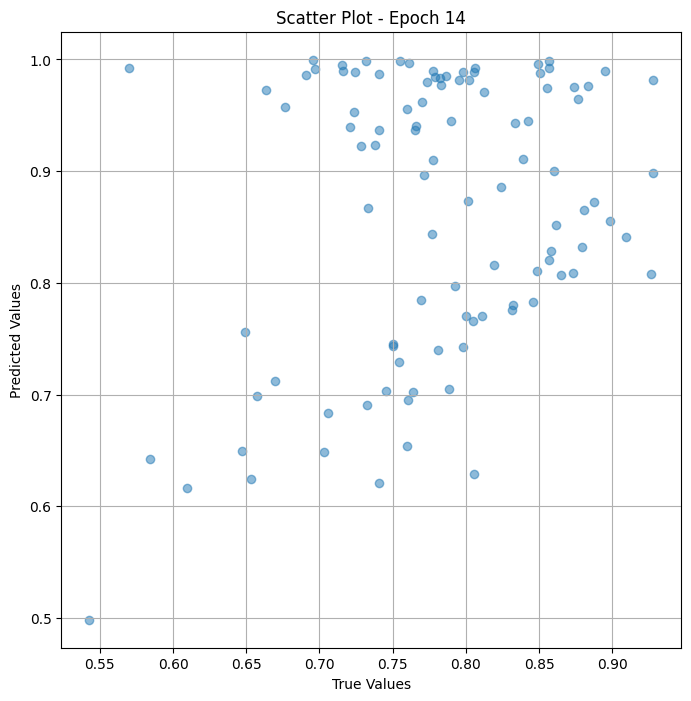


 Epoch: (15/50) Loss = 0.005995473824441433

 Epoch: (15/50) Loss_rmse = 0.07743044197559357

 Epoch: (15/50) R^2 = -2.0335612297058105

 Epoch: (15/50) MAE = 0.05635485053062439

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 

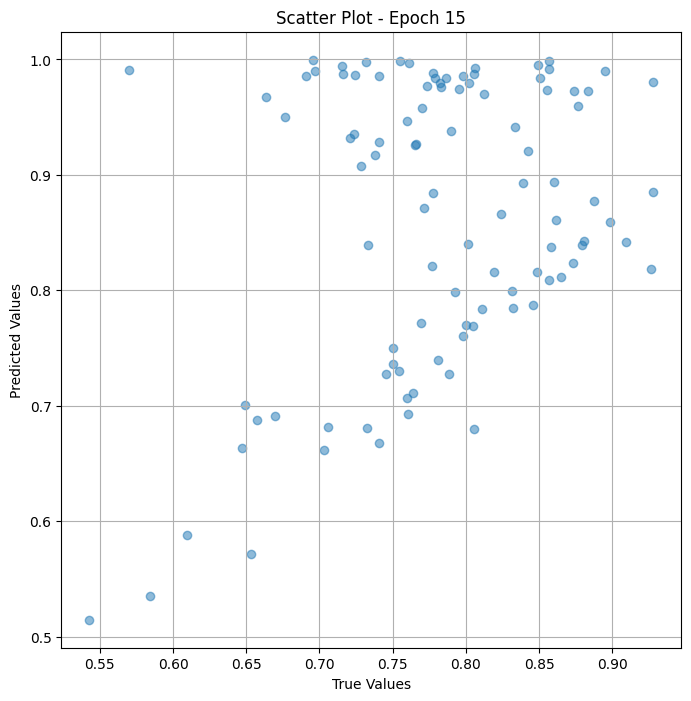


 Epoch: (16/50) Loss = 0.004170010332018137

 Epoch: (16/50) Loss_rmse = 0.06457561999559402

 Epoch: (16/50) R^2 = -1.109921932220459

 Epoch: (16/50) MAE = 0.04490688443183899

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0

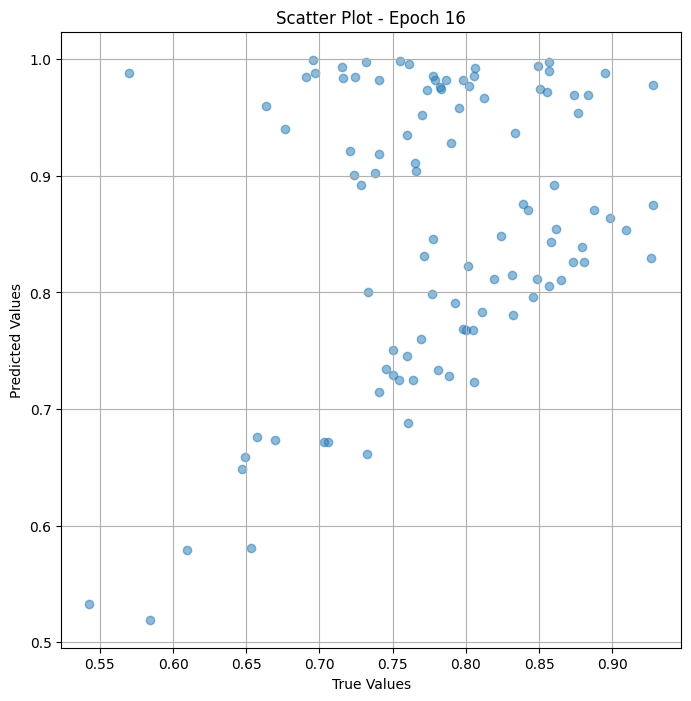


 Epoch: (17/50) Loss = 0.003522609593346715

 Epoch: (17/50) Loss_rmse = 0.05935157462954521

 Epoch: (17/50) R^2 = -0.7823532819747925

 Epoch: (17/50) MAE = 0.044892773032188416

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

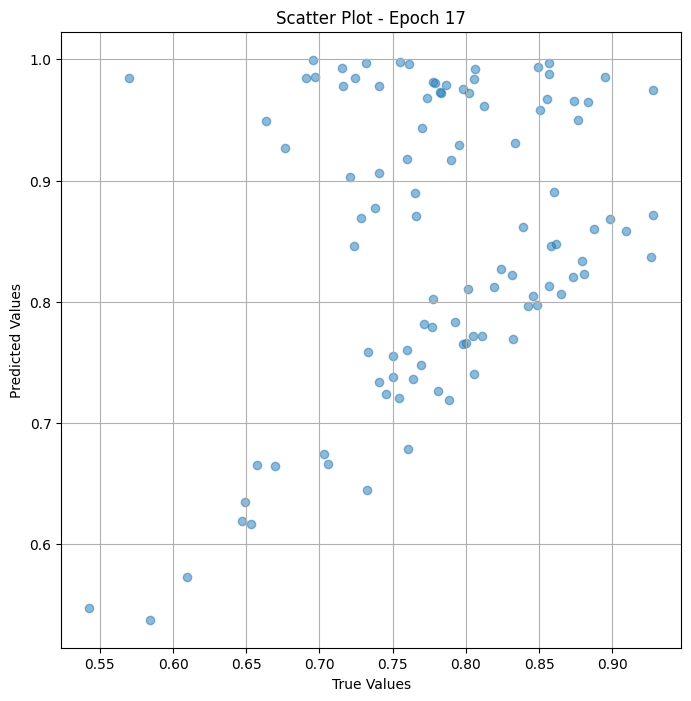


 Epoch: (18/50) Loss = 0.0035051347222179174

 Epoch: (18/50) Loss_rmse = 0.05920417979359627

 Epoch: (18/50) R^2 = -0.7735114097595215

 Epoch: (18/50) MAE = 0.044636622071266174

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

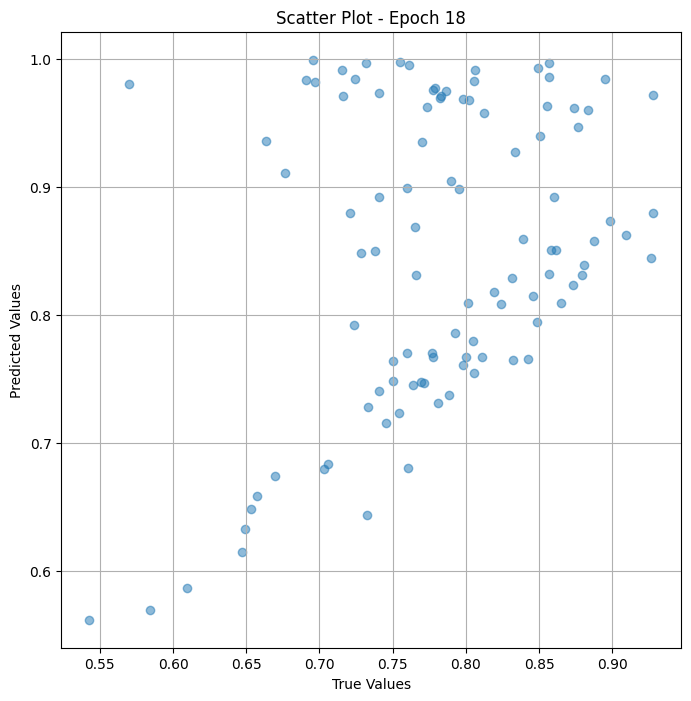


 Epoch: (19/50) Loss = 0.0018794079078361392

 Epoch: (19/50) Loss_rmse = 0.04335213825106621

 Epoch: (19/50) R^2 = 0.049066126346588135

 Epoch: (19/50) MAE = 0.03250125050544739

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

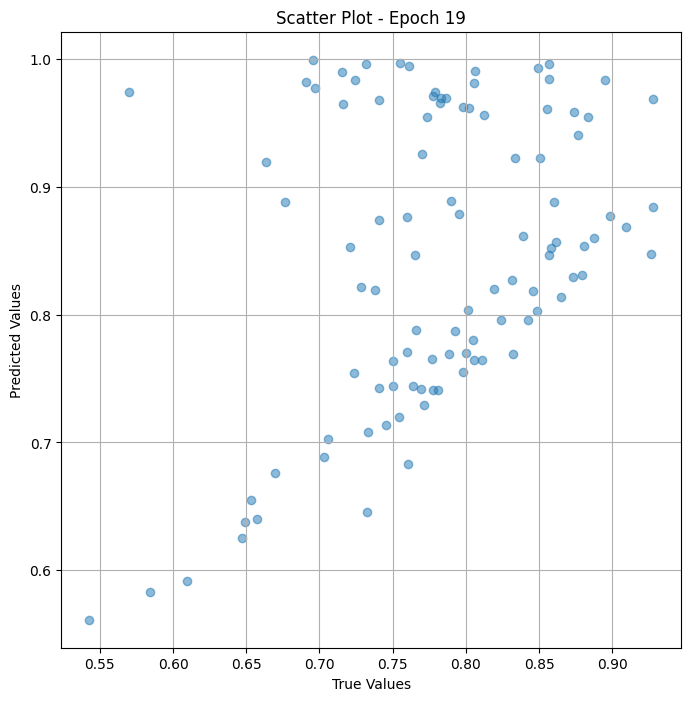


 Epoch: (20/50) Loss = 0.0007784127374179661

 Epoch: (20/50) Loss_rmse = 0.027900049462914467

 Epoch: (20/50) R^2 = 0.6061424016952515

 Epoch: (20/50) MAE = 0.022284939885139465

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

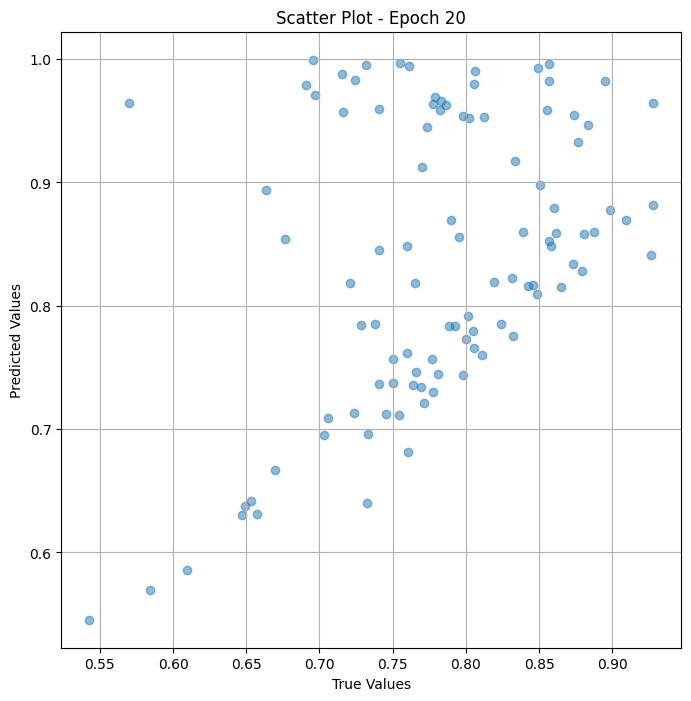


 Epoch: (21/50) Loss = 0.000170443337992765

 Epoch: (21/50) Loss_rmse = 0.01305539533495903

 Epoch: (21/50) R^2 = 0.9137598872184753

 Epoch: (21/50) MAE = 0.011553779244422913

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 

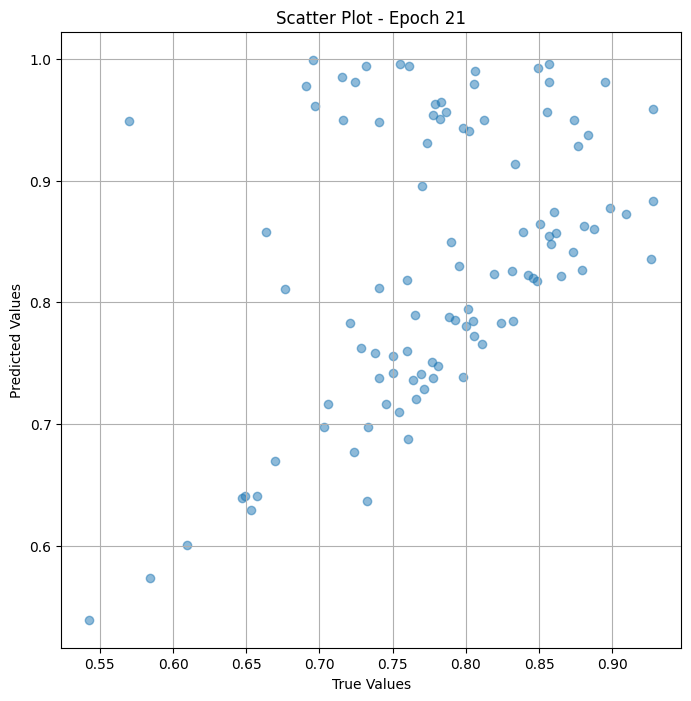


 Epoch: (22/50) Loss = 0.00011772548168664798

 Epoch: (22/50) Loss_rmse = 0.01085013709962368

 Epoch: (22/50) R^2 = 0.9404338002204895

 Epoch: (22/50) MAE = 0.010289192199707031

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

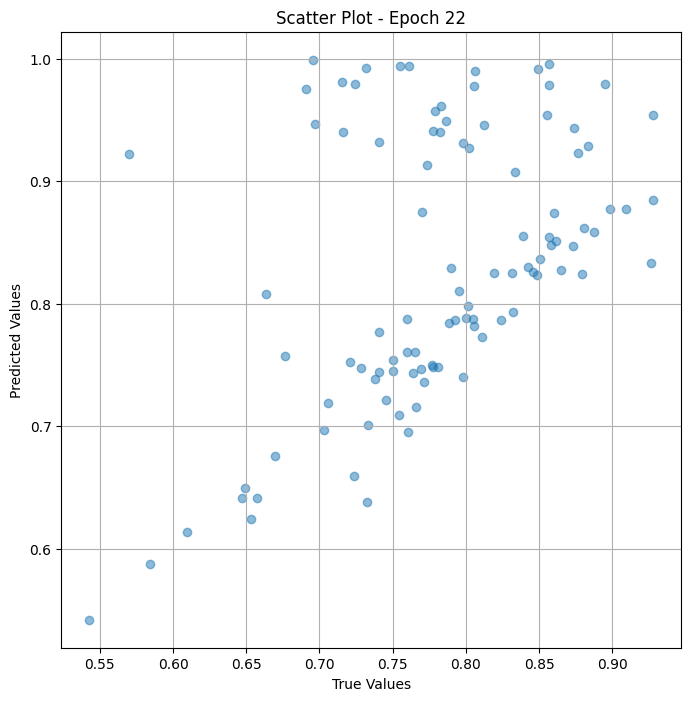


 Epoch: (23/50) Loss = 0.00010694465890992433

 Epoch: (23/50) Loss_rmse = 0.010341404937207699

 Epoch: (23/50) R^2 = 0.9458886384963989

 Epoch: (23/50) MAE = 0.008724048733711243

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

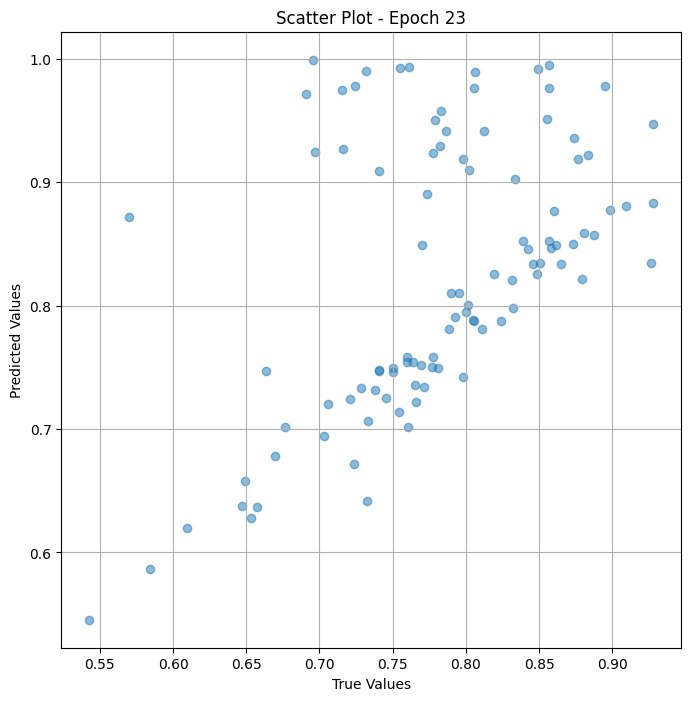


 Epoch: (24/50) Loss = 0.00011751468991860747

 Epoch: (24/50) Loss_rmse = 0.010840419679880142

 Epoch: (24/50) R^2 = 0.9405404925346375

 Epoch: (24/50) MAE = 0.010047867894172668

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

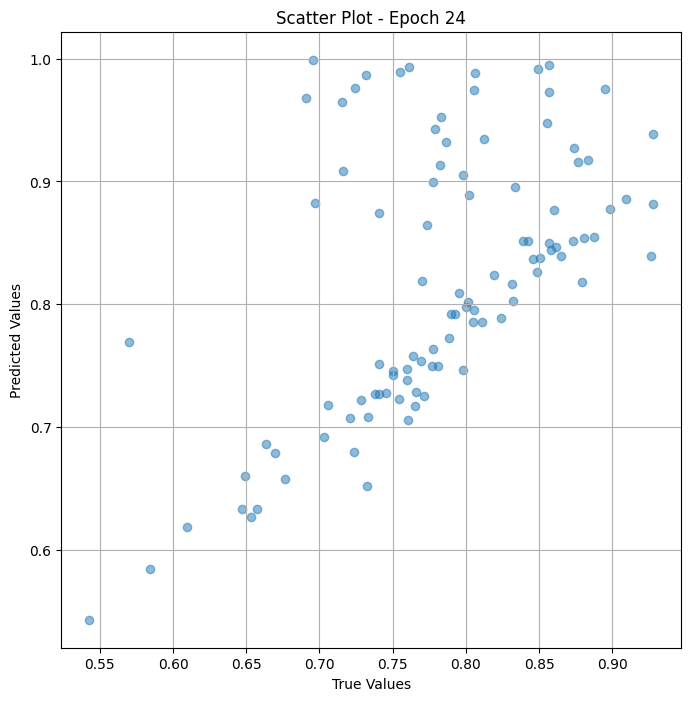


 Epoch: (25/50) Loss = 9.175058221444488e-05

 Epoch: (25/50) Loss_rmse = 0.009578652679920197

 Epoch: (25/50) R^2 = 0.9535764455795288

 Epoch: (25/50) MAE = 0.008117780089378357

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

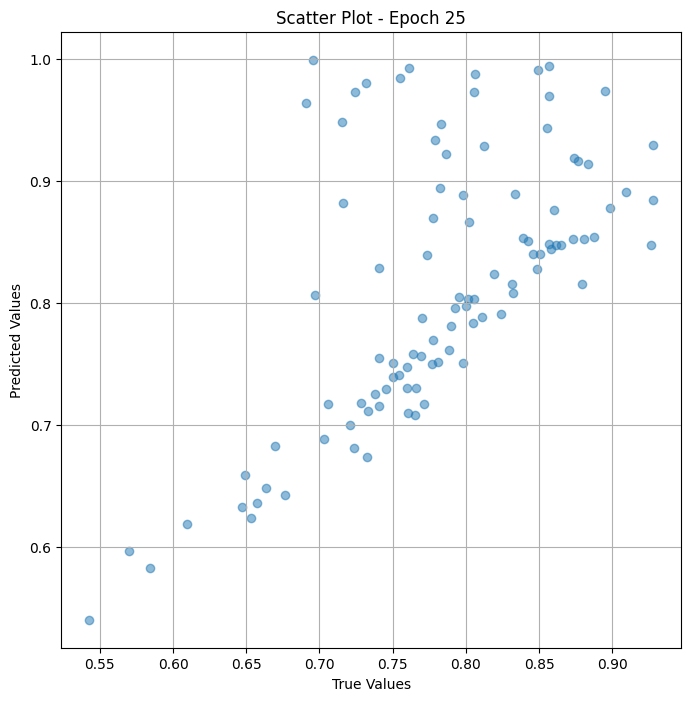


 Epoch: (26/50) Loss = 5.824564505019225e-05

 Epoch: (26/50) Loss_rmse = 0.00763188349083066

 Epoch: (26/50) R^2 = 0.9705291390419006

 Epoch: (26/50) MAE = 0.006957918405532837

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

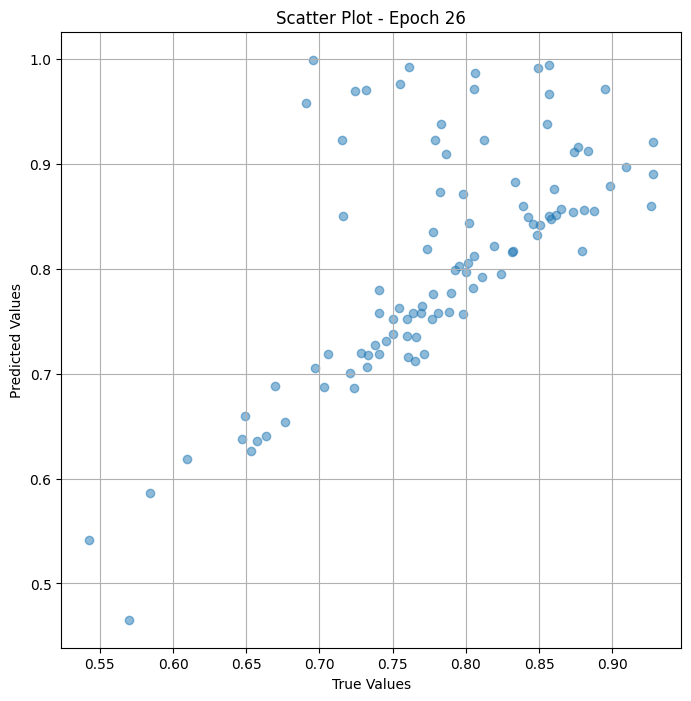


 Epoch: (27/50) Loss = 2.9357597668422386e-05

 Epoch: (27/50) Loss_rmse = 0.005418265238404274

 Epoch: (27/50) R^2 = 0.9851458072662354

 Epoch: (27/50) MAE = 0.004874780774116516

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

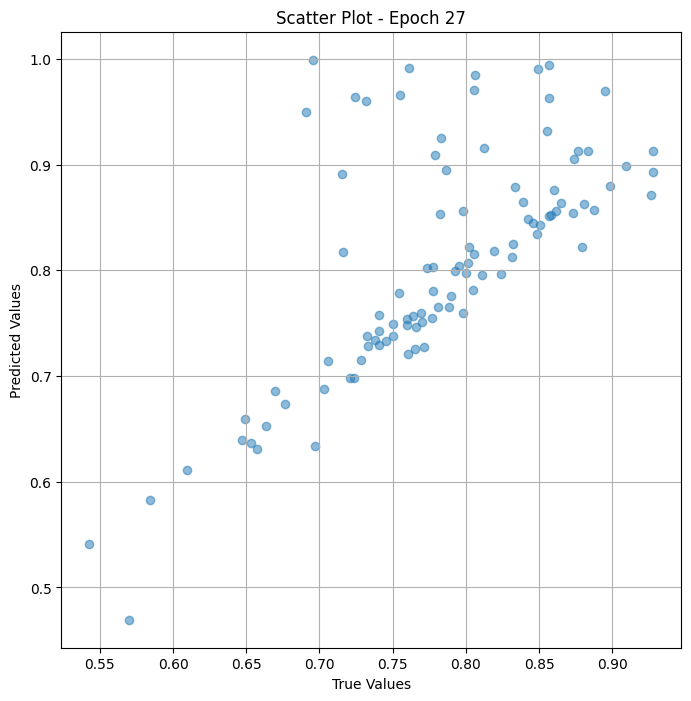


 Epoch: (28/50) Loss = 2.819589280989021e-05

 Epoch: (28/50) Loss_rmse = 0.005309980362653732

 Epoch: (28/50) R^2 = 0.9857335686683655

 Epoch: (28/50) MAE = 0.0044235289096832275

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

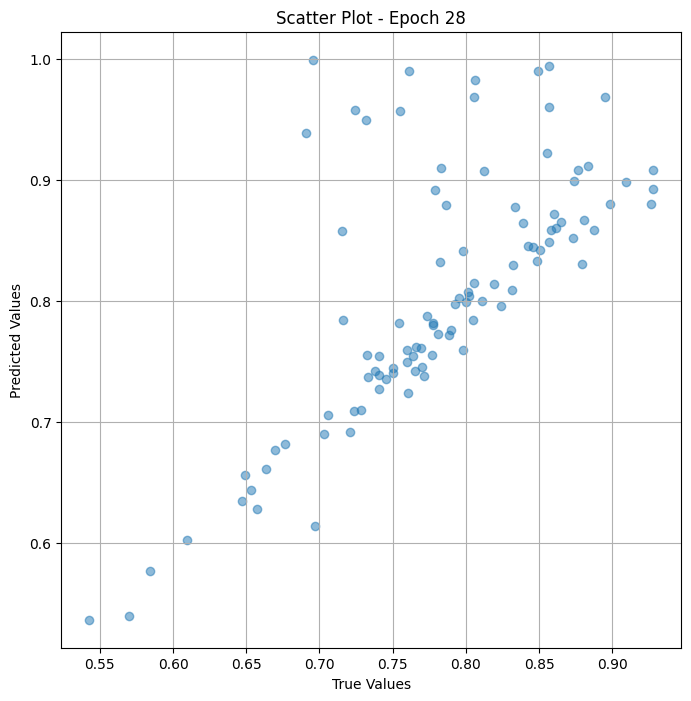


 Epoch: (29/50) Loss = 2.5901186745613813e-05

 Epoch: (29/50) Loss_rmse = 0.005089320708066225

 Epoch: (29/50) R^2 = 0.9868946671485901

 Epoch: (29/50) MAE = 0.003702878952026367

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

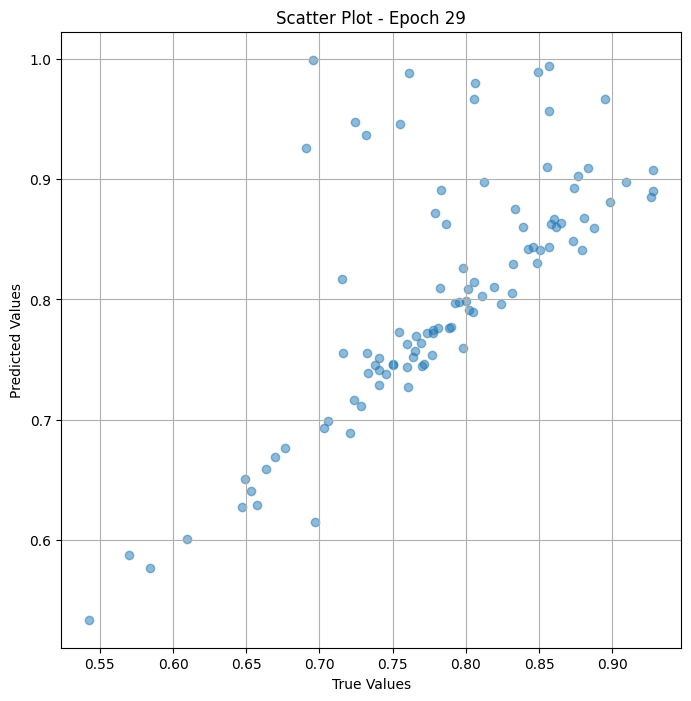


 Epoch: (30/50) Loss = 1.4086517694522627e-05

 Epoch: (30/50) Loss_rmse = 0.0037532011047005653

 Epoch: (30/50) R^2 = 0.9928725957870483

 Epoch: (30/50) MAE = 0.0026634186506271362

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

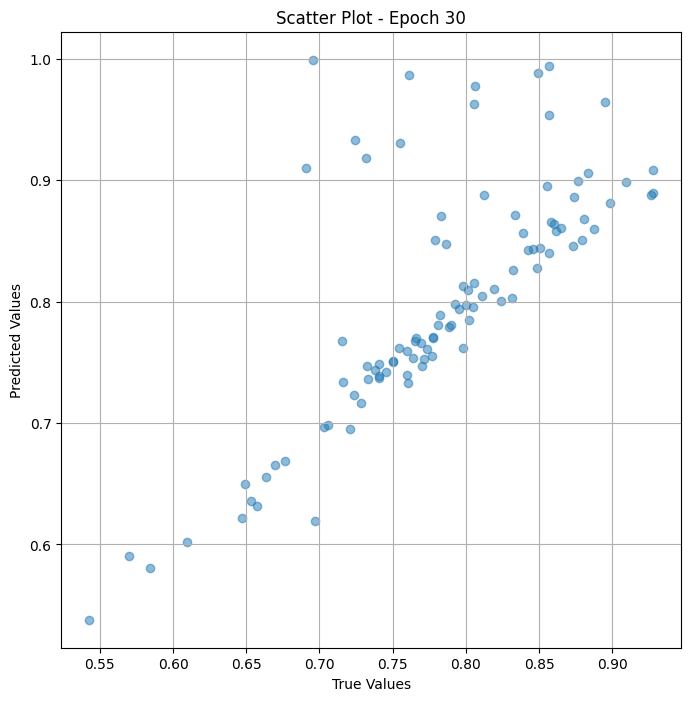


 Epoch: (31/50) Loss = 1.0703966836445034e-05

 Epoch: (31/50) Loss_rmse = 0.003271691733971238

 Epoch: (31/50) R^2 = 0.9945840835571289

 Epoch: (31/50) MAE = 0.00290052592754364

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

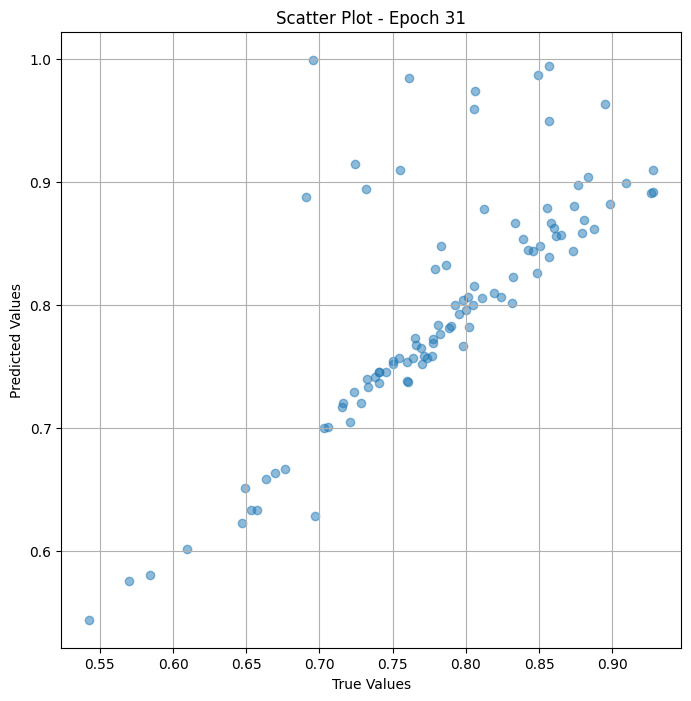


 Epoch: (32/50) Loss = 1.0125159860763233e-05

 Epoch: (32/50) Loss_rmse = 0.003182005602866411

 Epoch: (32/50) R^2 = 0.9948769211769104

 Epoch: (32/50) MAE = 0.002162262797355652

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

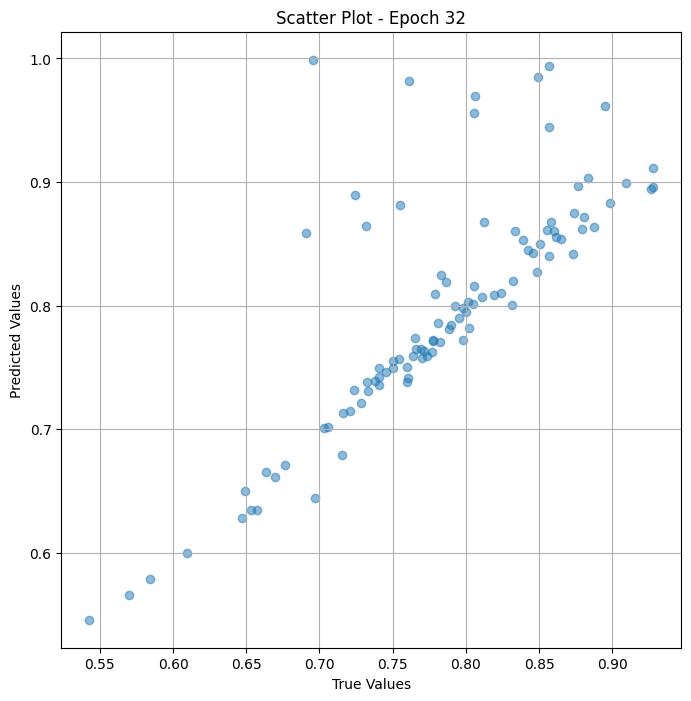


 Epoch: (33/50) Loss = 8.938311111705843e-06

 Epoch: (33/50) Loss_rmse = 0.002989700762555003

 Epoch: (33/50) R^2 = 0.9954774379730225

 Epoch: (33/50) MAE = 0.0021427422761917114

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

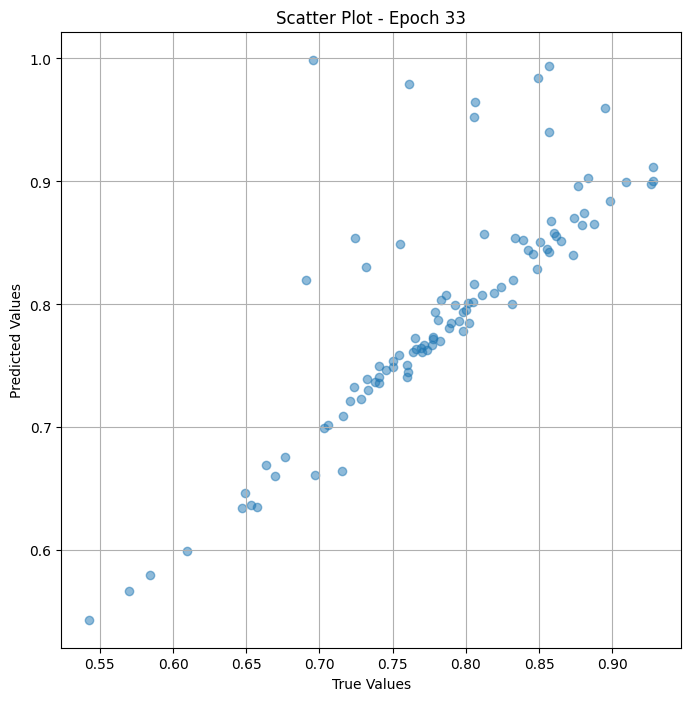


 Epoch: (34/50) Loss = 7.793504664732609e-06

 Epoch: (34/50) Loss_rmse = 0.0027916848193854094

 Epoch: (34/50) R^2 = 0.9960566759109497

 Epoch: (34/50) MAE = 0.0023054927587509155

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

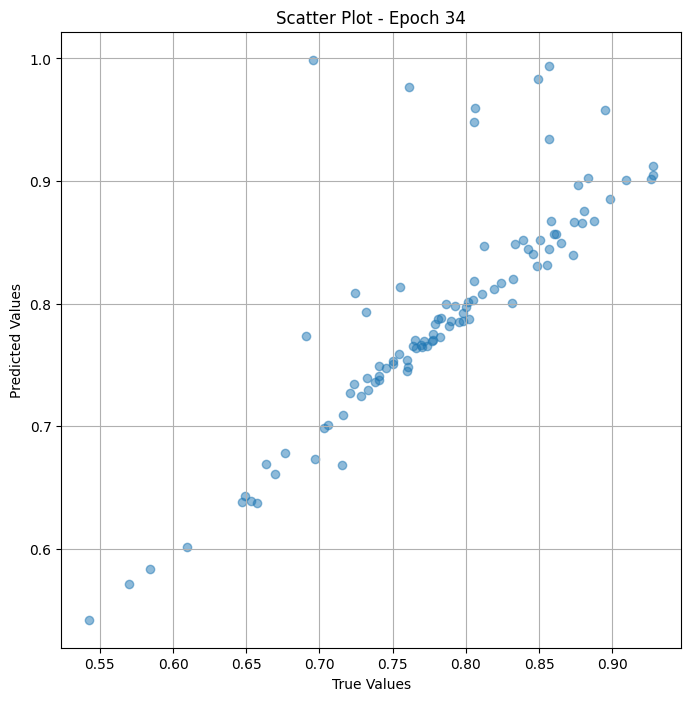


 Epoch: (35/50) Loss = 6.407543878594879e-06

 Epoch: (35/50) Loss_rmse = 0.0025313126388937235

 Epoch: (35/50) R^2 = 0.9967579245567322

 Epoch: (35/50) MAE = 0.0022860318422317505

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

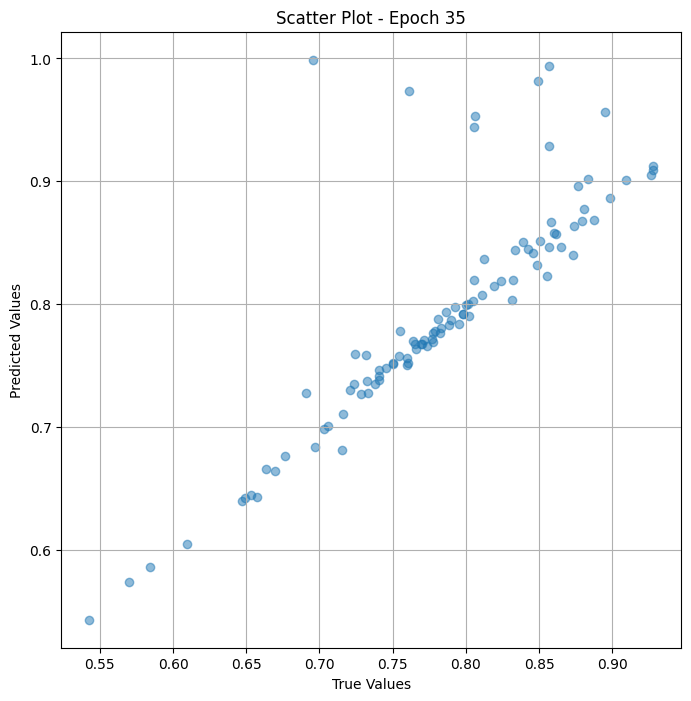


 Epoch: (36/50) Loss = 3.4299707749596564e-06

 Epoch: (36/50) Loss_rmse = 0.0018520180601626635

 Epoch: (36/50) R^2 = 0.998264491558075

 Epoch: (36/50) MAE = 0.001376524567604065

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

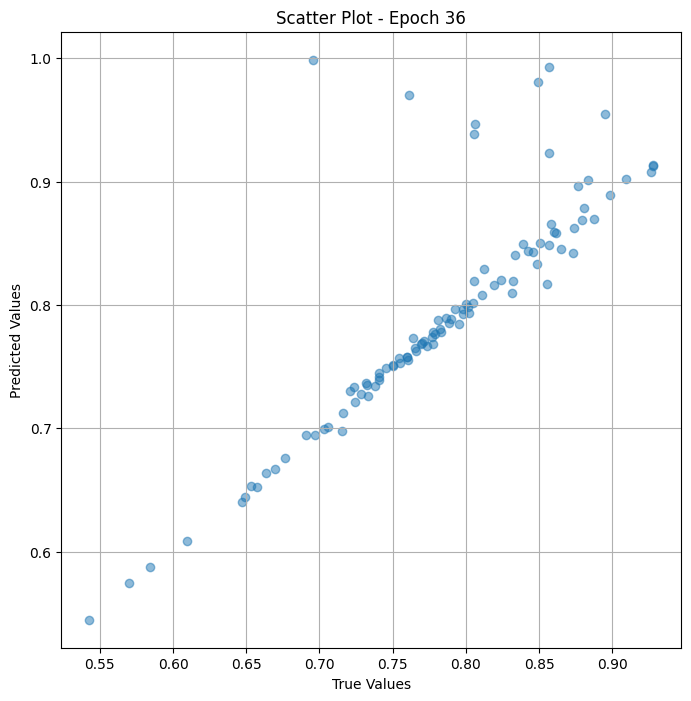


 Epoch: (37/50) Loss = 2.8799499887099955e-06

 Epoch: (37/50) Loss_rmse = 0.0016970415599644184

 Epoch: (37/50) R^2 = 0.998542845249176

 Epoch: (37/50) MAE = 0.001466900110244751

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

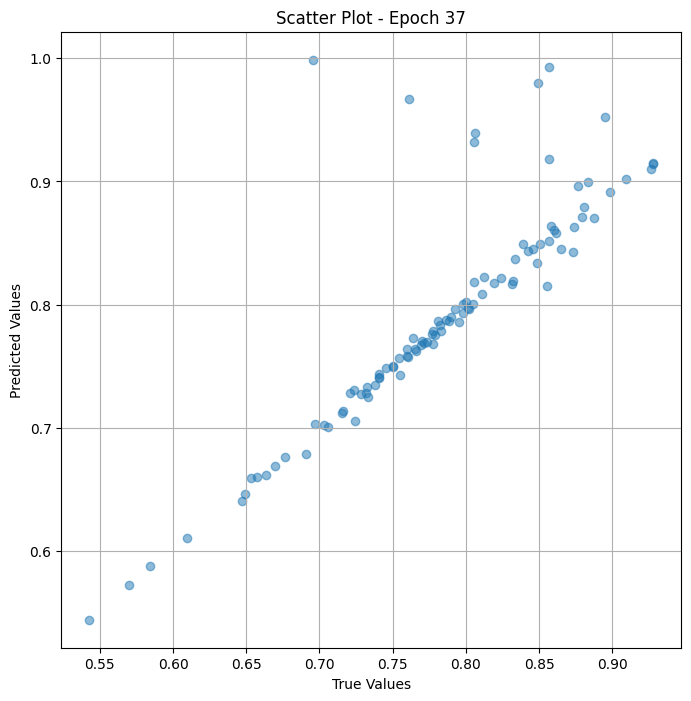


 Epoch: (38/50) Loss = 3.3825638183770934e-06

 Epoch: (38/50) Loss_rmse = 0.0018391747726127505

 Epoch: (38/50) R^2 = 0.9982885122299194

 Epoch: (38/50) MAE = 0.001696959137916565

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

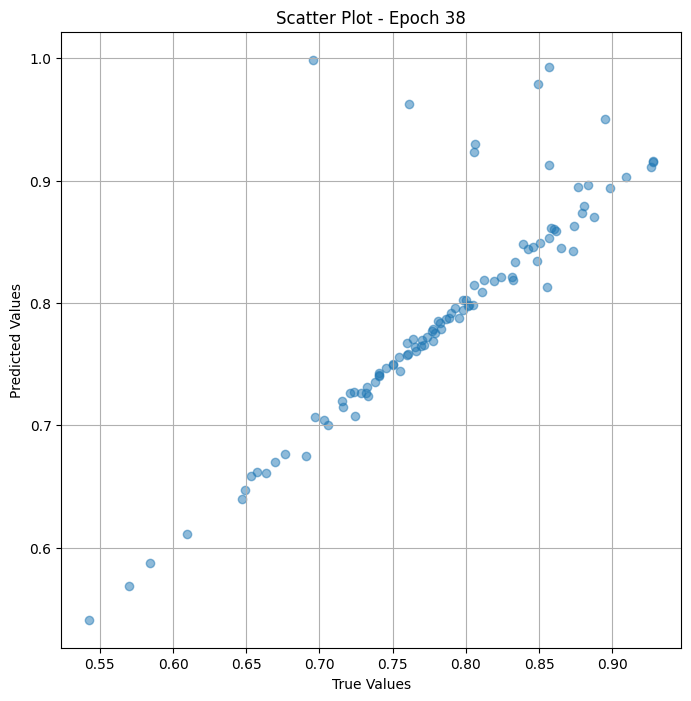


 Epoch: (39/50) Loss = 3.844433649646817e-06

 Epoch: (39/50) Loss_rmse = 0.001960722729563713

 Epoch: (39/50) R^2 = 0.9980548024177551

 Epoch: (39/50) MAE = 0.0017381161451339722

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

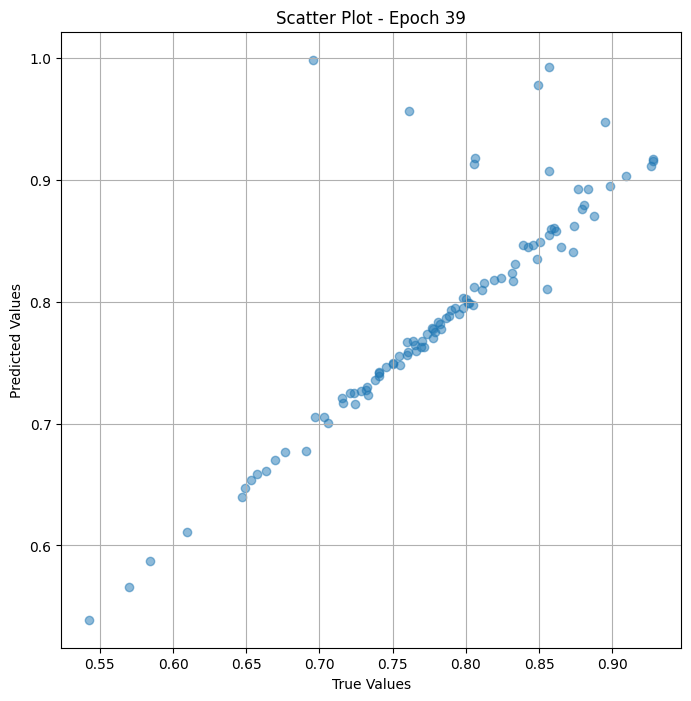


 Epoch: (40/50) Loss = 4.129791705054231e-06

 Epoch: (40/50) Loss_rmse = 0.00203218893148005

 Epoch: (40/50) R^2 = 0.9979104399681091

 Epoch: (40/50) MAE = 0.0017262846231460571

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

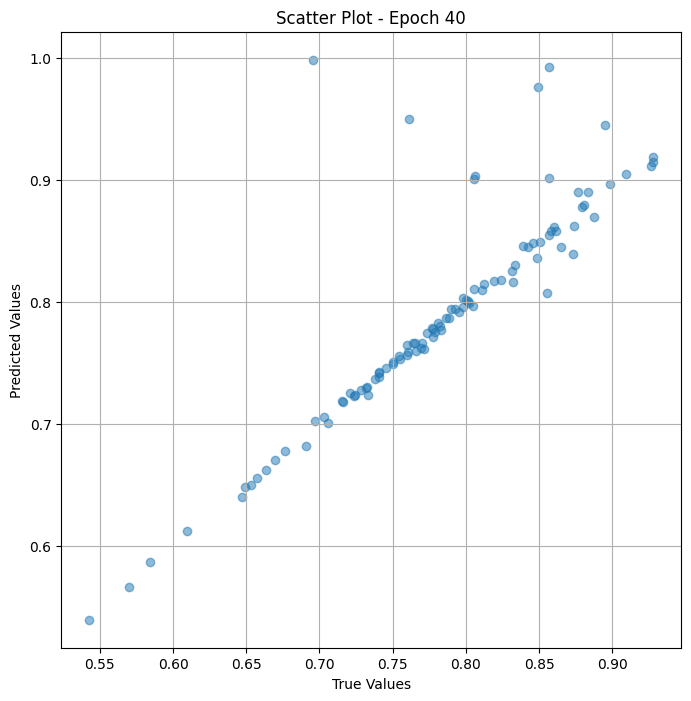


 Epoch: (41/50) Loss = 4.0095778786053415e-06

 Epoch: (41/50) Loss_rmse = 0.002002393128350377

 Epoch: (41/50) R^2 = 0.99797123670578

 Epoch: (41/50) MAE = 0.0016314834356307983

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

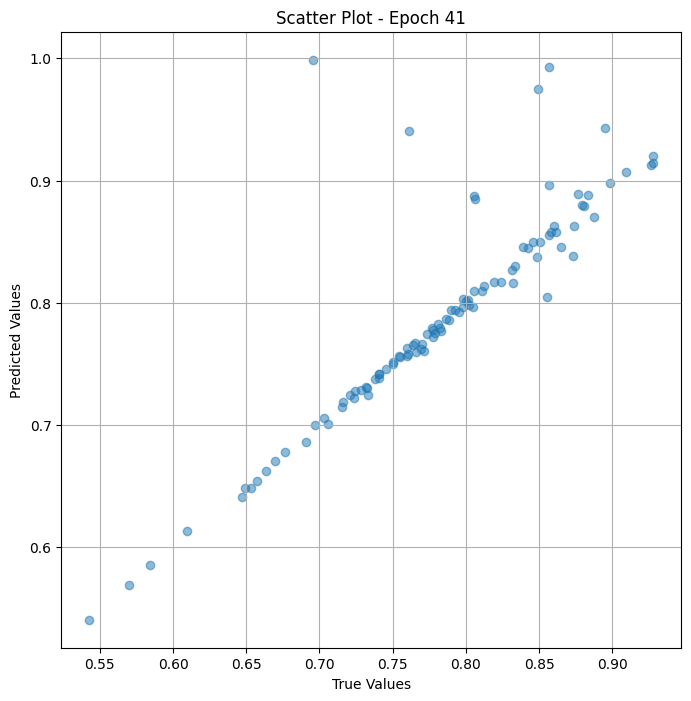


 Epoch: (42/50) Loss = 3.7117413285159273e-06

 Epoch: (42/50) Loss_rmse = 0.0019265880109742284

 Epoch: (42/50) R^2 = 0.998121976852417

 Epoch: (42/50) MAE = 0.001429036259651184

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

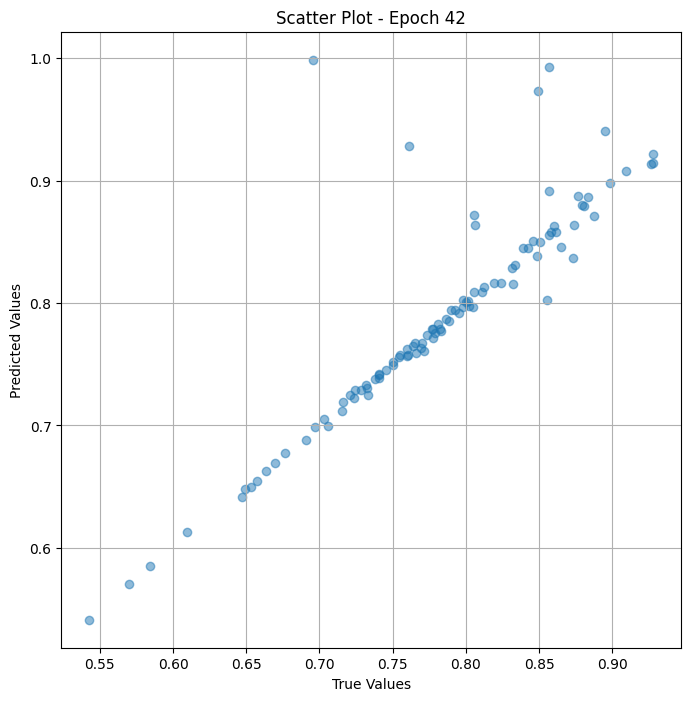


 Epoch: (43/50) Loss = 3.3351234378642403e-06

 Epoch: (43/50) Loss_rmse = 0.0018262320663779974

 Epoch: (43/50) R^2 = 0.9983125329017639

 Epoch: (43/50) MAE = 0.0013323277235031128

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

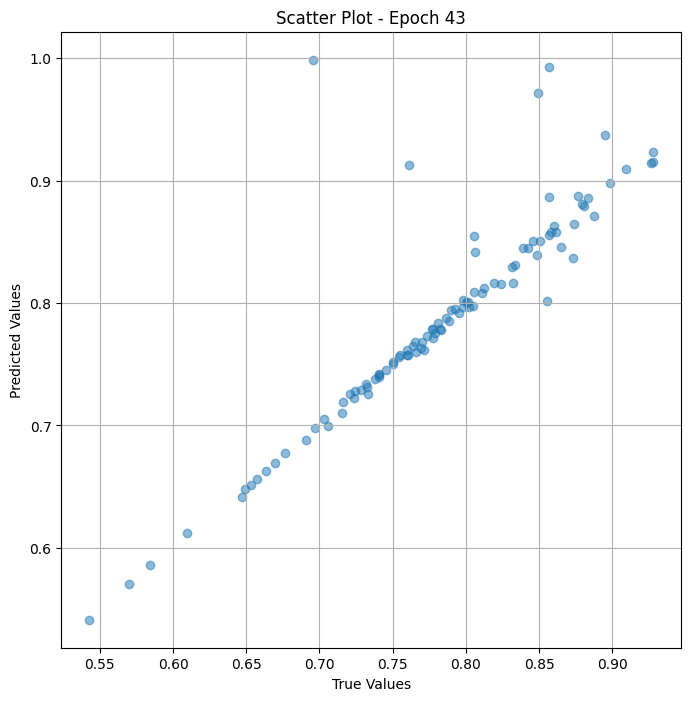


 Epoch: (44/50) Loss = 2.7683863663696684e-06

 Epoch: (44/50) Loss_rmse = 0.0016638468950986862

 Epoch: (44/50) R^2 = 0.9985992908477783

 Epoch: (44/50) MAE = 0.0012958943843841553

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

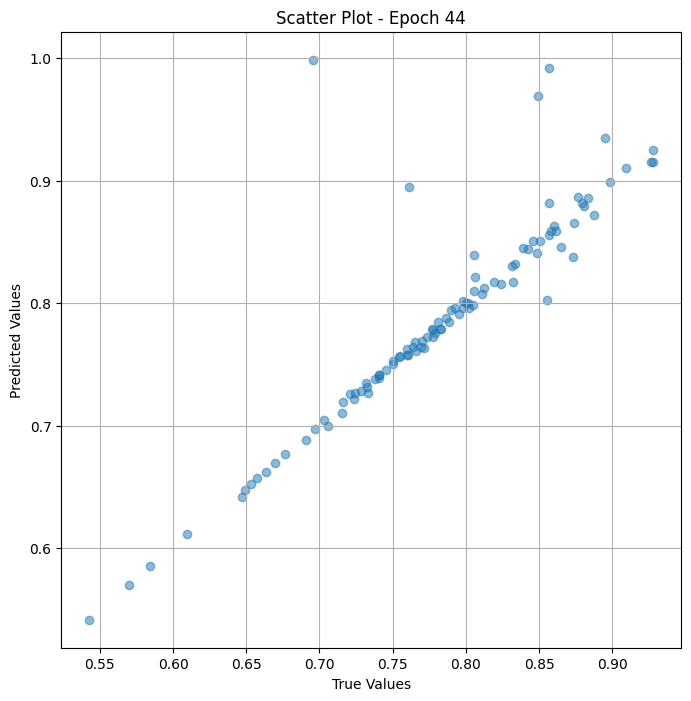


 Epoch: (45/50) Loss = 2.1599271349259652e-06

 Epoch: (45/50) Loss_rmse = 0.0014696690486744046

 Epoch: (45/50) R^2 = 0.9989071488380432

 Epoch: (45/50) MAE = 0.0011780261993408203

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

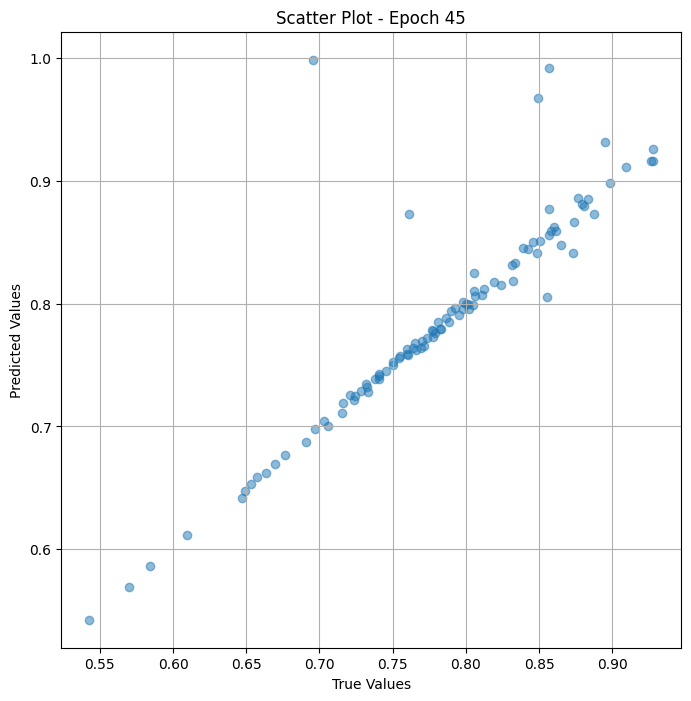


 Epoch: (46/50) Loss = 1.6192789189517498e-06

 Epoch: (46/50) Loss_rmse = 0.0012725088745355606

 Epoch: (46/50) R^2 = 0.9991806745529175

 Epoch: (46/50) MAE = 0.0010470449924468994

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

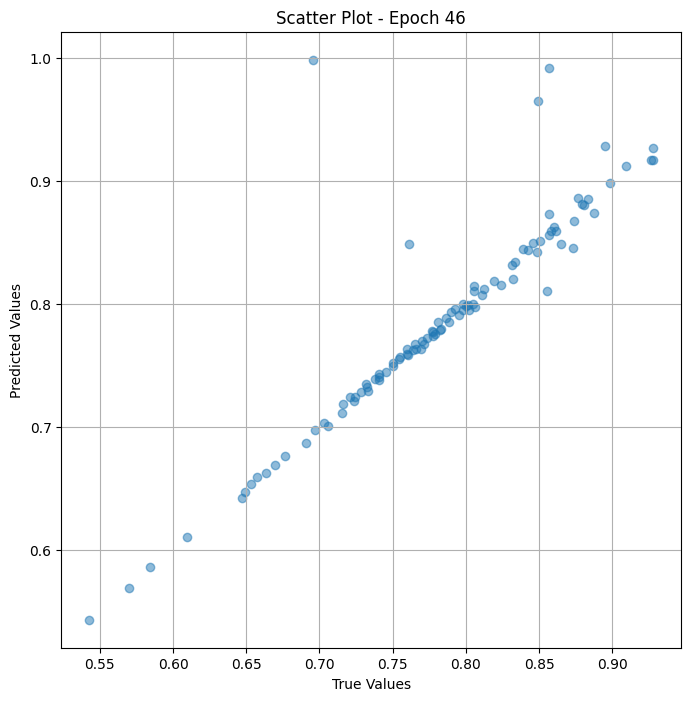


 Epoch: (47/50) Loss = 1.1208336445633904e-06

 Epoch: (47/50) Loss_rmse = 0.0010586943244561553

 Epoch: (47/50) R^2 = 0.9994328618049622

 Epoch: (47/50) MAE = 0.0008958429098129272

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

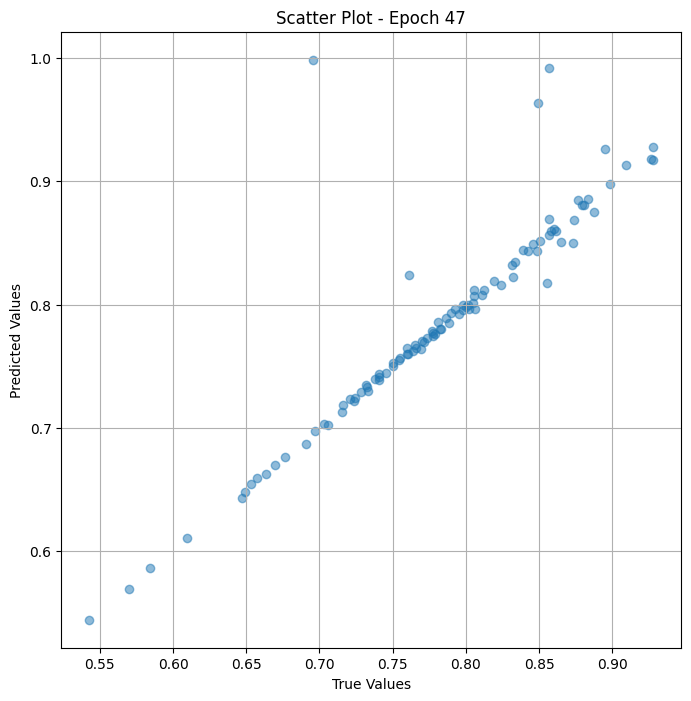


 Epoch: (48/50) Loss = 6.688823077638517e-07

 Epoch: (48/50) Loss_rmse = 0.0008178522693924606

 Epoch: (48/50) R^2 = 0.9996615648269653

 Epoch: (48/50) MAE = 0.0006988197565078735

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

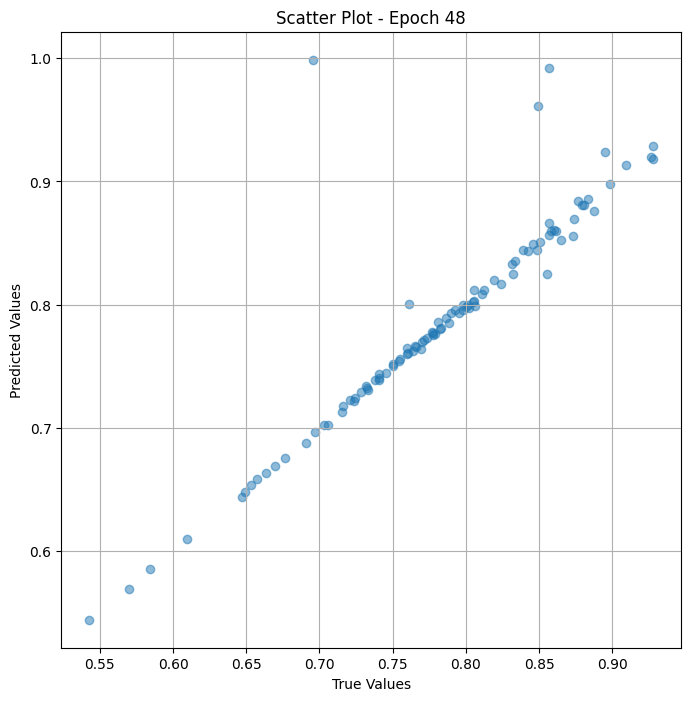


 Epoch: (49/50) Loss = 3.678431426124007e-07

 Epoch: (49/50) Loss_rmse = 0.0006065007182769477

 Epoch: (49/50) R^2 = 0.9998138546943665

 Epoch: (49/50) MAE = 0.0004943162202835083

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

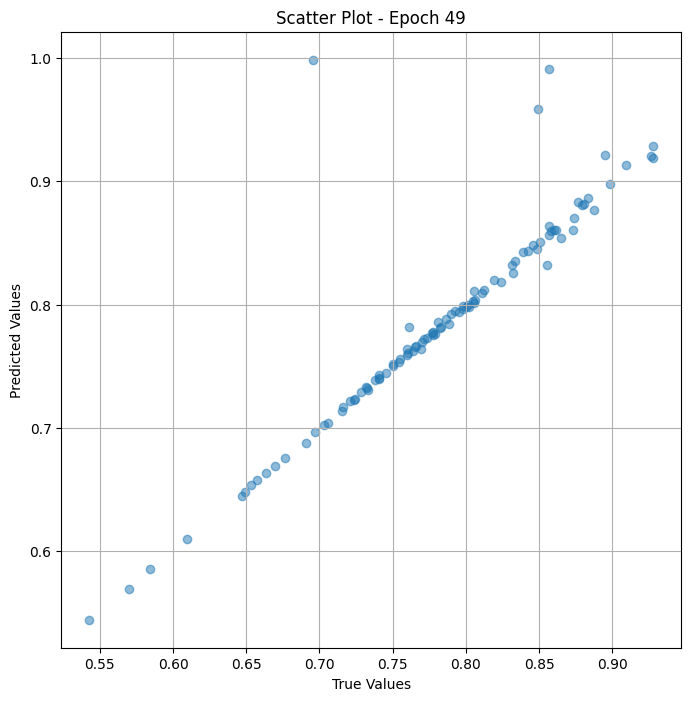


 Epoch: (50/50) Loss = 2.801204459501605e-07

 Epoch: (50/50) Loss_rmse = 0.0005292640416882932

 Epoch: (50/50) R^2 = 0.9998582601547241

 Epoch: (50/50) MAE = 0.0004013925790786743

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

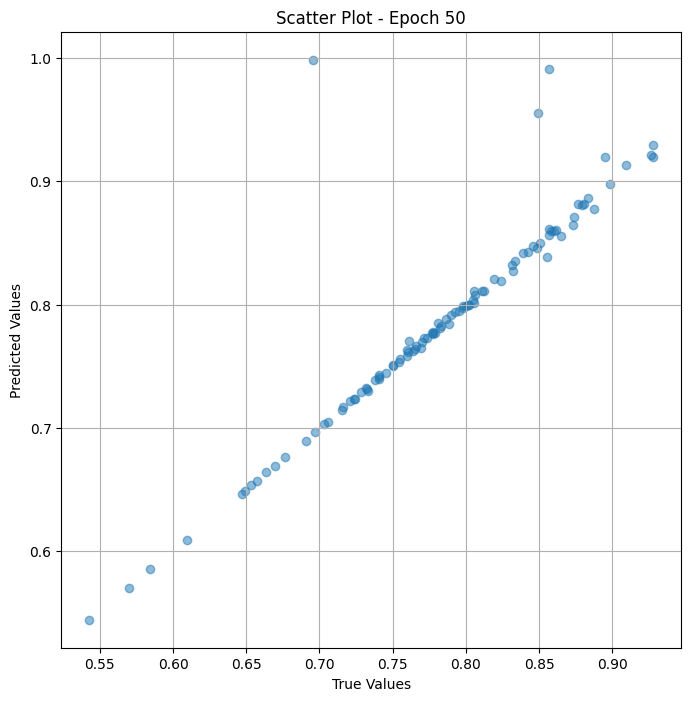

In [ ]:
# Training the model and save weights
fit(50, model_test, train_dl_test)
torch.save(model.state_dict(), "model_weights_vr_test")

In [ ]:
 true_values_list = [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77]

 predicted_values_list= [0.79931515, 0.77591014, 0.80045885, 0.8247813, 0.81693316, 0.5856961, 0.8244922, 0.7697562]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.8571428571428572 0.006530017254715292


# Finetune


## Train

In [ ]:
# Load the pre-trained ResNet model
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
for param in model_Res.parameters():
    param.requires_grad = True

# Add your custom layers for fine-tuning
#num_features = model_Res[0][-1].in_features  # Get the number of features in the last layer of ResNet

custom_layers = [
    nn.Flatten(),
    nn.Linear(2048, 512),  # Example: add a fully connected layer with 512 units
    nn.ReLU(),
    nn.Dropout(0.5),  # Example: add dropout for regularization
    nn.Linear(512, 1)  # Example: add the output layer with your desired number of classes
]

# Create a new model by combining ResNet and custom layers
fine_tuned_model = nn.Sequential(
    model_Res,
    *custom_layers
)

# Optionally, you can print the fine-tuned model architecture
print(fine_tuned_model)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [ ]:
# Load the pre-trained ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')

# Freeze some of the layers
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = True

# Extract the feature extractor
feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')

# Remove the classification head (top layers) from the model
model_trans_top = nn.Sequential(*list(model_trans.children())[:-2])

# Access the last linear layer and adjust its bias
last_linear_layer = list(model_trans.children())[-1]
# Assuming the last layer is a Linear layer
if isinstance(last_linear_layer, nn.Linear):
    # Adjust the bias as needed
    new_bias = torch.tensor([2.0])
    last_linear_layer.bias.data = new_bias

# Add Sigmoid activation
mymodel = nn.Sequential(last_linear_layer, nn.Sigmoid())

# Optionally, you can print the modified model architecture
print(mymodel)


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Sequential(
  (0): ViTPooler(
    (dense): Linear(in_features=768, out_features=768, bias=True)
    (activation): Tanh()
  )
  (1): Sigmoid()
)


In [ ]:
# Merge the two models
class model_merge_fine(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_fine(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.05163128674030304

 Epoch: (1/50) Loss_rmse = 0.2272251844406128

 Epoch: (1/50) R^2 = -5.9574971199035645

 Epoch: (1/50) MAE = 0.21133169531822205

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

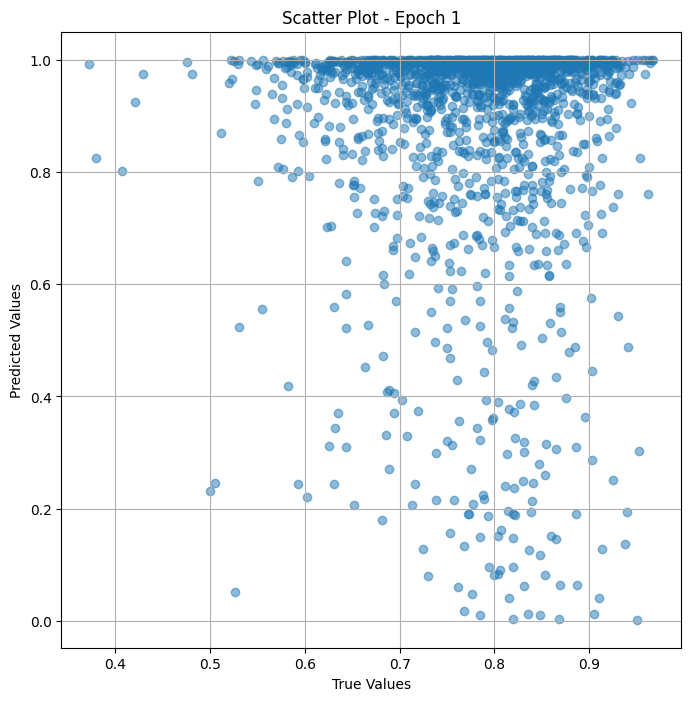


 Epoch: (2/50) Loss = 0.04721314460039139

 Epoch: (2/50) Loss_rmse = 0.2172858566045761

 Epoch: (2/50) R^2 = -5.3621368408203125

 Epoch: (2/50) MAE = 0.19747744500637054

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

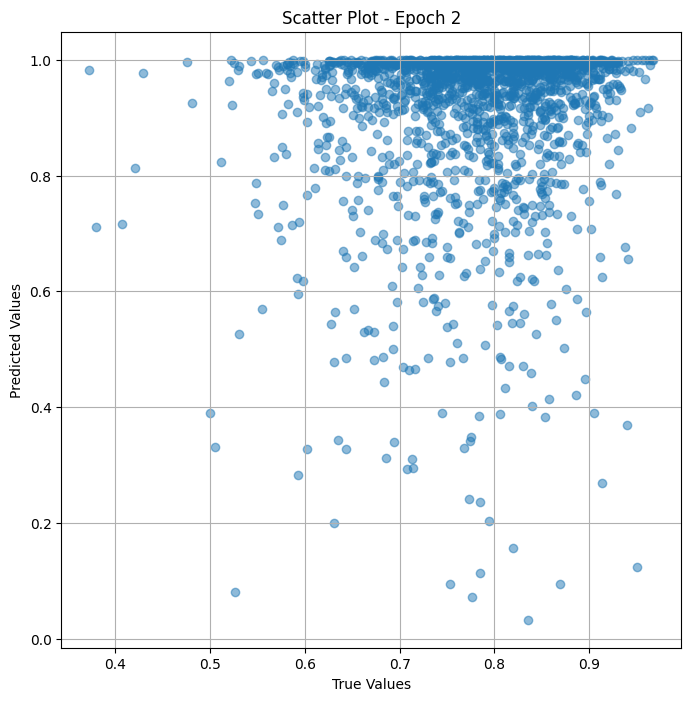


 Epoch: (3/50) Loss = 0.04159601405262947

 Epoch: (3/50) Loss_rmse = 0.20395101606845856

 Epoch: (3/50) R^2 = -4.605208873748779

 Epoch: (3/50) MAE = 0.168418750166893

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.604

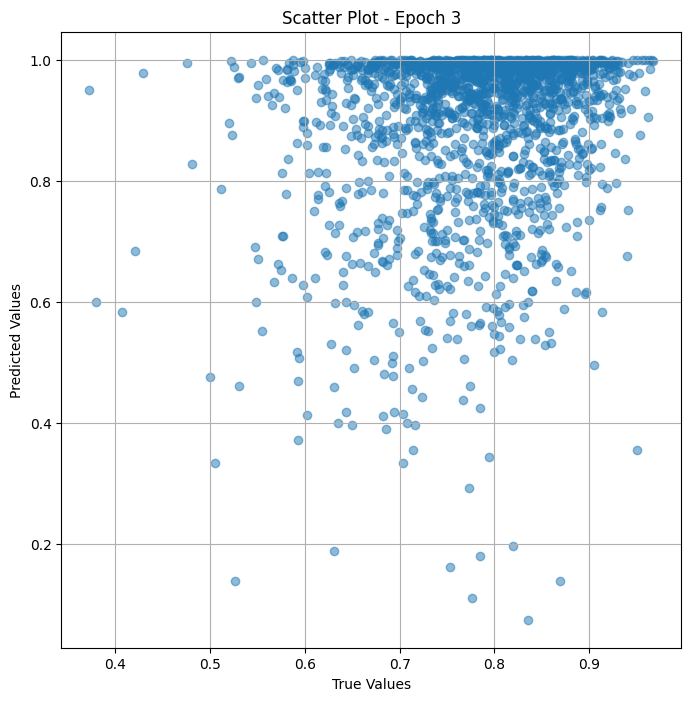


 Epoch: (4/50) Loss = 0.04067549854516983

 Epoch: (4/50) Loss_rmse = 0.20168167352676392

 Epoch: (4/50) R^2 = -4.481165885925293

 Epoch: (4/50) MAE = 0.17230738699436188

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

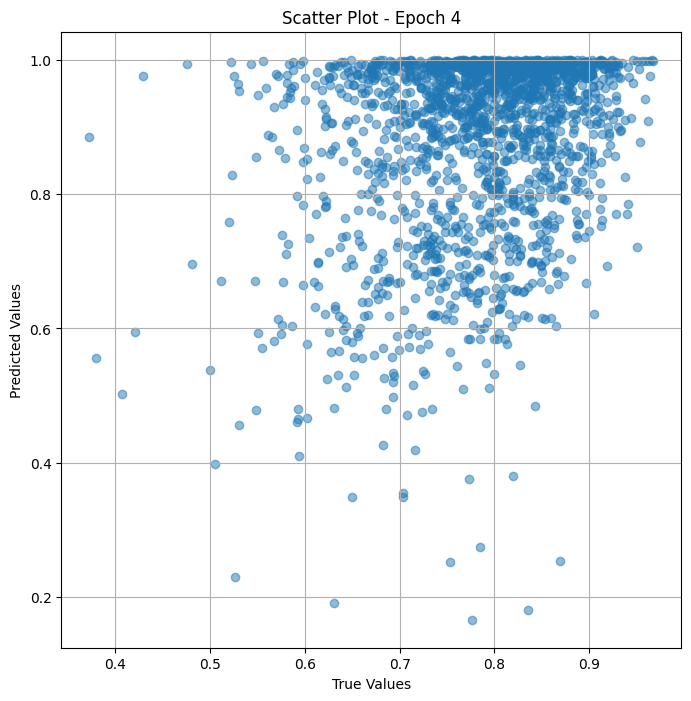


 Epoch: (5/50) Loss = 0.038381800055503845

 Epoch: (5/50) Loss_rmse = 0.19591273367404938

 Epoch: (5/50) R^2 = -4.172082424163818

 Epoch: (5/50) MAE = 0.1673983633518219

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.6

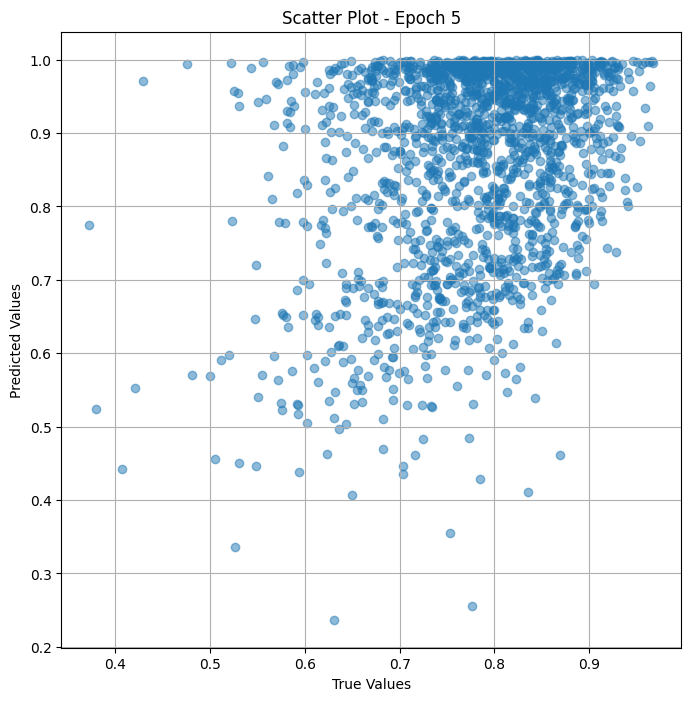


 Epoch: (6/50) Loss = 0.033737536519765854

 Epoch: (6/50) Loss_rmse = 0.1836778074502945

 Epoch: (6/50) R^2 = -3.5462512969970703

 Epoch: (6/50) MAE = 0.15425923466682434

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0.

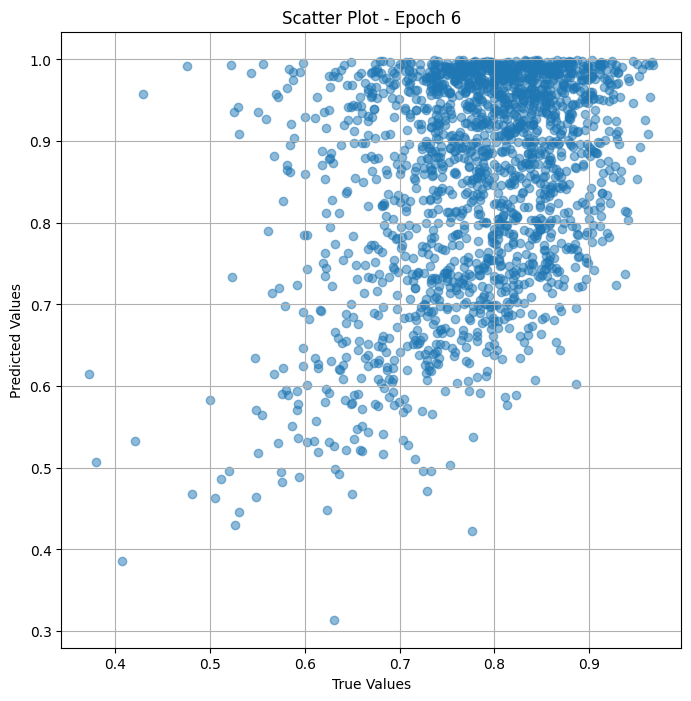


 Epoch: (7/50) Loss = 0.027895158156752586

 Epoch: (7/50) Loss_rmse = 0.16701844334602356

 Epoch: (7/50) R^2 = -2.7589704990386963

 Epoch: (7/50) MAE = 0.13947314023971558

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0

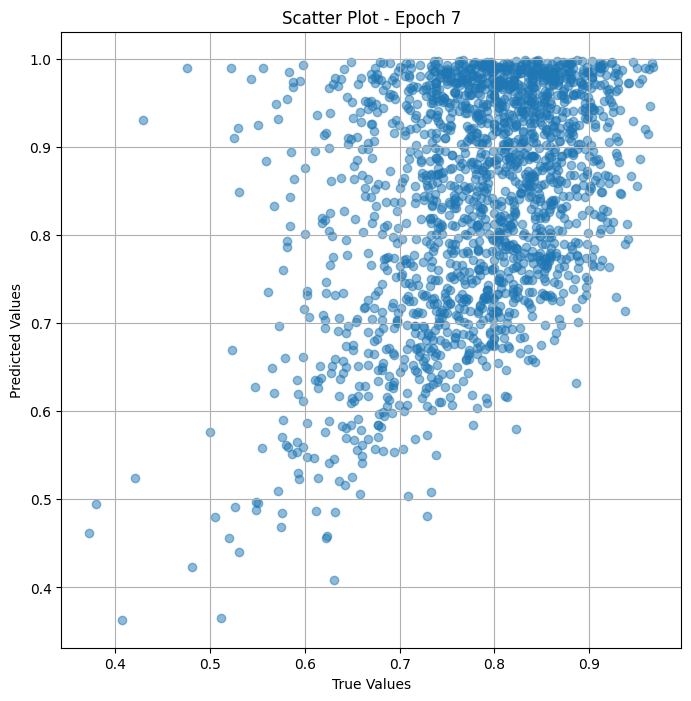


 Epoch: (8/50) Loss = 0.018539978191256523

 Epoch: (8/50) Loss_rmse = 0.13616159558296204

 Epoch: (8/50) R^2 = -1.4983270168304443

 Epoch: (8/50) MAE = 0.11597847938537598

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 0

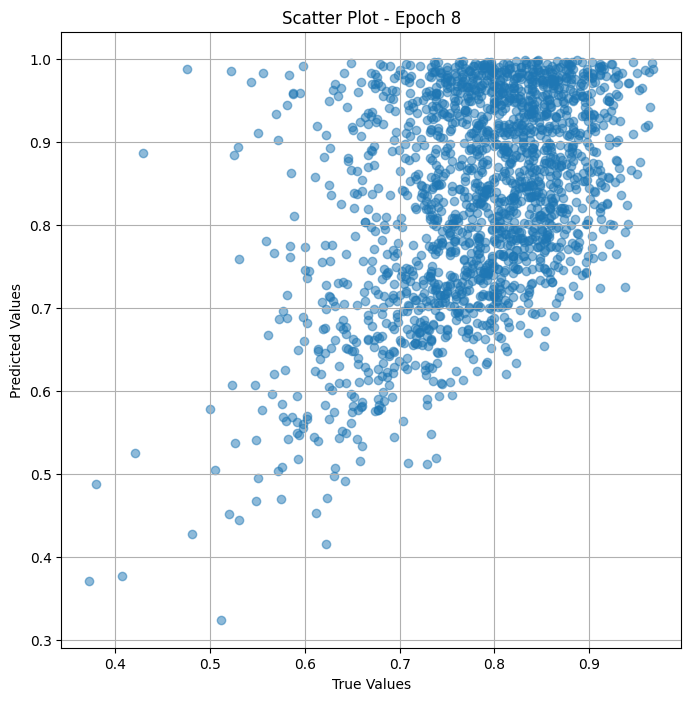


 Epoch: (9/50) Loss = 0.010324526578187943

 Epoch: (9/50) Loss_rmse = 0.10160967707633972

 Epoch: (9/50) R^2 = -0.39126622676849365

 Epoch: (9/50) MAE = 0.08280853927135468

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 

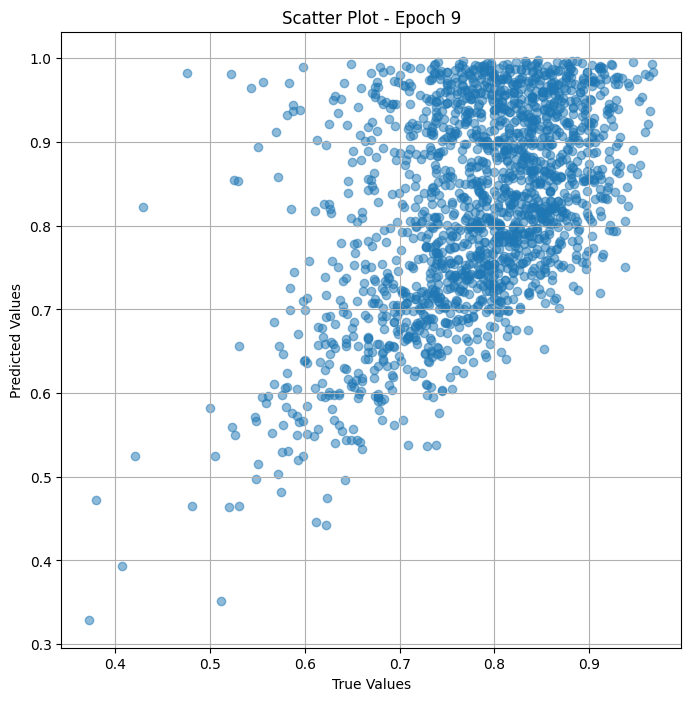


 Epoch: (10/50) Loss = 0.008441036567091942

 Epoch: (10/50) Loss_rmse = 0.0918751135468483

 Epoch: (10/50) R^2 = -0.13745927810668945

 Epoch: (10/50) MAE = 0.08184017241001129

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

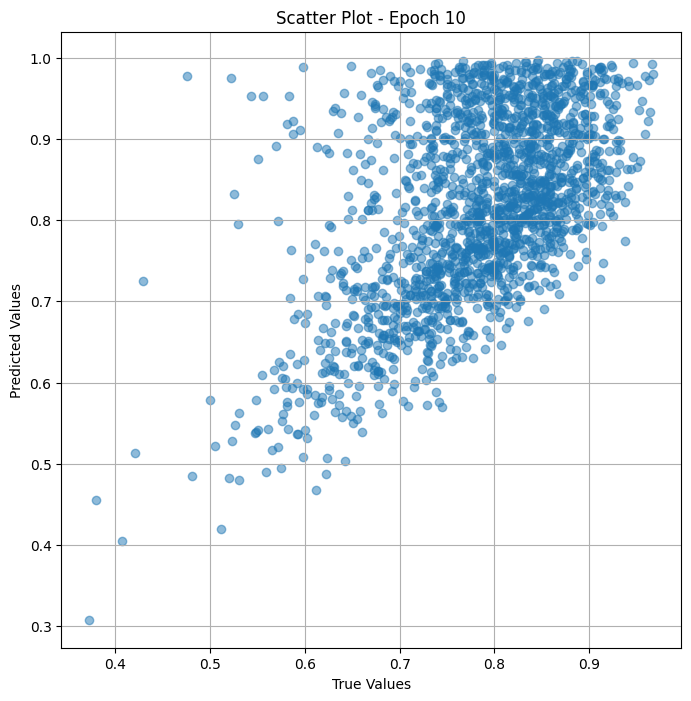


 Epoch: (11/50) Loss = 0.0055966563522815704

 Epoch: (11/50) Loss_rmse = 0.07481080293655396

 Epoch: (11/50) R^2 = 0.2458309531211853

 Epoch: (11/50) MAE = 0.06838693469762802

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

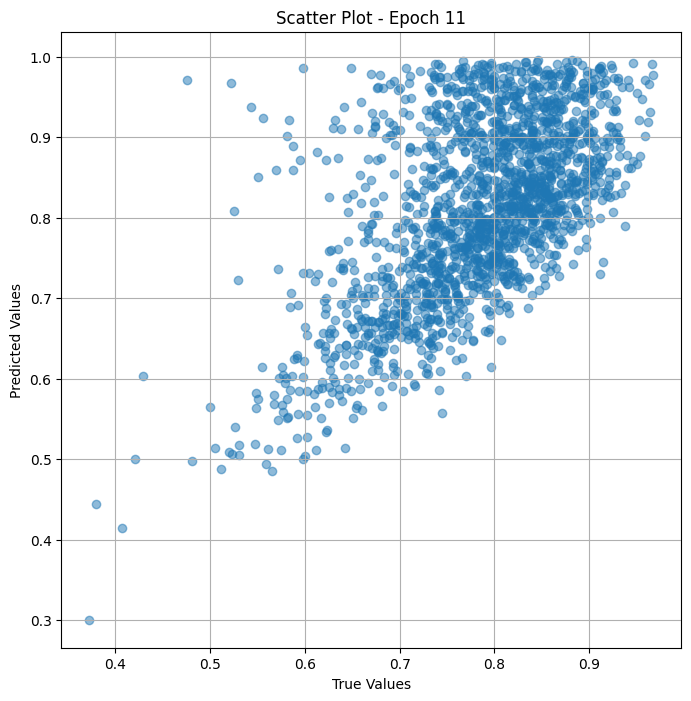


 Epoch: (12/50) Loss = 0.0030830586329102516

 Epoch: (12/50) Loss_rmse = 0.055525295436382294

 Epoch: (12/50) R^2 = 0.5845470428466797

 Epoch: (12/50) MAE = 0.05049373209476471

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

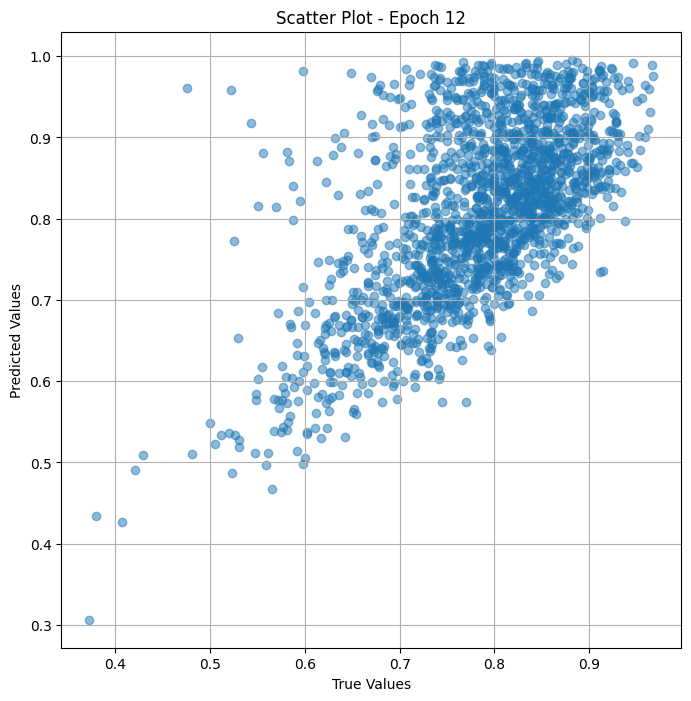


 Epoch: (13/50) Loss = 0.001510245376266539

 Epoch: (13/50) Loss_rmse = 0.038861874490976334

 Epoch: (13/50) R^2 = 0.7964891195297241

 Epoch: (13/50) MAE = 0.033666498959064484

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

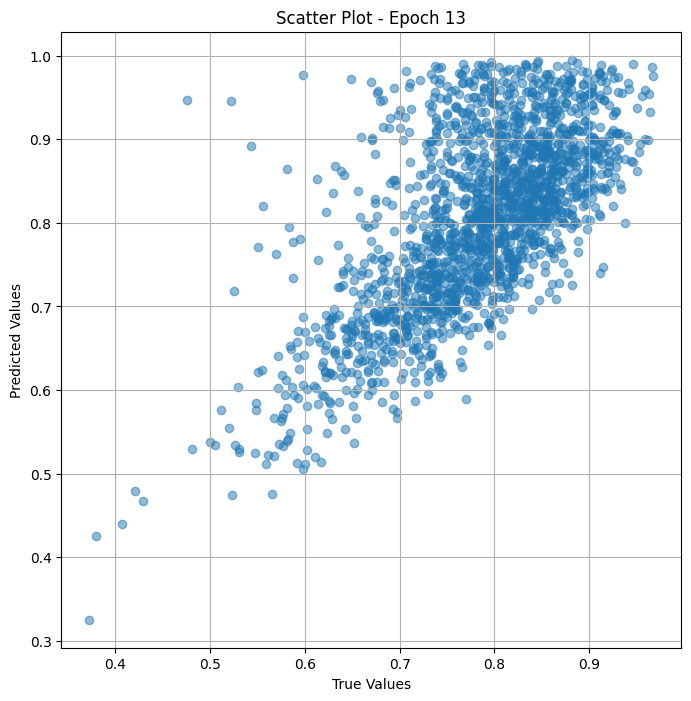


 Epoch: (14/50) Loss = 0.0010432583512738347

 Epoch: (14/50) Loss_rmse = 0.03229951113462448

 Epoch: (14/50) R^2 = 0.8594172596931458

 Epoch: (14/50) MAE = 0.02714484930038452

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

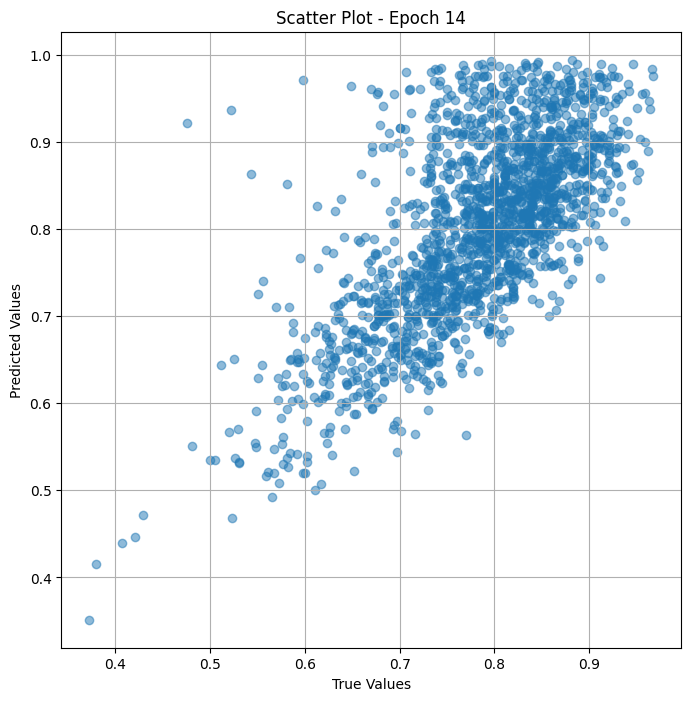


 Epoch: (15/50) Loss = 0.0010387881193310022

 Epoch: (15/50) Loss_rmse = 0.03223023563623428

 Epoch: (15/50) R^2 = 0.8600196838378906

 Epoch: (15/50) MAE = 0.02890125662088394

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

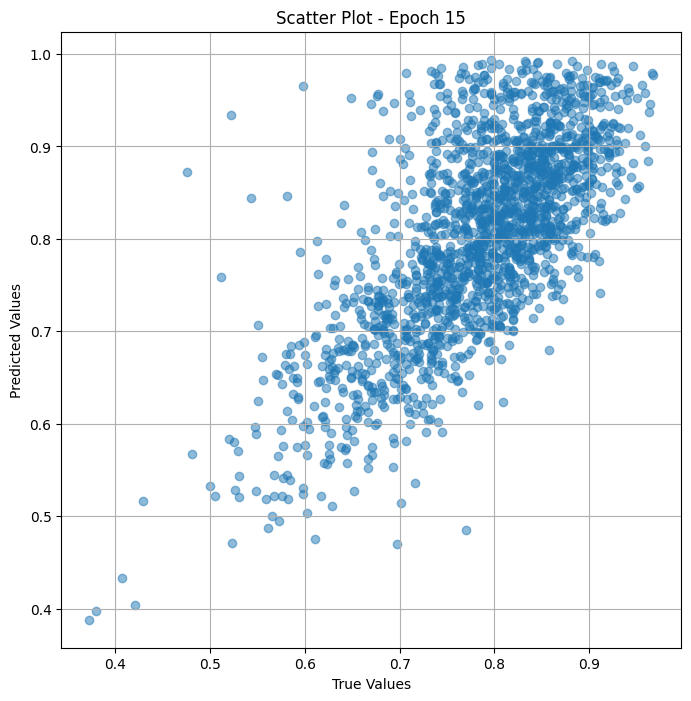


 Epoch: (16/50) Loss = 0.0088935736566782

 Epoch: (16/50) Loss_rmse = 0.09430574625730515

 Epoch: (16/50) R^2 = -0.19844019412994385

 Epoch: (16/50) MAE = 0.085459403693676

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 

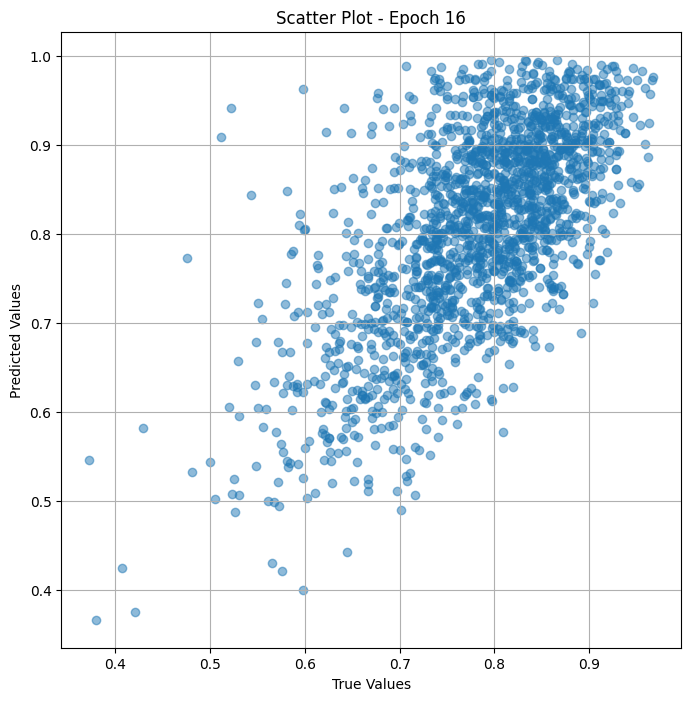


 Epoch: (17/50) Loss = 0.03211565315723419

 Epoch: (17/50) Loss_rmse = 0.1792084127664566

 Epoch: (17/50) R^2 = -3.3276968002319336

 Epoch: (17/50) MAE = 0.17213112115859985

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319,

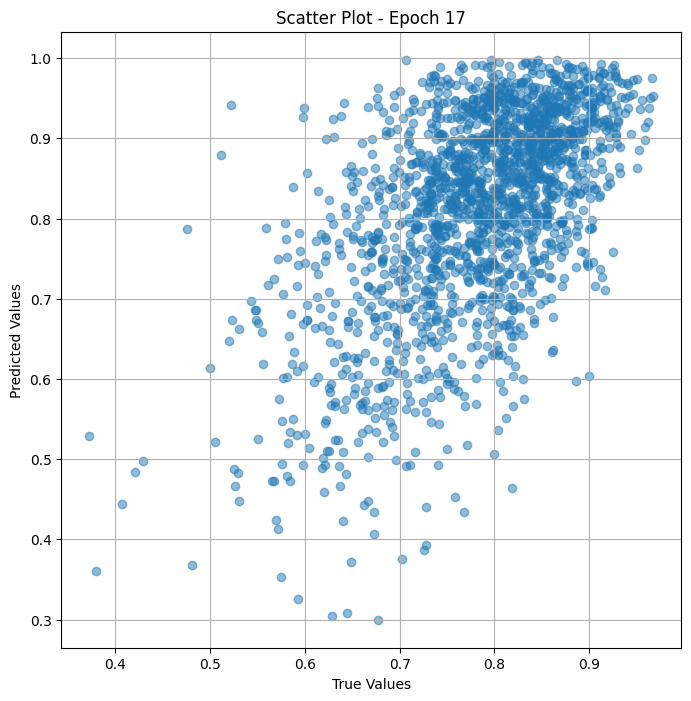


 Epoch: (18/50) Loss = 0.026924215257167816

 Epoch: (18/50) Loss_rmse = 0.1640859991312027

 Epoch: (18/50) R^2 = -2.6281323432922363

 Epoch: (18/50) MAE = 0.15674102306365967

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

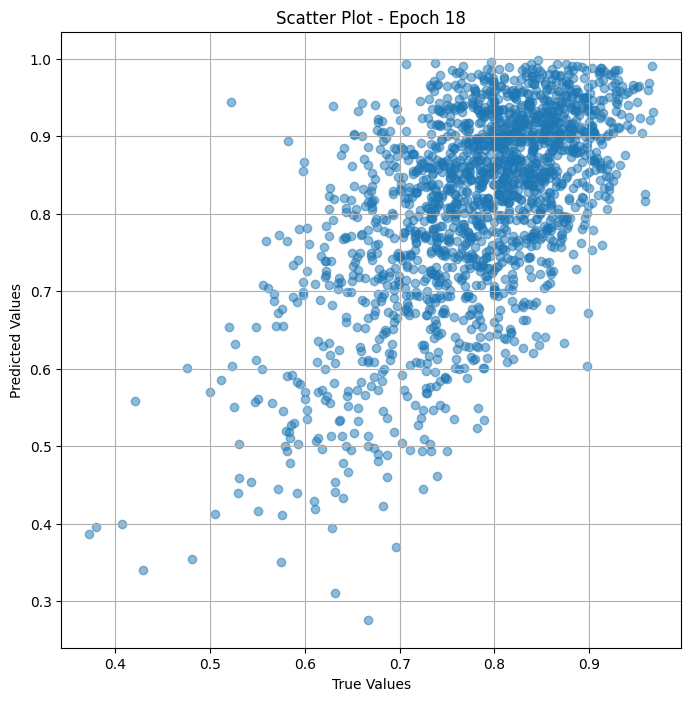


 Epoch: (19/50) Loss = 0.010825563222169876

 Epoch: (19/50) Loss_rmse = 0.10404596477746964

 Epoch: (19/50) R^2 = -0.4587826728820801

 Epoch: (19/50) MAE = 0.09276784211397171

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

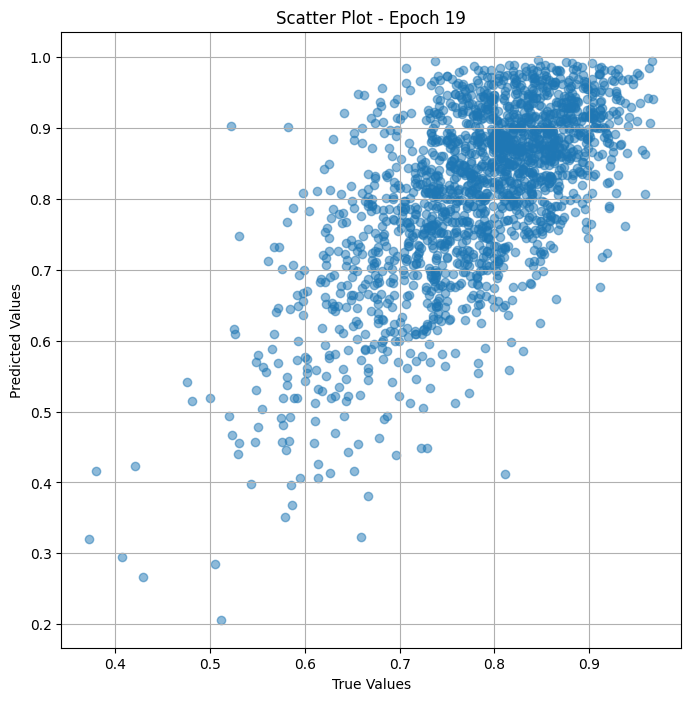


 Epoch: (20/50) Loss = 0.006051166448742151

 Epoch: (20/50) Loss_rmse = 0.07778924703598022

 Epoch: (20/50) R^2 = 0.18458408117294312

 Epoch: (20/50) MAE = 0.07213079184293747

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

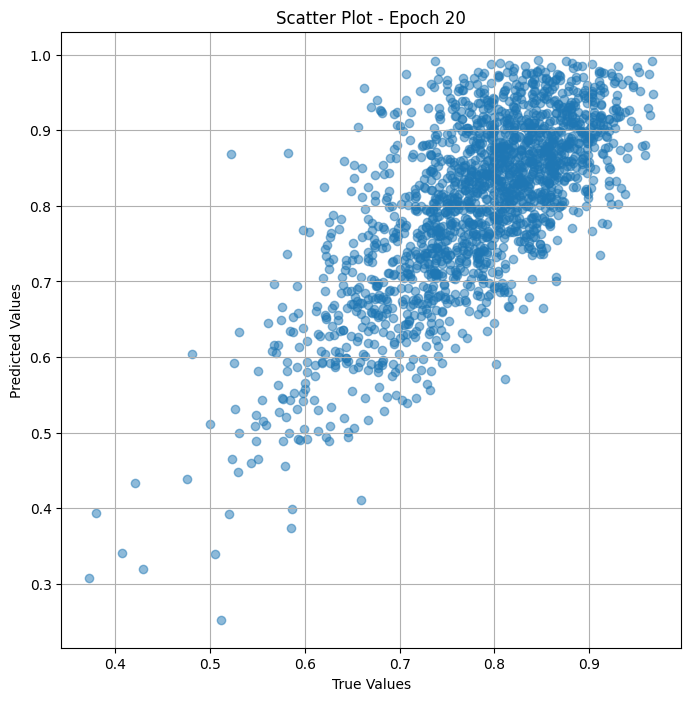


 Epoch: (21/50) Loss = 0.0017527755117043853

 Epoch: (21/50) Loss_rmse = 0.04186616092920303

 Epoch: (21/50) R^2 = 0.7638073563575745

 Epoch: (21/50) MAE = 0.03630160540342331

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

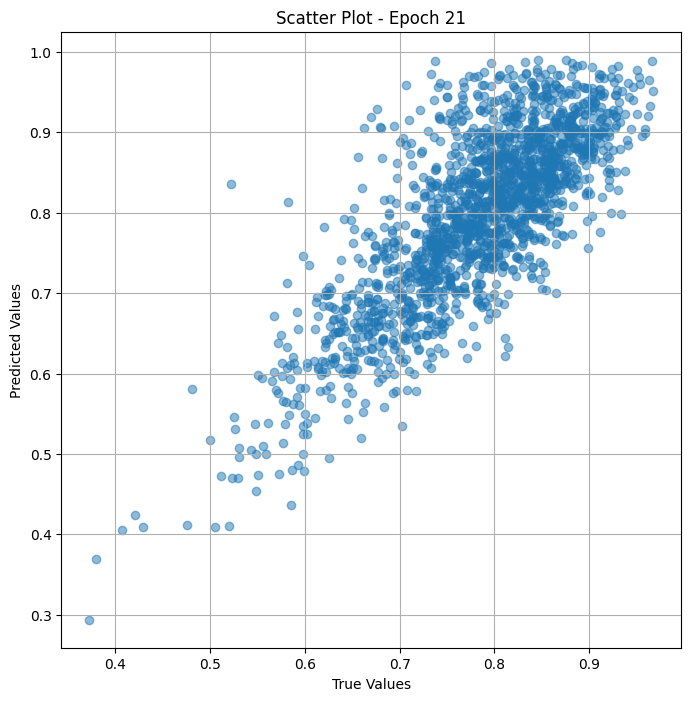


 Epoch: (22/50) Loss = 0.001821262063458562

 Epoch: (22/50) Loss_rmse = 0.04267624765634537

 Epoch: (22/50) R^2 = 0.7545785307884216

 Epoch: (22/50) MAE = 0.03539155423641205

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

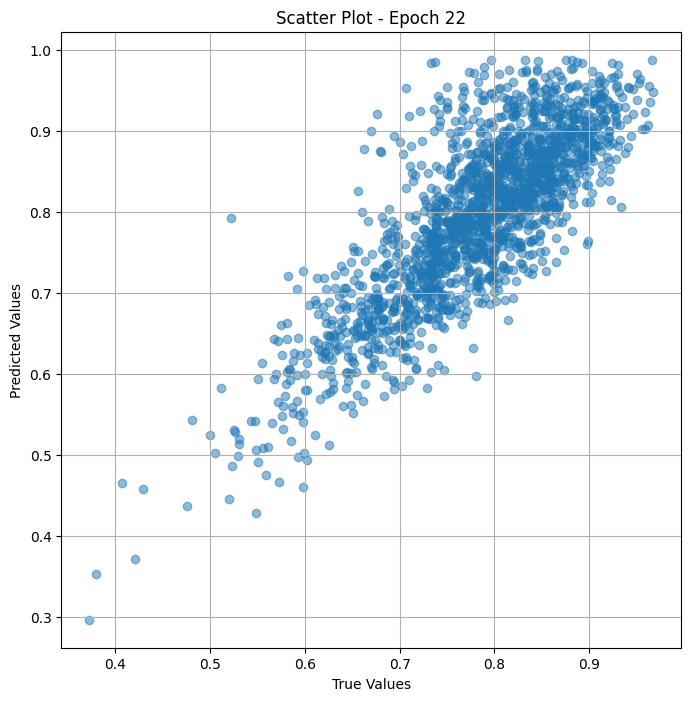


 Epoch: (23/50) Loss = 0.0022361455485224724

 Epoch: (23/50) Loss_rmse = 0.04728790000081062

 Epoch: (23/50) R^2 = 0.6986715793609619

 Epoch: (23/50) MAE = 0.04277742654085159

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

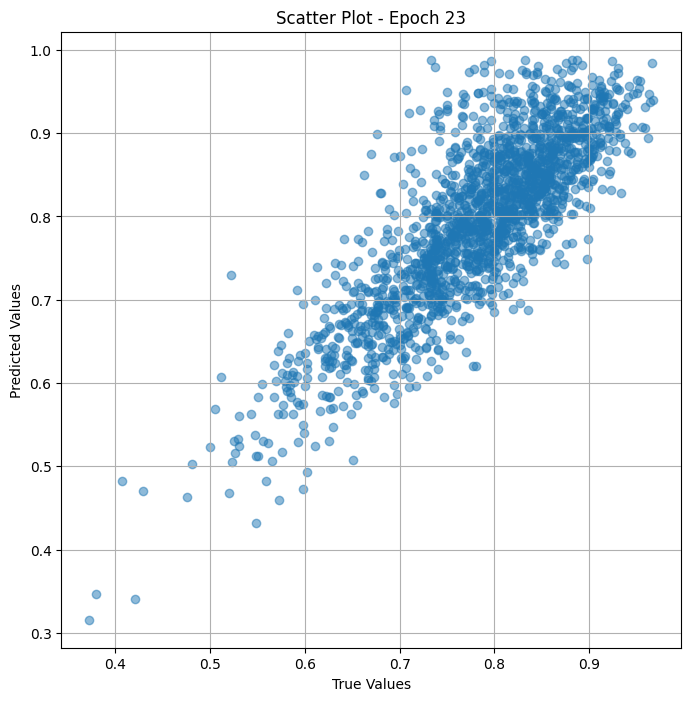


 Epoch: (24/50) Loss = 0.0013590945163741708

 Epoch: (24/50) Loss_rmse = 0.036865897476673126

 Epoch: (24/50) R^2 = 0.8168572187423706

 Epoch: (24/50) MAE = 0.03420250862836838

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

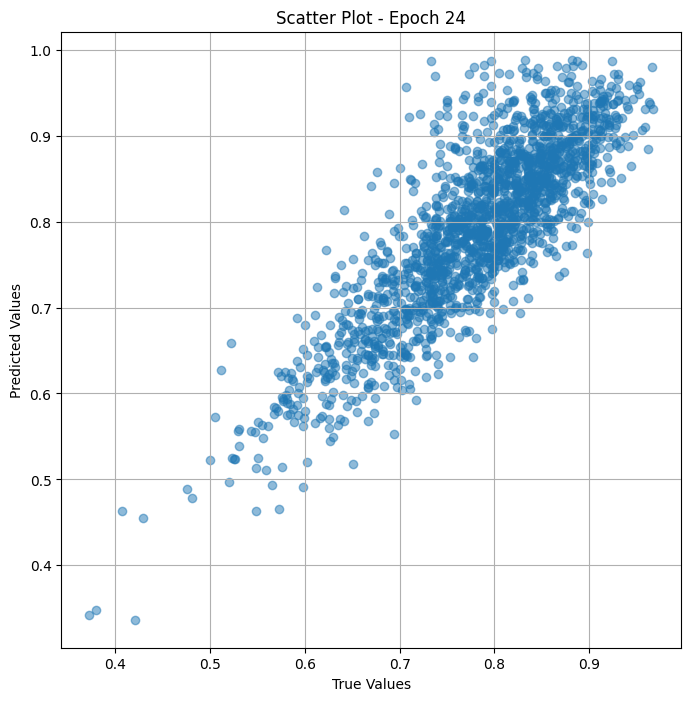


 Epoch: (25/50) Loss = 0.0005639931769110262

 Epoch: (25/50) Loss_rmse = 0.02374854125082493

 Epoch: (25/50) R^2 = 0.9239999651908875

 Epoch: (25/50) MAE = 0.019191928207874298

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

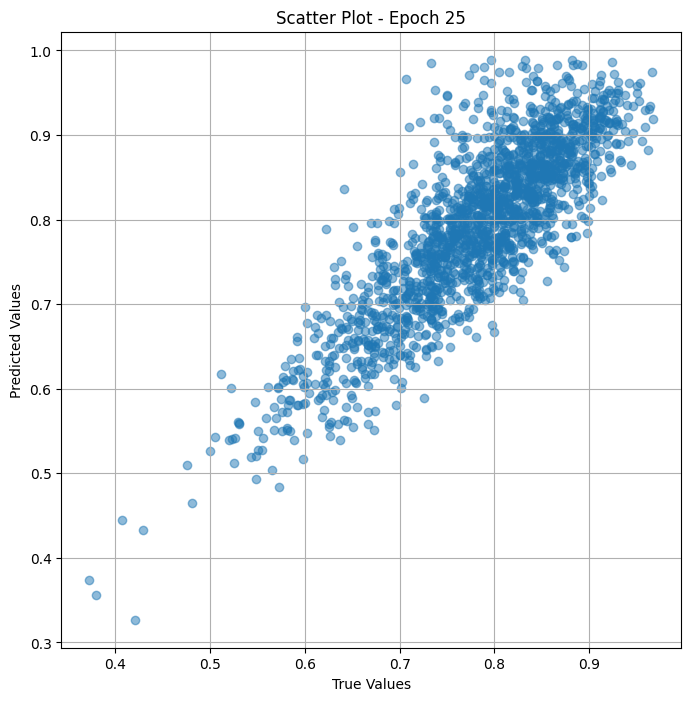


 Epoch: (26/50) Loss = 0.001599576324224472

 Epoch: (26/50) Loss_rmse = 0.039994705468416214

 Epoch: (26/50) R^2 = 0.7844514846801758

 Epoch: (26/50) MAE = 0.030888564884662628

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

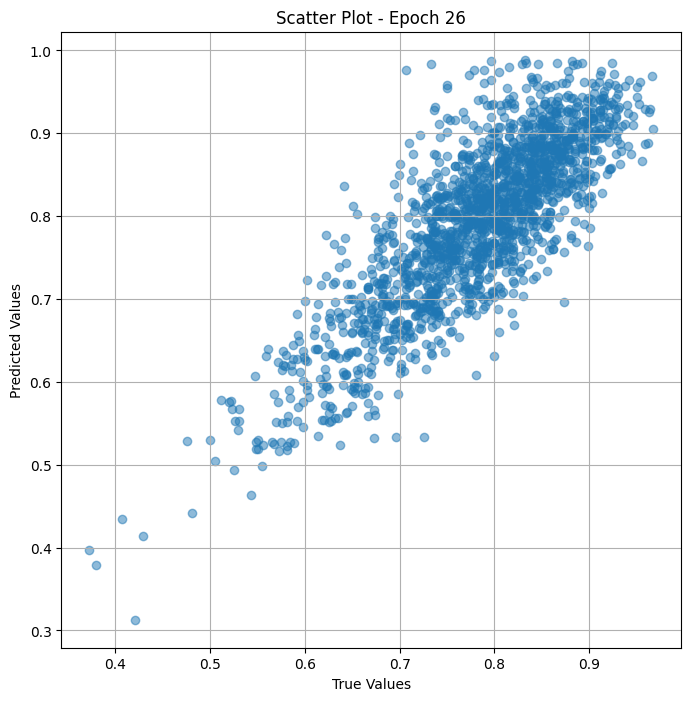


 Epoch: (27/50) Loss = 0.004816092550754547

 Epoch: (27/50) Loss_rmse = 0.06939807534217834

 Epoch: (27/50) R^2 = 0.3510146141052246

 Epoch: (27/50) MAE = 0.05694153904914856

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

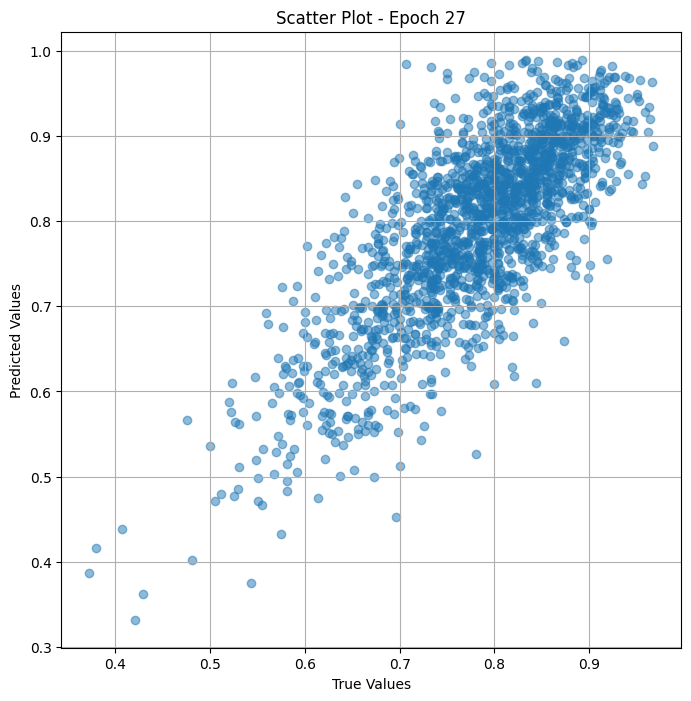


 Epoch: (28/50) Loss = 0.008624271489679813

 Epoch: (28/50) Loss_rmse = 0.09286695718765259

 Epoch: (28/50) R^2 = -0.16215085983276367

 Epoch: (28/50) MAE = 0.0625443309545517

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

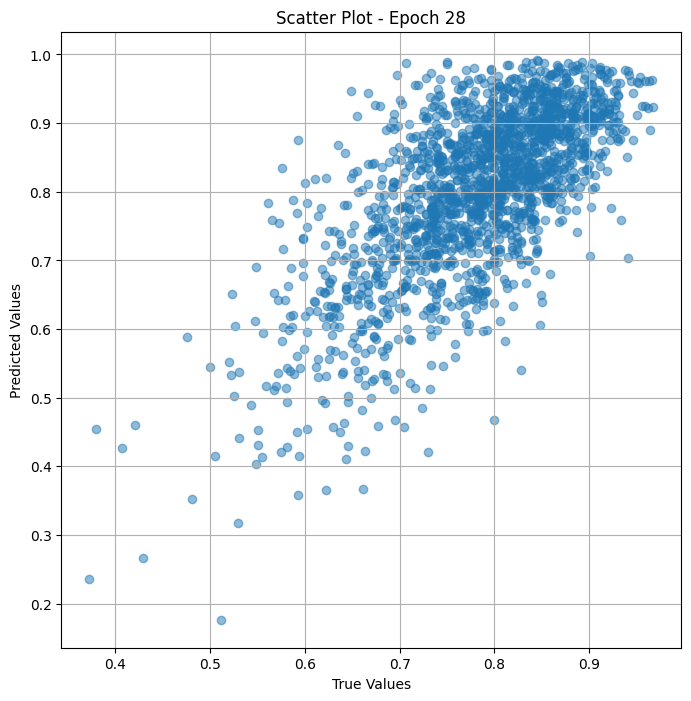


 Epoch: (29/50) Loss = 0.010850007645785809

 Epoch: (29/50) Loss_rmse = 0.10416337102651596

 Epoch: (29/50) R^2 = -0.4620765447616577

 Epoch: (29/50) MAE = 0.07477296888828278

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

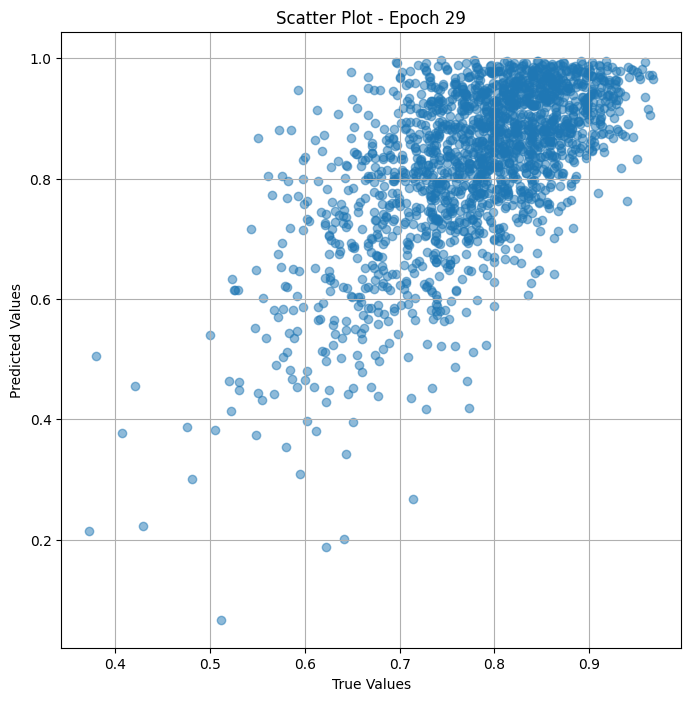


 Epoch: (30/50) Loss = 0.002613343531265855

 Epoch: (30/50) Loss_rmse = 0.05112087354063988

 Epoch: (30/50) R^2 = 0.6478427648544312

 Epoch: (30/50) MAE = 0.04560285061597824

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

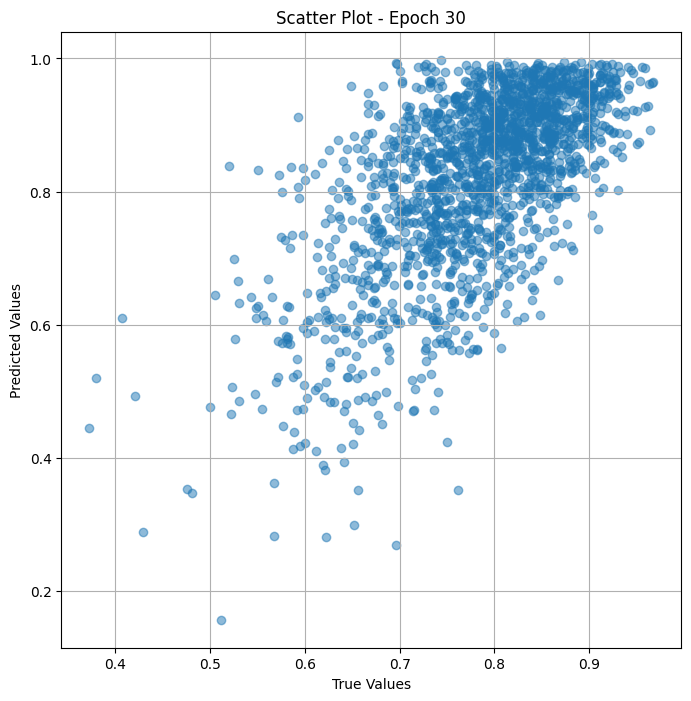


 Epoch: (31/50) Loss = 0.008520735427737236

 Epoch: (31/50) Loss_rmse = 0.09230782836675644

 Epoch: (31/50) R^2 = -0.1481989622116089

 Epoch: (31/50) MAE = 0.08219756186008453

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

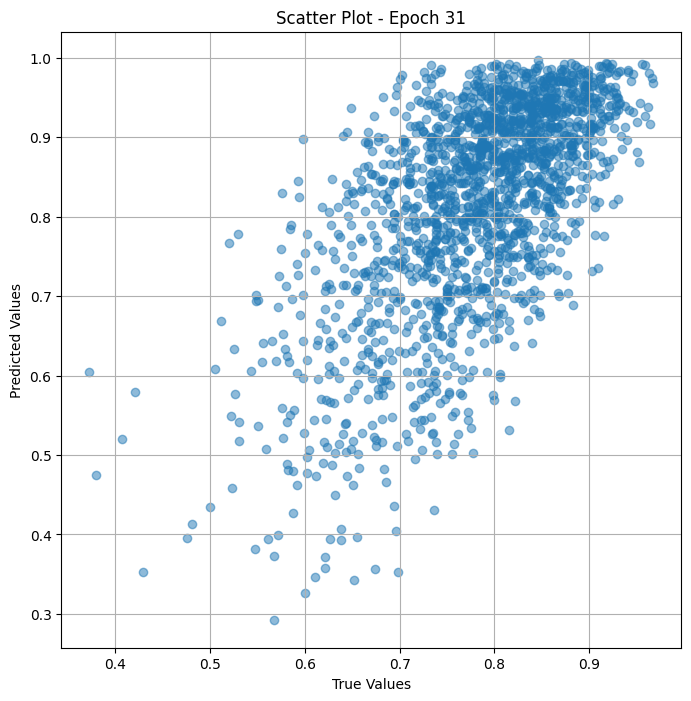


 Epoch: (32/50) Loss = 0.0072658471763134

 Epoch: (32/50) Loss_rmse = 0.085239939391613

 Epoch: (32/50) R^2 = 0.020901620388031006

 Epoch: (32/50) MAE = 0.07711528241634369

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 

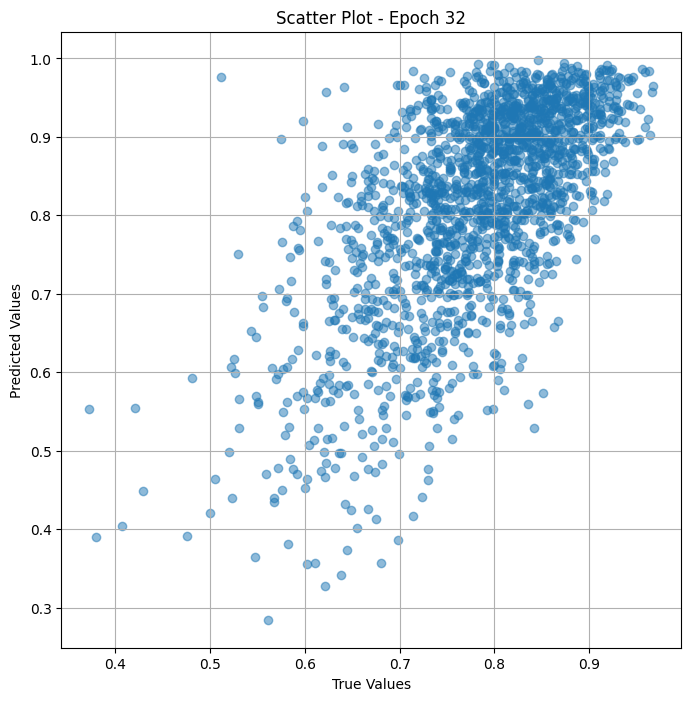


 Epoch: (33/50) Loss = 0.003624626202508807

 Epoch: (33/50) Loss_rmse = 0.06020486727356911

 Epoch: (33/50) R^2 = 0.5115689039230347

 Epoch: (33/50) MAE = 0.050324879586696625

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

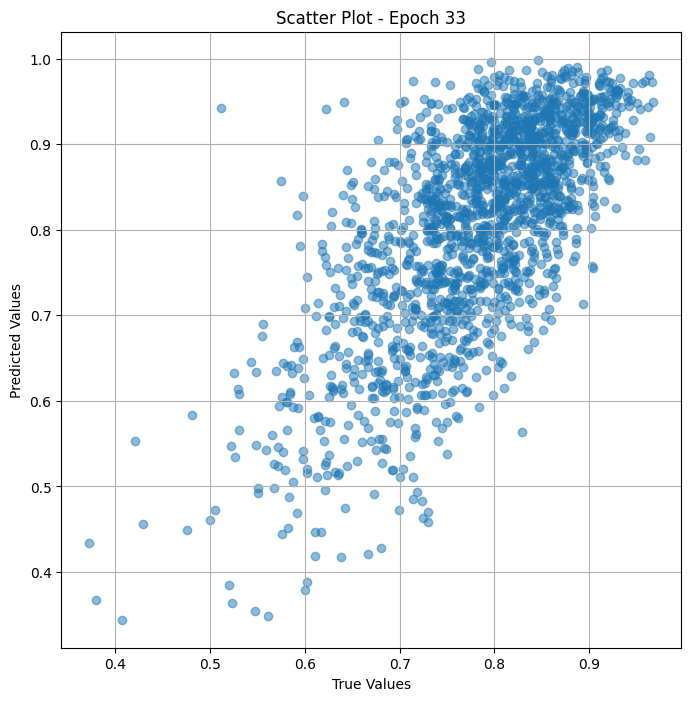


 Epoch: (34/50) Loss = 0.002932471688836813

 Epoch: (34/50) Loss_rmse = 0.05415230244398117

 Epoch: (34/50) R^2 = 0.6048391461372375

 Epoch: (34/50) MAE = 0.04880154877901077

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

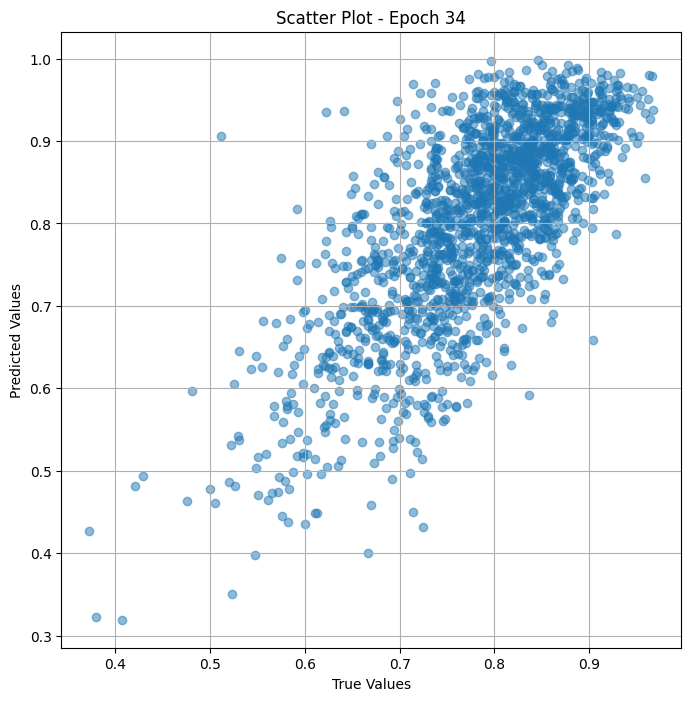


 Epoch: (35/50) Loss = 0.003715388709679246

 Epoch: (35/50) Loss_rmse = 0.06095398962497711

 Epoch: (35/50) R^2 = 0.4993383288383484

 Epoch: (35/50) MAE = 0.05370631068944931

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

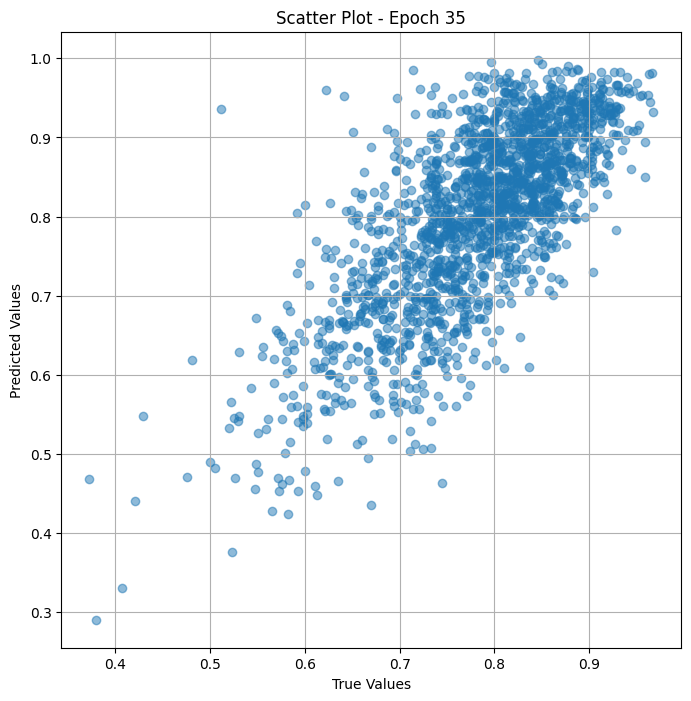


 Epoch: (36/50) Loss = 0.004250525496900082

 Epoch: (36/50) Loss_rmse = 0.06519605219364166

 Epoch: (36/50) R^2 = 0.4272267818450928

 Epoch: (36/50) MAE = 0.05875523388385773

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

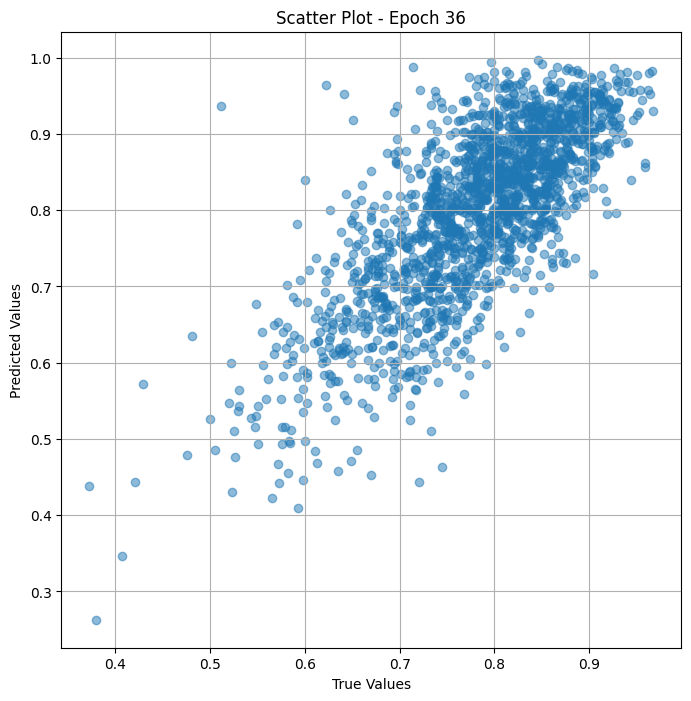


 Epoch: (37/50) Loss = 0.0038166316226124763

 Epoch: (37/50) Loss_rmse = 0.06177889183163643

 Epoch: (37/50) R^2 = 0.485695481300354

 Epoch: (37/50) MAE = 0.05423041433095932

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

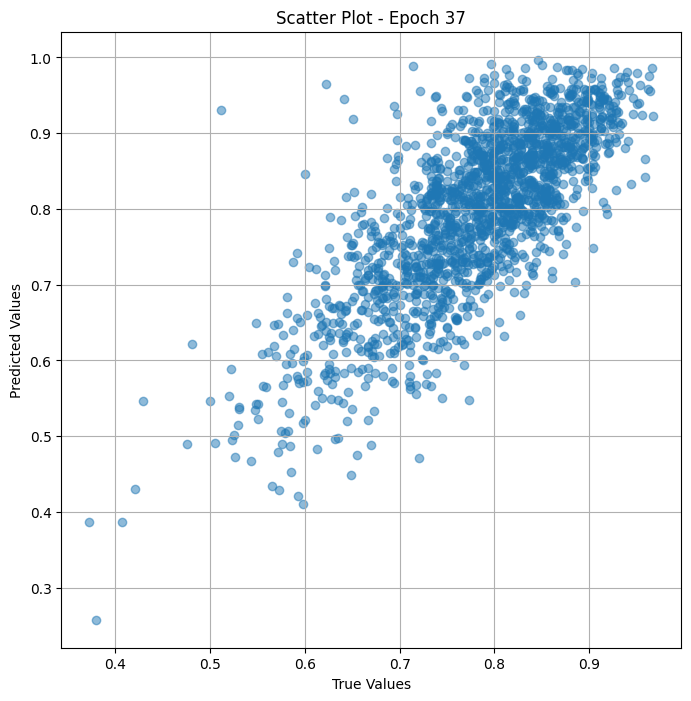


 Epoch: (38/50) Loss = 0.002841151086613536

 Epoch: (38/50) Loss_rmse = 0.053302448242902756

 Epoch: (38/50) R^2 = 0.6171449422836304

 Epoch: (38/50) MAE = 0.04287111014127731

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

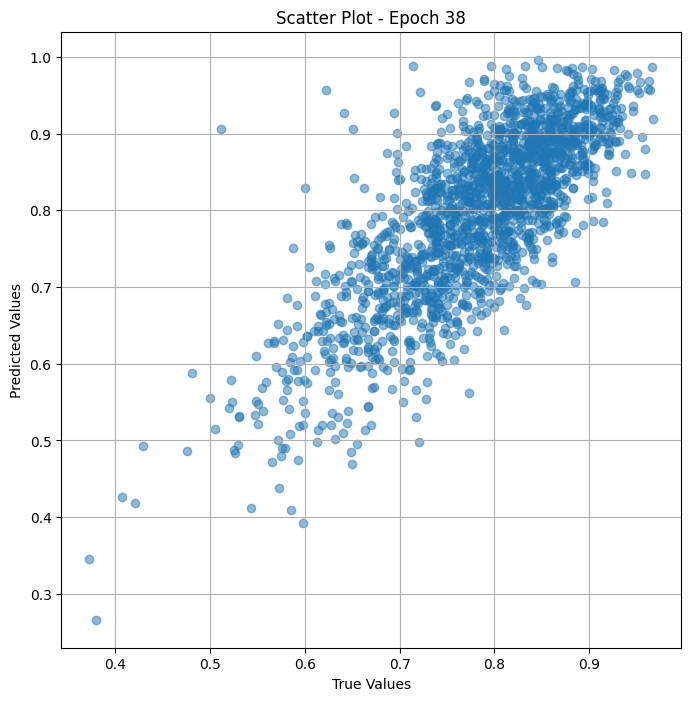


 Epoch: (39/50) Loss = 0.0017476538196206093

 Epoch: (39/50) Loss_rmse = 0.041804950684309006

 Epoch: (39/50) R^2 = 0.7644975185394287

 Epoch: (39/50) MAE = 0.03416352719068527

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

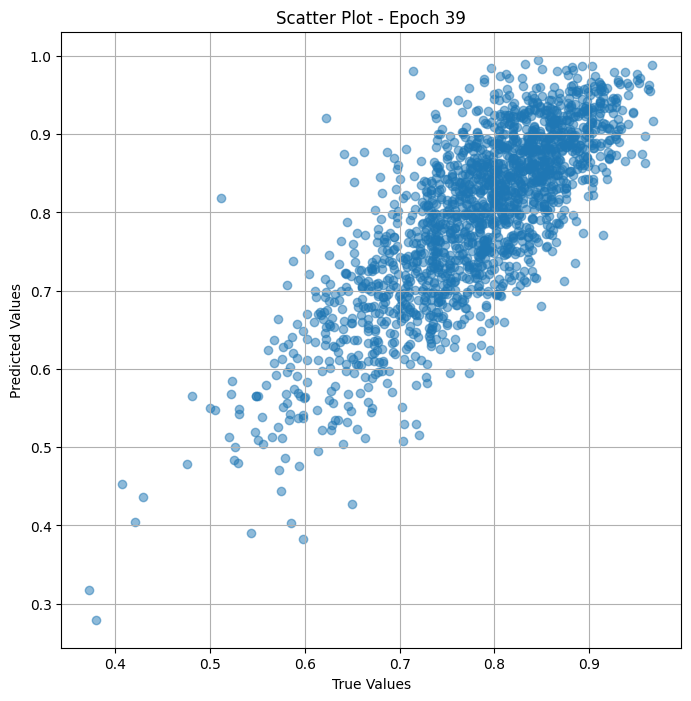


 Epoch: (40/50) Loss = 0.0011903824051842093

 Epoch: (40/50) Loss_rmse = 0.03450191766023636

 Epoch: (40/50) R^2 = 0.8395918011665344

 Epoch: (40/50) MAE = 0.029902219772338867

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.92553

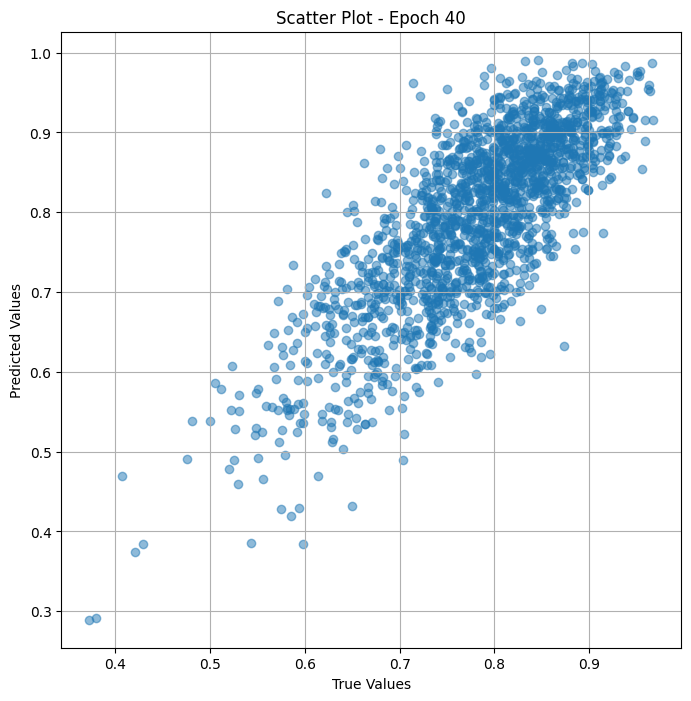


 Epoch: (41/50) Loss = 0.0019968003034591675

 Epoch: (41/50) Loss_rmse = 0.044685572385787964

 Epoch: (41/50) R^2 = 0.730924129486084

 Epoch: (41/50) MAE = 0.04133369028568268

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

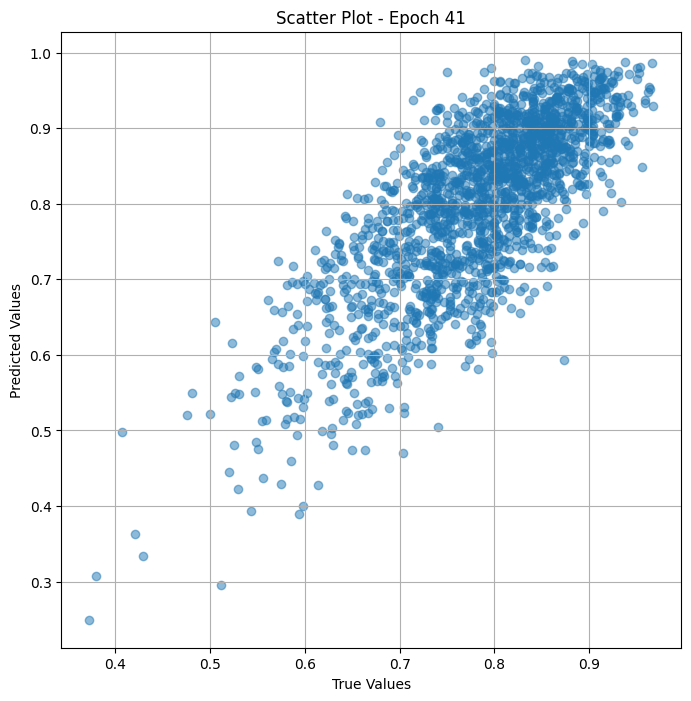


 Epoch: (42/50) Loss = 0.011074330657720566

 Epoch: (42/50) Loss_rmse = 0.10523464530706406

 Epoch: (42/50) R^2 = -0.4923049211502075

 Epoch: (42/50) MAE = 0.0933527946472168

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

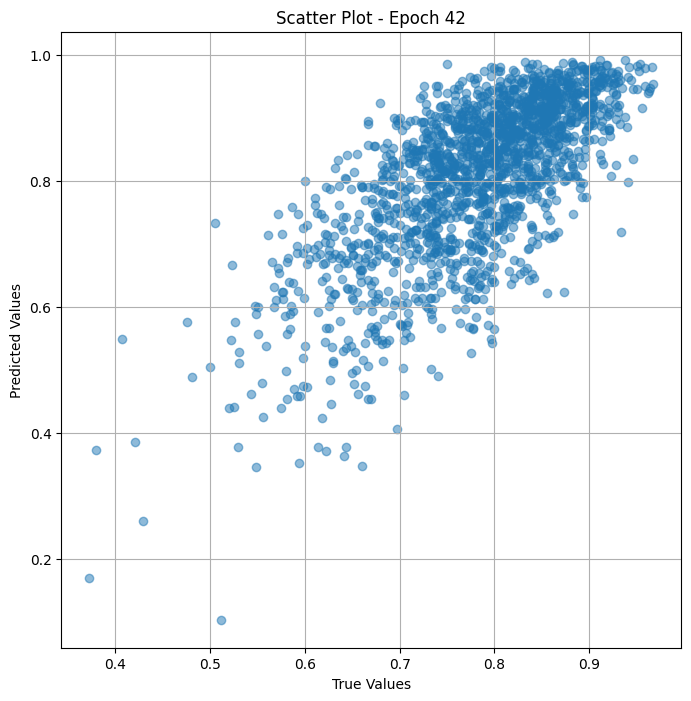


 Epoch: (43/50) Loss = 0.033327825367450714

 Epoch: (43/50) Loss_rmse = 0.18255910277366638

 Epoch: (43/50) R^2 = -3.4910411834716797

 Epoch: (43/50) MAE = 0.1536213606595993

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

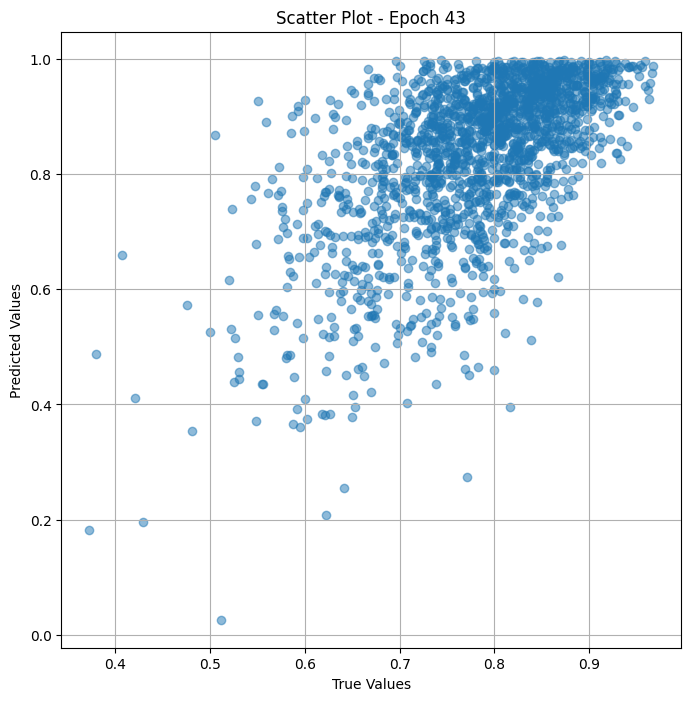


 Epoch: (44/50) Loss = 0.02502673864364624

 Epoch: (44/50) Loss_rmse = 0.15819841623306274

 Epoch: (44/50) R^2 = -2.372440814971924

 Epoch: (44/50) MAE = 0.1251402497291565

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319, 

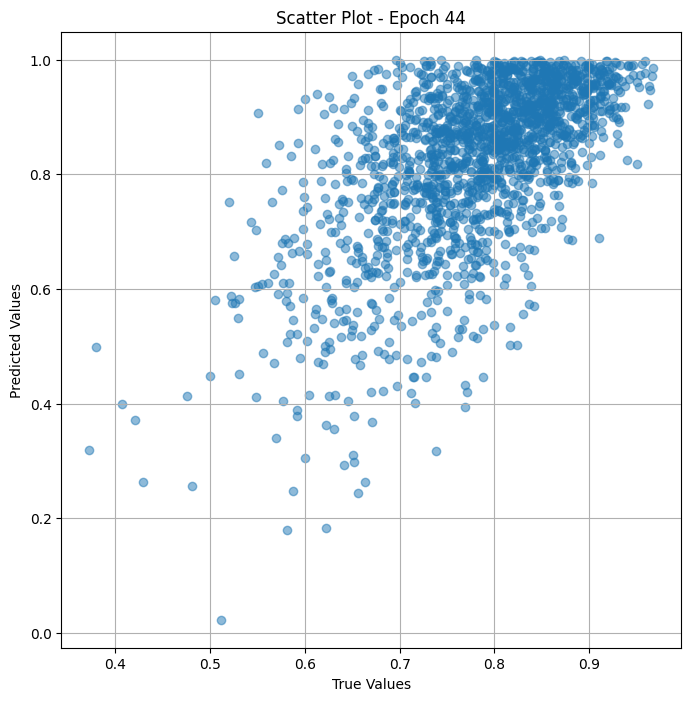


 Epoch: (45/50) Loss = 0.019007740542292595

 Epoch: (45/50) Loss_rmse = 0.13786856830120087

 Epoch: (45/50) R^2 = -1.5613596439361572

 Epoch: (45/50) MAE = 0.1098836213350296

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

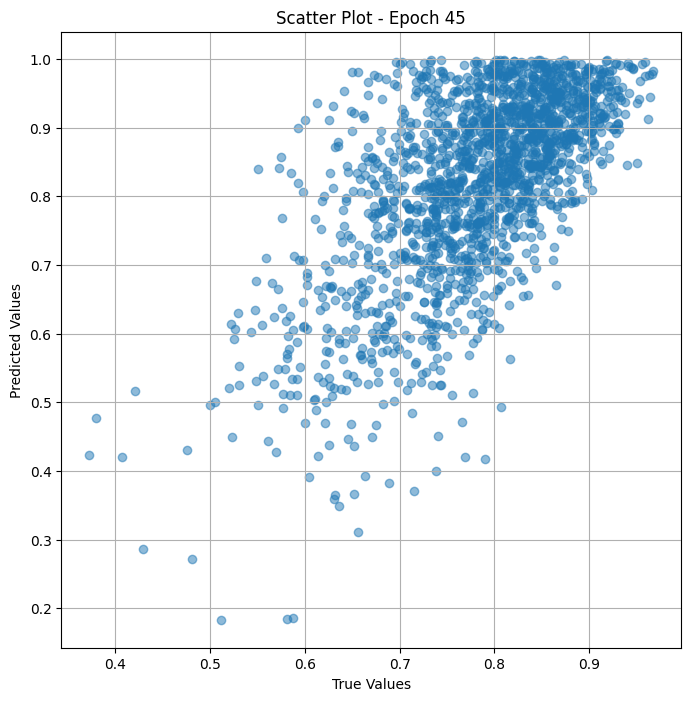


 Epoch: (46/50) Loss = 0.01059601828455925

 Epoch: (46/50) Loss_rmse = 0.10293696075677872

 Epoch: (46/50) R^2 = -0.427850604057312

 Epoch: (46/50) MAE = 0.07823023945093155

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319,

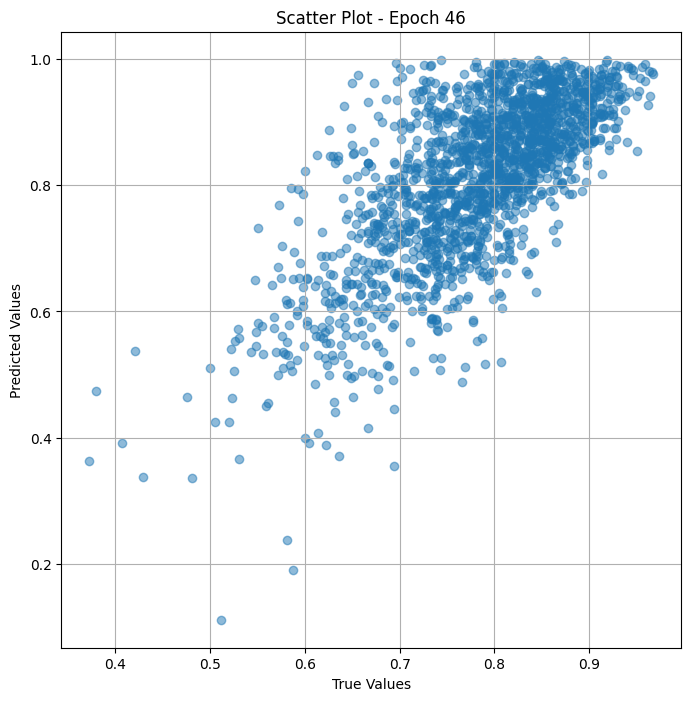


 Epoch: (47/50) Loss = 0.0022162282839417458

 Epoch: (47/50) Loss_rmse = 0.04707683250308037

 Epoch: (47/50) R^2 = 0.7013554573059082

 Epoch: (47/50) MAE = 0.03996904566884041

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.925531

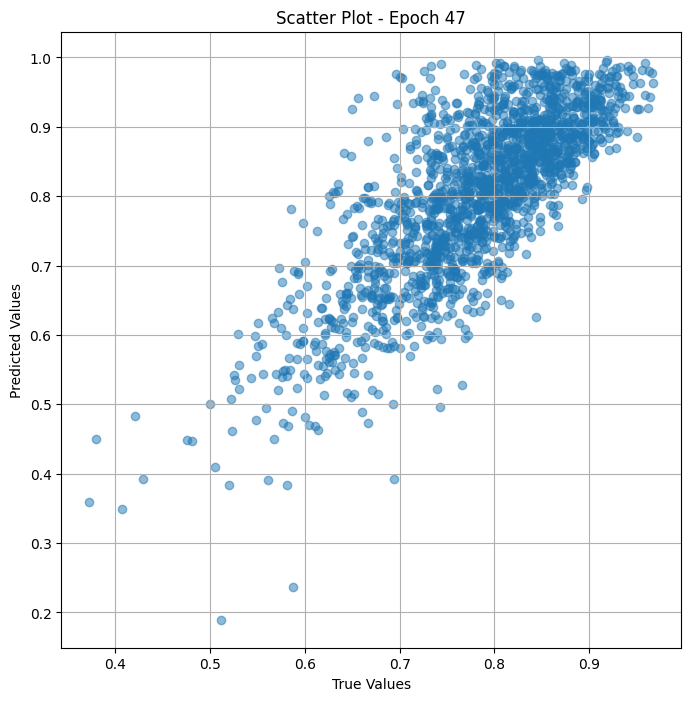


 Epoch: (48/50) Loss = 0.0007198191597126424

 Epoch: (48/50) Loss_rmse = 0.026829445734620094

 Epoch: (48/50) R^2 = 0.9030018448829651

 Epoch: (48/50) MAE = 0.021530881524086

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

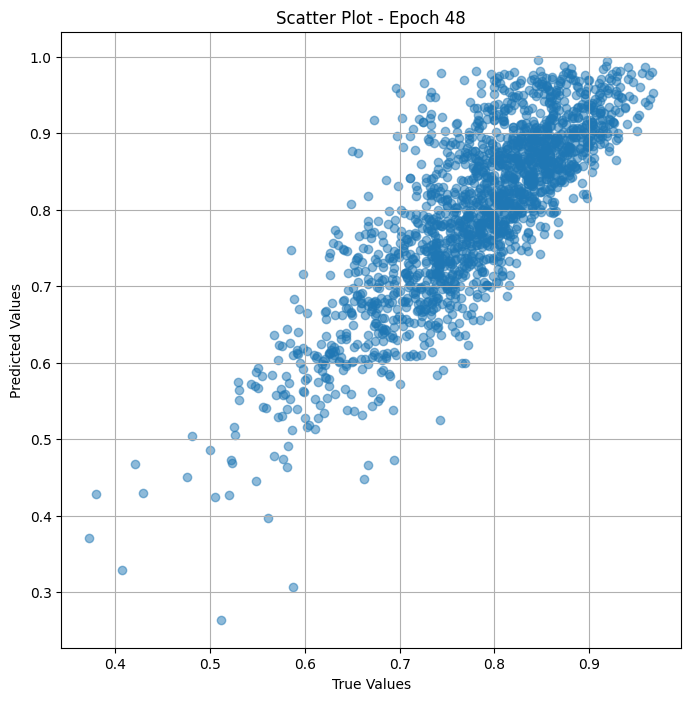


 Epoch: (49/50) Loss = 0.0005899934330955148

 Epoch: (49/50) Loss_rmse = 0.024289781227707863

 Epoch: (49/50) R^2 = 0.9204963445663452

 Epoch: (49/50) MAE = 0.018409043550491333

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255

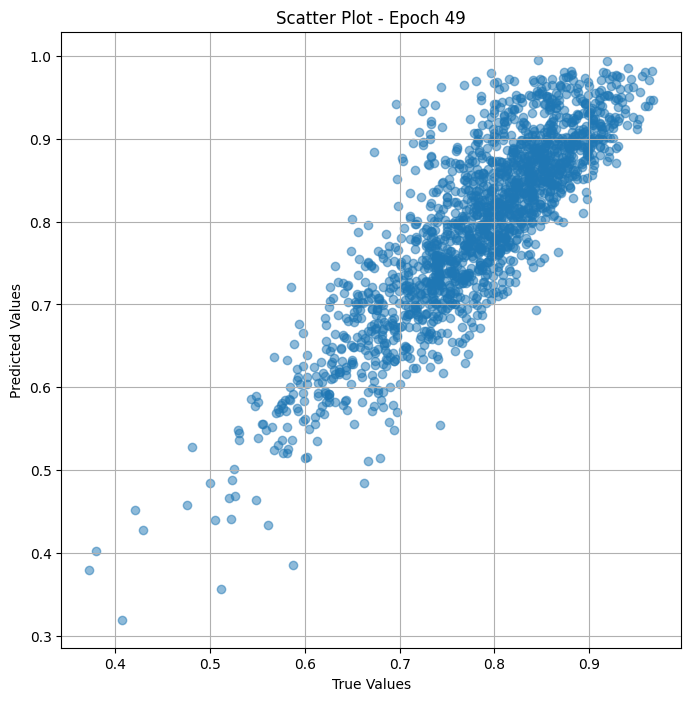


 Epoch: (50/50) Loss = 0.000580004823859781

 Epoch: (50/50) Loss_rmse = 0.02408328838646412

 Epoch: (50/50) R^2 = 0.9218423366546631

 Epoch: (50/50) MAE = 0.01950245350599289

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.68085104, 0.7614679, 0.625, 0.78846157, 0.6956522, 0.8681319, 0.6806723, 0.81578946, 0.83157897, 0.81, 0.7752809, 0.8041237, 0.86538464, 0.81395346, 0.7368421, 0.8541667, 0.7387387, 0.65217394, 0.7878788, 0.7906977, 0.6407767, 0.7816092, 0.7303371, 0.8362069, 0.82, 0.84761906, 0.82417583, 0.6554622, 0.75, 0.67021275, 0.8541667, 0.78504676, 0.754717, 0.68817204, 0.6513761, 0.83505154, 0.83157897, 0.827957, 0.7570093, 0.95238096, 0.7628866, 0.84158415, 0.84158415, 0.81914896, 0.79787236, 0.88461536, 0.82608694, 0.9029126, 0.7676768, 0.8598131, 0.7717391, 0.95, 0.93, 0.8039216, 0.64285713, 0.7818182, 0.9099099, 0.72289157, 0.70652175, 0.78494626, 0.79347825, 0.8031496, 0.815534, 0.79816514, 0.8148148, 0.8469388, 0.9255319

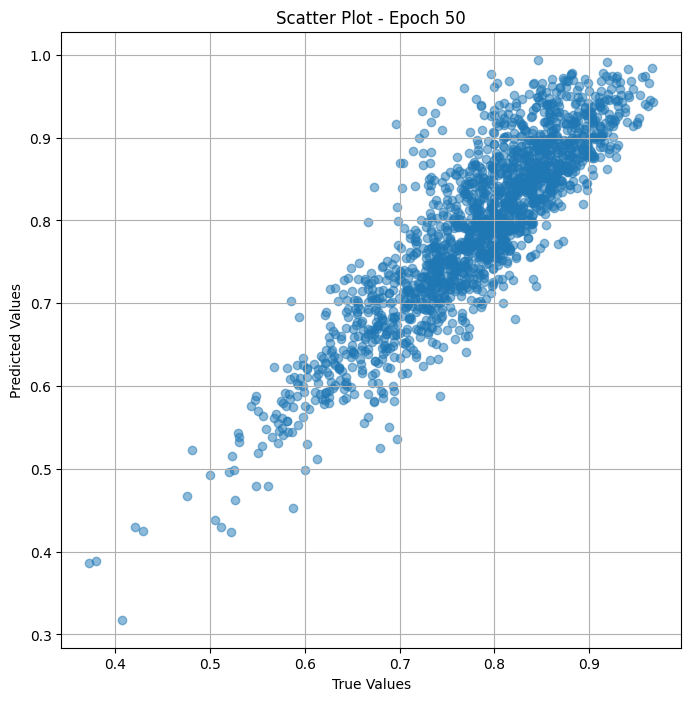

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S_")

## Valid

In [ ]:
# Merge the two models
class model_merge_fine_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


modelfine_val = model_merge_fine_val(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
modelfine_val = to_device(modelfine_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(modelfine_val.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,modelfine_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        modelfine_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = modelfine_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.17786924540996552

 Epoch: (1/50) Loss_rmse = 0.4217454791069031

 Epoch: (1/50) R^2 = -59.25032043457031

 Epoch: (1/50) MAE = 0.33692923188209534

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.68

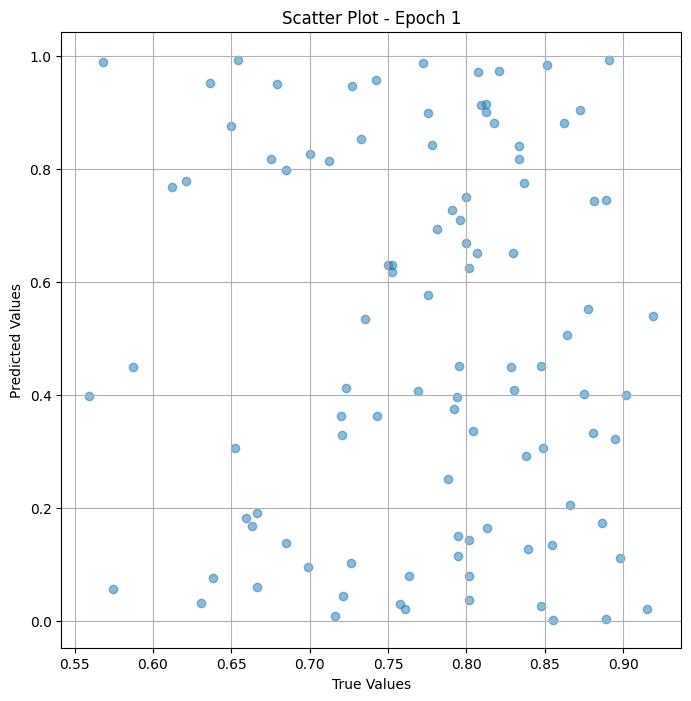


 Epoch: (2/50) Loss = 0.14720642566680908

 Epoch: (2/50) Loss_rmse = 0.38367488980293274

 Epoch: (2/50) R^2 = -48.86378479003906

 Epoch: (2/50) MAE = 0.3323901295661926

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.68

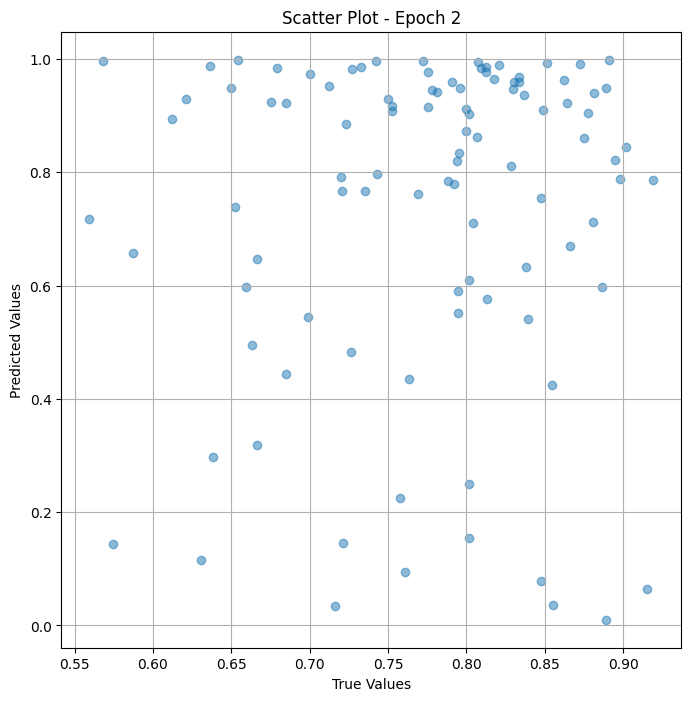


 Epoch: (3/50) Loss = 0.0739065483212471

 Epoch: (3/50) Loss_rmse = 0.2718575894832611

 Epoch: (3/50) R^2 = -24.034643173217773

 Epoch: (3/50) MAE = 0.26788872480392456

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.68

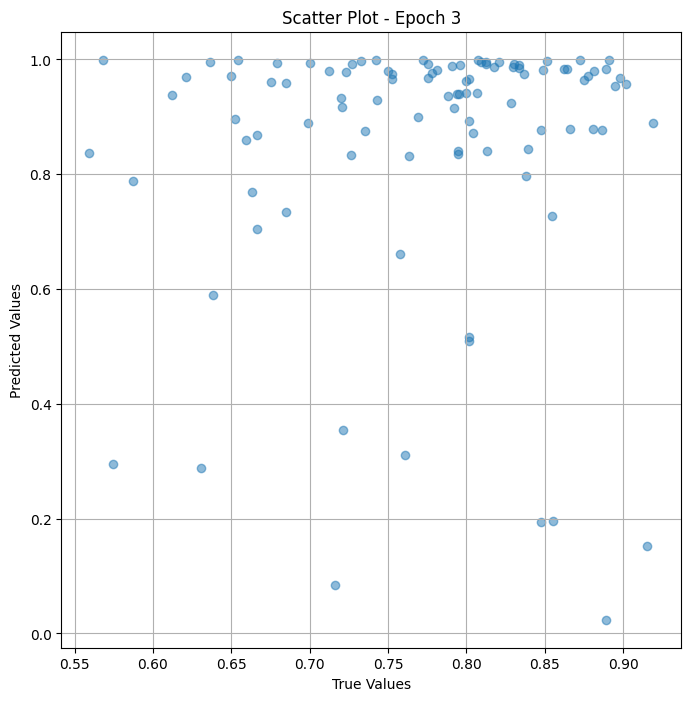


 Epoch: (4/50) Loss = 0.056582480669021606

 Epoch: (4/50) Loss_rmse = 0.2378707230091095

 Epoch: (4/50) R^2 = -18.166397094726562

 Epoch: (4/50) MAE = 0.21157284080982208

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.

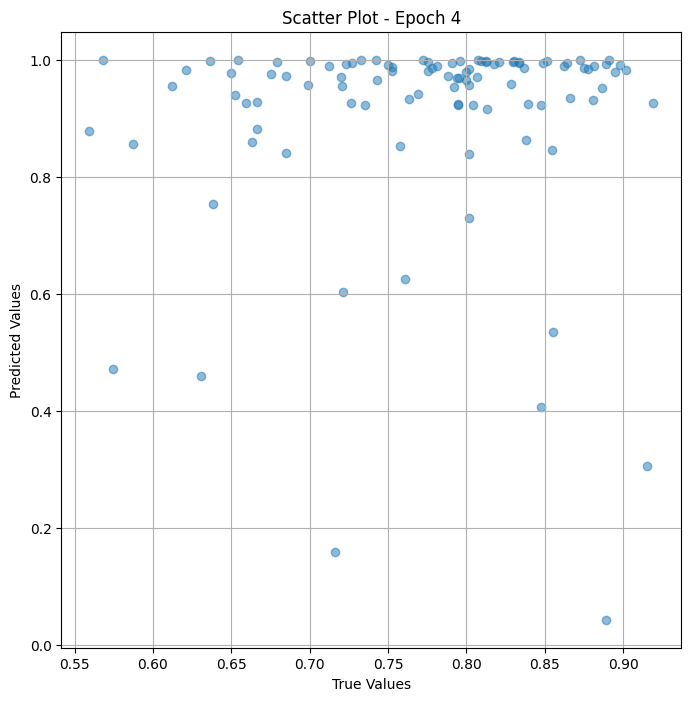


 Epoch: (5/50) Loss = 0.05998022481799126

 Epoch: (5/50) Loss_rmse = 0.24490860104560852

 Epoch: (5/50) R^2 = -19.31732749938965

 Epoch: (5/50) MAE = 0.23155547678470612

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.6

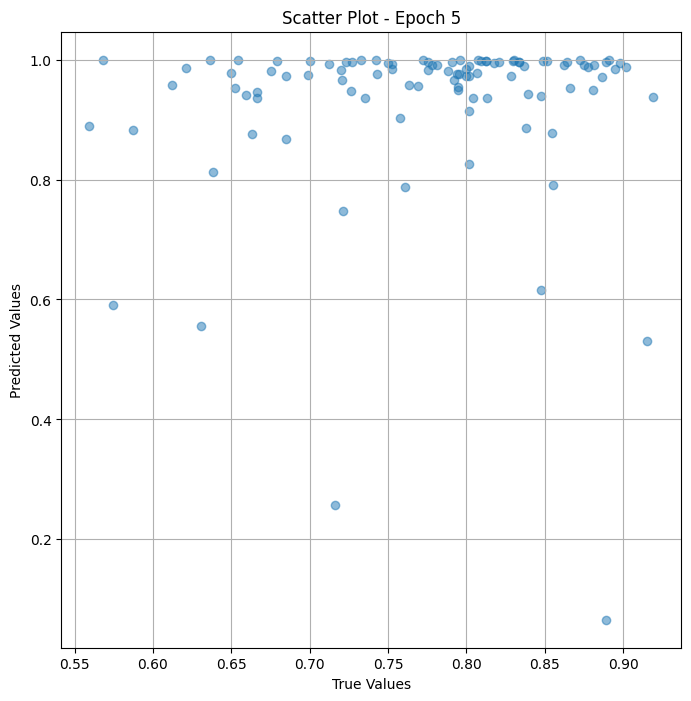


 Epoch: (6/50) Loss = 0.05954141169786453

 Epoch: (6/50) Loss_rmse = 0.24401108920574188

 Epoch: (6/50) R^2 = -19.168685913085938

 Epoch: (6/50) MAE = 0.2323080599308014

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.6

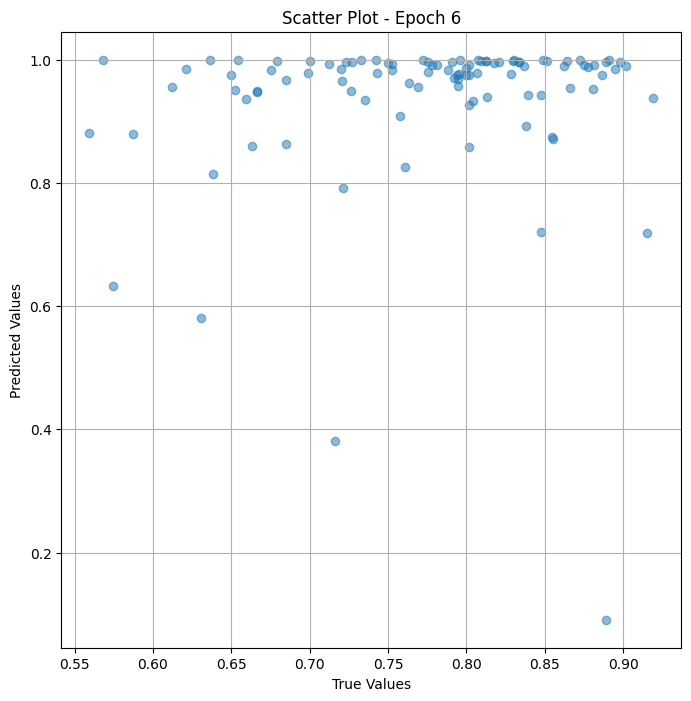


 Epoch: (7/50) Loss = 0.05556616932153702

 Epoch: (7/50) Loss_rmse = 0.2357247769832611

 Epoch: (7/50) R^2 = -17.8221378326416

 Epoch: (7/50) MAE = 0.22276082634925842

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.684

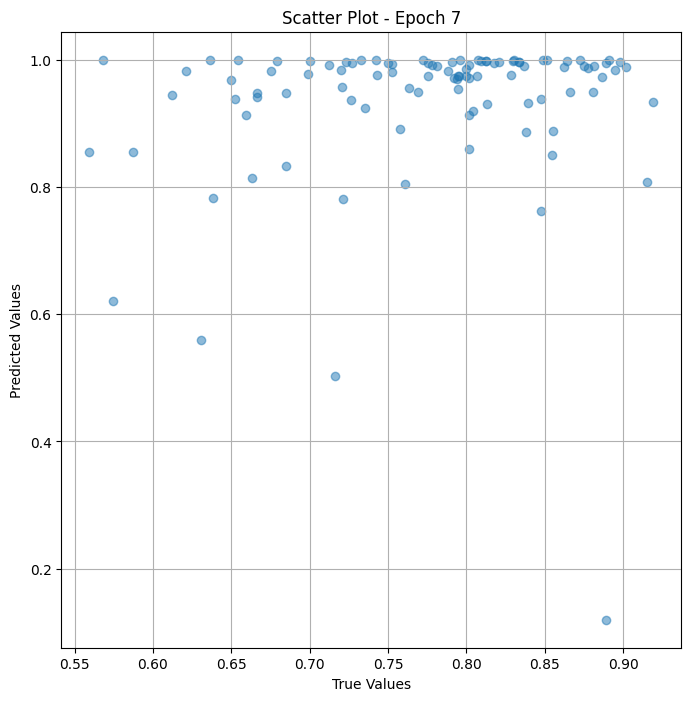


 Epoch: (8/50) Loss = 0.0466228649020195

 Epoch: (8/50) Loss_rmse = 0.2159232795238495

 Epoch: (8/50) R^2 = -14.792738914489746

 Epoch: (8/50) MAE = 0.19778285920619965

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.68

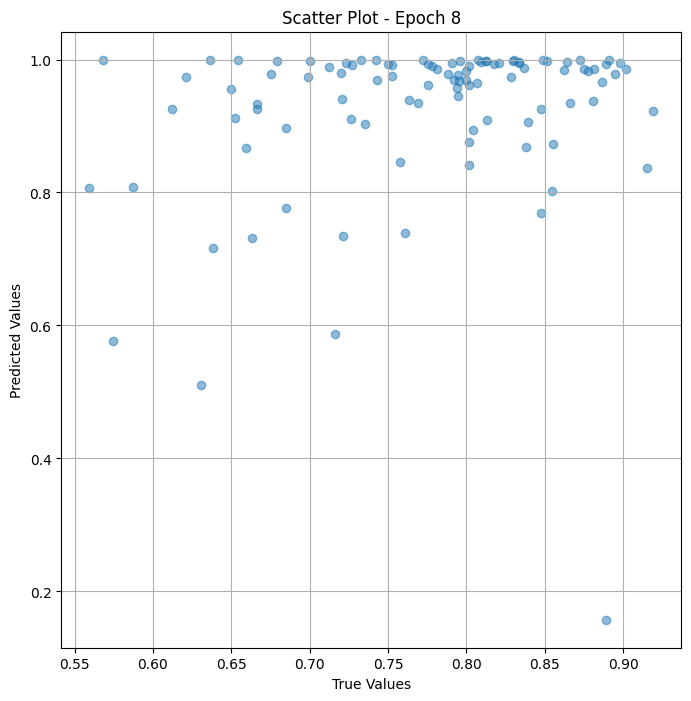


 Epoch: (9/50) Loss = 0.03307196497917175

 Epoch: (9/50) Loss_rmse = 0.18185698986053467

 Epoch: (9/50) R^2 = -10.202590942382812

 Epoch: (9/50) MAE = 0.13987091183662415

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 0.

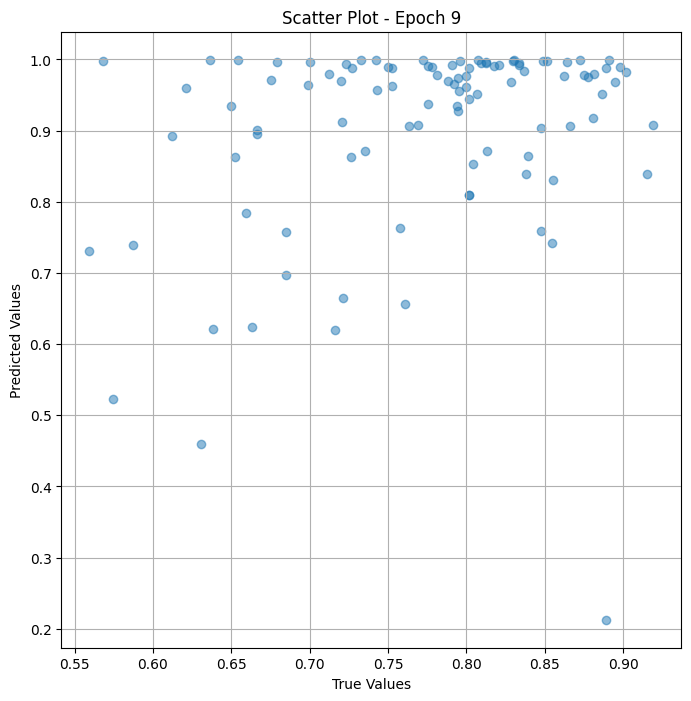


 Epoch: (10/50) Loss = 0.03450872376561165

 Epoch: (10/50) Loss_rmse = 0.18576523661613464

 Epoch: (10/50) R^2 = -10.68927001953125

 Epoch: (10/50) MAE = 0.1597406417131424

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 

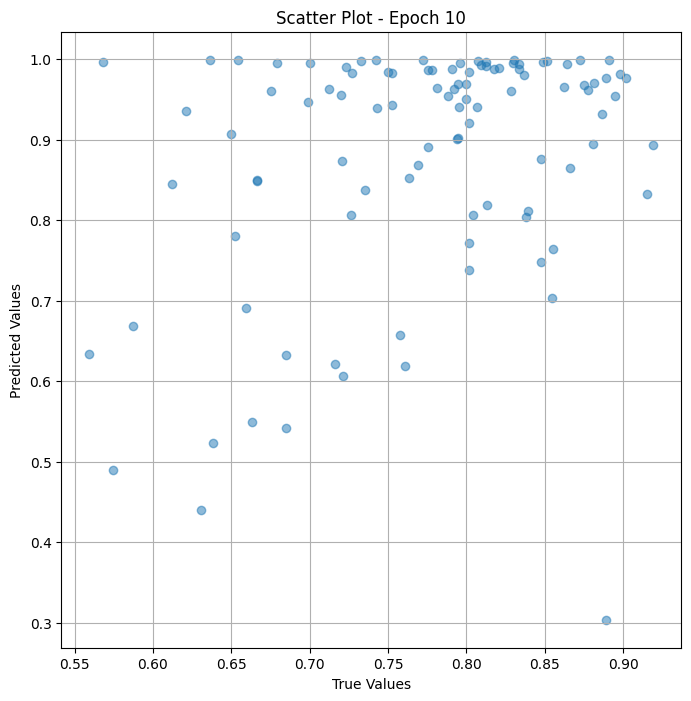


 Epoch: (11/50) Loss = 0.027000434696674347

 Epoch: (11/50) Loss_rmse = 0.16431808471679688

 Epoch: (11/50) R^2 = -8.14595890045166

 Epoch: (11/50) MAE = 0.11742910742759705

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

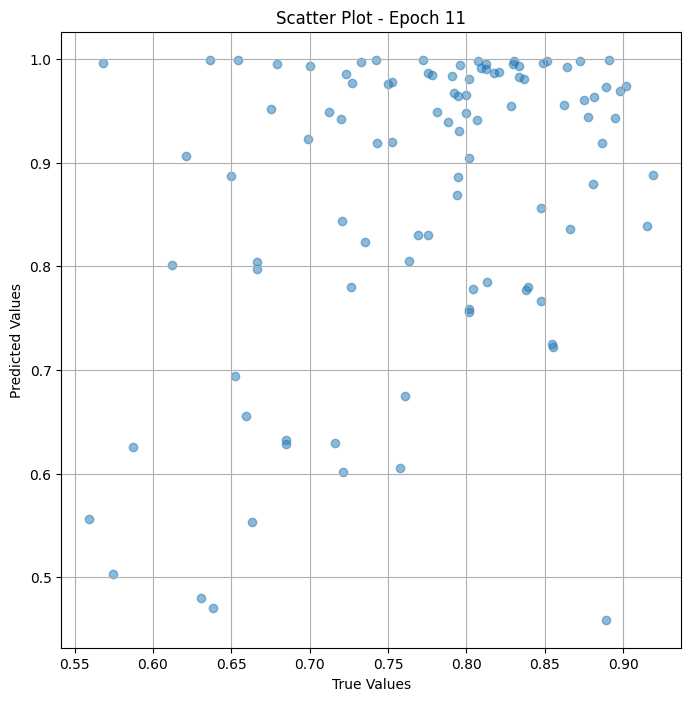


 Epoch: (12/50) Loss = 0.025584276765584946

 Epoch: (12/50) Loss_rmse = 0.159950852394104

 Epoch: (12/50) R^2 = -7.666258811950684

 Epoch: (12/50) MAE = 0.09882092475891113

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 

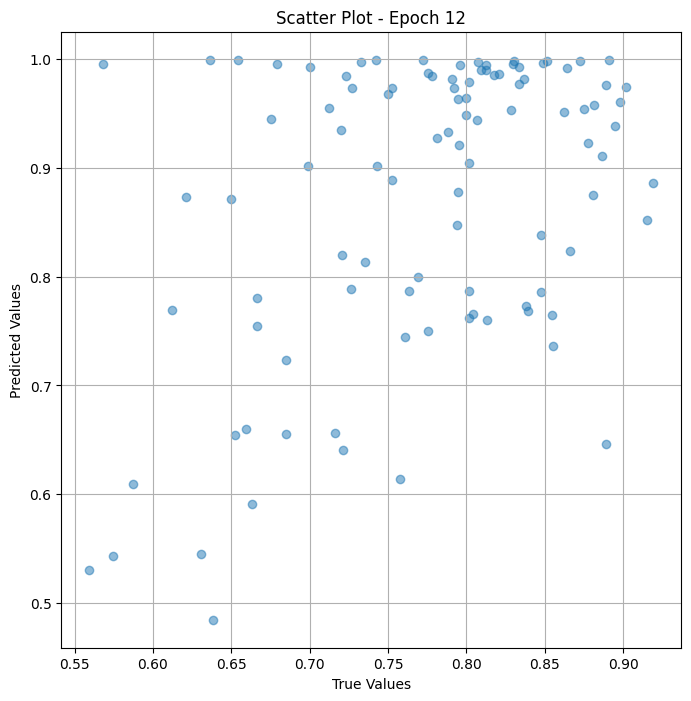


 Epoch: (13/50) Loss = 0.02680445834994316

 Epoch: (13/50) Loss_rmse = 0.16372066736221313

 Epoch: (13/50) R^2 = -8.079574584960938

 Epoch: (13/50) MAE = 0.10667815804481506

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

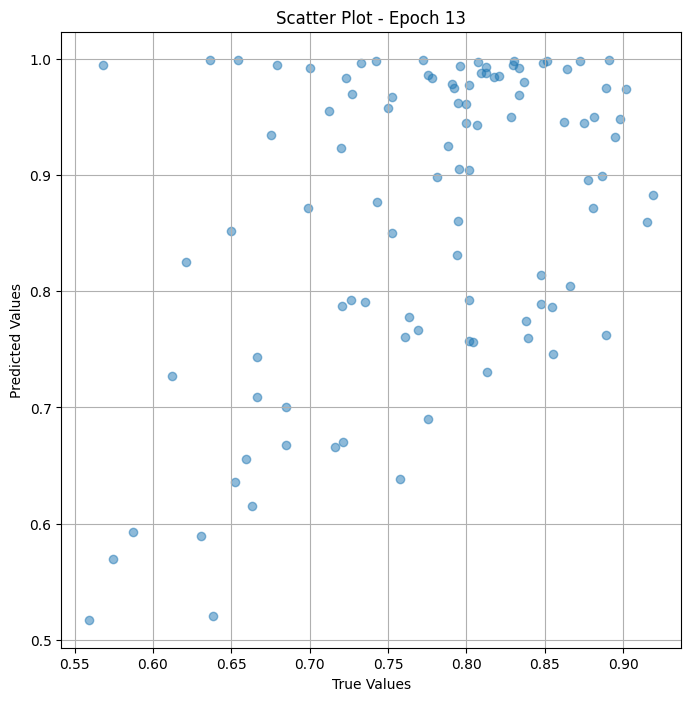


 Epoch: (14/50) Loss = 0.025967329740524292

 Epoch: (14/50) Loss_rmse = 0.16114380955696106

 Epoch: (14/50) R^2 = -7.796010971069336

 Epoch: (14/50) MAE = 0.10467995703220367

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

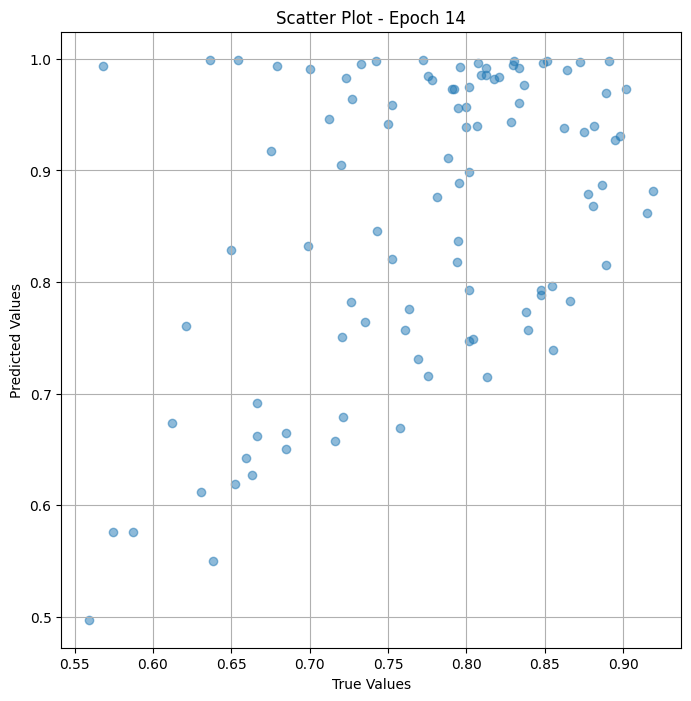


 Epoch: (15/50) Loss = 0.02484121546149254

 Epoch: (15/50) Loss_rmse = 0.1576109677553177

 Epoch: (15/50) R^2 = -7.414558410644531

 Epoch: (15/50) MAE = 0.08926290273666382

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 

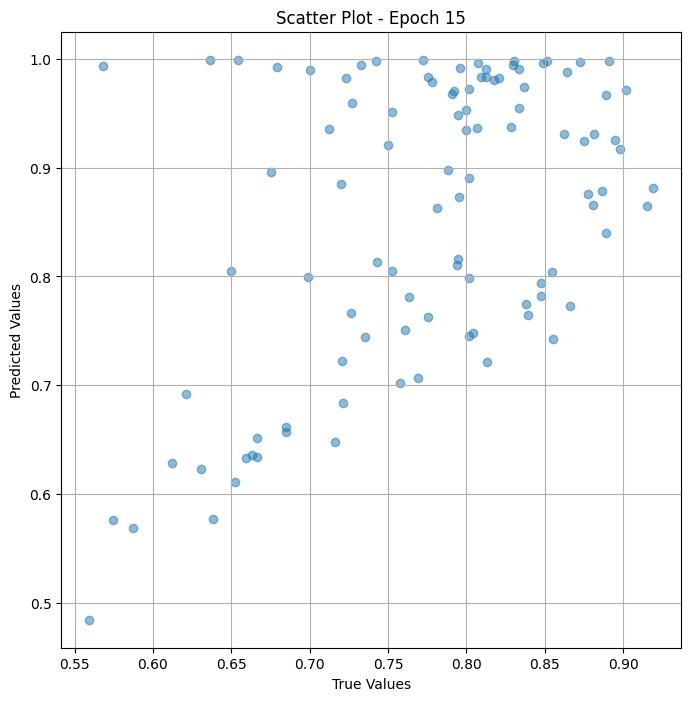


 Epoch: (16/50) Loss = 0.024449655786156654

 Epoch: (16/50) Loss_rmse = 0.1563638597726822

 Epoch: (16/50) R^2 = -7.281924247741699

 Epoch: (16/50) MAE = 0.08092372119426727

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

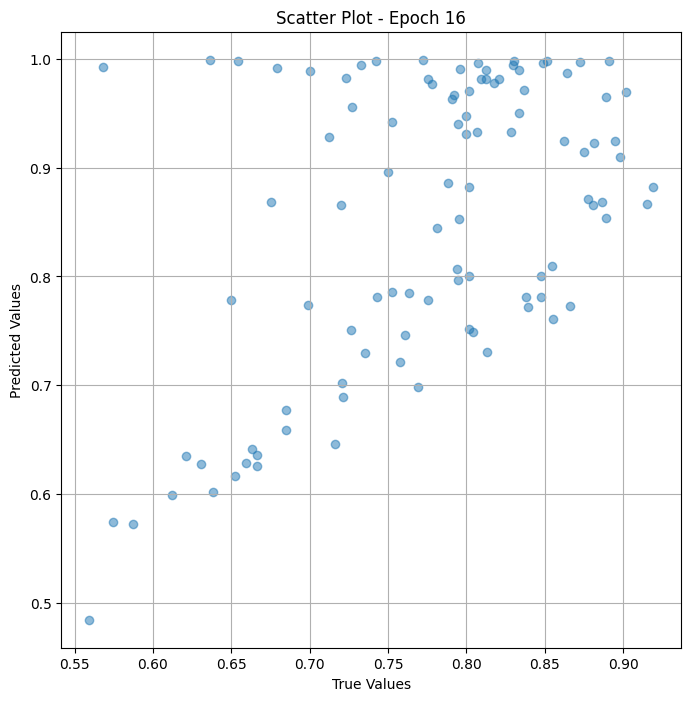


 Epoch: (17/50) Loss = 0.024255285039544106

 Epoch: (17/50) Loss_rmse = 0.15574108064174652

 Epoch: (17/50) R^2 = -7.216083526611328

 Epoch: (17/50) MAE = 0.08342784643173218

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

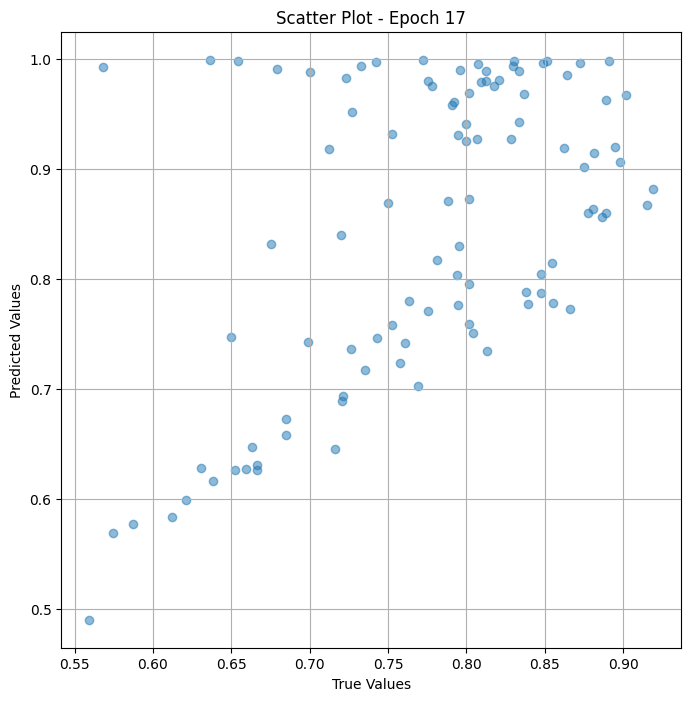


 Epoch: (18/50) Loss = 0.024062229320406914

 Epoch: (18/50) Loss_rmse = 0.15512004494667053

 Epoch: (18/50) R^2 = -7.150689125061035

 Epoch: (18/50) MAE = 0.0865192860364914

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

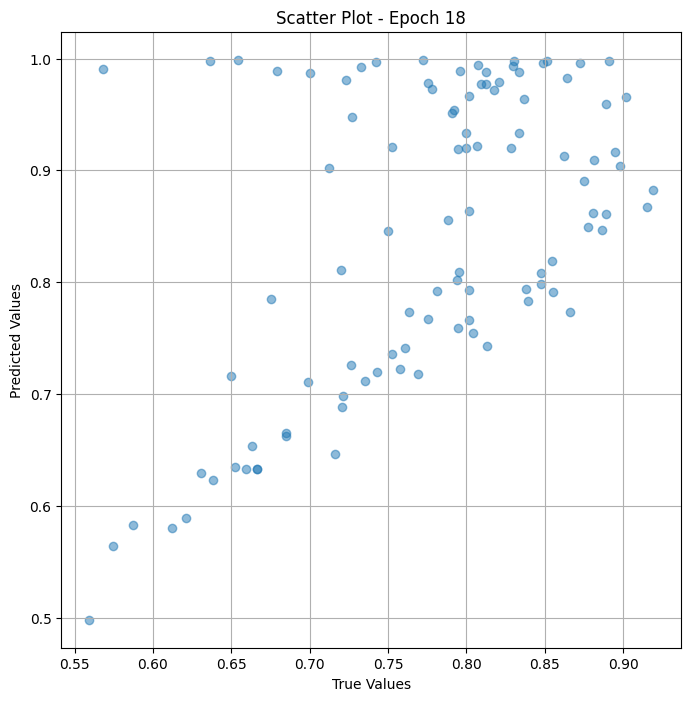


 Epoch: (19/50) Loss = 0.02367010898888111

 Epoch: (19/50) Loss_rmse = 0.15385092794895172

 Epoch: (19/50) R^2 = -7.017865180969238

 Epoch: (19/50) MAE = 0.0832815170288086

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 

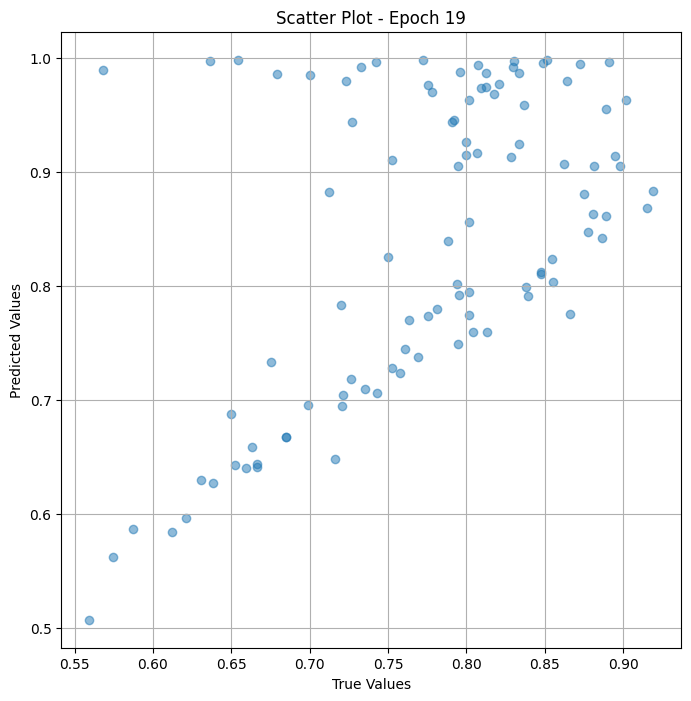


 Epoch: (20/50) Loss = 0.023167775943875313

 Epoch: (20/50) Loss_rmse = 0.15220963954925537

 Epoch: (20/50) R^2 = -6.847707748413086

 Epoch: (20/50) MAE = 0.08243153989315033

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

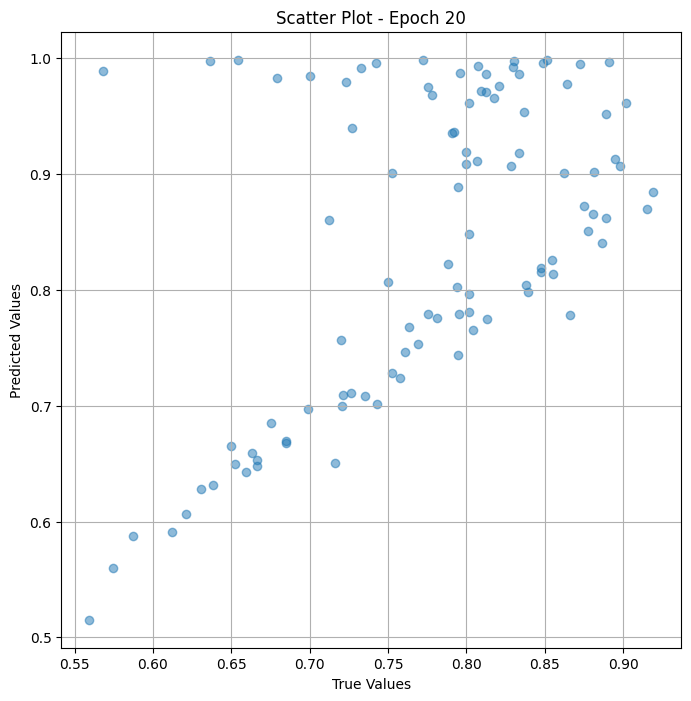


 Epoch: (21/50) Loss = 0.0224476121366024

 Epoch: (21/50) Loss_rmse = 0.14982527494430542

 Epoch: (21/50) R^2 = -6.603764057159424

 Epoch: (21/50) MAE = 0.08156311511993408

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407, 

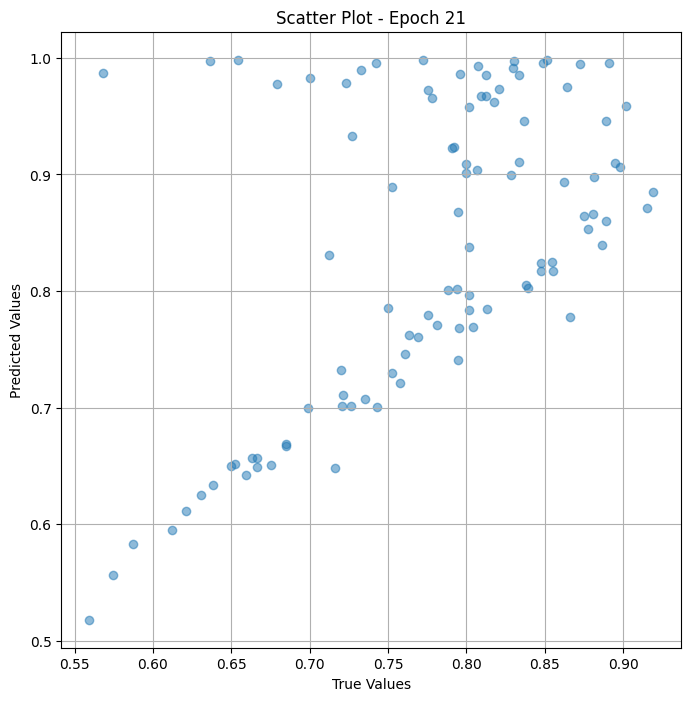


 Epoch: (22/50) Loss = 0.021351587027311325

 Epoch: (22/50) Loss_rmse = 0.1461218297481537

 Epoch: (22/50) R^2 = -6.232503414154053

 Epoch: (22/50) MAE = 0.07835273444652557

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407,

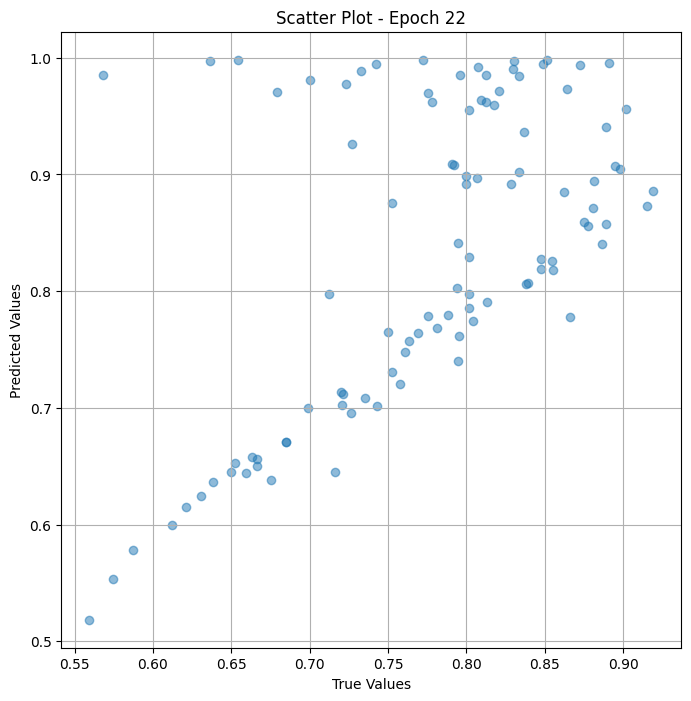


 Epoch: (23/50) Loss = 0.019652510061860085

 Epoch: (23/50) Loss_rmse = 0.14018741250038147

 Epoch: (23/50) R^2 = -5.656968593597412

 Epoch: (23/50) MAE = 0.07425463199615479

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

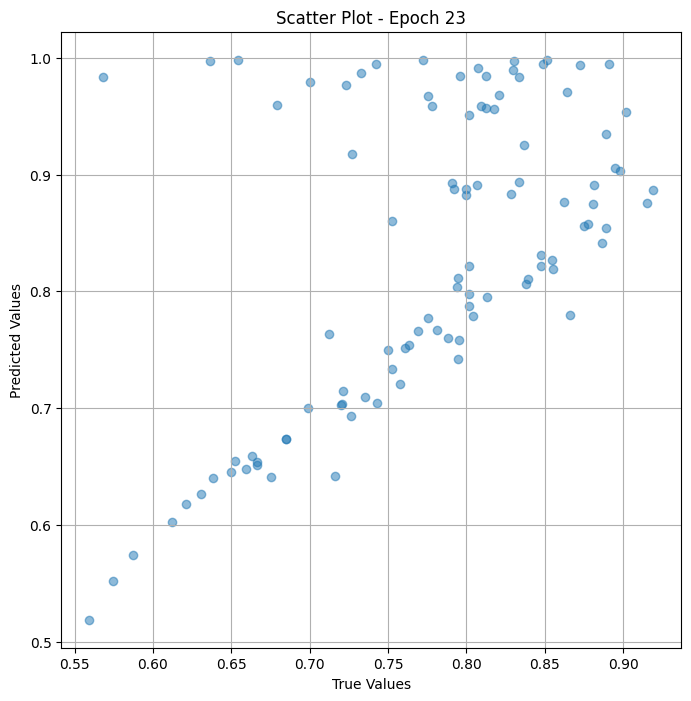


 Epoch: (24/50) Loss = 0.01678907684981823

 Epoch: (24/50) Loss_rmse = 0.12957267463207245

 Epoch: (24/50) R^2 = -4.6870269775390625

 Epoch: (24/50) MAE = 0.06848163902759552

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

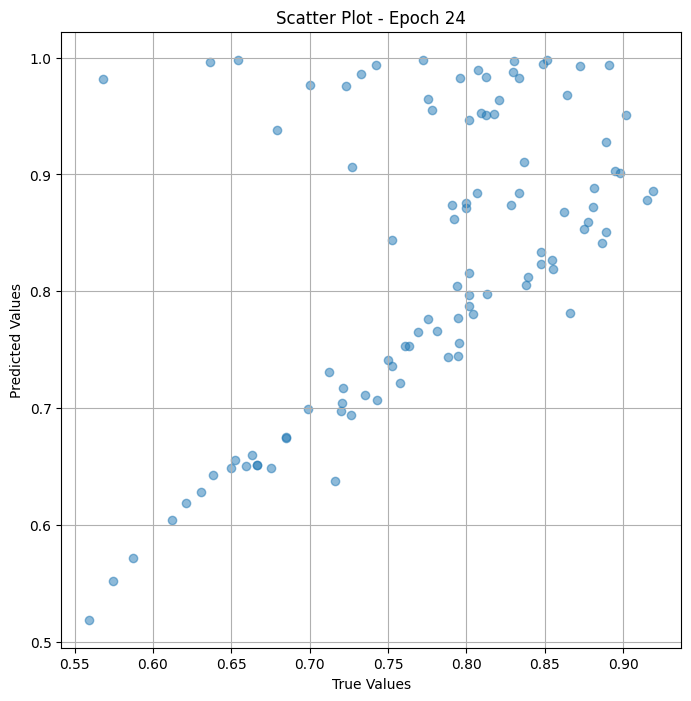


 Epoch: (25/50) Loss = 0.011738992296159267

 Epoch: (25/50) Loss_rmse = 0.10834663361310959

 Epoch: (25/50) R^2 = -2.976392984390259

 Epoch: (25/50) MAE = 0.05721956491470337

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593407

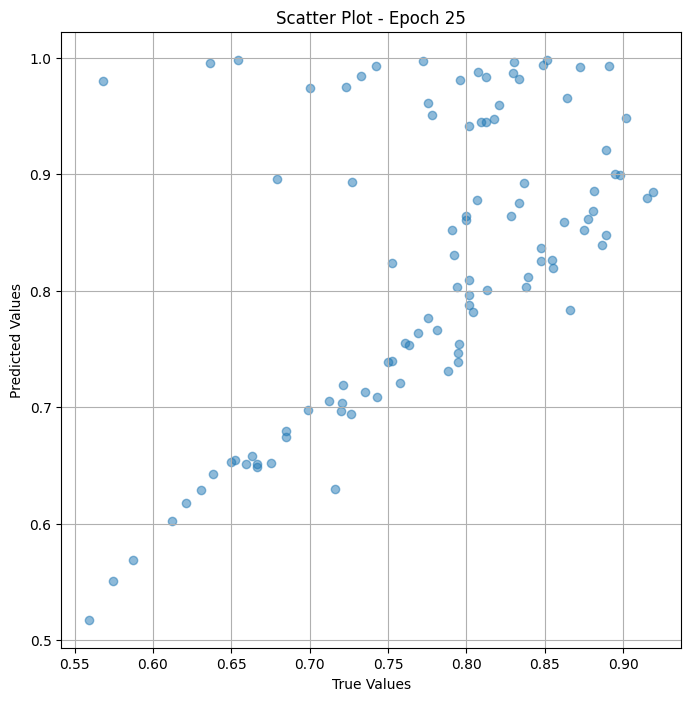


 Epoch: (26/50) Loss = 0.004011272918432951

 Epoch: (26/50) Loss_rmse = 0.06333461403846741

 Epoch: (26/50) R^2 = -0.3587535619735718

 Epoch: (26/50) MAE = 0.034270644187927246

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65934

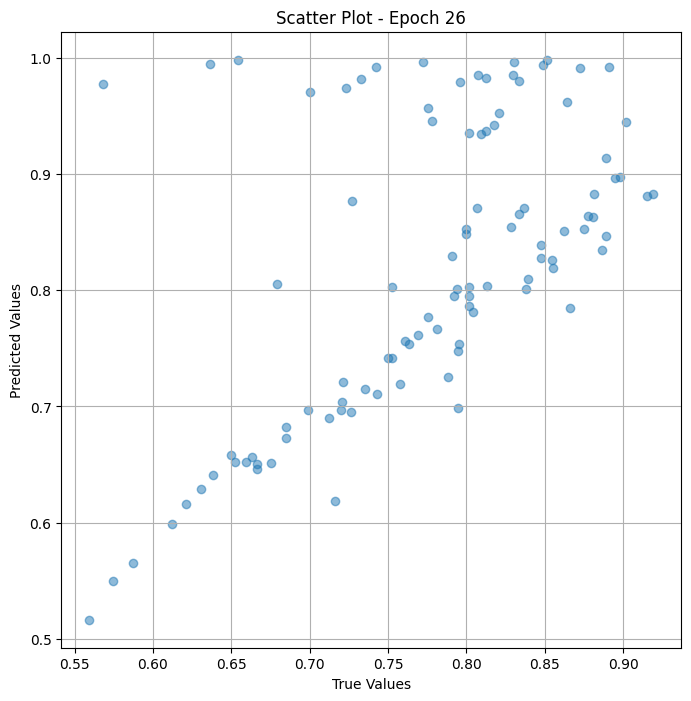


 Epoch: (27/50) Loss = 6.515091808978468e-05

 Epoch: (27/50) Loss_rmse = 0.008071611635386944

 Epoch: (27/50) R^2 = 0.9779312014579773

 Epoch: (27/50) MAE = 0.0058365315198898315

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

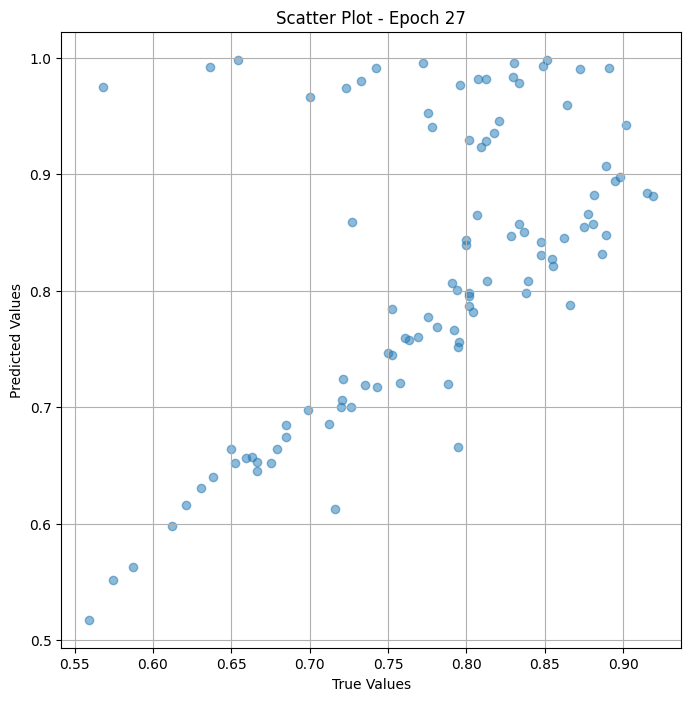


 Epoch: (28/50) Loss = 0.0002576762926764786

 Epoch: (28/50) Loss_rmse = 0.01605229824781418

 Epoch: (28/50) R^2 = 0.9127163290977478

 Epoch: (28/50) MAE = 0.010667279362678528

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65934

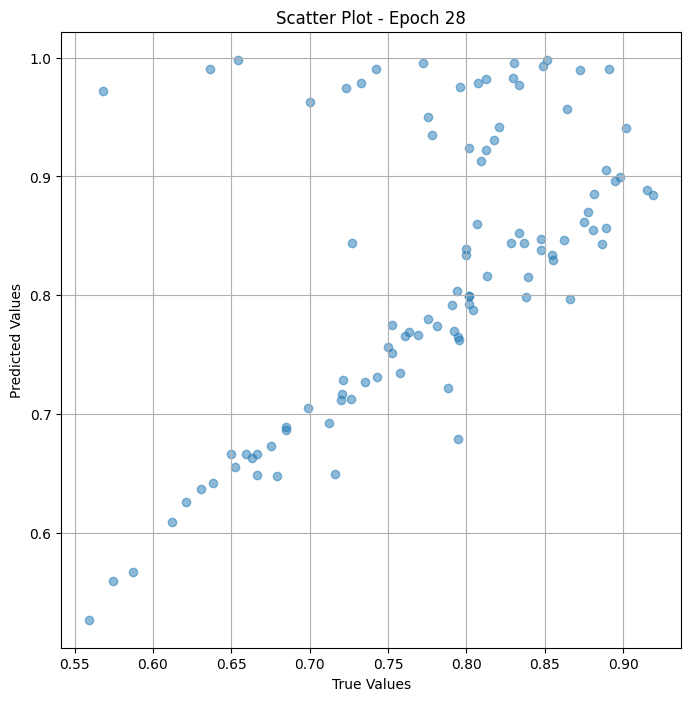


 Epoch: (29/50) Loss = 0.00010519598436076194

 Epoch: (29/50) Loss_rmse = 0.01025650929659605

 Epoch: (29/50) R^2 = 0.9643665552139282

 Epoch: (29/50) MAE = 0.009617939591407776

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

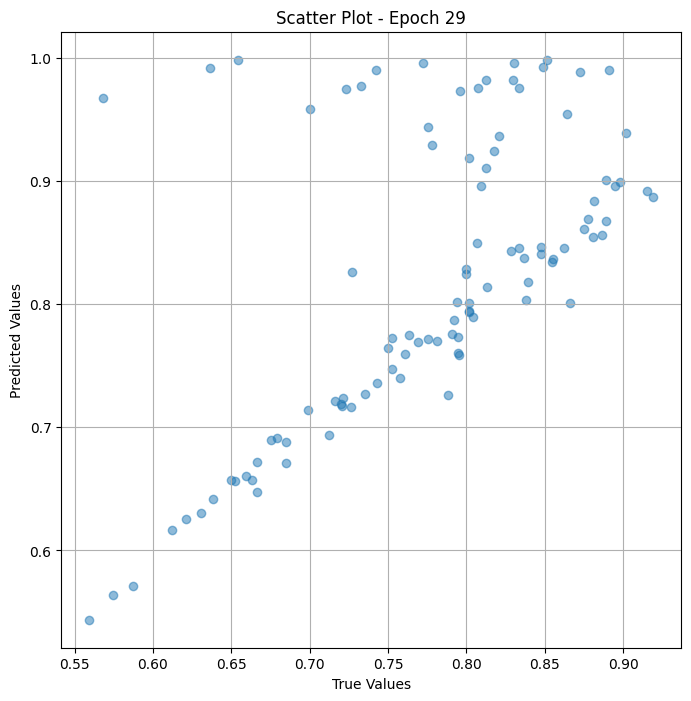


 Epoch: (30/50) Loss = 5.913017230341211e-05

 Epoch: (30/50) Loss_rmse = 0.0076896147802472115

 Epoch: (30/50) R^2 = 0.9799706339836121

 Epoch: (30/50) MAE = 0.006608858704566956

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

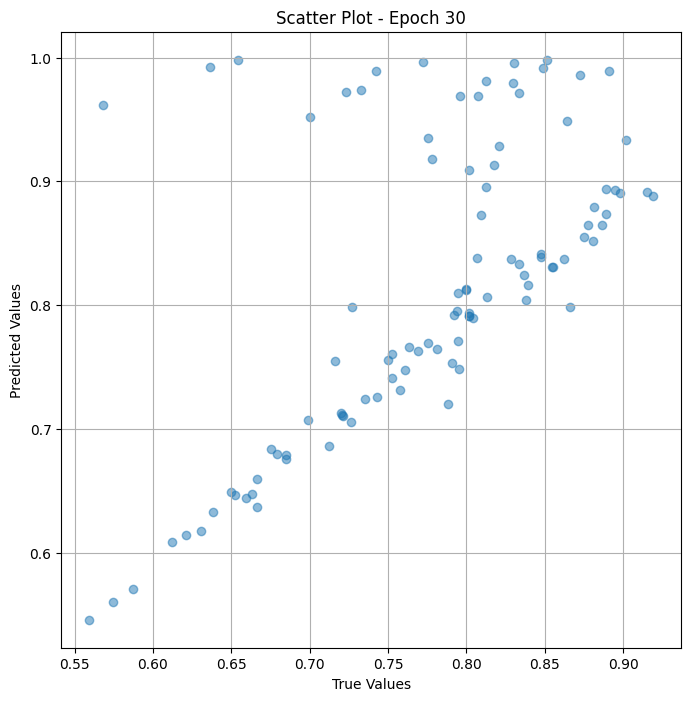


 Epoch: (31/50) Loss = 6.869691424071789e-05

 Epoch: (31/50) Loss_rmse = 0.008288360200822353

 Epoch: (31/50) R^2 = 0.9767300486564636

 Epoch: (31/50) MAE = 0.007694154977798462

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

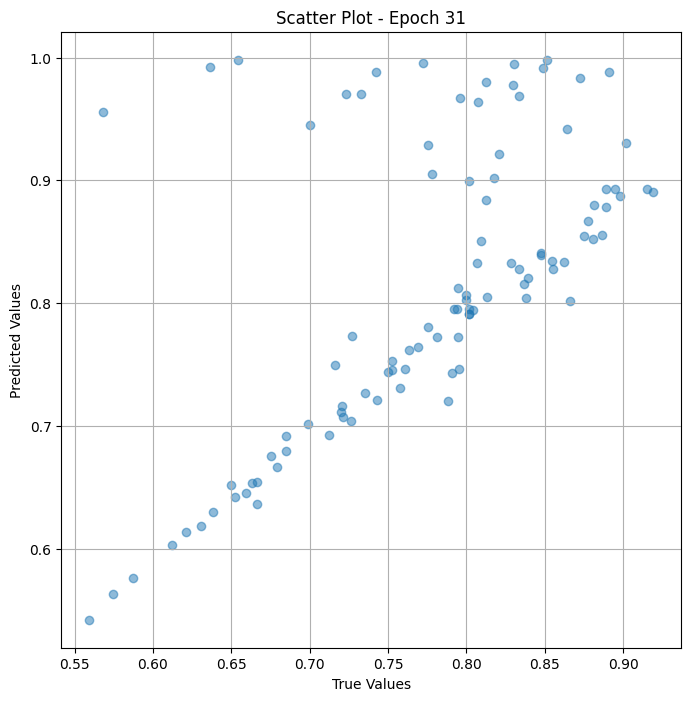


 Epoch: (32/50) Loss = 4.367511792224832e-05

 Epoch: (32/50) Loss_rmse = 0.006608715280890465

 Epoch: (32/50) R^2 = 0.9852057695388794

 Epoch: (32/50) MAE = 0.006557479500770569

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

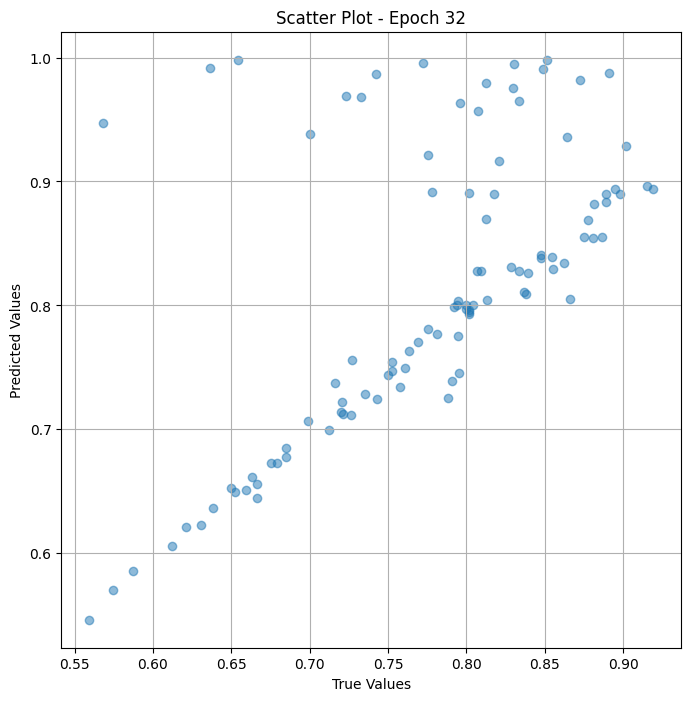


 Epoch: (33/50) Loss = 4.3029795051552355e-05

 Epoch: (33/50) Loss_rmse = 0.006559710018336773

 Epoch: (33/50) R^2 = 0.9854243397712708

 Epoch: (33/50) MAE = 0.005020663142204285

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

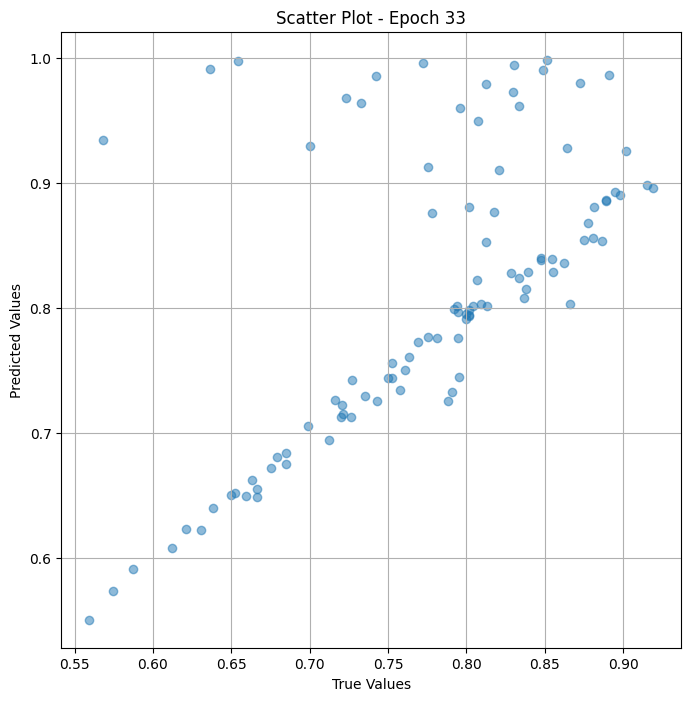


 Epoch: (34/50) Loss = 1.4757835742784664e-05

 Epoch: (34/50) Loss_rmse = 0.0038415929302573204

 Epoch: (34/50) R^2 = 0.9950010180473328

 Epoch: (34/50) MAE = 0.0022417306900024414

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

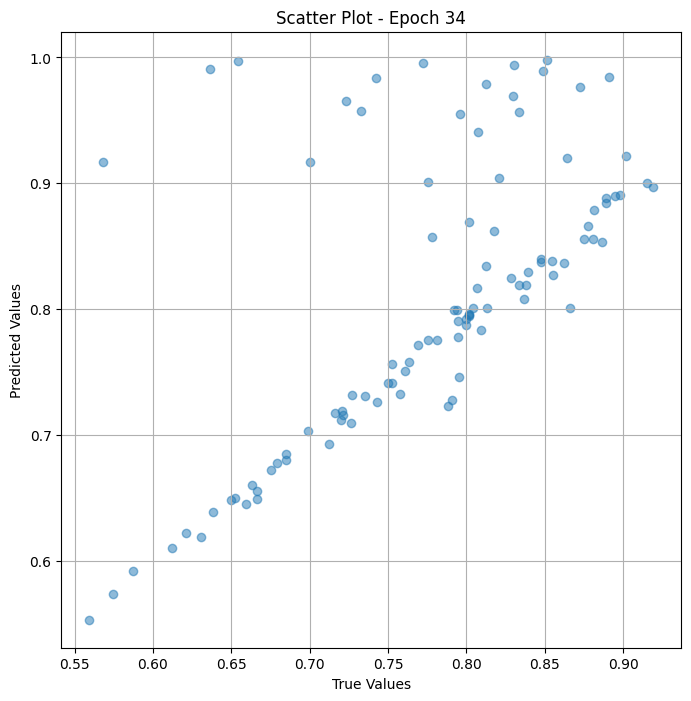


 Epoch: (35/50) Loss = 2.3578348191222176e-05

 Epoch: (35/50) Loss_rmse = 0.004855754319578409

 Epoch: (35/50) R^2 = 0.9920132160186768

 Epoch: (35/50) MAE = 0.004088506102561951

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

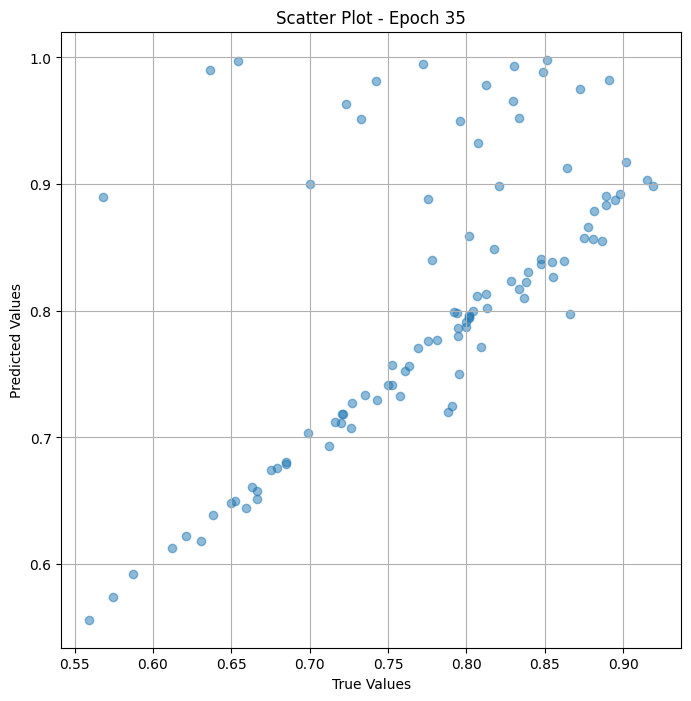


 Epoch: (36/50) Loss = 2.5639481464168057e-05

 Epoch: (36/50) Loss_rmse = 0.0050635444931685925

 Epoch: (36/50) R^2 = 0.9913150668144226

 Epoch: (36/50) MAE = 0.004127487540245056

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

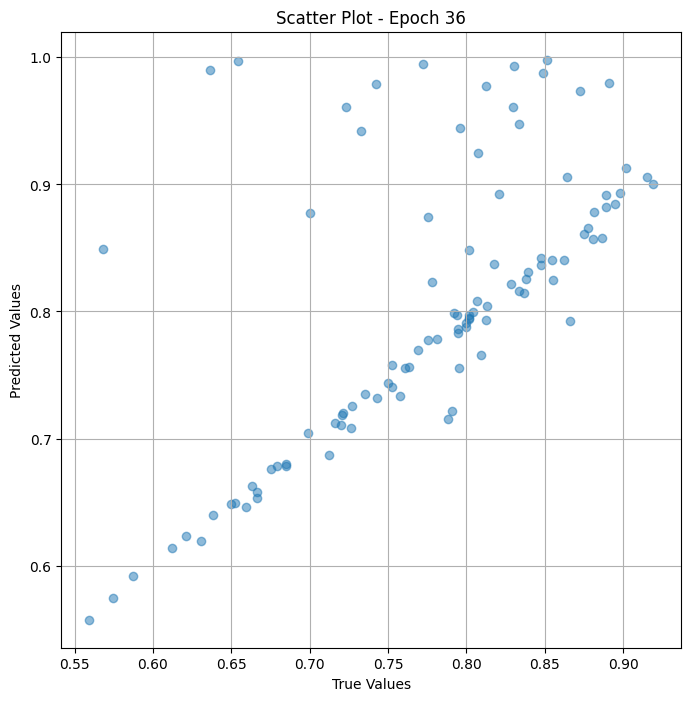


 Epoch: (37/50) Loss = 1.8255137547384948e-05

 Epoch: (37/50) Loss_rmse = 0.004272602964192629

 Epoch: (37/50) R^2 = 0.9938163757324219

 Epoch: (37/50) MAE = 0.0033880919218063354

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

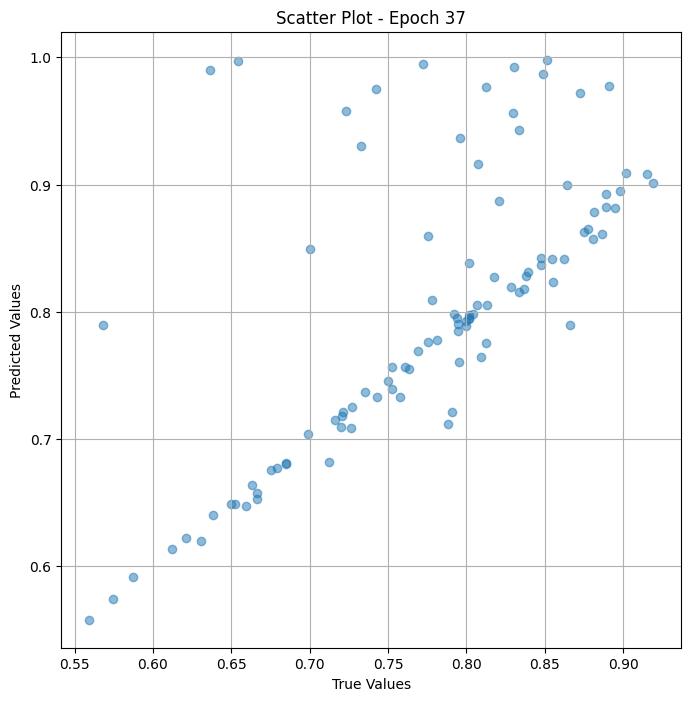


 Epoch: (38/50) Loss = 1.7672124158707447e-05

 Epoch: (38/50) Loss_rmse = 0.004203822463750839

 Epoch: (38/50) R^2 = 0.9940138459205627

 Epoch: (38/50) MAE = 0.003122657537460327

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

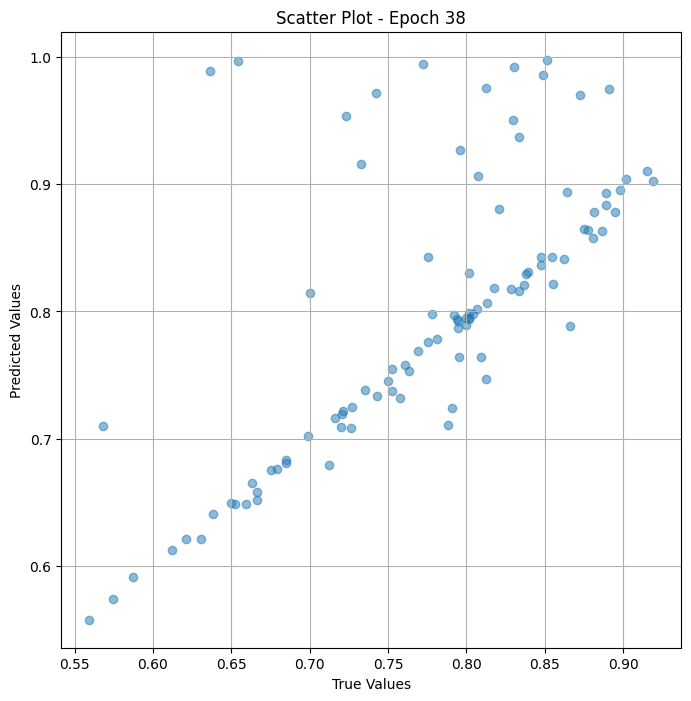


 Epoch: (39/50) Loss = 2.1419920813059434e-05

 Epoch: (39/50) Loss_rmse = 0.00462816609069705

 Epoch: (39/50) R^2 = 0.9927443265914917

 Epoch: (39/50) MAE = 0.0032711774110794067

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

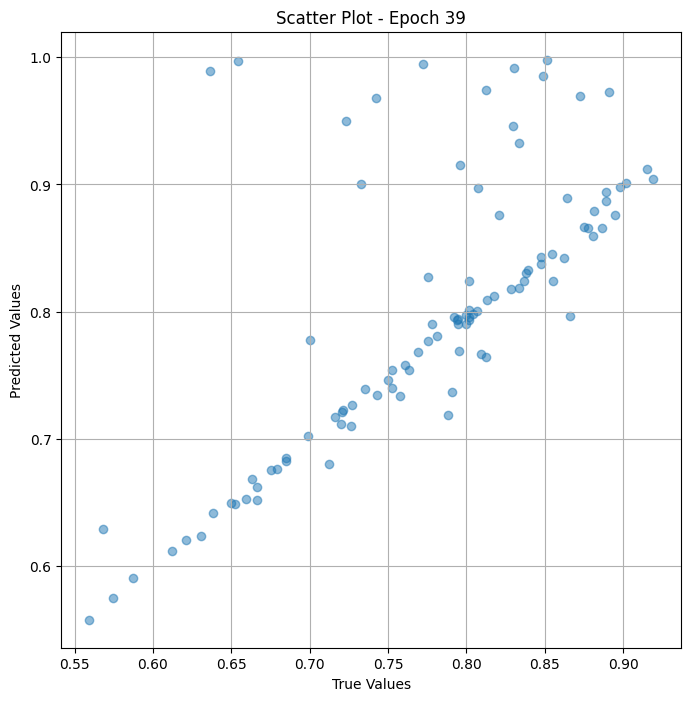


 Epoch: (40/50) Loss = 3.432887024246156e-05

 Epoch: (40/50) Loss_rmse = 0.00585908442735672

 Epoch: (40/50) R^2 = 0.9883716702461243

 Epoch: (40/50) MAE = 0.003930330276489258

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65934

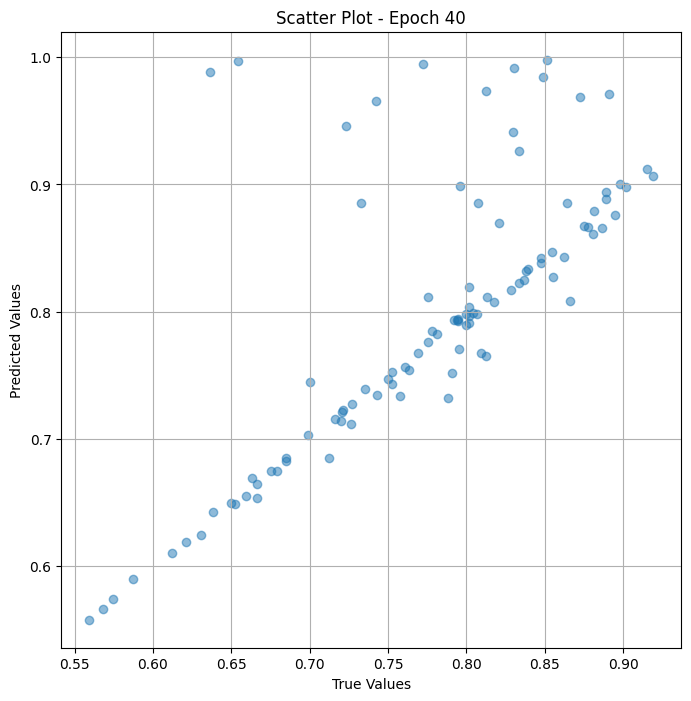


 Epoch: (41/50) Loss = 3.7305311707314104e-05

 Epoch: (41/50) Loss_rmse = 0.006107807625085115

 Epoch: (41/50) R^2 = 0.9873634576797485

 Epoch: (41/50) MAE = 0.0043464601039886475

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

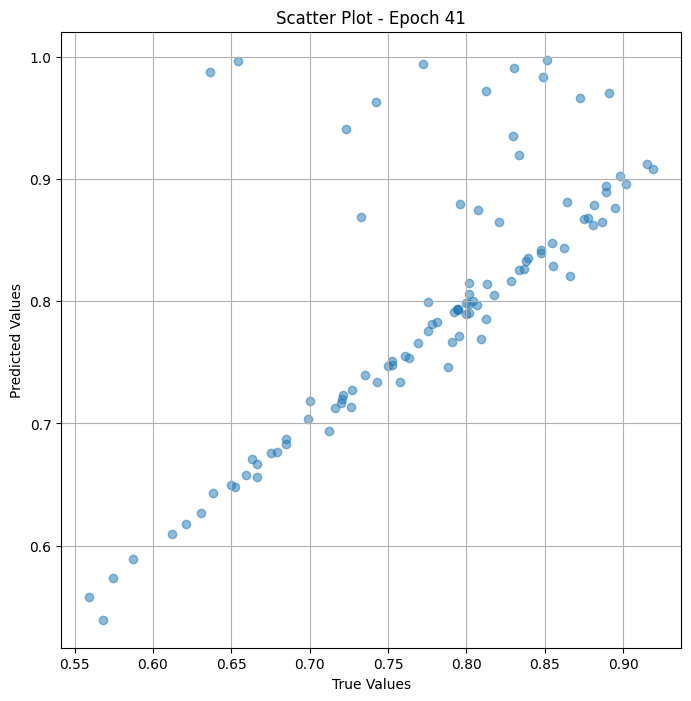


 Epoch: (42/50) Loss = 3.8031332223908976e-05

 Epoch: (42/50) Loss_rmse = 0.00616695499047637

 Epoch: (42/50) R^2 = 0.9871175289154053

 Epoch: (42/50) MAE = 0.004239082336425781

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6593

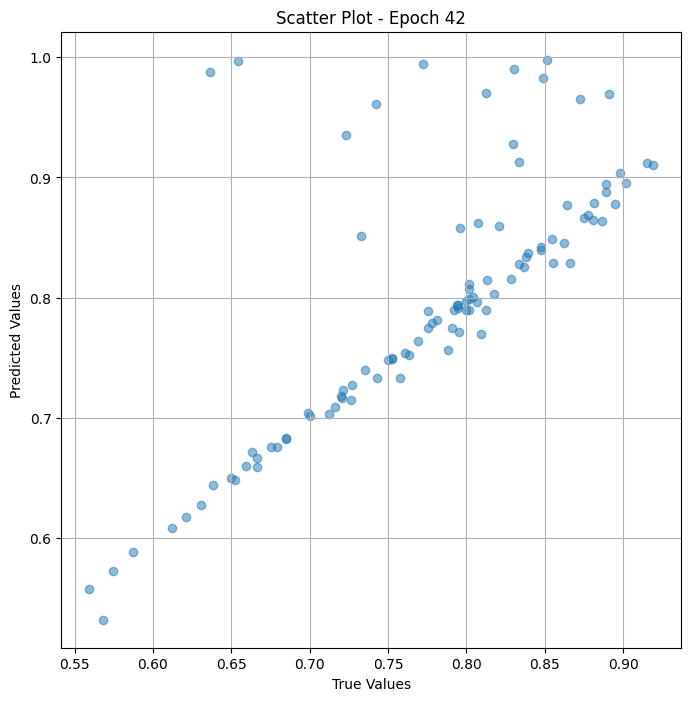


 Epoch: (43/50) Loss = 1.92105580936186e-05

 Epoch: (43/50) Loss_rmse = 0.004382985178381205

 Epoch: (43/50) R^2 = 0.9934927225112915

 Epoch: (43/50) MAE = 0.002648070454597473

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65934

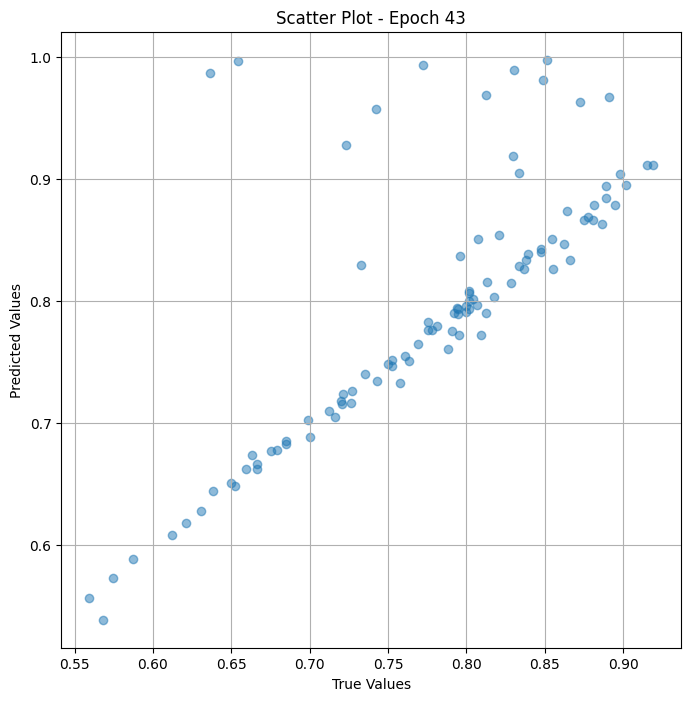


 Epoch: (44/50) Loss = 1.059343594533857e-05

 Epoch: (44/50) Loss_rmse = 0.0032547558657824993

 Epoch: (44/50) R^2 = 0.9964116215705872

 Epoch: (44/50) MAE = 0.0023474693298339844

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

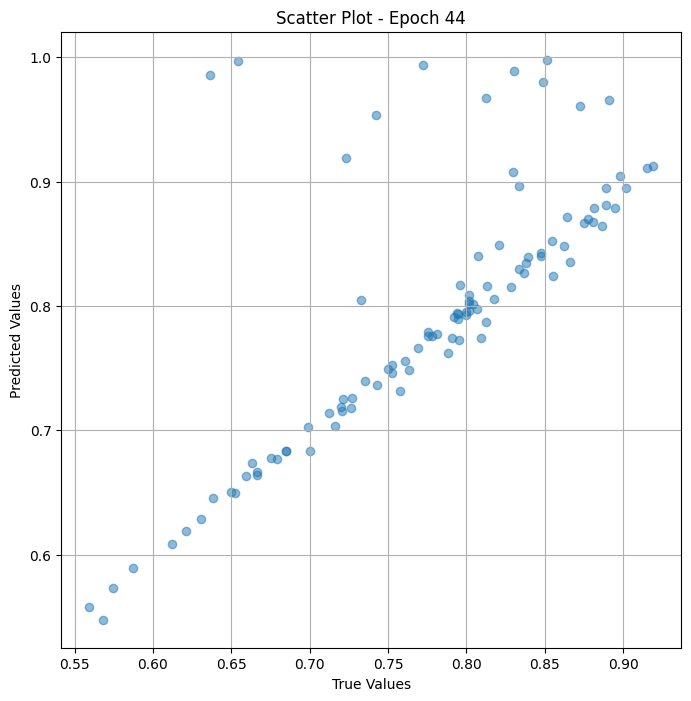


 Epoch: (45/50) Loss = 2.663712621142622e-06

 Epoch: (45/50) Loss_rmse = 0.001632088446058333

 Epoch: (45/50) R^2 = 0.9990977048873901

 Epoch: (45/50) MAE = 0.0013033300638198853

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

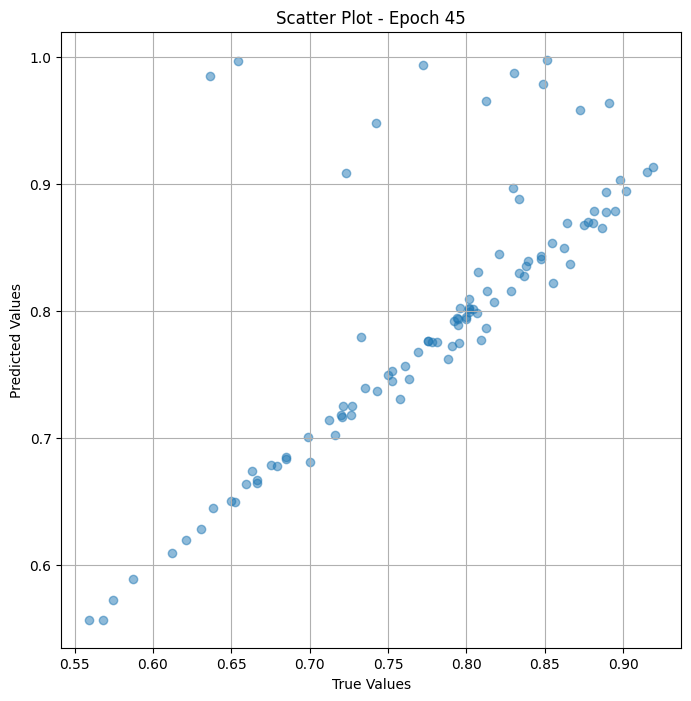


 Epoch: (46/50) Loss = 1.7496865893917857e-06

 Epoch: (46/50) Loss_rmse = 0.0013227572198957205

 Epoch: (46/50) R^2 = 0.9994073510169983

 Epoch: (46/50) MAE = 0.0011576265096664429

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.6

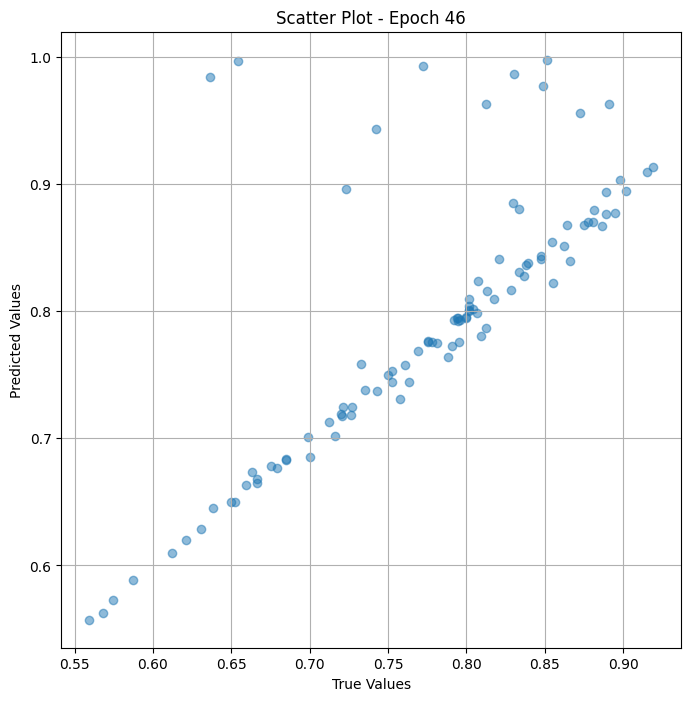


 Epoch: (47/50) Loss = 1.114173528549145e-06

 Epoch: (47/50) Loss_rmse = 0.0010555442422628403

 Epoch: (47/50) R^2 = 0.9996225833892822

 Epoch: (47/50) MAE = 0.0008028596639633179

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

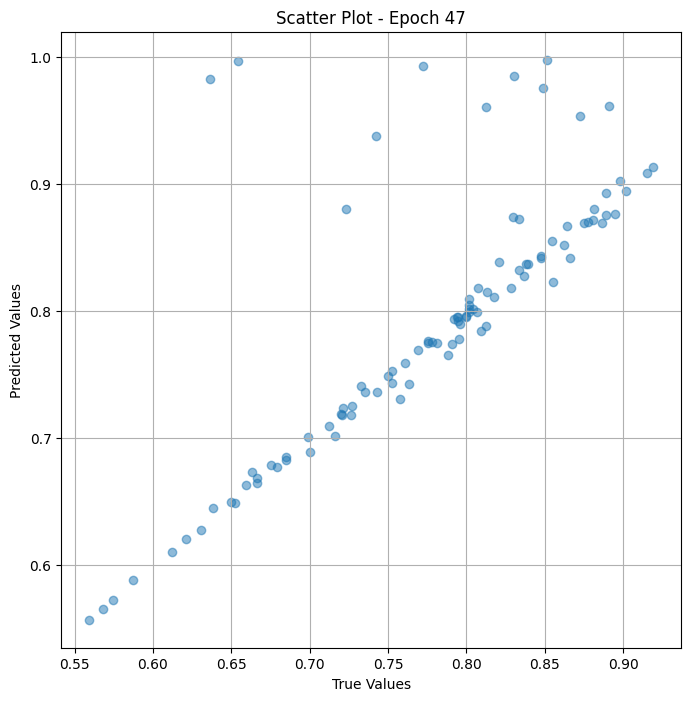


 Epoch: (48/50) Loss = 1.242234588971769e-06

 Epoch: (48/50) Loss_rmse = 0.0011145557509735227

 Epoch: (48/50) R^2 = 0.9995791912078857

 Epoch: (48/50) MAE = 0.0007510781288146973

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

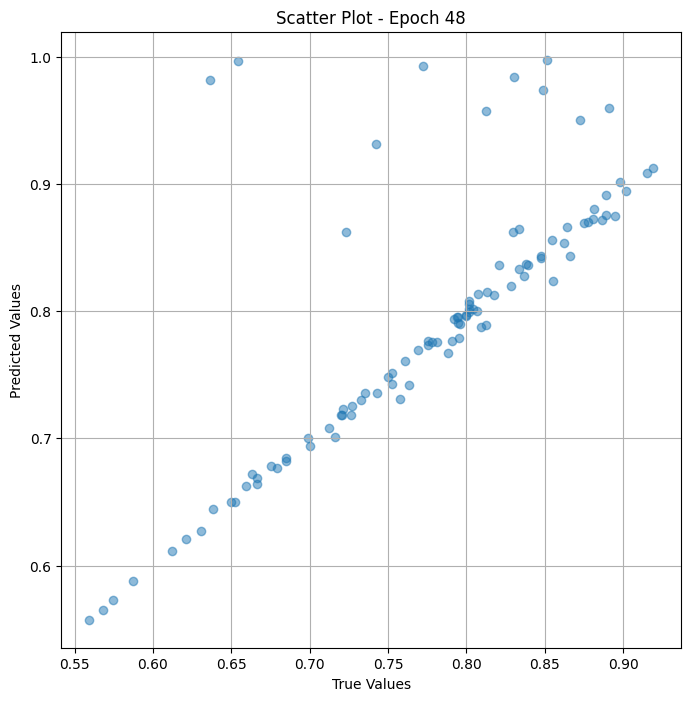


 Epoch: (49/50) Loss = 1.4445713532040827e-06

 Epoch: (49/50) Loss_rmse = 0.0012019032146781683

 Epoch: (49/50) R^2 = 0.999510645866394

 Epoch: (49/50) MAE = 0.000947311520576477

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.659

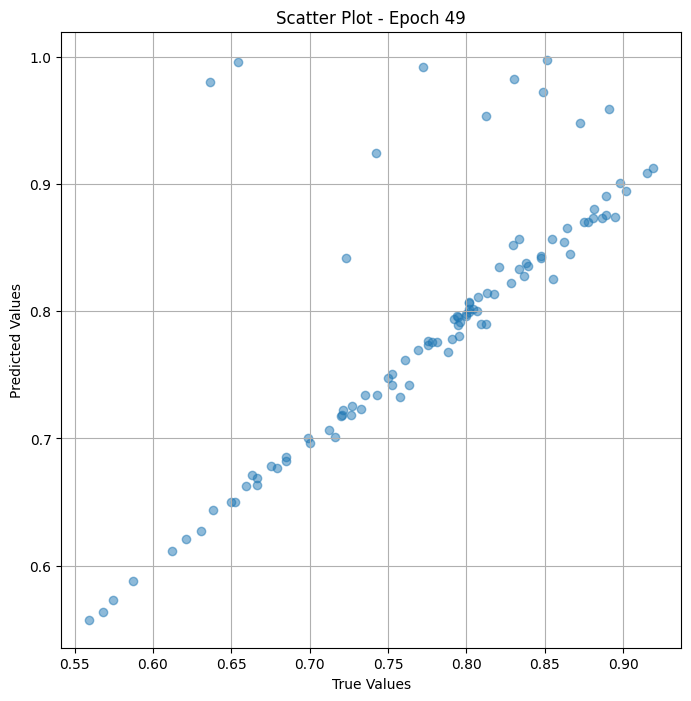


 Epoch: (50/50) Loss = 1.9564918147807475e-06

 Epoch: (50/50) Loss_rmse = 0.0013987465063109994

 Epoch: (50/50) R^2 = 0.9993372559547424

 Epoch: (50/50) MAE = 0.001096293330192566

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.85148513, 0.6385542, 0.7326733, 0.8488372, 0.8640777, 0.7, 0.83809525, 0.75, 0.7943925, 0.5595238, 0.8019802, 0.69911504, 0.7234042, 0.83035713, 0.6363636, 0.6526316, 0.6666667, 0.71590906, 0.7126437, 0.7777778, 0.8125, 0.78846157, 0.75247526, 0.8888889, 0.82857144, 0.85542166, 0.7425743, 0.72115386, 0.89772725, 0.8018868, 0.872549, 0.8333333, 0.7692308, 0.7264151, 0.72727275, 0.7938144, 0.6122449, 0.77227724, 0.6666667, 0.9019608, 0.5873016, 0.74311924, 0.86238533, 0.57425743, 0.7909091, 0.72, 0.76363635, 0.88095236, 0.82978725, 0.8173077, 0.8333333, 0.6213592, 0.87777776, 0.75789475, 0.7920792, 0.8660714, 0.7943925, 0.8019802, 0.8, 0.91525424, 0.8888889, 0.6754386, 0.8947368, 0.6545454, 0.79591835, 0.8039216, 0.65

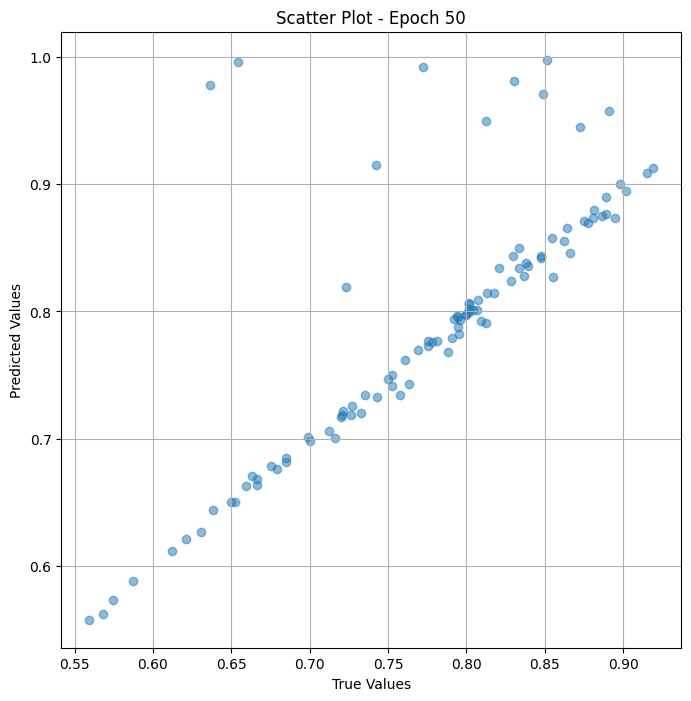

In [ ]:
# Training the model and save weights
fit(50, modelfine_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_valr_fine")

## Test

In [ ]:
# Merge the two models
class model_merge_fine_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_fine_test = model_merge_fine_test(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_fine_test = to_device(model_fine_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_fine_test.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_fine_test , train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_fine_test .eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_fine_test (x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.1824040412902832

 Epoch: (1/50) Loss_rmse = 0.4270878732204437

 Epoch: (1/50) R^2 = -91.29193115234375

 Epoch: (1/50) MAE = 0.3714544177055359

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333333

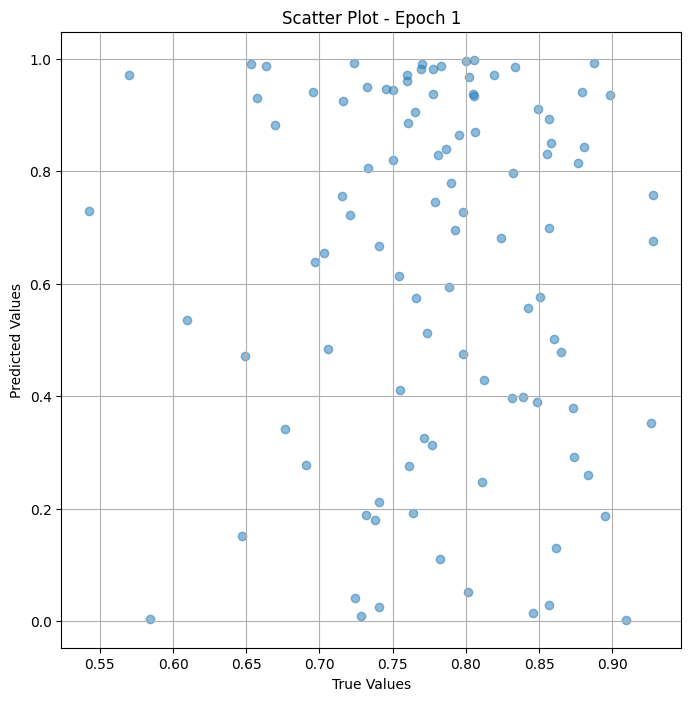


 Epoch: (2/50) Loss = 0.05213167890906334

 Epoch: (2/50) Loss_rmse = 0.22832362353801727

 Epoch: (2/50) R^2 = -25.377338409423828

 Epoch: (2/50) MAE = 0.18742363154888153

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.733

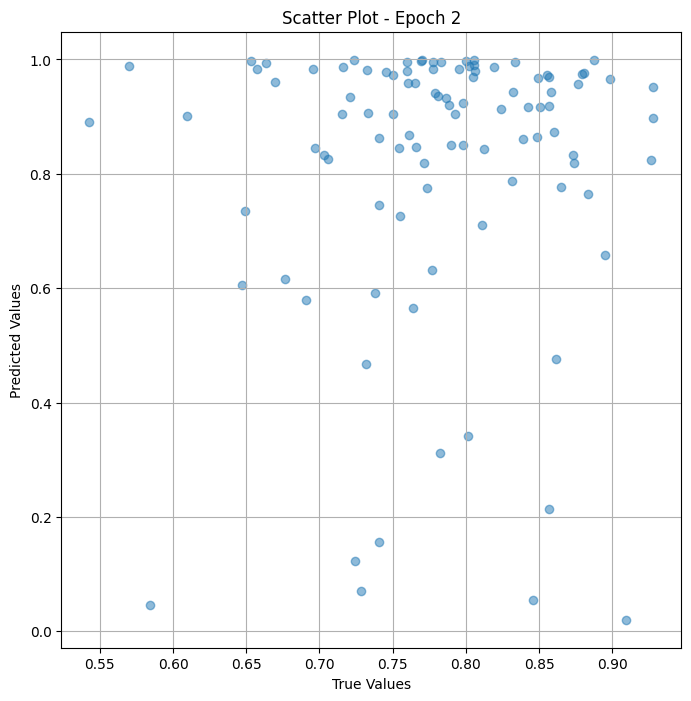


 Epoch: (3/50) Loss = 0.021611476317048073

 Epoch: (3/50) Loss_rmse = 0.14700841903686523

 Epoch: (3/50) R^2 = -9.934871673583984

 Epoch: (3/50) MAE = 0.12636034190654755

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.733

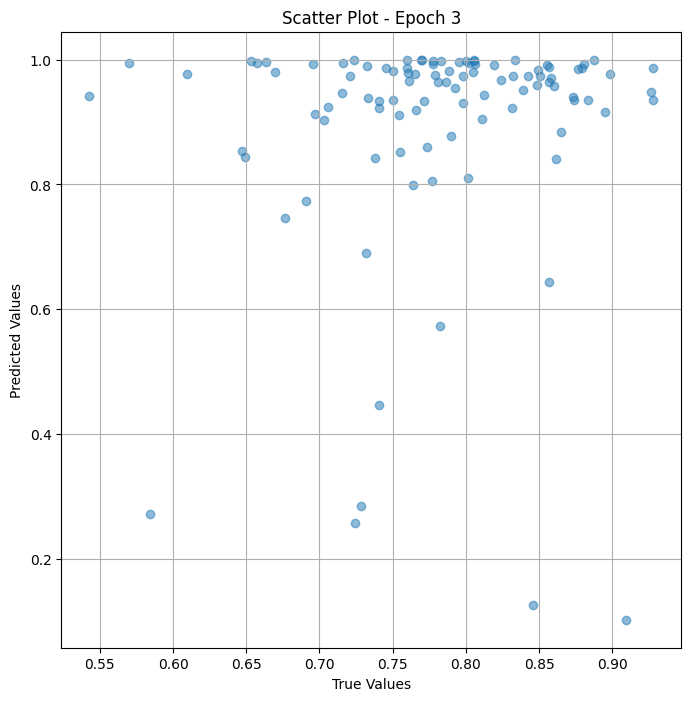


 Epoch: (4/50) Loss = 0.024491336196660995

 Epoch: (4/50) Loss_rmse = 0.1564970761537552

 Epoch: (4/50) R^2 = -11.392009735107422

 Epoch: (4/50) MAE = 0.1449354887008667

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333

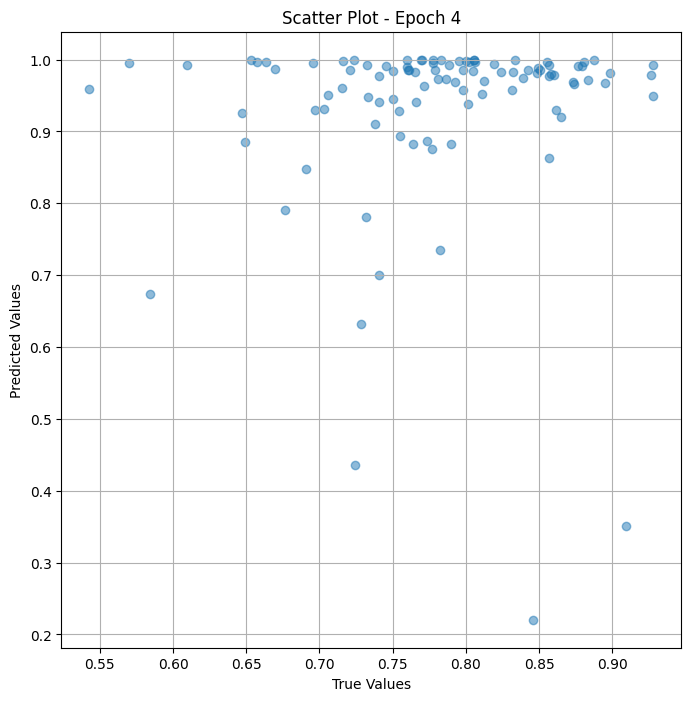


 Epoch: (5/50) Loss = 0.02545539103448391

 Epoch: (5/50) Loss_rmse = 0.15954746305942535

 Epoch: (5/50) R^2 = -11.87979793548584

 Epoch: (5/50) MAE = 0.1508014053106308

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.73333

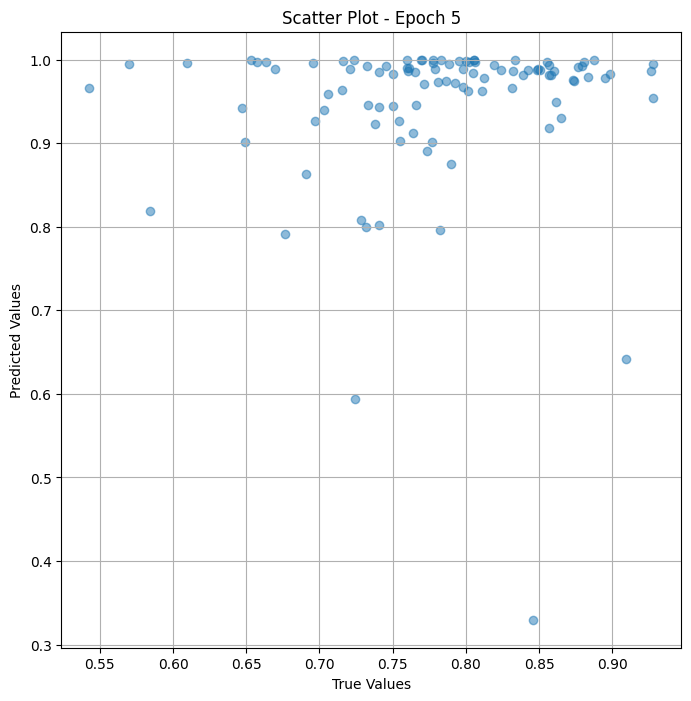


 Epoch: (6/50) Loss = 0.02482912689447403

 Epoch: (6/50) Loss_rmse = 0.15757261216640472

 Epoch: (6/50) R^2 = -11.562923431396484

 Epoch: (6/50) MAE = 0.14940640330314636

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.733

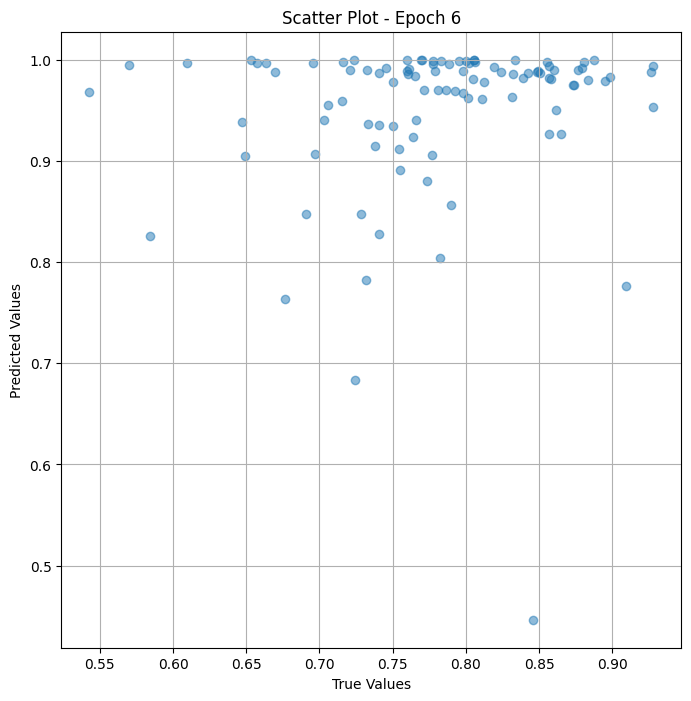


 Epoch: (7/50) Loss = 0.0228673554956913

 Epoch: (7/50) Loss_rmse = 0.15121956169605255

 Epoch: (7/50) R^2 = -10.57031536102295

 Epoch: (7/50) MAE = 0.14286741614341736

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.73333

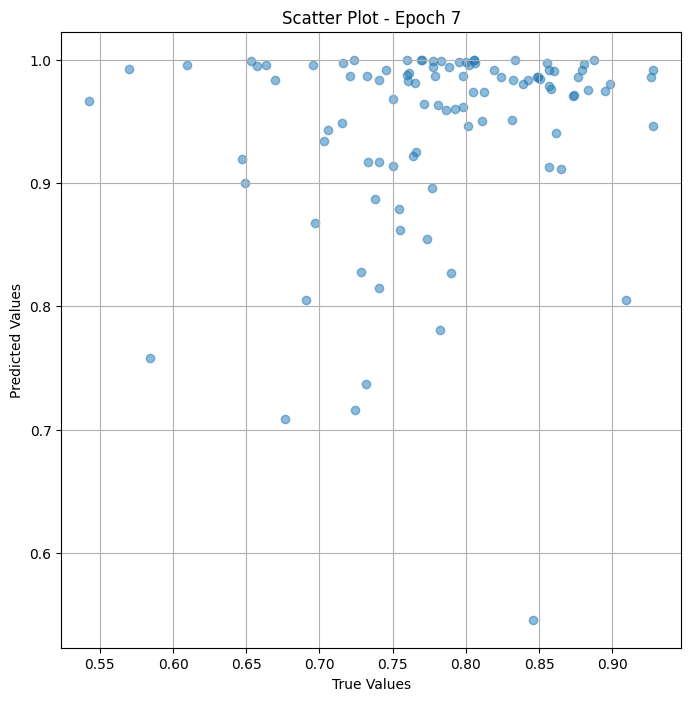


 Epoch: (8/50) Loss = 0.019383341073989868

 Epoch: (8/50) Loss_rmse = 0.1392240673303604

 Epoch: (8/50) R^2 = -8.807490348815918

 Epoch: (8/50) MAE = 0.13015708327293396

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.7333

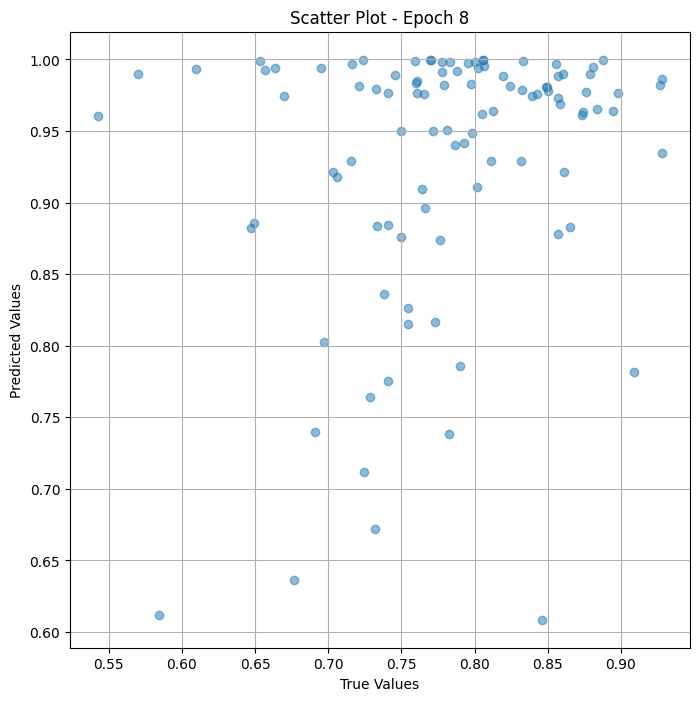


 Epoch: (9/50) Loss = 0.014460429549217224

 Epoch: (9/50) Loss_rmse = 0.12025152891874313

 Epoch: (9/50) R^2 = -6.316619396209717

 Epoch: (9/50) MAE = 0.11021968722343445

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0.733

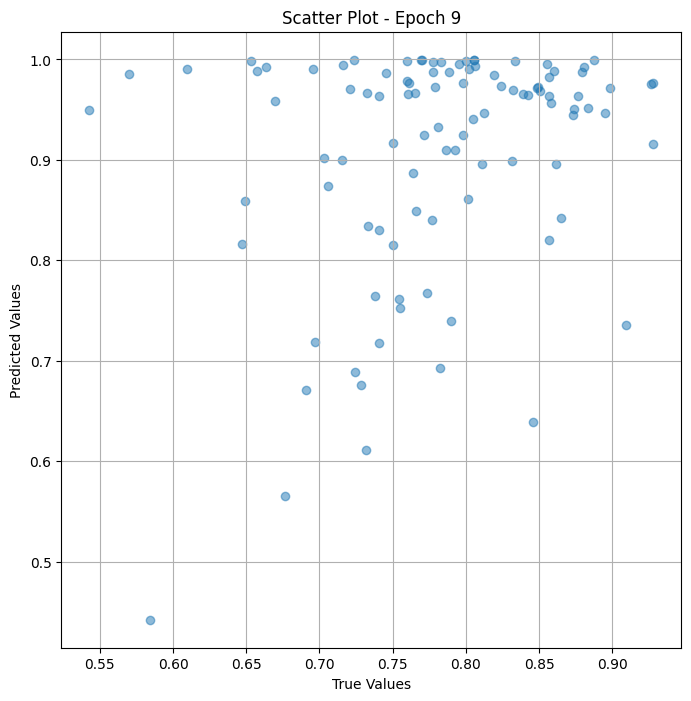


 Epoch: (10/50) Loss = 0.008962481282651424

 Epoch: (10/50) Loss_rmse = 0.0946703851222992

 Epoch: (10/50) R^2 = -3.5347938537597656

 Epoch: (10/50) MAE = 0.08386604487895966

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 0

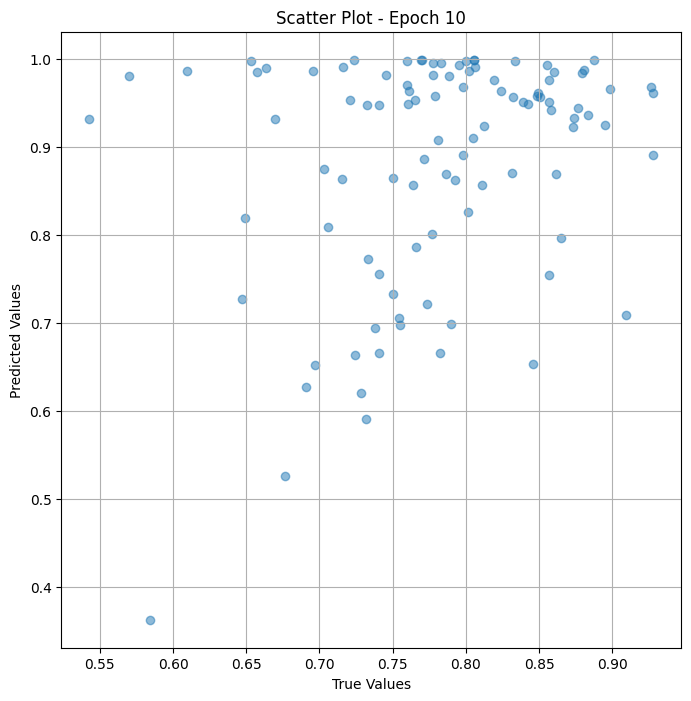


 Epoch: (11/50) Loss = 0.004729642067104578

 Epoch: (11/50) Loss_rmse = 0.06877239048480988

 Epoch: (11/50) R^2 = -1.3930819034576416

 Epoch: (11/50) MAE = 0.059028223156929016

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

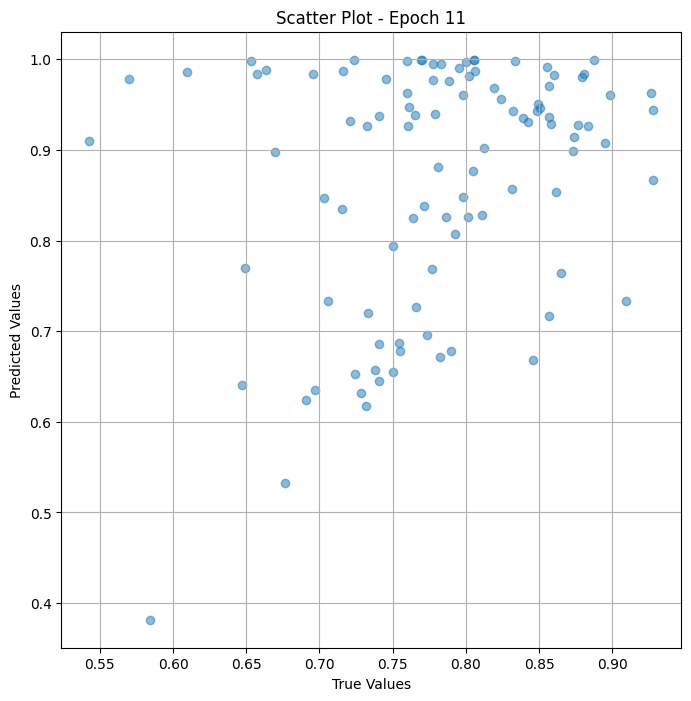


 Epoch: (12/50) Loss = 0.0030521233566105366

 Epoch: (12/50) Loss_rmse = 0.0552460253238678

 Epoch: (12/50) R^2 = -0.5442988872528076

 Epoch: (12/50) MAE = 0.04626570641994476

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 

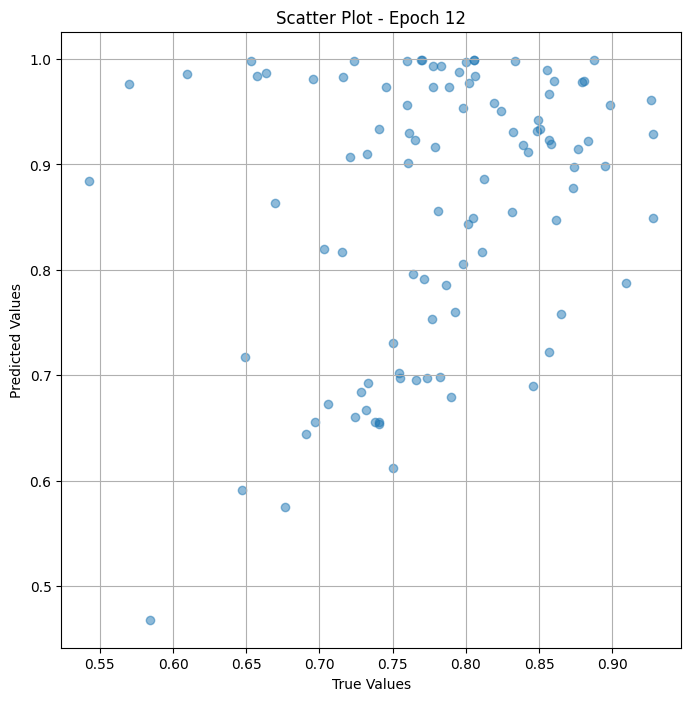


 Epoch: (13/50) Loss = 0.002004507929086685

 Epoch: (13/50) Loss_rmse = 0.04477173089981079

 Epoch: (13/50) R^2 = -0.014231324195861816

 Epoch: (13/50) MAE = 0.04102391004562378

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

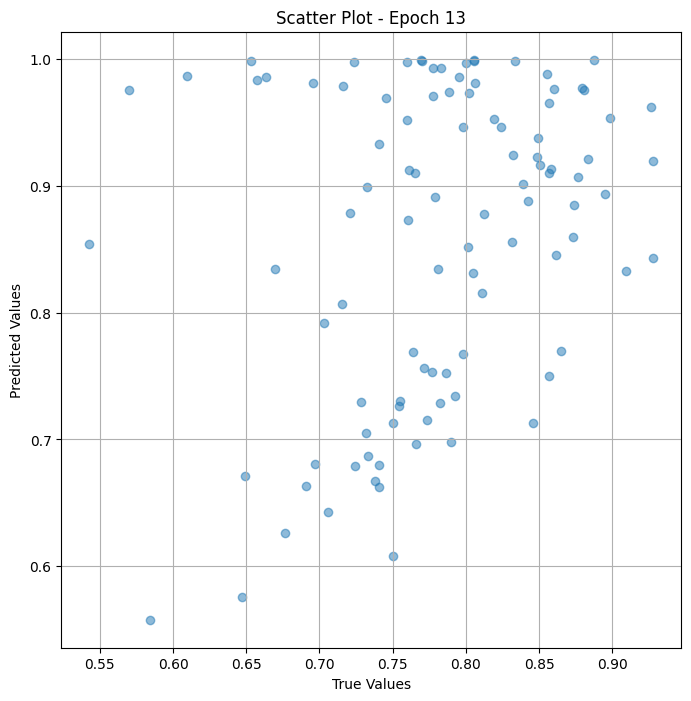


 Epoch: (14/50) Loss = 0.0006705066189169884

 Epoch: (14/50) Loss_rmse = 0.02589414268732071

 Epoch: (14/50) R^2 = 0.6607402563095093

 Epoch: (14/50) MAE = 0.023613691329956055

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

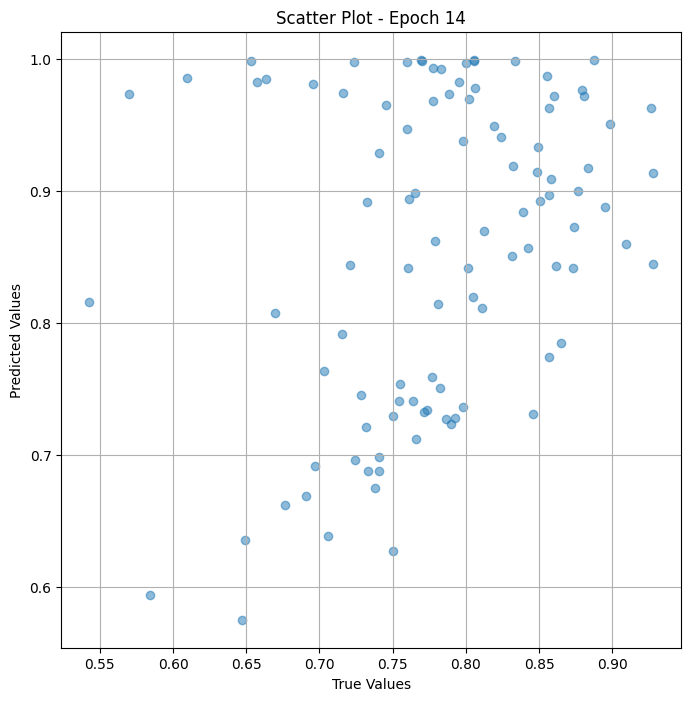


 Epoch: (15/50) Loss = 0.0002299398765899241

 Epoch: (15/50) Loss_rmse = 0.015163768082857132

 Epoch: (15/50) R^2 = 0.8836561441421509

 Epoch: (15/50) MAE = 0.013685107231140137

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

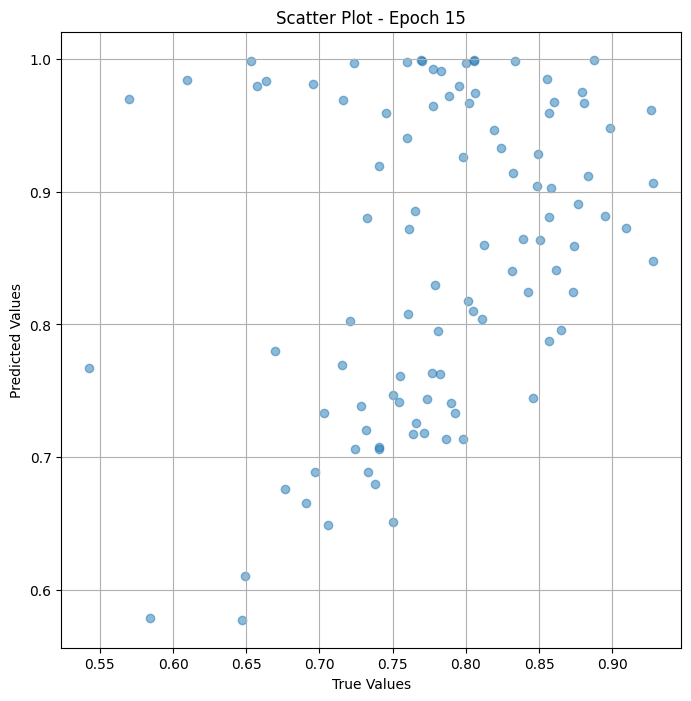


 Epoch: (16/50) Loss = 0.0003664915566332638

 Epoch: (16/50) Loss_rmse = 0.0191439688205719

 Epoch: (16/50) R^2 = 0.8145643472671509

 Epoch: (16/50) MAE = 0.014918342232704163

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 

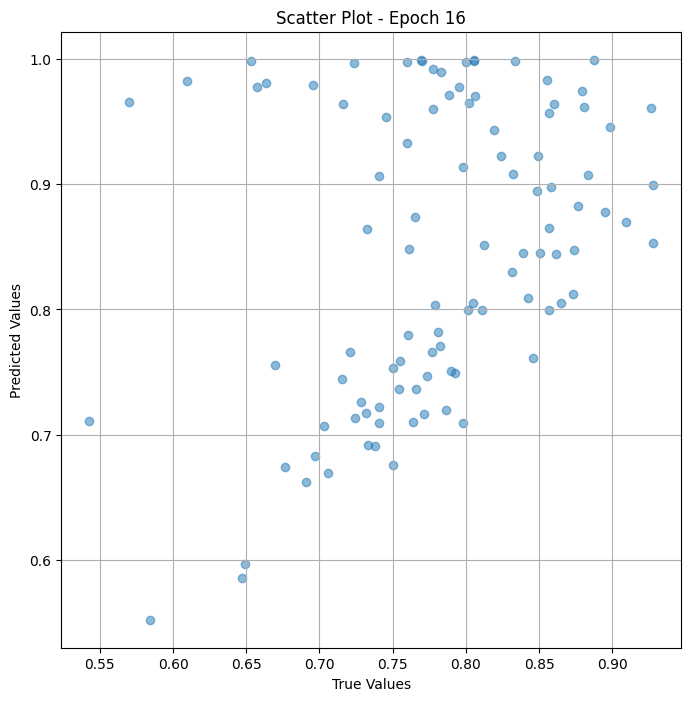


 Epoch: (17/50) Loss = 0.0002609147340990603

 Epoch: (17/50) Loss_rmse = 0.01615285500884056

 Epoch: (17/50) R^2 = 0.8679835796356201

 Epoch: (17/50) MAE = 0.012564346194267273

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

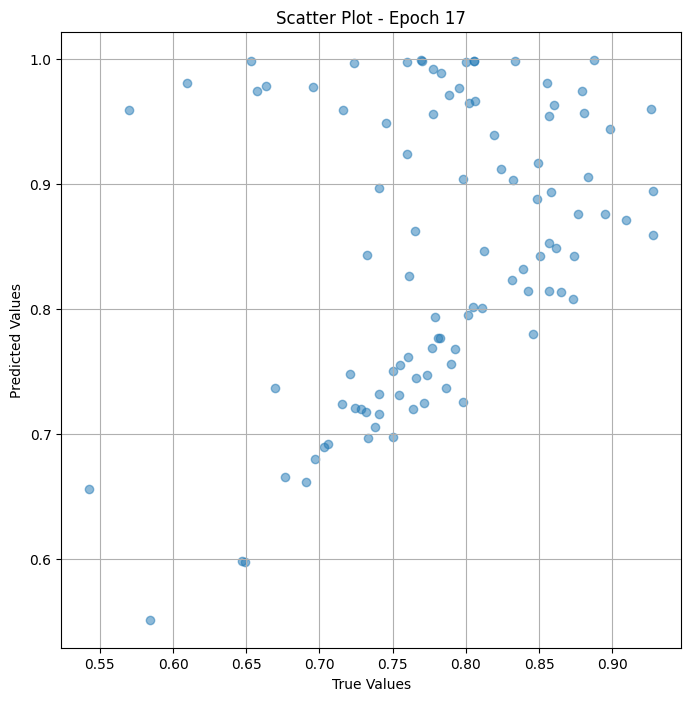


 Epoch: (18/50) Loss = 0.00013869625399820507

 Epoch: (18/50) Loss_rmse = 0.011776937171816826

 Epoch: (18/50) R^2 = 0.9298231601715088

 Epoch: (18/50) MAE = 0.010739624500274658

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

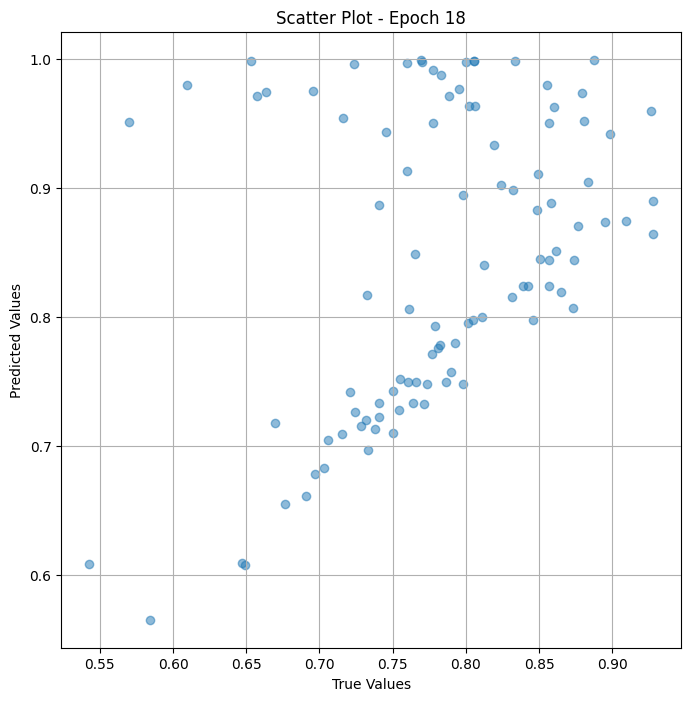


 Epoch: (19/50) Loss = 0.00010900631605181843

 Epoch: (19/50) Loss_rmse = 0.01044060941785574

 Epoch: (19/50) R^2 = 0.9448454976081848

 Epoch: (19/50) MAE = 0.009904786944389343

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

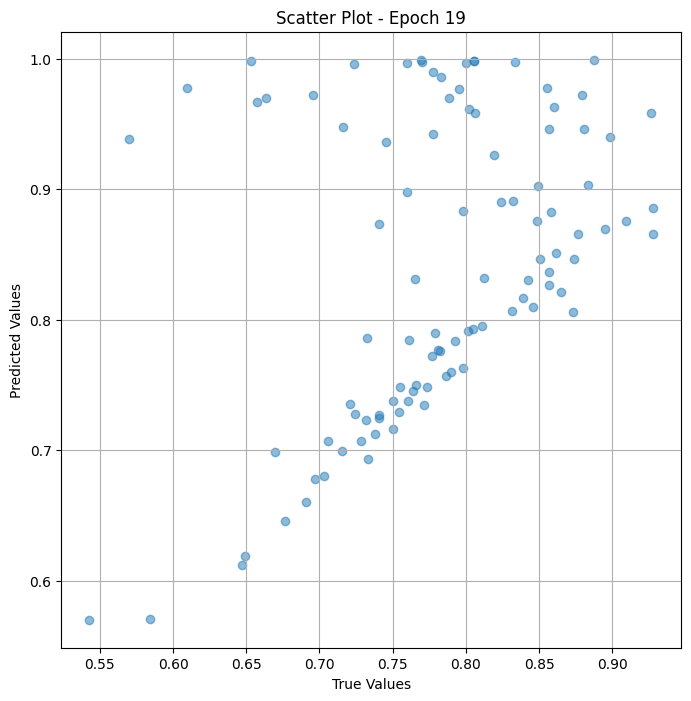


 Epoch: (20/50) Loss = 8.083659486146644e-05

 Epoch: (20/50) Loss_rmse = 0.008990917354822159

 Epoch: (20/50) R^2 = 0.9590986967086792

 Epoch: (20/50) MAE = 0.008611872792243958

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

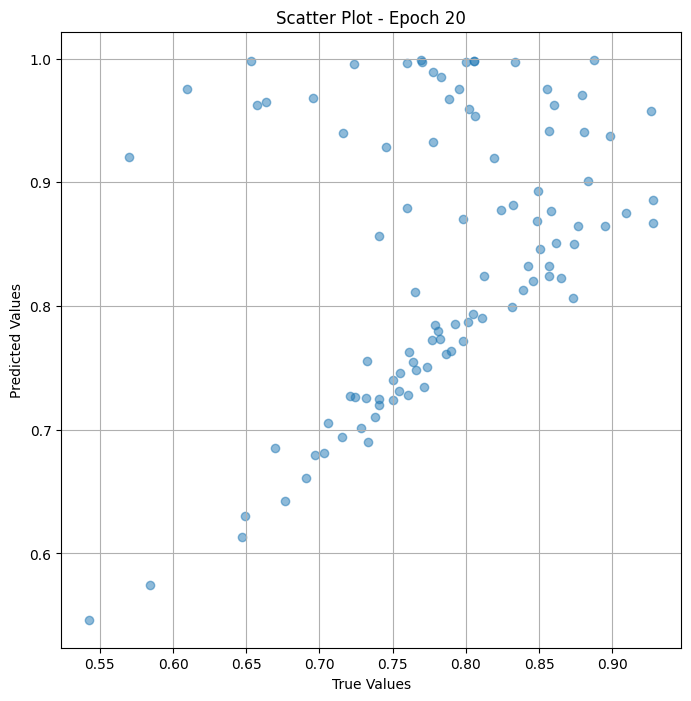


 Epoch: (21/50) Loss = 6.880659202579409e-05

 Epoch: (21/50) Loss_rmse = 0.008294973522424698

 Epoch: (21/50) R^2 = 0.9651855826377869

 Epoch: (21/50) MAE = 0.00798344612121582

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

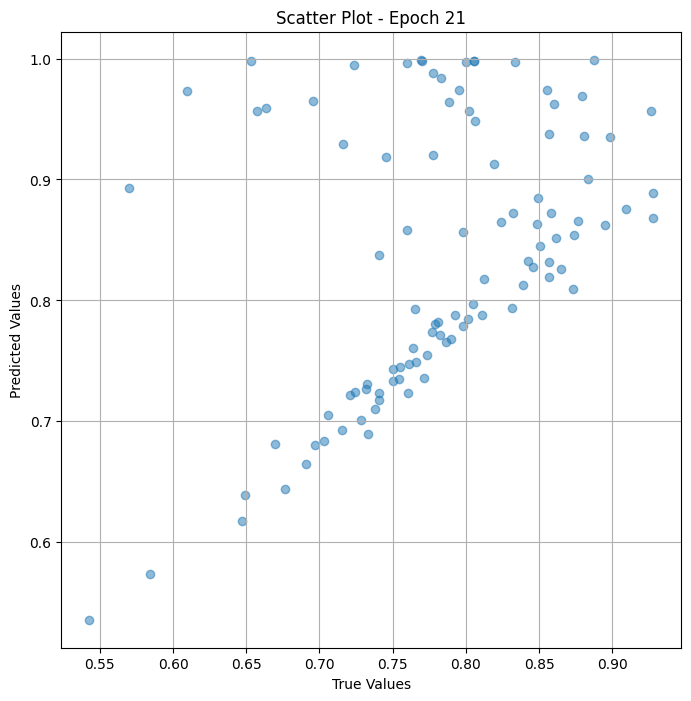


 Epoch: (22/50) Loss = 8.334990707226098e-05

 Epoch: (22/50) Loss_rmse = 0.009129617363214493

 Epoch: (22/50) R^2 = 0.9578270316123962

 Epoch: (22/50) MAE = 0.008846983313560486

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

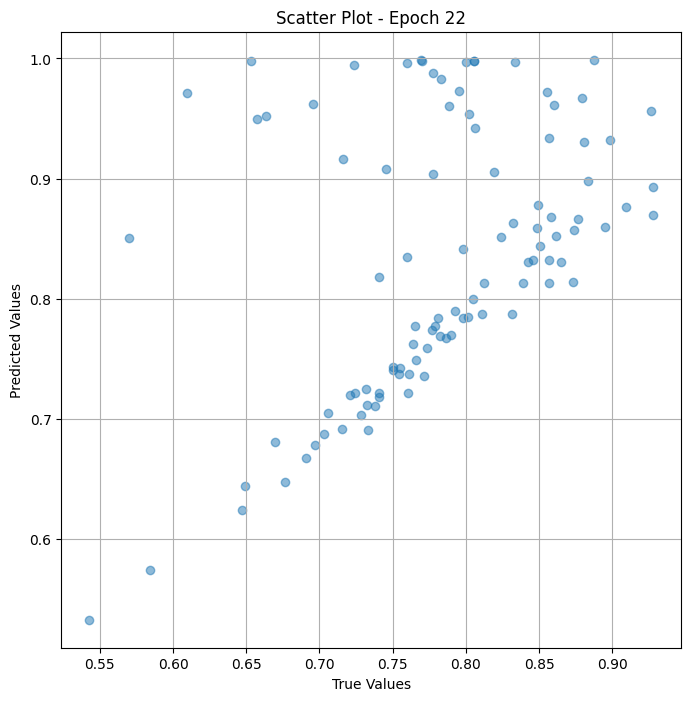


 Epoch: (23/50) Loss = 9.457305714022368e-05

 Epoch: (23/50) Loss_rmse = 0.009724867530167103

 Epoch: (23/50) R^2 = 0.9521483778953552

 Epoch: (23/50) MAE = 0.009459584951400757

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

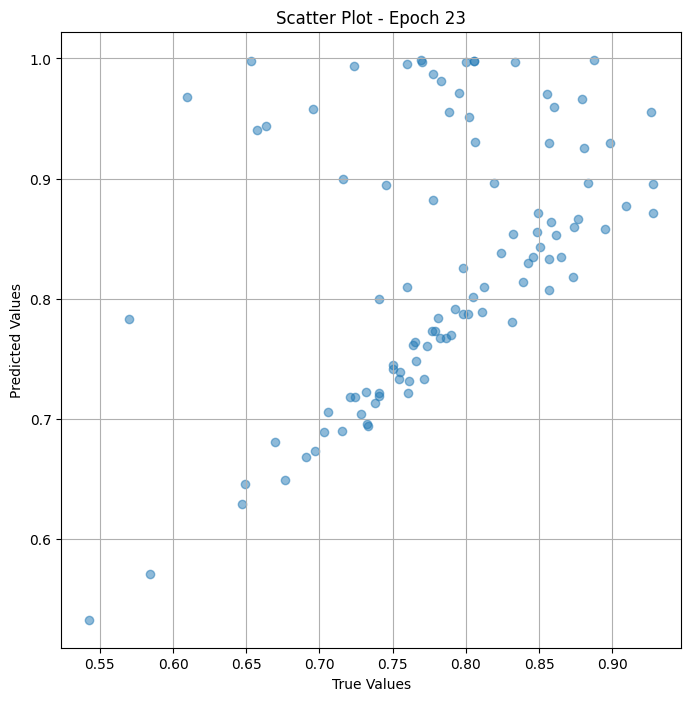


 Epoch: (24/50) Loss = 7.974957406986505e-05

 Epoch: (24/50) Loss_rmse = 0.008930261246860027

 Epoch: (24/50) R^2 = 0.9596486687660217

 Epoch: (24/50) MAE = 0.008629396557807922

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

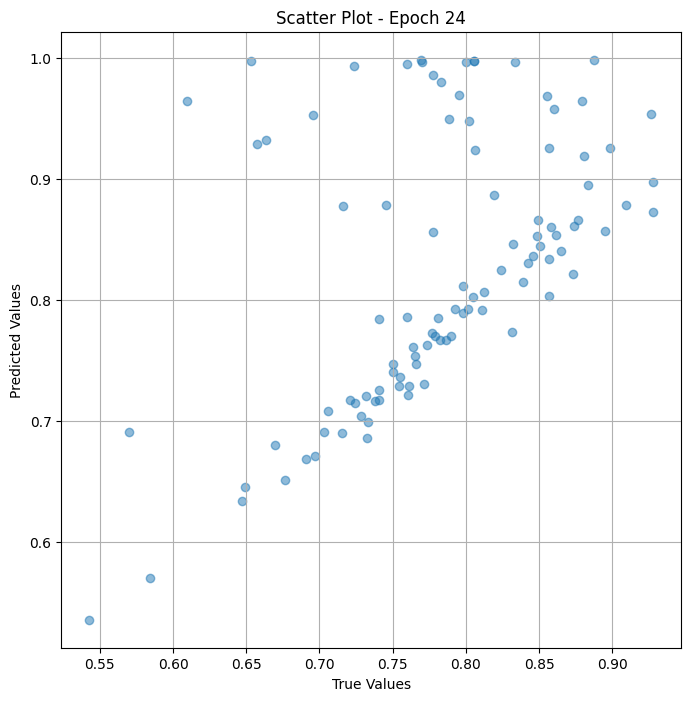


 Epoch: (25/50) Loss = 5.590440196101554e-05

 Epoch: (25/50) Loss_rmse = 0.007476924452930689

 Epoch: (25/50) R^2 = 0.9717137813568115

 Epoch: (25/50) MAE = 0.007118701934814453

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

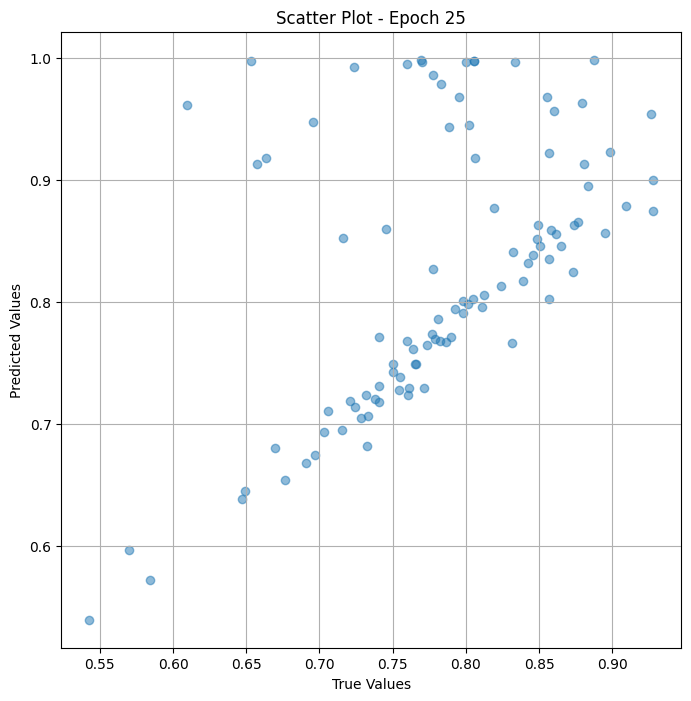


 Epoch: (26/50) Loss = 4.300009459257126e-05

 Epoch: (26/50) Loss_rmse = 0.006557445507496595

 Epoch: (26/50) R^2 = 0.9782429933547974

 Epoch: (26/50) MAE = 0.006101325154304504

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

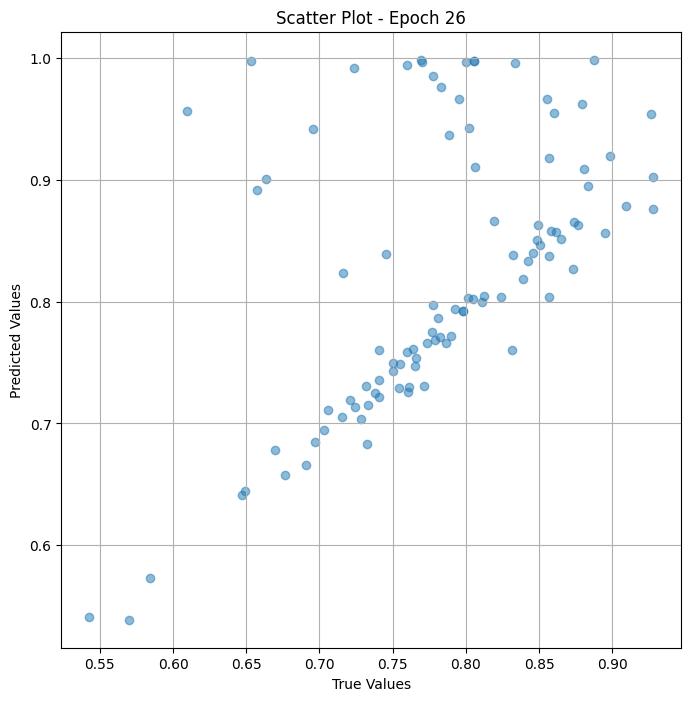


 Epoch: (27/50) Loss = 4.4213211367605254e-05

 Epoch: (27/50) Loss_rmse = 0.006649301387369633

 Epoch: (27/50) R^2 = 0.9776291847229004

 Epoch: (27/50) MAE = 0.005965560674667358

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

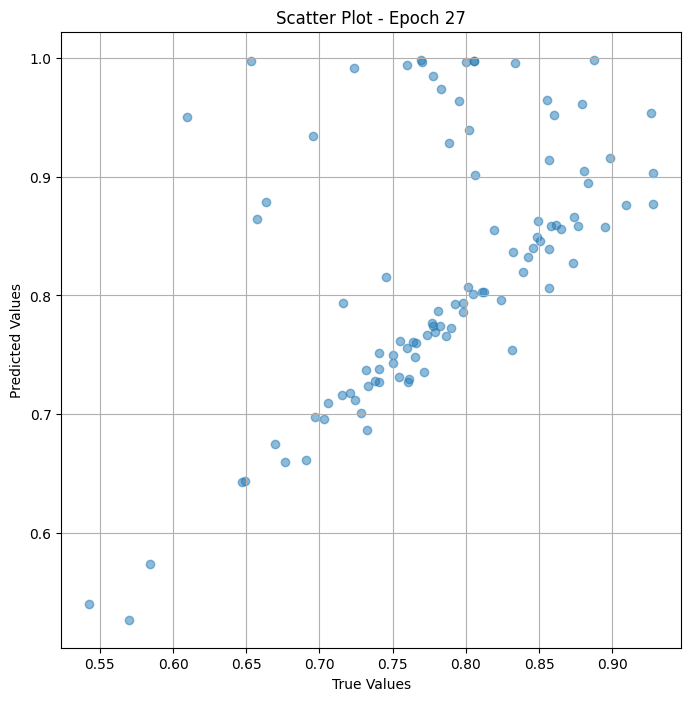


 Epoch: (28/50) Loss = 4.904034358332865e-05

 Epoch: (28/50) Loss_rmse = 0.00700288126245141

 Epoch: (28/50) R^2 = 0.975186824798584

 Epoch: (28/50) MAE = 0.005974516272544861

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79, 

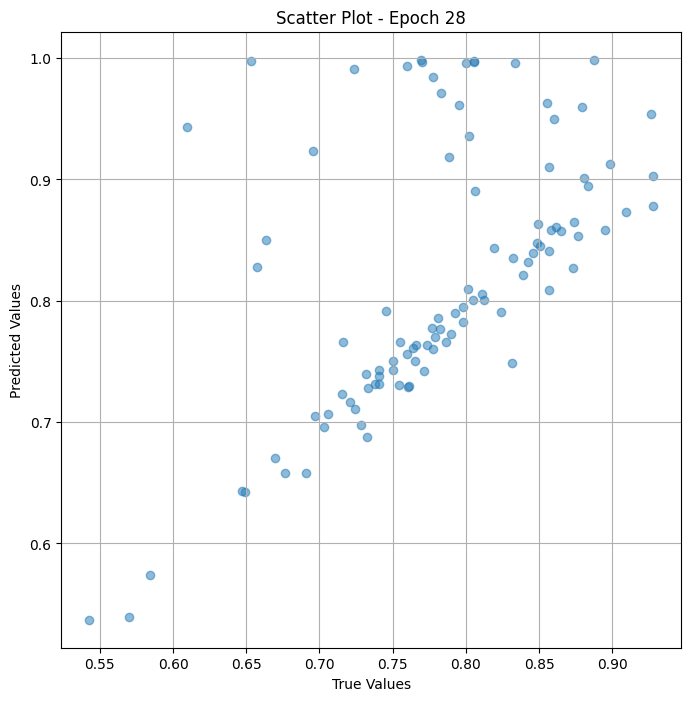


 Epoch: (29/50) Loss = 4.877208994003013e-05

 Epoch: (29/50) Loss_rmse = 0.006983701605349779

 Epoch: (29/50) R^2 = 0.9753225445747375

 Epoch: (29/50) MAE = 0.0059514641761779785

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

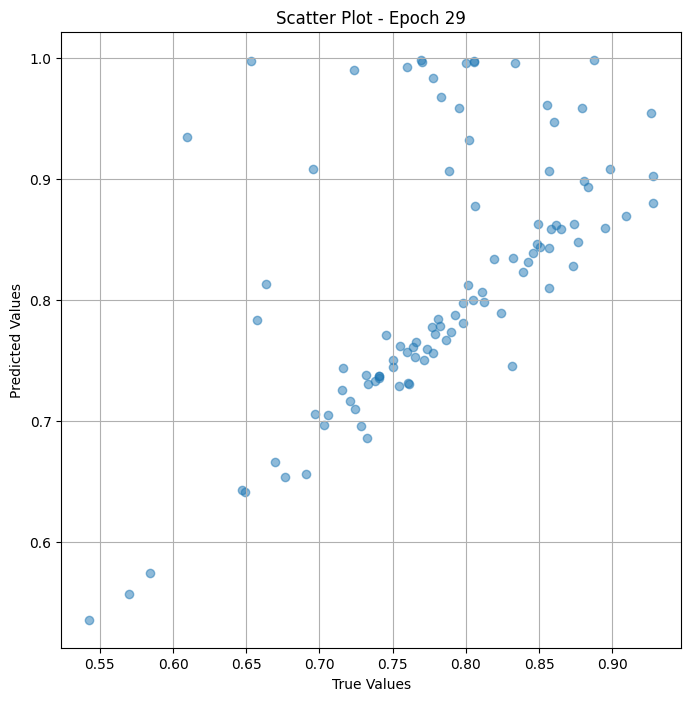


 Epoch: (30/50) Loss = 4.5557902922155336e-05

 Epoch: (30/50) Loss_rmse = 0.006749659311026335

 Epoch: (30/50) R^2 = 0.9769488573074341

 Epoch: (30/50) MAE = 0.005674570798873901

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

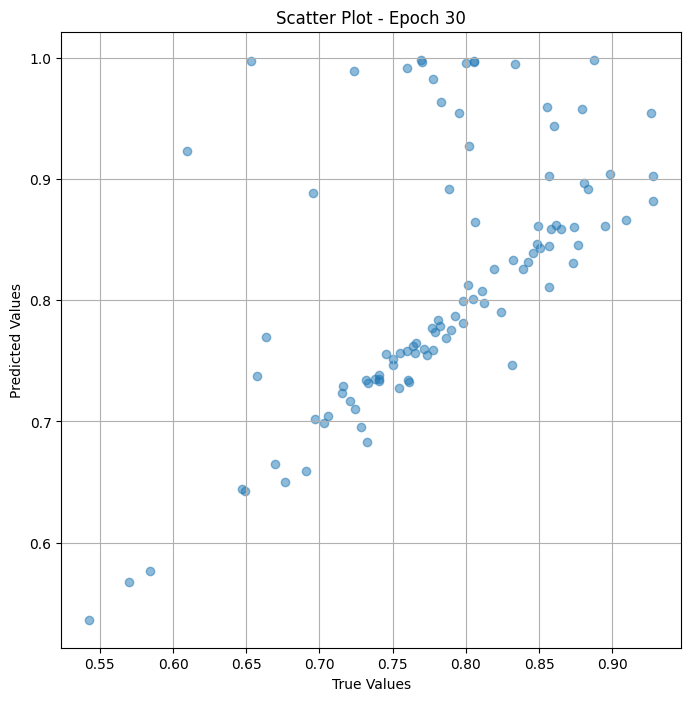


 Epoch: (31/50) Loss = 4.248673940310255e-05

 Epoch: (31/50) Loss_rmse = 0.006518185138702393

 Epoch: (31/50) R^2 = 0.9785027503967285

 Epoch: (31/50) MAE = 0.005249828100204468

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

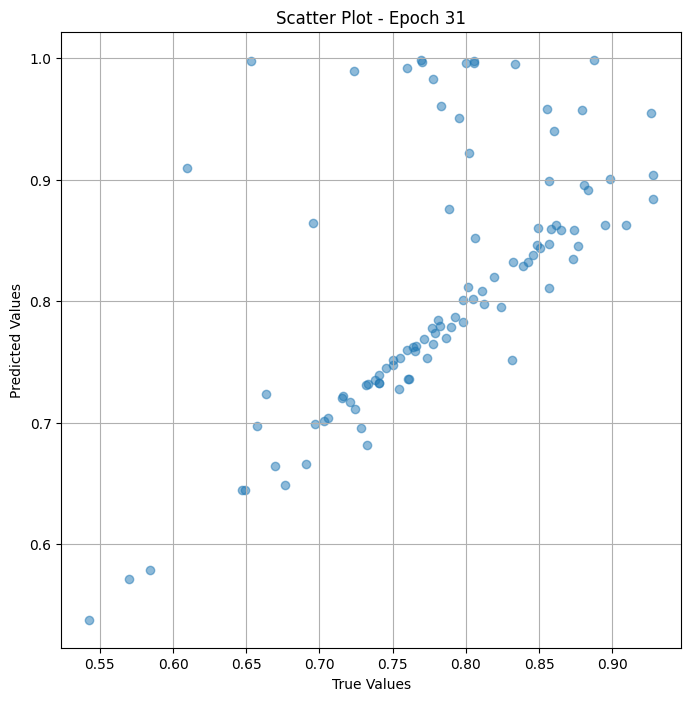


 Epoch: (32/50) Loss = 4.079379141330719e-05

 Epoch: (32/50) Loss_rmse = 0.00638700183480978

 Epoch: (32/50) R^2 = 0.9793593287467957

 Epoch: (32/50) MAE = 0.004963412880897522

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79,

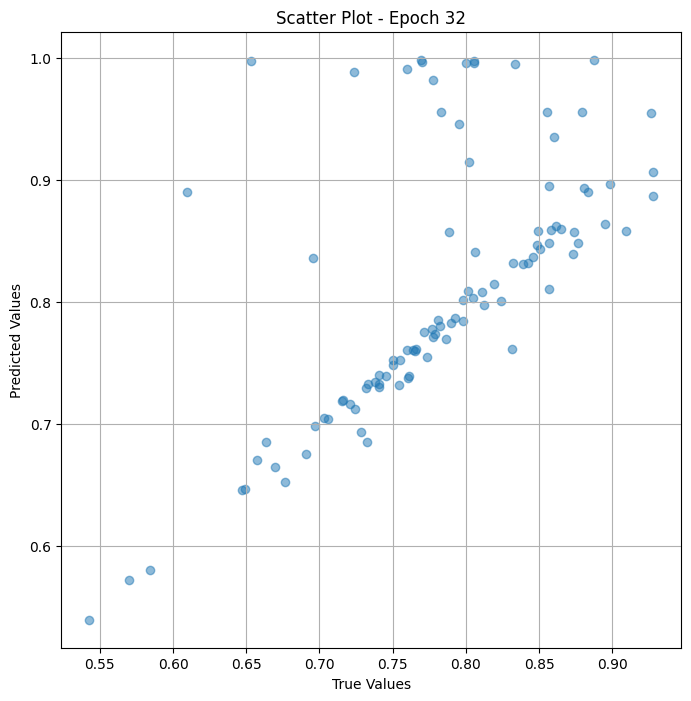


 Epoch: (33/50) Loss = 3.9577422285219654e-05

 Epoch: (33/50) Loss_rmse = 0.006291058845818043

 Epoch: (33/50) R^2 = 0.9799748063087463

 Epoch: (33/50) MAE = 0.004890725016593933

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

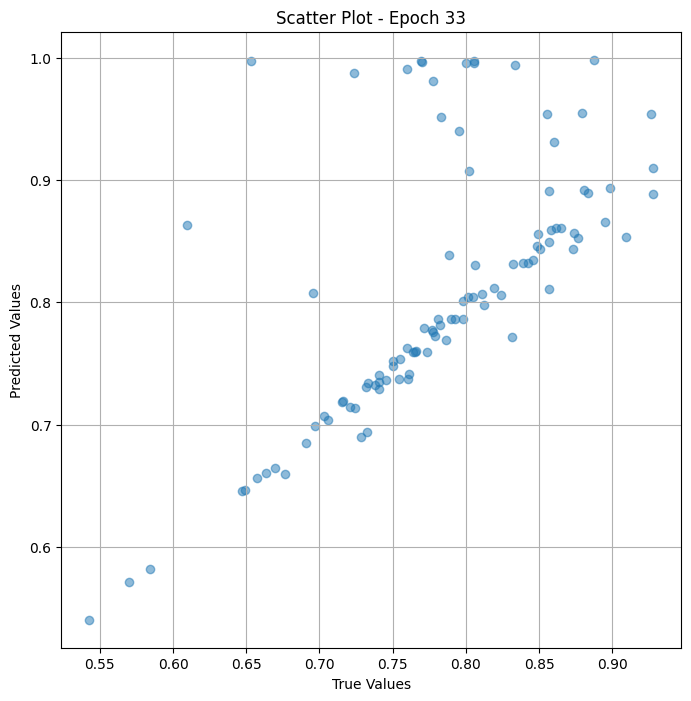


 Epoch: (34/50) Loss = 3.634239692473784e-05

 Epoch: (34/50) Loss_rmse = 0.006028465460985899

 Epoch: (34/50) R^2 = 0.9816116690635681

 Epoch: (34/50) MAE = 0.005032166838645935

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

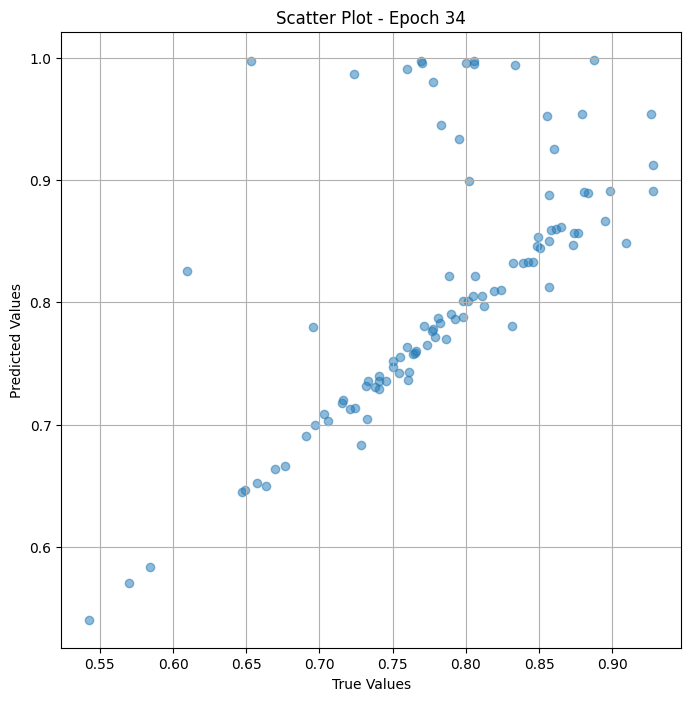


 Epoch: (35/50) Loss = 3.0901810532668605e-05

 Epoch: (35/50) Loss_rmse = 0.005558939650654793

 Epoch: (35/50) R^2 = 0.9843644499778748

 Epoch: (35/50) MAE = 0.00481964647769928

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

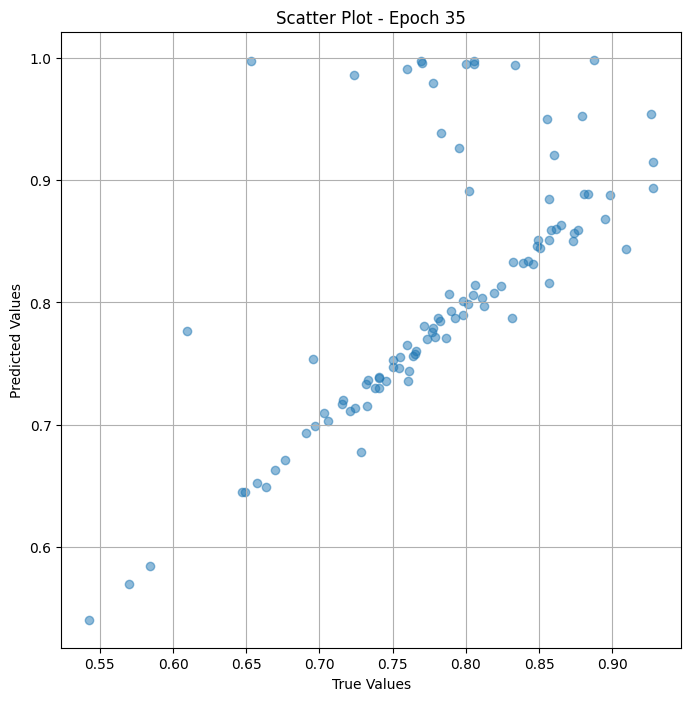


 Epoch: (36/50) Loss = 2.6543204512563534e-05

 Epoch: (36/50) Loss_rmse = 0.005152009893208742

 Epoch: (36/50) R^2 = 0.9865698218345642

 Epoch: (36/50) MAE = 0.004451245069503784

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

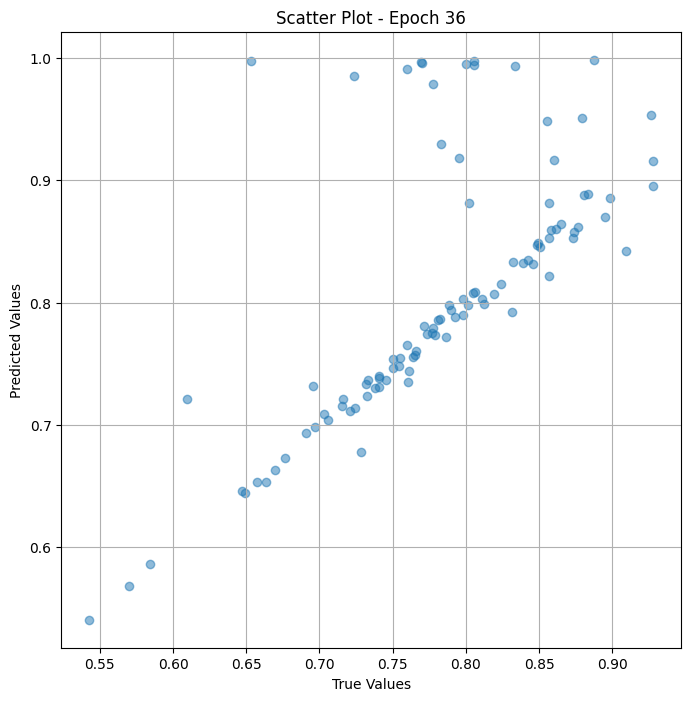


 Epoch: (37/50) Loss = 2.6642961529432796e-05

 Epoch: (37/50) Loss_rmse = 0.005161682143807411

 Epoch: (37/50) R^2 = 0.9865193367004395

 Epoch: (37/50) MAE = 0.0042885541915893555

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

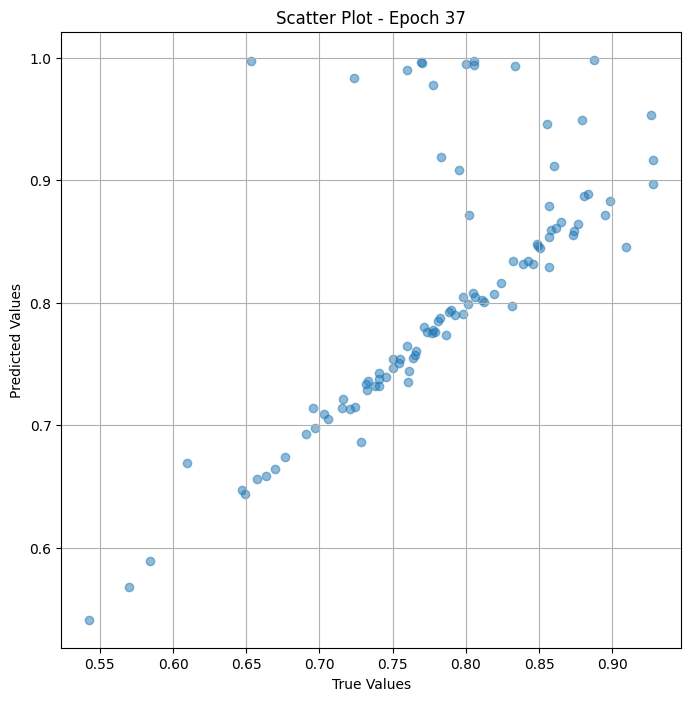


 Epoch: (38/50) Loss = 3.1436935387318954e-05

 Epoch: (38/50) Loss_rmse = 0.005606865044683218

 Epoch: (38/50) R^2 = 0.9840936660766602

 Epoch: (38/50) MAE = 0.004515260457992554

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

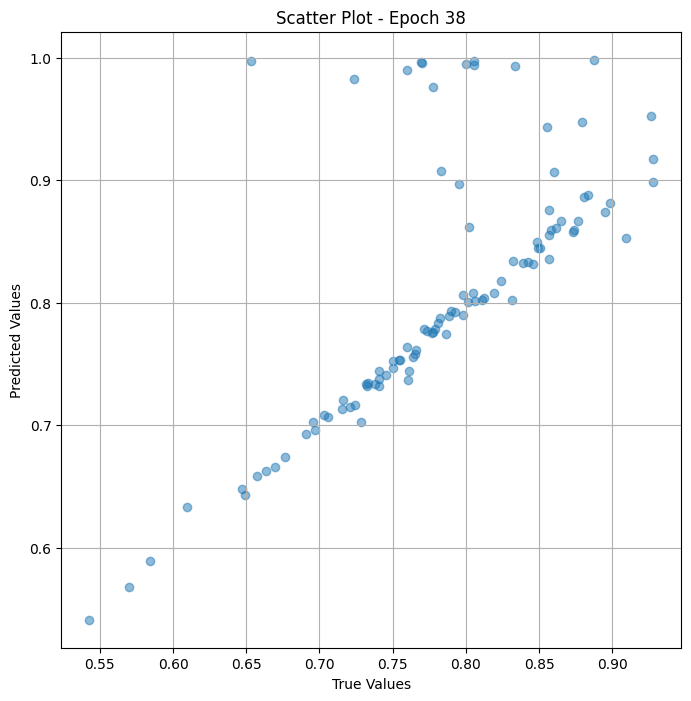


 Epoch: (39/50) Loss = 3.6264049413148314e-05

 Epoch: (39/50) Loss_rmse = 0.006021963898092508

 Epoch: (39/50) R^2 = 0.9816513061523438

 Epoch: (39/50) MAE = 0.004819750785827637

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

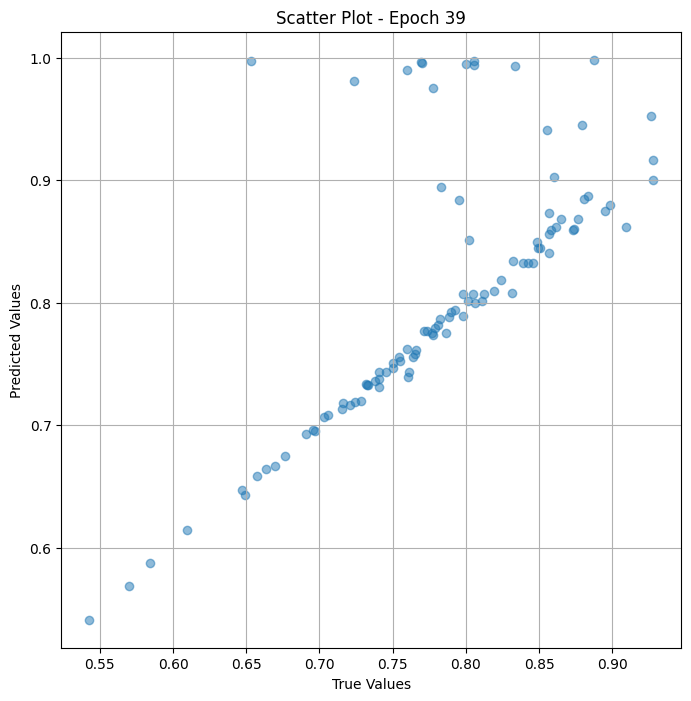


 Epoch: (40/50) Loss = 3.5884437238564715e-05

 Epoch: (40/50) Loss_rmse = 0.005990362260490656

 Epoch: (40/50) R^2 = 0.9818433523178101

 Epoch: (40/50) MAE = 0.004646316170692444

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

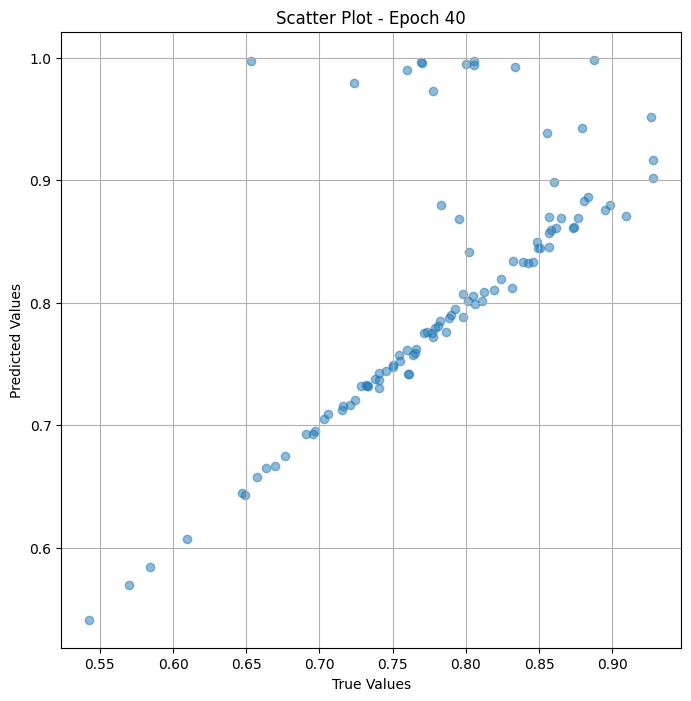


 Epoch: (41/50) Loss = 3.156716775265522e-05

 Epoch: (41/50) Loss_rmse = 0.005618466529995203

 Epoch: (41/50) R^2 = 0.9840278029441833

 Epoch: (41/50) MAE = 0.004349246621131897

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

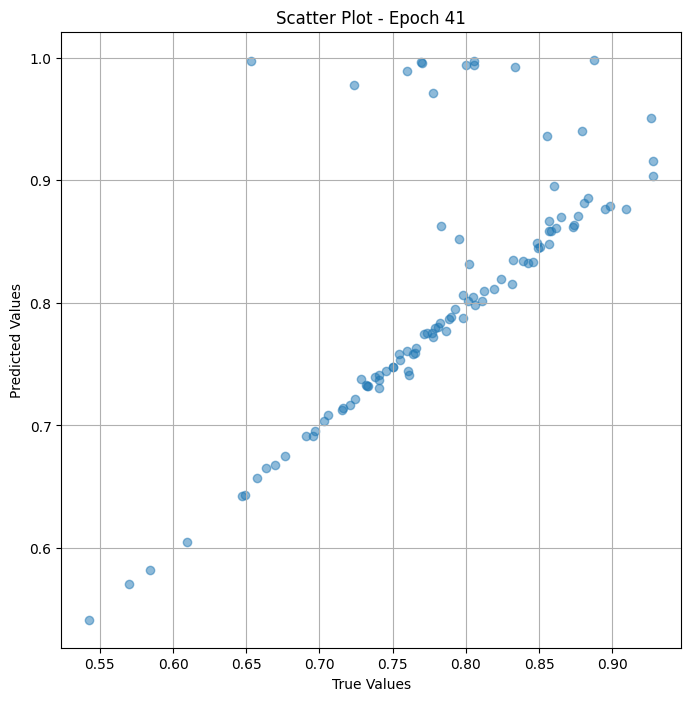


 Epoch: (42/50) Loss = 2.5173250833177008e-05

 Epoch: (42/50) Loss_rmse = 0.005017295014113188

 Epoch: (42/50) R^2 = 0.9872629642486572

 Epoch: (42/50) MAE = 0.0038868188858032227

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

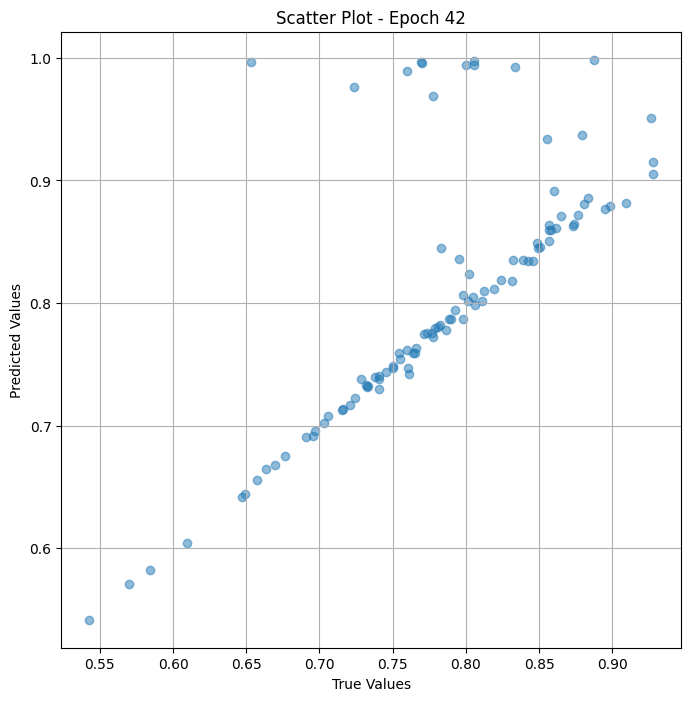


 Epoch: (43/50) Loss = 1.8252805602969602e-05

 Epoch: (43/50) Loss_rmse = 0.0042723300866782665

 Epoch: (43/50) R^2 = 0.9907645583152771

 Epoch: (43/50) MAE = 0.003262564539909363

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

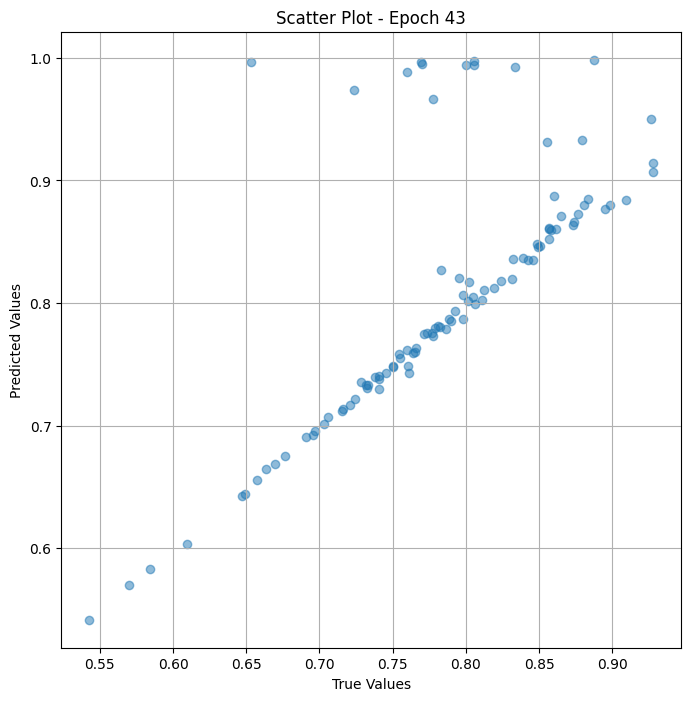


 Epoch: (44/50) Loss = 1.20770700959838e-05

 Epoch: (44/50) Loss_rmse = 0.0034752078354358673

 Epoch: (44/50) R^2 = 0.9938892722129822

 Epoch: (44/50) MAE = 0.0026036351919174194

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

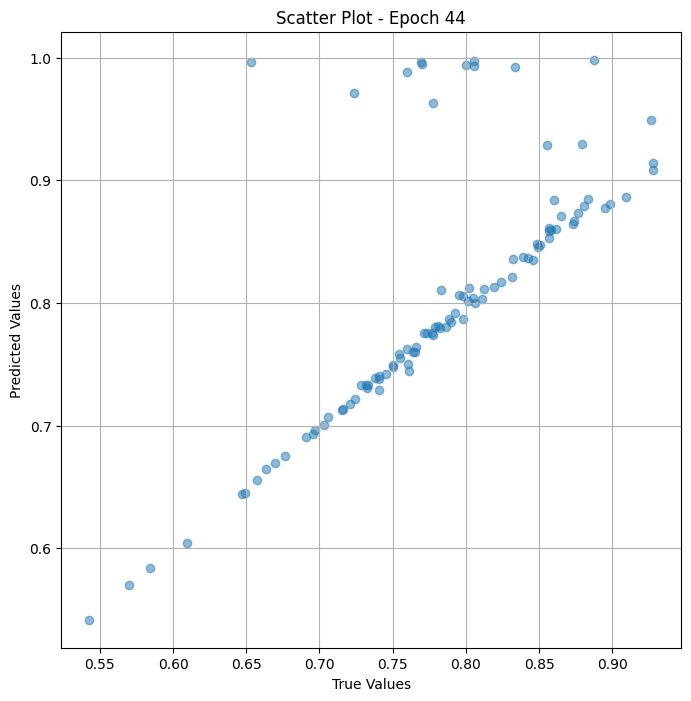


 Epoch: (45/50) Loss = 7.647573511349037e-06

 Epoch: (45/50) Loss_rmse = 0.0027654245495796204

 Epoch: (45/50) R^2 = 0.9961305260658264

 Epoch: (45/50) MAE = 0.0020567774772644043

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

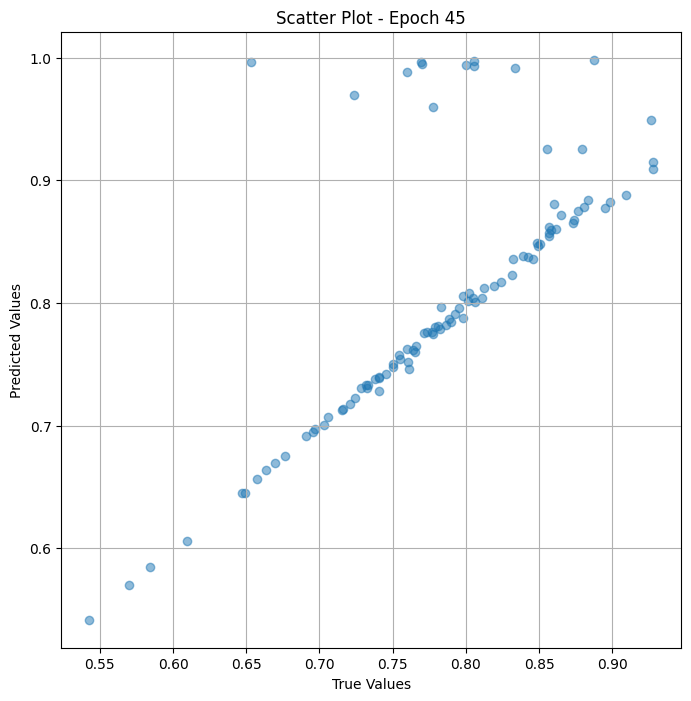


 Epoch: (46/50) Loss = 5.050570507592056e-06

 Epoch: (46/50) Loss_rmse = 0.0022473474964499474

 Epoch: (46/50) R^2 = 0.9974445104598999

 Epoch: (46/50) MAE = 0.001776278018951416

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

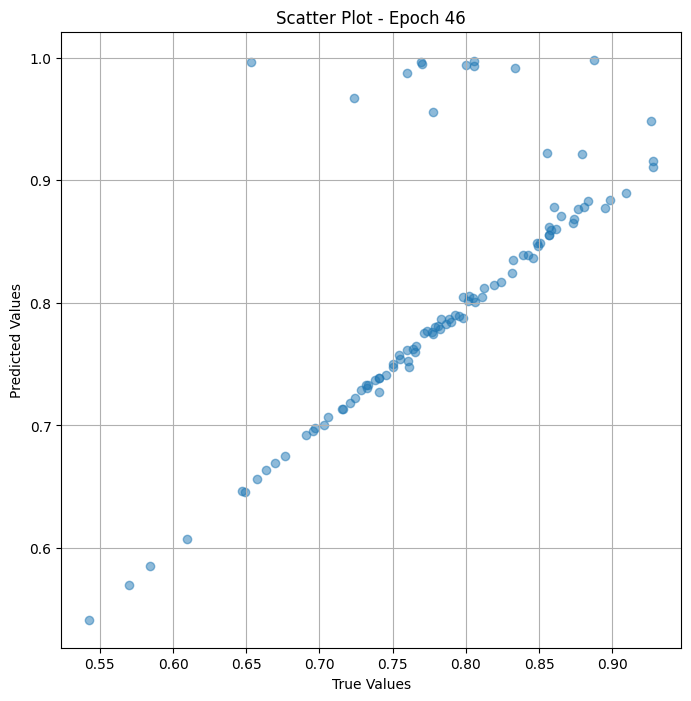


 Epoch: (47/50) Loss = 4.109124802198494e-06

 Epoch: (47/50) Loss_rmse = 0.002027097623795271

 Epoch: (47/50) R^2 = 0.9979208707809448

 Epoch: (47/50) MAE = 0.001691192388534546

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.79

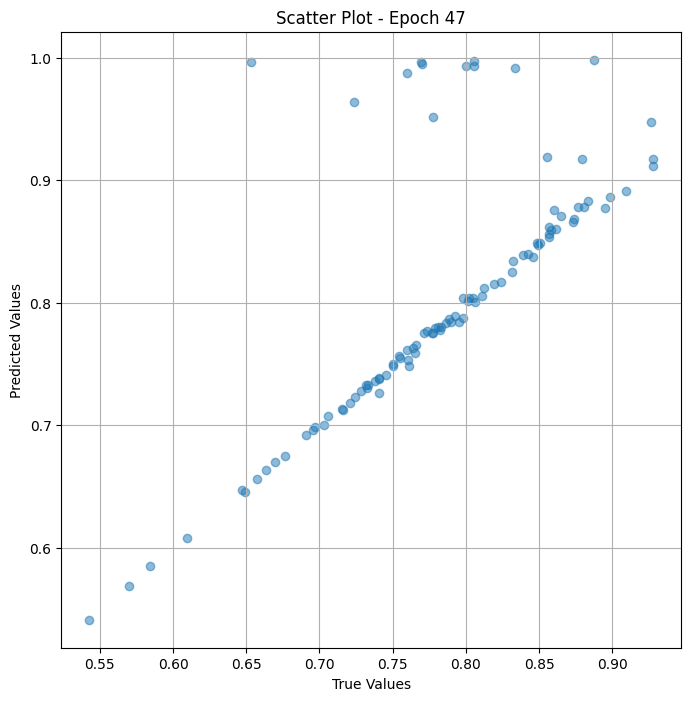


 Epoch: (48/50) Loss = 4.022955181426369e-06

 Epoch: (48/50) Loss_rmse = 0.0020057305227965117

 Epoch: (48/50) R^2 = 0.9979645013809204

 Epoch: (48/50) MAE = 0.0016950368881225586

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.

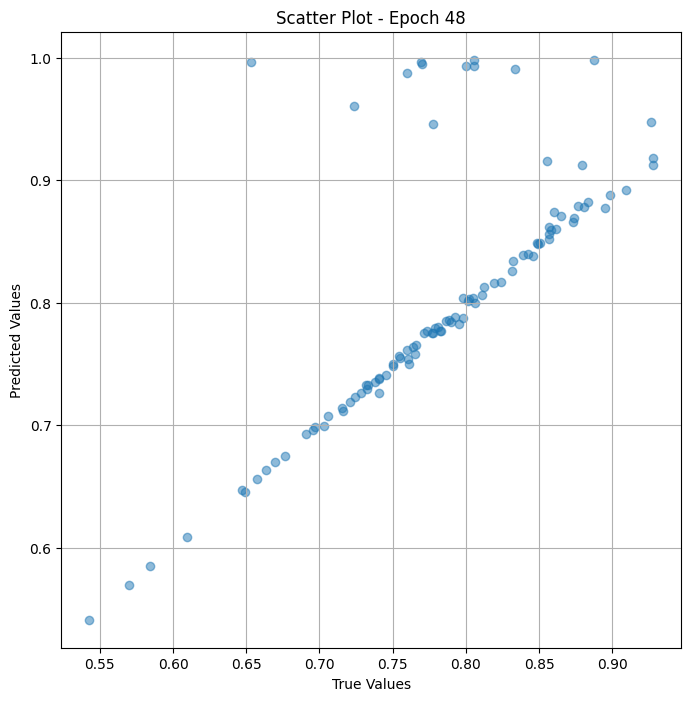


 Epoch: (49/50) Loss = 4.65190760223777e-06

 Epoch: (49/50) Loss_rmse = 0.0021568280644714832

 Epoch: (49/50) R^2 = 0.9976462721824646

 Epoch: (49/50) MAE = 0.0017969459295272827

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0.7

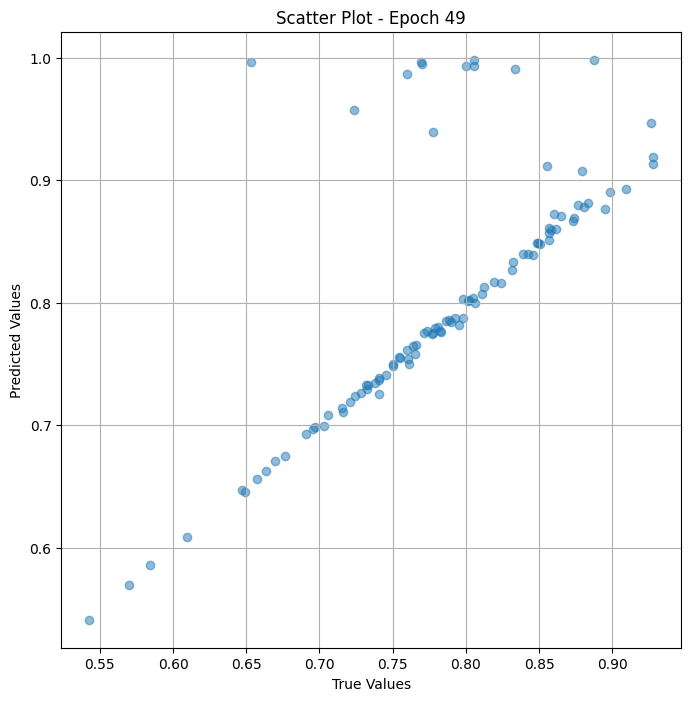


 Epoch: (50/50) Loss = 5.6971507547132205e-06

 Epoch: (50/50) Loss_rmse = 0.0023868705611675978

 Epoch: (50/50) R^2 = 0.9971174001693726

 Epoch: (50/50) MAE = 0.0019958019256591797

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105, 0.77, 0.6952381, 0.7407407, 0.77319586, 0.8738739, 0.9279279, 0.90909094, 0.72115386, 0.7029703, 0.76, 0.64935064, 0.7659575, 0.9266055, 0.75961536, 0.74545455, 0.7241379, 0.7407407, 0.754717, 0.8061224, 0.7765958, 0.8055556, 0.7326733, 0.83908045, 0.7160494, 0.8488372, 0.54285717, 0.8791209, 0.85714287, 0.8495575, 0.71568626, 0.7717391, 0.87341774, 0.7604167, 0.92783505, 0.8981481, 0.8125, 0.8651685, 0.6699029, 0.7653061, 0.64705884, 0.7282609, 0.8113208, 0.88073397, 0.78125, 0.7777778, 0.85714287, 0.8020833, 0.7407407, 0.8, 0.7058824, 0.7977528, 0.7882353, 0.8584906, 0.8018018, 0.60952383, 0.80582523, 0.6764706, 0.7924528, 0.8604651, 0

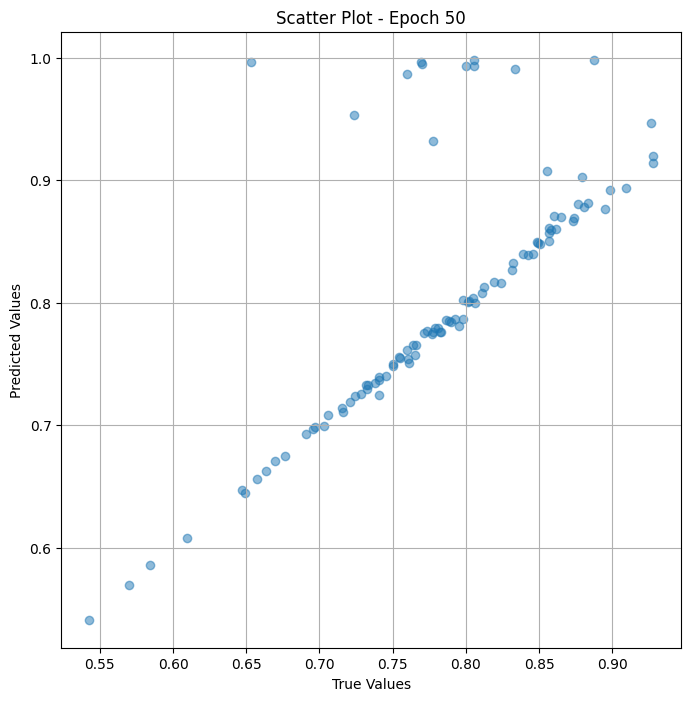

In [ ]:
# Training the model and save weights
fit(50, model_fine_test, train_dl_test)
torch.save(model_fine_test.state_dict(), "model_weights_vr_fine")

In [ ]:
 true_values_list = [0.7979798, 0.77884614, 0.76086956, 0.85555553, 0.8240741, 0.5841584, 0.83206105]

 predicted_values_list= [0.76325, 0.78981704, 0.7842232, 0.9774096, 0.89045227, 0.57092476, 0.8909413]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.8928571428571429 0.006807187408935392
